# 1 Import libraries

In [ ]:
# support libraries
from scipy.io import loadmat
import numpy as np, os 
import pandas as pd
import matplotlib.pyplot as plt
from progressbar import ProgressBar
import scipy.signal as sig
import scipy.stats as stats
import plotly.express as px
from scipy.signal import resample
from sklearn.model_selection import train_test_split
import random
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import svm
from sklearn.feature_selection import VarianceThreshold
from itertools import compress
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.datasets import make_classification
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_val_score, KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import classification_report
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from sklearn.inspection import permutation_importance
from scipy.integrate import trapz
from matplotlib import pyplot as plt
from sklearn.inspection import PartialDependenceDisplay
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import roc_curve, auc
import seaborn as sns
import joblib
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model
from keras import layers, Sequential, losses
from keras.layers import Input, Add, RepeatVector, Dense, Activation, ZeroPadding1D, Flatten, GlobalAveragePooling1D,  Conv1D, MaxPooling1D, GlobalMaxPooling1D, Dropout,concatenate, BatchNormalization, Reshape, LSTM
from keras.models import Model
from tensorflow.keras.layers import UpSampling1D
from keras.utils import to_categorical
from keras.callbacks import Callback

# 2 Load data

In [ ]:
# unzip file
unzip = False

if unzip:
  import zipfile
  zip = zipfile.ZipFile('/content/drive/MyDrive/Project - Applied AI in biomedicine/train.zip')
  zip.extractall('/content/drive/MyDrive/Project - Applied AI in biomedicine')
  zip.close()

In [ ]:
path = '/content/drive/MyDrive/Project - Applied AI in biomedicine/train'

# Insert in a list all the files
print('Loading data...')
file_list = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

# Print the list of files
print("List of files:")
for file_name in file_list:
    print(file_name)

# Insert in a proper list all the ann_files (labels)
ann_files = []
for f in os.listdir(path):
    g = os.path.join(path, f)
    if not f.lower().startswith('.') and f.lower().endswith('_ann.mat') and os.path.isfile(g):
        ann_files.append(g)
num_files = len(ann_files)

# Insert in a proper list all the spk_files (peaks)
spk_files = []
for f in os.listdir(path):
    g = os.path.join(path, f)
    if not f.lower().startswith('.') and f.lower().endswith('_spk.mat') and os.path.isfile(g):
        spk_files.append(g)

# Insert in a proper list all the mat_files (including the whole recording of the ppg signal)
mat_files = []
for f in os.listdir(path):
    g = os.path.join(path, f)
    if not f.lower().startswith('.') and f.lower().endswith('250.mat') or f.lower().endswith('128.mat') and os.path.isfile(g):
        mat_files.append(g)

In [ ]:
# sort the lists according to the patients' ID
ann_files.sort()
spk_files.sort()
mat_files.sort()

# 3 Data structures creation

In [ ]:
# load the mat file with the recordings into a dictionary
recordings_dict = list()
for i in range(num_files):
    print('Loading file: ' + str(i+1) + '/' + str(num_files))
    recording = loadmat(mat_files[i])
    recordings_dict.append(recording)

# transform the dictionary into a numpy array
recordings = []
for rec in recordings_dict:
      recordings.append(np.asarray(rec['ppg'], dtype=np.float64))

In [ ]:
# load the mat file with the peaks into a dictionary
peaks_dict = list()
for i in range(num_files):
    print('Loading file: ' + str(i+1) + '/' + str(num_files))
    peak = loadmat(spk_files[i])
    peaks_dict.append(peak)

# transform the disctionary into a numpy array
peaks = []
for pk in peaks_dict:
  peaks.append(np.asarray(pk['speaks'], dtype=np.int32))

In [ ]:
# load the mat file with the labels into a dictionary
labels_dict = list()
for i in range(num_files):
    print('Loading file: ' + str(i+1) + '/' + str(num_files))
    label = loadmat(ann_files[i])
    labels_dict.append(label)

# transform the dictionary into a numpy array
labels = []
for lb in labels_dict:
      labels.append(np.asarray(lb['labels']))

In [ ]:
# transform the labels into values for the classification

# 0: N-normal
# 1: S-supraventricular (PAC)
# 2: V-ventricular (PVC)

for i in range(len(labels)):
  for j in range(len(labels[i])):
    if labels[i][j]=='N': labels[i][j] = 0
    if labels[i][j]=='S': labels[i][j] = 1
    if labels[i][j]=='V': labels[i][j] = 2

In [ ]:
PEAKS = np.array(peaks, dtype=object)
REC = np.array(recordings, dtype=object)
LABELS = np.array(labels, dtype=object)

# create a list where for each patient,
# the peaks, the recording value, the labels and the sampling frequency are recorded
LIST = []
array = []
for i in range(len(PEAKS)):
  r = len(PEAKS[i])
  PEAKS_VALUES_TIME = np.zeros((r, 4))
  for j in range(len(PEAKS[i])):
    PEAKS_VALUES_TIME[j][0] = peaks[i][j][0]
    PEAKS_VALUES_TIME[j][1] = REC[i][j][0]
    PEAKS_VALUES_TIME[j][2] = LABELS[i][j][0]
    if len(REC[i])<300000:
      PEAKS_VALUES_TIME[j][3] = 128.
    else:
      PEAKS_VALUES_TIME[j][3] = 250.
  LIST.append(PEAKS_VALUES_TIME)

# 4 Data inspection

## 4.1 Plot label distribution

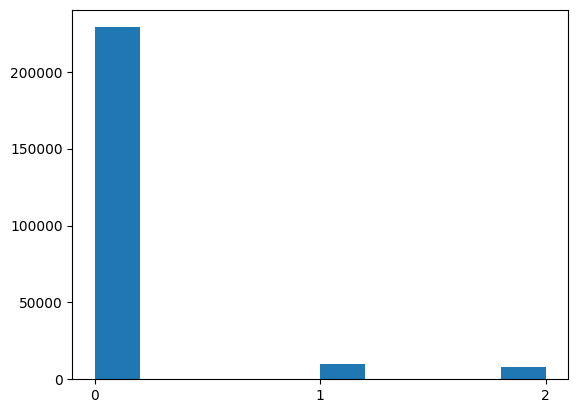

[228929   9691   7994]


In [ ]:
# concatanate all the labels arrays to see the complete distribution of labels in the dataset
labels_flat = np.concatenate(labels, axis=0)
labels_flat.shape

# Create label histogram
unique, label_counts = np.unique(labels_flat, return_counts=True)
plt.hist(labels_flat)
plt.show()
print(label_counts) # [228929   9691   7994]

## 4.2 Plot signal length distribution

Text(0.5, 1.0, 'Signal length distribution')

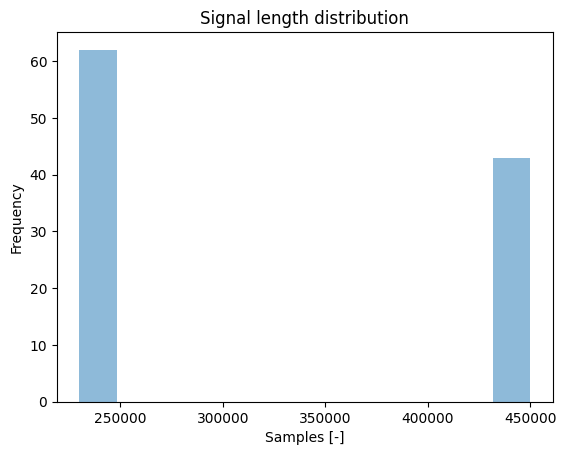

In [ ]:
length_recordings = list()

# Iterate through the different signals stored in "recordings":
# store signal length in terms of number of samples.
for rec_temp in recordings:
  length_recordings.append(len(rec_temp))

# Transform to pandas series and plot histogram.
length_recordings = pd.Series(length_recordings)
ax = length_recordings.plot.hist(bins=12, alpha=0.5)
ax.set_xlabel("Samples [-]")
ax.set_title("Signal length distribution")

# 5 Signal processing

## 5.1 Resampling

In [ ]:
pbar = ProgressBar()
new_fs = 128

# Resample" recordings to match the sampling frequency of 128Hz
recordings_resampled = list()
for i, rec in pbar(enumerate(recordings)):
  fs = LIST[i][0][3]
  # if the sampling frequency of the patient is different from 128 Hz
  if fs != new_fs:
    recording_resampled = resample(rec, int(rec.shape[0]*new_fs/fs))
  # if the sampling frequency of the patient is already 128 Hz i do not have to resample his signal
  else:
    recording_resampled = rec
  recording_resampled = np.squeeze(recording_resampled)
  recordings_resampled.append(recording_resampled)

In [ ]:
# useful functions

# takes as input the samples and the sampling frequency
# and outputs the related time step of the samples
def SAMPLES_TO_TIME(samples, fs):
  return samples/fs

# takes as input the time step and the sampling frequency
# and outputs the related index in terms of number of samples
def TIME_TO_SAMPLES(time, fs):
  return int(time*fs)

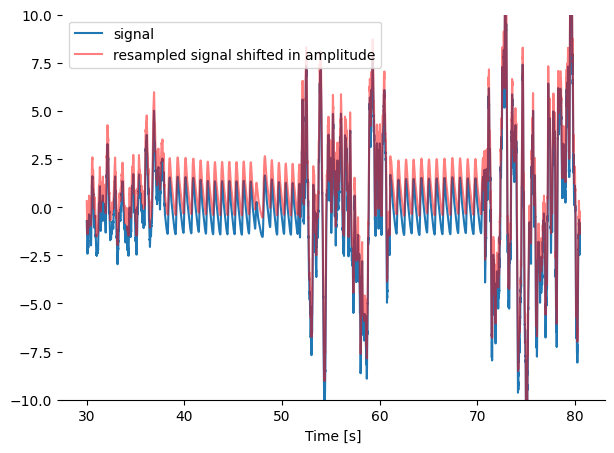

In [ ]:
# Plot the signal of the given patient

patient = 70

# Extract the recording of the patient
ppg_signal = recordings[patient]
ppg_signal = np.squeeze(ppg_signal) # otherwise it has incompatible dimensions with idx_peaks when we plot it

# Extract the resampled recording of the patient
ppg_signal_resampled = recordings_resampled[patient]
ppg_signal_resampled = np.squeeze(ppg_signal_resampled)

# Extract the peaks of the patient
idx_peaks = peaks[patient] #_resampled
peaks_values = ppg_signal[idx_peaks.astype(int)]

# Extract the labels of the patient
labels_patient = labels[patient]

# Count and return the number of normal, supraventricular (PAC), and ventricular (PVC) beats
unique, counts = np.unique(labels_patient, return_counts=True)
# print("The patient has " + str(counts[1]) + " supraventricular beats and " + str(counts[2]) + " ventricular beats")

# extract the frequency of the patient
fs = LIST[patient][0][3]

# generate number of samples starting from time in [s]
min_n_samples = TIME_TO_SAMPLES(30, fs)
max_n_samples = TIME_TO_SAMPLES(80.5, fs)

# generate time starting from min_n_samples and max_n_samples
min_time_portion = SAMPLES_TO_TIME(min_n_samples, fs)
max_time_portion = SAMPLES_TO_TIME(max_n_samples, fs) # [s]; max_n_samples = ppg_signal.shape[0], max_time_red = 1800 s

# Time signal
time = np.arange(0,SAMPLES_TO_TIME(ppg_signal.shape[0],fs),1/fs) # spacing in signal is 1/fs
time_portion = np.arange(min_time_portion,max_time_portion,1/fs)

# Time resampled signal
time_res = np.arange(0,SAMPLES_TO_TIME(ppg_signal_resampled.shape[0],new_fs), 1/new_fs) # spacing in resampled signal is 1/new_fs
time_res_portion = np.arange(min_time_portion, max_time_portion, 1/new_fs)

# Plot the signal in the chosen time portion
fig, axs = plt.subplots(figsize=(7,5))
#axs.set_title("Patient: " + str(patient) + "    fs: " + str(fs))
axs.plot(time_portion, ppg_signal[min_n_samples:max_n_samples], color='C0', label='signal', alpha = 1) # plot from 0

# Plot the resampled signal in the chosen time portion
min_n_samples_res = TIME_TO_SAMPLES(min_time_portion, new_fs)
max_n_samples_res = TIME_TO_SAMPLES(max_time_portion, new_fs)
axs.plot(time_res_portion, ppg_signal_resampled[min_n_samples_res:max_n_samples_res]+1, color='r', alpha = 0.5, label='resampled signal shifted in amplitude')
# add +1 to ppg_signal_resampled to generate an offset in the plot, to make them more distinguishable

axs.set_xlabel("Time [s]")
#axs.set_ylabel("Amplitude")
plt.legend()
plt.ylim(-10,10)

## Remove borders
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
#plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)

plt.show()
# From the plot it is possible to note the slight difference between the two signals

In [ ]:
# Convert labels and peaks to match the new samples after the resampling

peaks_resampled = []
for i in range(len(peaks)): # peaks is a list
  fs = LIST[i][0][3]
  peaks_res_signal = peaks[i]*new_fs/fs
  peaks_resampled.append(peaks_res_signal)
  peaks_resampled[i].sort()

peaks_resampled_array = np.array(peaks_resampled, dtype=object)

## 5.2 Artifact removal

(sd(PSD[>20Hz])>0.1)

In [ ]:
# takes as input a signal and removes the artifacts, outputs the clean signal
# computes the periodogram of portions of the signal made up of 256 samples
# and removes those portions having a high standard deviation in high frequencies:
# these are frequencies not belonging to the physiological heart rate
# but to the noise
def artifact_removal_PSD(resampled_signal):
  res_signal = np.copy(resampled_signal)
  i = 0
  while i <= len(res_signal):
    # compute the periodogram representing the PSD of the signal
    (f_template, S_template) = sig.periodogram(res_signal[i:i+256], new_fs, scaling='density') # consider a template of 256 samples
    # the PSD of the noisy signal strongly fluctuates while the one of the clean signal does not.
    # exploit this info to eliminate the part of the signal which exceeds a std threshold
    if(np.std(S_template[np.where(f_template>20)])>0.0002):
      res_signal[i:i+256] = 0
    i+=256 # go to the next 256 samples
  return res_signal

def bw_filter(resampled_signal): # this refers to next section
  cutoff_lowf = 0.5
  cutoff_highf = 5
  b, a = sig.butter(3, [cutoff_lowf, cutoff_highf], btype='bandpass', analog=False, output='ba', fs=new_fs)
  y_bwfilt = sig.filtfilt(b, a, resampled_signal)
  return y_bwfilt

In [ ]:
# remove artifacts from the resampled signals
res_no_artf = []
recordings_resampled_copy =  np.array(recordings_resampled, dtype=object)
for i in range(len(recordings_resampled_copy)):
  res_no_artf_signal = artifact_removal_PSD(recordings_resampled_copy[i])
  res_no_artf.append(res_no_artf_signal)
ppg_signals_noartf = np.array(res_no_artf,  dtype=object)

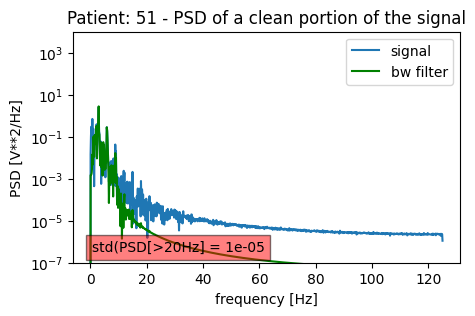

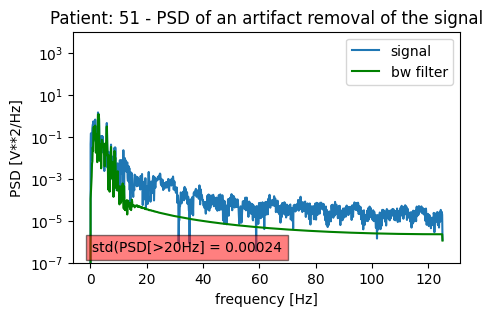

In [ ]:
min_clean = 0 # Select minimum number of samples to plot
max_clean = 2000 # Select maximum number of samples to plot

patient = 51

signal_temp = recordings_resampled[patient]
y_bwfilt = bw_filter(ppg_signals_noartf[patient]) # see next section for bw_filter

plt.figure(figsize=(5,3))
(f_clean, S_clean) = sig.periodogram(signal_temp[min_clean:max_clean], fs, scaling='density')
(f_bwfilt, S_bwfilt) = sig.periodogram(y_bwfilt[min_clean:max_clean], fs, scaling='density', )
plt.semilogy(f_clean, S_clean, label='signal')
plt.semilogy(f_bwfilt, S_bwfilt, color='g', label='bw filter')
#plt.ylim([1e-7, 1e2])
#plt.xlim([0,100])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.legend()
plt.title('Patient: ' + str(patient) + ' - PSD of a clean portion of the signal')
#print(f_clean)
value_clean = np.std(S_clean[np.where(f_clean>20)])
plt.text(0.05, 0.05, f'std(PSD[>20Hz] = {np.round(value_clean,5)}',
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='red', alpha=0.5))
plt.ylim([10e-8,10e3])
plt.show()

min_noise = 4000
max_noise = 6000

(f_noise, S_noise) = sig.periodogram(signal_temp[min_noise:max_noise], fs, scaling='density')
(f_bwfilt, S_bwfilt) = sig.periodogram(y_bwfilt[min_noise:max_noise], fs, scaling='density')
plt.figure(figsize=(5,3))
plt.semilogy(f_noise, S_noise, label='signal')
plt.semilogy(f_bwfilt, S_bwfilt, color='g', label='bw filter')
#plt.ylim([1e-7, 1e2])
#plt.xlim([0,100])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.legend()
plt.title('Patient: ' + str(patient) + ' - PSD of an artifact removal of the signal')
#print(f_noise)
value_noise = np.std(S_noise[np.where(f_noise>20)])
plt.text(0.05, 0.05, f'std(PSD[>20Hz] = {np.round(value_noise,5)}',
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='red', alpha=0.5))
plt.ylim([10e-8,10e3])
plt.show()

#+ str{value_clean}

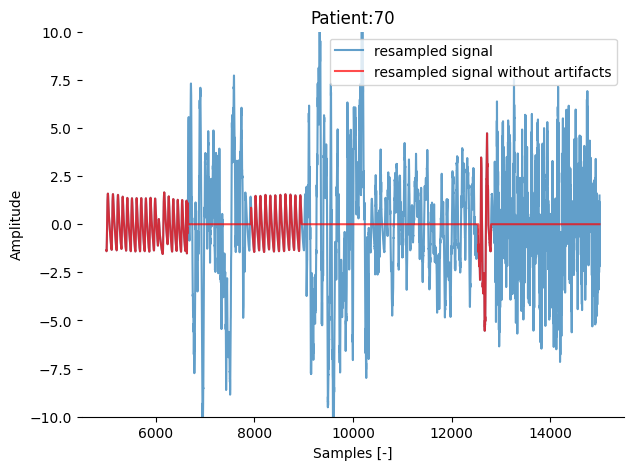

In [ ]:
# Plot the clean signal
min_n_samples = 5000
max_n_samples = 15000 #signal_temp_res.shape[0]-1
patient = 70

def addlabels(x,y,array):
    for i in range(len(x)):
        plt.text(x[i],y[i],array[i])

t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; signal_temp.shape[0]/fs; 0,10,1/fs
ppg_signal_resampled = recordings_resampled_copy[patient]


idx_peaks = peaks_resampled_array[patient]
peaks_values = ppg_signals_noartf[patient][idx_peaks.astype(int)] #ppg_signals_noartf
# Extract the labels of the patient
labels_pat = labels[patient]
#fig, axs = plt.subplots(figsize=(10,5))
plt.figure(figsize=(7,5))
plt.title("Patient:" + str(patient)) # axs set_title
plt.plot(t, ppg_signal_resampled[min_n_samples:max_n_samples], color='C0', alpha=0.7, label='resampled signal')
plt.plot(t, ppg_signals_noartf[patient][min_n_samples:max_n_samples], color='r', alpha=0.7, label='resampled signal without artifacts')

i_min = 0
while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
  i_min+=1
i_max = i_min
while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
  i_max+=1
#plt.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H") # axs
#addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
plt.xlabel("Samples [-]") # axs set_
plt.ylabel("Amplitude") # axs set_
plt.ylim(-10,10)

## Remove borders
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
#plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)

plt.legend()
plt.show()



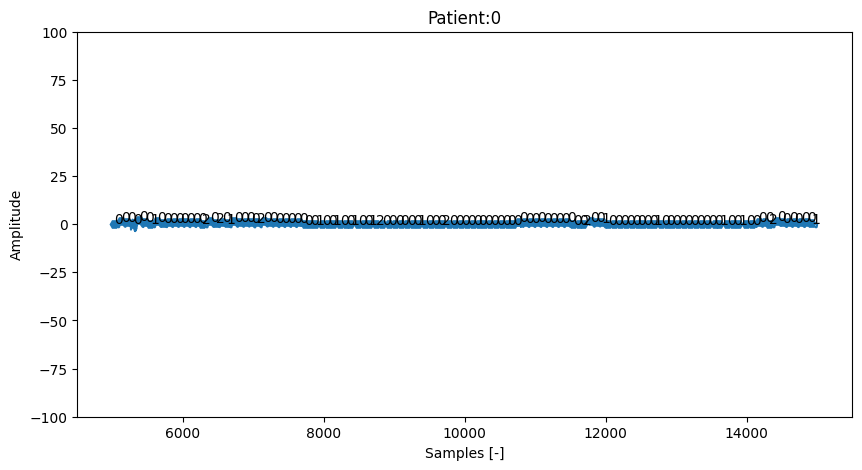

In [ ]:
# Plot the clean signal
min_n_samples = 5000
max_n_samples = 15000 #signal_temp_res.shape[0]-1

def addlabels(x,y,array):
    for i in range(len(x)):
        plt.text(x[i],y[i],array[i])

t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; signal_temp.shape[0]/fs; 0,10,1/fs

patient = 0
idx_peaks = peaks_resampled_array[patient]
peaks_values = ppg_signals_noartf[patient][idx_peaks.astype(int)] #ppg_signals_noartf
# Extract the labels of the patient
labels_pat = labels[patient]
fig, axs = plt.subplots(figsize=(10,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, ppg_signals_noartf[patient][min_n_samples:max_n_samples], color='C0')
i_min = 0
i_max = 0
while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
  i_min+=1
  i_max = i_min
while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
  i_max+=1
axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-100,100)
plt.show()

## 5.3 Filtering

In [ ]:
# useful functions

# takes as input a signal and applies the Butterworth filter,
# outputs the filtered signal
def bw_filter(resampled_signal):
  cutoff_lowf = 0.5
  cutoff_highf = 5
  b, a = sig.butter(3, [cutoff_lowf, cutoff_highf], btype='bandpass', analog=False, output='ba', fs=new_fs)
  y_bwfilt = sig.filtfilt(b, a, resampled_signal)
  return y_bwfilt

In [ ]:
# filter the clean signal for all the patients

filtered_ppg_signals_noart = []
for i in range(len(ppg_signals_noartf)):
  filtered_ppg_signals_noart.append(bw_filter(ppg_signals_noartf[i]))

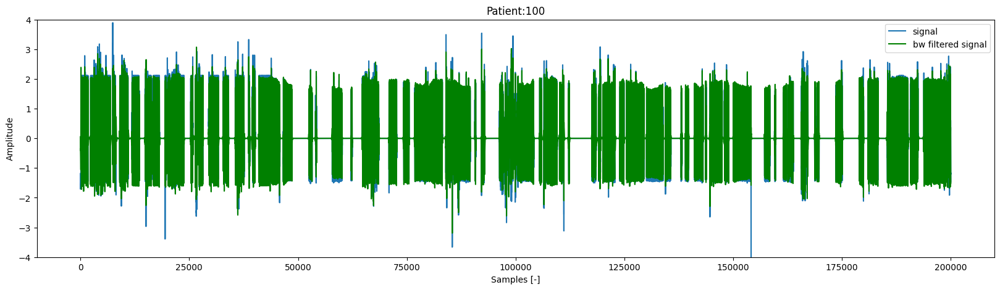

In [ ]:
# Plot
patient = 100
min_n_samples = 0
max_n_samples = 200000
t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; ppg_signal.shape[0]/fs; 0,10,1/fs
fig, axs = plt.subplots(figsize=(20,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, ppg_signals_noartf[patient][min_n_samples:max_n_samples], color='C0', label='signal')
axs.plot(t, filtered_ppg_signals_noart[patient][min_n_samples:max_n_samples], color='g', label='bw filtered signal')
#axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
#addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-4,4)
plt.legend()
plt.show()

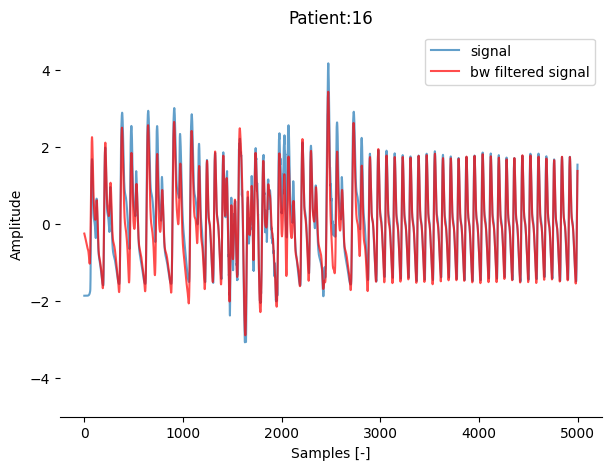

In [ ]:
# Plot
patient = 16
min_n_samples = 0
max_n_samples = 5000
t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; ppg_signal.shape[0]/fs; 0,10,1/fs
fig, axs = plt.subplots(figsize=(7,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, ppg_signals_noartf[patient][min_n_samples:max_n_samples], color='C0', alpha=0.7, label='signal')
axs.plot(t, filtered_ppg_signals_noart[patient][min_n_samples:max_n_samples], color='r', alpha=0.7, label='bw filtered signal')
#axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
#addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-5,5)
plt.legend()

## Remove borders
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
#plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)

plt.show()

## 5.4 Patients removal

In [ ]:
# remove the patients that are too messy by visual inspection (patients 90 and 103)

# update the list of filtered ppg signals
ppg_signals_noartf_nomessy = []
for i in range(len(ppg_signals_noartf)):
  if i!=90 and i!=103 and ((LABELS[i]=='1').sum() != 0 or (LABELS[i]=='2').sum() != 0): # patient must not be 90 or 103, and must have at least one PVC or one PAC
    ppg_signals_noartf_nomessy.append(ppg_signals_noartf[i])

# update the list of filtered ppg signals without the artifacts
filtered_ppg_signals_noart_nomessy = []
for i in range(len(filtered_ppg_signals_noart)):
  if i!=90 and i!=103 and ((LABELS[i]=='1').sum() != 0 or (LABELS[i]=='2').sum() != 0):
    filtered_ppg_signals_noart_nomessy.append(filtered_ppg_signals_noart[i])

# update the list of resampled peaks indexes
peaks_resampled_nomessy = []
for i in range(len(peaks_resampled)):
  if i!=90 and i!=103 and ((LABELS[i]=='1').sum() != 0 or (LABELS[i]=='2').sum() != 0):
    peaks_resampled_nomessy.append(peaks_resampled[i])

# update the list of labels
labels_nomessy = []
for i in range(len(LABELS)):
  if i!=90 and i!=103 and ((LABELS[i]=='1').sum() != 0 or (LABELS[i]=='2').sum() != 0):
    labels_nomessy.append(LABELS[i])


print(len(labels_nomessy)) # This corresponds to the number of patients left after removal


91


91.79% 4.5% 3.71%


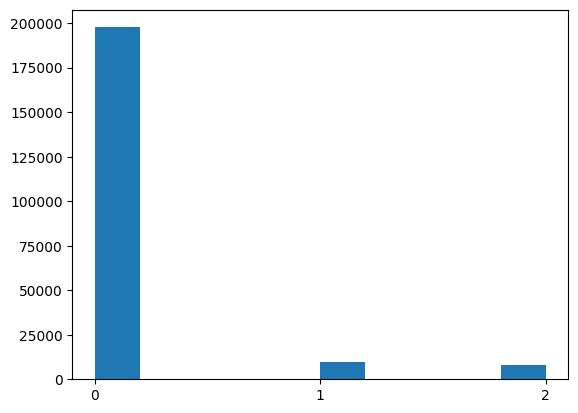

[197665   9691   7994]


In [ ]:
# concatanate all the labels arrays to see the complete distribution of labels in the dataset
labels_flat = np.concatenate(labels_nomessy, axis=0)
labels_flat.shape

# Create label histogram
unique, label_counts = np.unique(labels_flat, return_counts=True)
total_samples = len(labels_flat)
print(f"{np.round(label_counts[0]/total_samples*100,2)}% {np.round(label_counts[1]/total_samples*100,2)}% {np.round(label_counts[2]/total_samples*100,2)}%")
plt.hist(labels_flat)
plt.show()
print(label_counts) # initial proportions: [228929   9691   7994]

## 5.5 Segmentation

In [ ]:
# useful functions

# takes as input a portion of a signal and finds the minimum
# outputs the index of the
def find_min(signal_chunk):
  min = signal_chunk[0]
  index_min = 0
  for j in np.arange(0,len(signal_chunk)):
    if signal_chunk[j]<min:
      min = signal_chunk[j]
      index_min = j

  return index_min

In [ ]:
# find all the minima between any pair of peaks
# store signal segments spanning from the minimum with respect to the previous peak
# to the minimum with respect to the following peak

total_segments=[]
total_segments_ampl=[]
total_peaks=[]
total_labels=[]
total_minima = []
#total_minima_onset = []
#total_minima_end = []
total_segments_removed=[]
total_segments_ampl_removed=[]
total_peaks_removed=[]
total_labels_removed=[]
total_minima_removed = []
#total_minima_onset_removed = []
#total_minima_end_removed = []

for patient in np.arange(0,len(ppg_signals_noartf_nomessy)):

  minima=[]
  segment_peaks = []
  segment_labels = []
  segments_ampl = []
  #segments_minima_onset = []
  #segments_minima_end = []
  segments = []
  segment_peaks_removed = []
  segment_labels_removed = []
  segments_ampl_removed = []
  #segments_minima_onset_removed = []
  #segments_minima_end_removed = []
  segments_removed = []
  k = -1
  end_sequence = False
  is_next_peak_minimum = False

  for i in np.arange(0,len(peaks_resampled_nomessy[patient])-1):

    # if the current peak is the minimum with respect to the previous peak
    # it stops the consecutive sequence of peaks and goes to the next peak
    if is_next_peak_minimum:
      end_sequence = True
      is_next_peak_minimum = False
    else:
      is_peak_minimum = False
      is_next_peak_minimum = False

      # if the peak has been zeroed by the artifacts removal: its sorrounding samples have been zeroed too
      # the peak is not considered and the consecutive sequence of peaks is stopped
      if (ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i][0])] == 0 and ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i][0]) + 1] == 0 and ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i][0]) - 1] == 0):
        end_sequence = True

      else:
        # if it is the first peak: find and store the minimum between the first sample and the peak
        # in this case only, consider the filtered signal since in the unfiltered one
        # the first segment is longer than normal
        if i==0:
          index_min = find_min(filtered_ppg_signals_noart_nomessy[patient][0:int(peaks_resampled_nomessy[patient][i][0])])
          minima.append(index_min)
          k = k + 1


        # if it is the first peak of a new sequence: find and store the minimum between the previous peak and the current one
        if end_sequence:
          index_min = find_min(ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i-1][0]):int(peaks_resampled_nomessy[patient][i][0])])
          minima.append(int(peaks_resampled_nomessy[patient][i-1][0]) + index_min)
          k = k + 1
          end_sequence = False

        # if it is the last peak: find and store the minimum between the current peak and the last sample
        if i==len(peaks_resampled_nomessy[patient])-1:
          index_min = find_min(ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i][0]):ppg_signals_noartf_nomessy[patient][-1][0]])
          minima.append(int(peaks_resampled_nomessy[patient][i][0]) + index_min)
          k = k + 1

        # consider the portion of signal spanning from the current peak to the following one
        v = ppg_signals_noartf_nomessy[patient][int(peaks_resampled_nomessy[patient][i][0]):int(peaks_resampled_nomessy[patient][i+1][0])]
        # find the minimum of the portion of signal
        index_min = find_min(v)
        minima.append(int(peaks_resampled_nomessy[patient][i][0]) + index_min)
        k = k + 1

        # if the minimum corresponds to the current peak
        if index_min == 0:
          is_peak_minimum = True
        # if the minimum corresponds to the following peak
        if index_min == len(v)-1:
          is_next_peak_minimum = True

        # if the current peak is not the minimum with respect to the following peak
        # store the related segment, peak and label
        if not(is_peak_minimum):
          segments.append(list(np.arange(minima[k-1], minima[k])))
          segments_ampl.append(filtered_ppg_signals_noart_nomessy[patient][minima[k-1]:minima[k]])
          # store the peaks_res that are present in the segments
          segment_peaks.append(peaks_resampled_nomessy[patient][i][0])
          # store the labels that are present in the segments
          segment_labels.append(labels_nomessy[patient][i])
          #segments_minima_onset.append(minima[k-1])
          #segments_minima_end.append(minima[k])
        else:
          # even though these does not coincide with all removed segments, this datasets serves only as a
          # noisy dataset to assess the performances of the autoencoder, so there's no need to be extremely accurate in this save.
          segments_removed.append(list(np.arange(minima[k-1], (minima[k]))))
          segments_ampl_removed.append(filtered_ppg_signals_noart_nomessy[patient][minima[k-1]:minima[k]]) #+1
          # store the peaks_res that are present in the segments
          segment_peaks_removed.append(peaks_resampled_nomessy[patient][i][0])
          # store the labels that are present in the segments
          segment_labels_removed.append(labels_nomessy[patient][i])
          #segments_minima_onset.append(minima[k-1])
          #segments_minima_end.append(minima[k])

  # store the list of all segments, peaks, labels, minima for each patient
  total_segments.append(segments)
  total_segments_ampl.append(segments_ampl)
  total_peaks.append(segment_peaks)
  total_labels.append(segment_labels)
  total_minima.append(minima)
  #total_minima_onset.append(segments_minima_onset)
  #total_minima_end.append(segments_minima_end)
  total_segments_removed.append(segments_removed)
  total_segments_ampl_removed.append(segments_ampl_removed)
  total_peaks_removed.append(segment_peaks)
  total_labels_removed.append(segment_labels)
  #total_minima_onset.append(segments_minima_onset)
  #total_minima_end.append(segments_minima_end)

# sanity check
'''
print(len(total_segments), len(total_minima_onset), len(total_minima_end)) # must be equal
print(total_segments[0][1][0], total_minima_onset[0][1]) # must be equal
print(total_segments[0][1][-1], total_minima_end[0][1]) # total_minima_end[0][1] = total_segments[0][1][-1]+1
'''

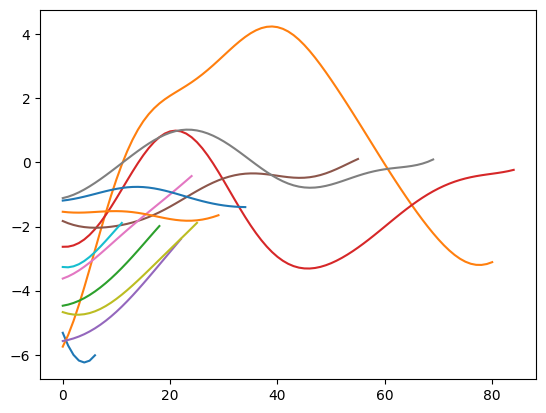

In [ ]:
for removed_segment in range(len(total_segments_ampl_removed[44])):
  plt.plot(total_segments_ampl_removed[44][removed_segment])
  if removed_segment>10: break


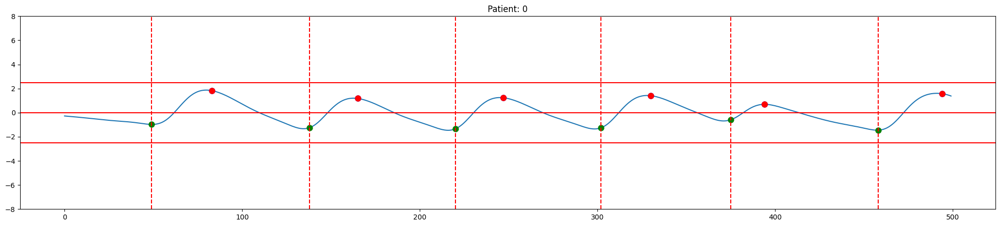

In [ ]:
# plot the signal with the original peaks (blue),
# the stored peaks (red), segments (between pairs of vertical lines) and minima (green)

min_n_samples = 0
max_n_samples = 500
patient = 0

# plot
t = np.arange(min_n_samples,max_n_samples,1) # ppg_signal_noartf is a column vector; ppg_signal_noartf.shape[0]/fs; 0,10,1/fs
t_min = np.arange(0, len(total_minima[patient]))
idx_peaks = total_peaks[patient]
idx_peaks_original = peaks_resampled_nomessy[patient]

i_min = 0
while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
  i_min+=1
i_max = i_min
while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
  i_max+=1

i_min_original = 0
while(idx_peaks_original[i_min_original]<min_n_samples): # iterate until the minimum index is found
  i_min_original+=1
i_max_original = i_min_original
while(idx_peaks_original[i_max_original]<max_n_samples): # iterate until the maximum index is found
  i_max_original+=1

i_min_MP = 0
while(total_minima[patient][i_min_MP]<min_n_samples): # iterate until the minimum index is found
  i_min_MP+=1
i_max_MP = i_min_MP
while(total_minima[patient][i_max_MP]<max_n_samples): # iterate until the maximum index is found
  i_max_MP+=1


fig, axs = plt.subplots(figsize=(25,5))
axs.set_title("Patient: " + str(patient))
plt.ylim([-8,8])
axs.plot(t, filtered_ppg_signals_noart_nomessy[patient][min_n_samples:max_n_samples], color='C0')
plt.plot(total_minima[patient][i_min_MP:i_max_MP], filtered_ppg_signals_noart_nomessy[patient][total_minima[patient][i_min_MP:i_max_MP]], marker='o', linestyle='', color='green', markersize=8)
original_peak_indeces = [int(x) for x in idx_peaks_original[i_min_original:i_max_original]]
plt.plot(original_peak_indeces, filtered_ppg_signals_noart_nomessy[patient][original_peak_indeces], marker='o', linestyle='', color='b', markersize=8)
peak_indeces = [int(x) for x in idx_peaks[i_min:i_max]]
plt.plot(peak_indeces, filtered_ppg_signals_noart_nomessy[patient][peak_indeces], marker='o', linestyle='', color='red', markersize=8)
for position in total_minima[patient][i_min_MP:i_max_MP]:
    plt.axvline(x=position, color='red', linestyle='--', label=f'x = {position}')
plt.axhline(y=2.5, color='r', linestyle='-')
plt.axhline(y=0, color='r', linestyle='-')
plt.axhline(y=-2.5, color='r', linestyle='-')

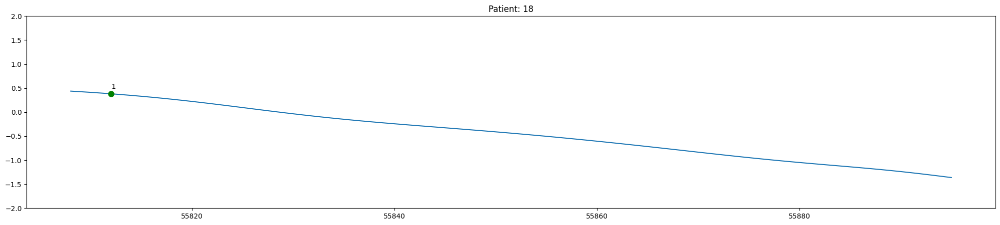

In [ ]:
# plot the single segments

patient = 18
first_segment_toplot = 302
last_segment_toplot =  304

# plot
for i in range(len(total_segments[patient])):
  if i>first_segment_toplot and i<last_segment_toplot:
    t = np.arange(total_segments[patient][i][0],total_segments[patient][i][len(total_segments[patient][i])-1])
    fig, axs = plt.subplots(figsize=(25,5))
    axs.set_title("Patient: " + str(patient))
    plt.ylim([-2,2])
    axs.plot(t, filtered_ppg_signals_noart_nomessy[patient][total_segments[patient][i][0]:total_segments[patient][i][len(total_segments[patient][i])-1]], color='C0')
    plt.plot(int(total_peaks[patient][i]), filtered_ppg_signals_noart_nomessy[patient][int(total_peaks[patient][i])], marker='o', linestyle='', color='green', markersize=8)
    plt.text(int(total_peaks[patient][i]), filtered_ppg_signals_noart_nomessy[patient][int(total_peaks[patient][i])]+0.1, total_labels[patient][i])


In [ ]:
# retrieve total segment amplitudes
total_segments_ampl = list()

for i in range(len(total_segments)): # iterate on the patients
  total_segments_ampl_seq = list()
  for j in range(len(total_segments[i])): # iterate on the number of segments of that patient
    first_idx = total_segments[i][j][0]
    last_idx = total_segments[i][j][-1]
    segments_ampl_seq = filtered_ppg_signals_noart_nomessy[i][first_idx:(last_idx+1)]
    total_segments_ampl_seq.append(segments_ampl_seq)
  total_segments_ampl.append(total_segments_ampl_seq)

# Sanity check
total_segments_ampl = np.array(total_segments_ampl, dtype=object)
#print(len(total_segments_ampl[0]), len(total_peaks[0]))
#print(total_segments_ampl[0][1][int(total_peaks[0][1])-int(total_segments[0][1][0])])

In [ ]:
# store the indexes of the maxima of all the segments:
# due to distortion, some peaks do not correspond to the real maxima

def find_max(signal_chunk):
      max = np.max(signal_chunk)
      index_max = np.where(signal_chunk==max)
      return max, index_max

In [ ]:
# sift the segments, filtering out those not complying with some thresholds and conditions

total_segments_nomessy = []
total_segments_nomessy_ampl = []
total_peaks_nomessy=[]
total_labels_nomessy=[]
# amplitude thresholds
threshold_max = 2.5
threshold_min = -2.5
# physiologically plausible heart rates: 30-220 bpm -> 0.5-3.67 Hz -> (*new_fs) -> 64-469.33 samples -> add a safety margin
min_interval = 65
max_interval = 465
# threshold in amplitude between actual peak and labelled peak
ampl_from_peak_thresh = 0.1

for patient in range(len(total_segments)):
  segments_patient = []
  segments_ampl_patient = []
  peaks_patient = []
  labels_patient = []
  segment_peaks_removed = []
  segment_labels_removed = []
  segments_ampl_removed = []
  #segments_minima_onset_removed = []
  #segments_minima_end_removed = []
  for i in range(len(total_segments[patient])):
    #pulse = create_pulse(patient, i)
    # compute the real maximum and minimum of the segment and all its local maxima (peaks)
    max, max_index = find_max(total_segments_ampl[patient][i])
    min = np.min(total_segments_ampl[patient][i])
    peaks = sig.find_peaks(total_segments_ampl[patient][i])

    # if the segment respects the conditions both on the amplitude and on the length of the interval, then it can be stored
    if (min >= threshold_min and max <= threshold_max
        and len(total_segments[patient][i]) >= min_interval and len(total_segments[patient][i]) <= max_interval ## Physiological ranges
        and abs(total_segments_ampl[patient][i][int(total_peaks[patient][i]-total_segments[patient][i][0])]-total_segments_ampl[patient][i][max_index])<=ampl_from_peak_thresh
        and (len(peaks[0])==1 or (len(peaks[0])>1 and total_segments_ampl[patient][i][peaks[0][0]] > total_segments_ampl[patient][i][peaks[0][1]]))):
      segments_patient.append(total_segments[patient][i])
      segments_ampl_patient.append(total_segments_ampl[patient][i])
      peaks_patient.append(total_peaks[patient][i])
      labels_patient.append(total_labels[patient][i])
    else:
      segments_removed.append(total_segments[patient][i])
      segments_ampl_removed.append(total_segments_ampl[patient][i])
      # store the peaks_res that are present in the segments
      segment_peaks_removed.append(total_peaks[patient][i])
      # store the labels that are present in the segments
      segment_labels_removed.append(total_labels[patient][i])
      #segments_minima_onset.append(minima[k-1])
      #segments_minima_end.append(minima[k])

  total_segments_nomessy.append(segments_patient)
  total_segments_nomessy_ampl.append(segments_ampl_patient)
  total_peaks_nomessy.append(peaks_patient)
  total_labels_nomessy.append(labels_patient)
  total_segments_removed.append(segments_removed)
  total_segments_ampl_removed.append(segments_ampl_removed)
  total_peaks_removed.append(segment_peaks)
  total_labels_removed.append(segment_labels)



In [ ]:
# print the total number of segments stored after all the pre-processing steps for each patient

for i in range(len(total_segments_nomessy)):
  print(len(total_segments_nomessy[i]))

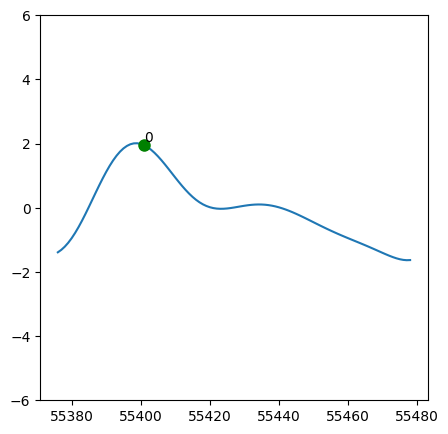

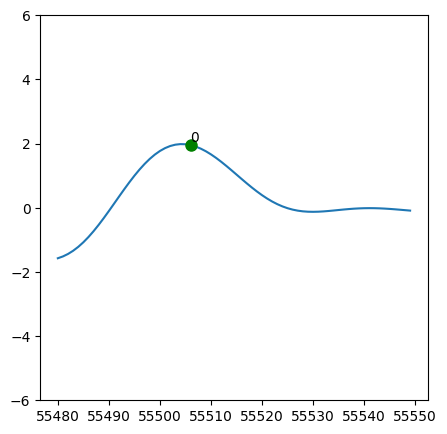

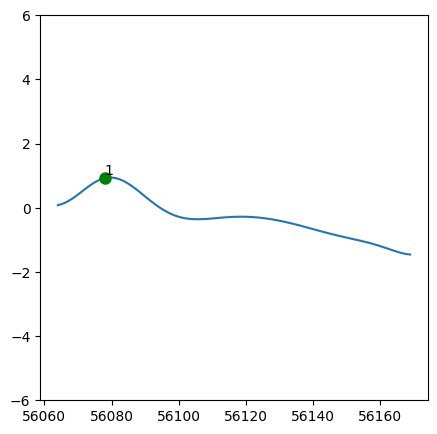

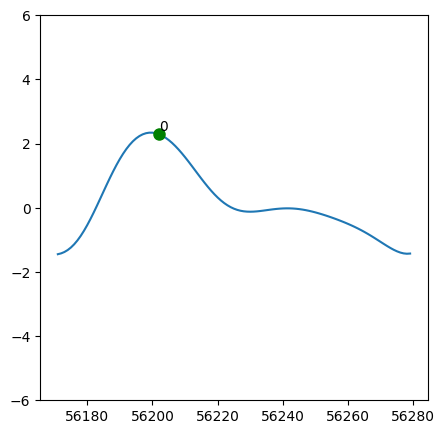

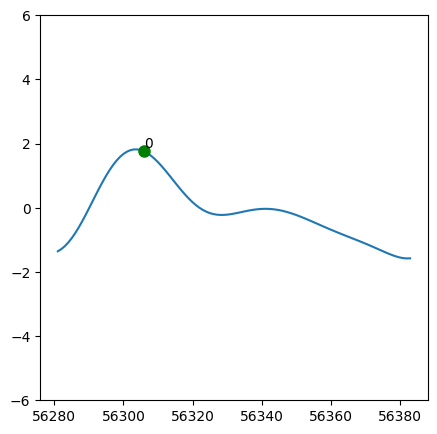

...

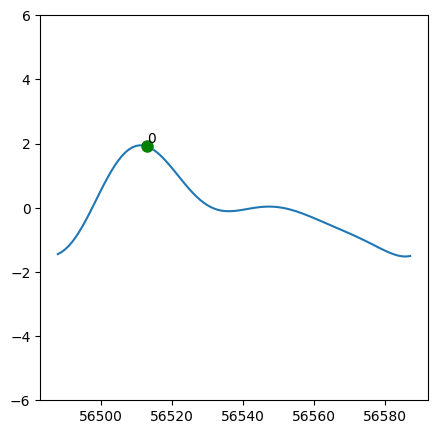

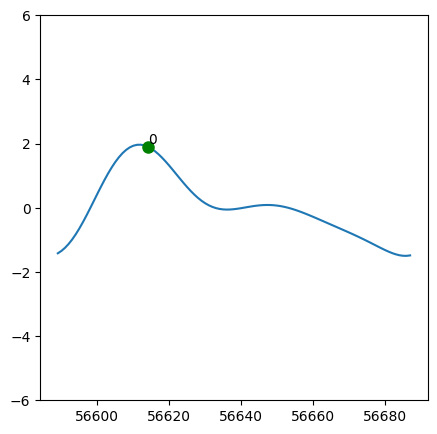

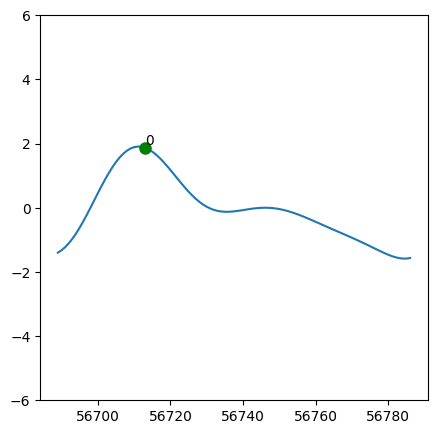

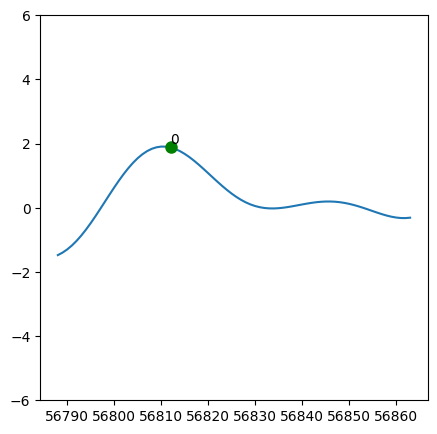

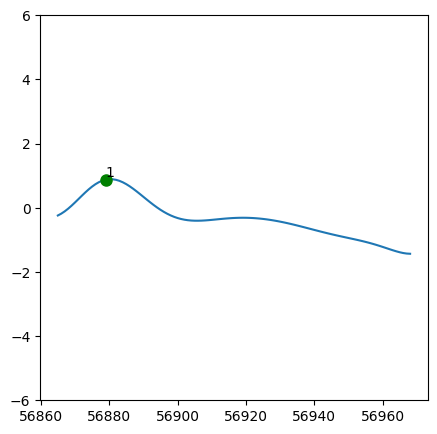

In [ ]:
# plot the stored segments

first_patient_toplot = 1
last_patient_toplot = 1
first_segment_toplot = 235
last_segment_toplot = 245

for i in range(len(total_segments_nomessy)):
  if i >=first_patient_toplot and i<=last_patient_toplot:
    for j in range(len(total_segments_nomessy[i])):
      if j >= first_segment_toplot and j <= last_segment_toplot:
        t = np.arange(total_segments_nomessy[i][j][0],total_segments_nomessy[i][j][-1])
        fig, axs = plt.subplots(figsize=(5,5))
        plt.ylim([-6,6])
        axs.plot(t, filtered_ppg_signals_noart_nomessy[i][total_segments_nomessy[i][j][0]:total_segments_nomessy[i][j][-1]], color='C0')
        plt.plot(int(total_peaks_nomessy[i][j]), filtered_ppg_signals_noart_nomessy[i][int(total_peaks_nomessy[i][j])], marker='o', linestyle='', color='green', markersize=8)
        plt.text(int(total_peaks_nomessy[i][j]), filtered_ppg_signals_noart_nomessy[i][int(total_peaks_nomessy[i][j])]+0.1, total_labels_nomessy[i][j])

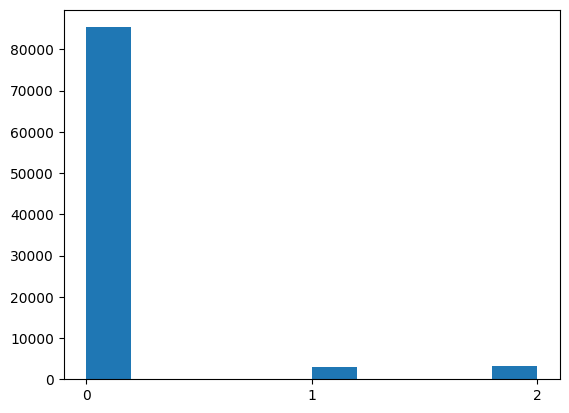

[85359  3096  3327]


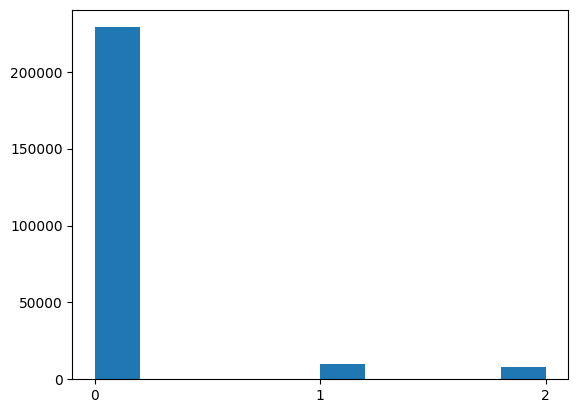

[228929   9691   7994]
Reduction by [62.71376715 68.05283253 58.38128596]%


In [ ]:
# concatanate all the labels arrays to see the complete distribution of labels in the dataset
total_labels_nomessy_flat = np.concatenate(total_labels_nomessy, axis=0)

# Create label histogram
unique_init, label_counts_init = np.unique(total_labels_nomessy_flat, return_counts=True)
plt.hist(total_labels_nomessy_flat)
plt.show()
print(label_counts_init)

# concatanate all the labels arrays to see the complete distribution of labels in the dataset
labels_flat = np.concatenate(labels, axis=0)

# Create label histogram
unique, label_counts = np.unique(labels_flat, return_counts=True)
plt.hist(labels_flat)
plt.show()
print(label_counts)
number = str((1 - label_counts_init/label_counts)*100)
print("Reduction by " + number + "%")

# initial dataset: [228929   9691   7994]

# peaks must be != 0 & upper threshold and peaks-maxima differences: [97566  4479  3506]
#   0 reduced to 42.62% --> 57.38% reduction
#   1 reduced to 46.22% --> 53.78% reduction
#   2 reduced to 43.86% --> 56.14% reduction
# peaks must be != 0 & upper and lower threshold: [99562 4621 3708]
#   0 reduced to 43.49% --> 56.51% reduction
#   1 reduced to 47.68% --> 52.32% reduction
#   2 reduced to 46.38% --> 53.62% reduction
# peaks must be > 0 & upper and lower threshold: [95859 3763 3064]
#   0 reduced to 41.87% --> 58.13% reduction
#   1 reduced to 38.83% --> 61.17% reduction
#   2 reduced to 38.33% --> 61.67% reduction

## 5.7 Pulse class

In [ ]:
# define a pulse class containing all its information
class PPG_pulse():
  def __init__(self, ID_subject, values, indexes, label, peak_idx, peak_value, onset_idx, onset_value, end_idx, end_value,):
    self.ID_subject = ID_subject
    self.label = label
    self.values = values
    self.indexes = indexes
    self.peak_idx = peak_idx
    self.peak_value = peak_value
    self.onset_idx = onset_idx
    self.onset_value = onset_value
    self.end_idx = end_idx
    self.end_value = end_value

In [ ]:
# useful functions
# create the pulse according to the absolute indexes (the ones from the original sequence)

# create an instance of a pulse specifying all its information
def create_pulse(patient, idx_segment):
  pulse = PPG_pulse(
              ID_subject = patient,
              label=total_labels_nomessy[patient][idx_segment],
              values = total_segments_nomessy_ampl[patient][idx_segment],
              indexes = total_segments_nomessy[patient][idx_segment],
              peak_idx=int(total_peaks_nomessy[patient][idx_segment]),
              peak_value=total_segments_nomessy_ampl[patient][idx_segment][int(total_peaks_nomessy[patient][idx_segment]-total_segments_nomessy[patient][idx_segment][0])],
              onset_idx=int(total_segments_nomessy[patient][idx_segment][0]),
              onset_value=total_segments_nomessy_ampl[patient][idx_segment][0],
              end_idx=int(total_segments_nomessy[patient][idx_segment][-1]),
              end_value=total_segments_nomessy_ampl[patient][idx_segment][total_segments_nomessy[patient][idx_segment][-1]-total_segments_nomessy[patient][idx_segment][0]])
  return pulse

# create an empty instance of a pulse
def create_nan_pulse(patient):
    nan_pulse = PPG_pulse(
              ID_subject = np.nan,
              label=np.nan,
              values=np.nan,
              indexes=np.nan,
              peak_idx=np.nan,
              peak_value=np.nan,
              onset_idx=np.nan,
              onset_value=np.nan,
              end_idx=np.nan,
              end_value=np.nan)
    return nan_pulse

# create the pulse with a different length, starting from the original pulse
def create_pulse_res(pulse, samples):
  resampled_values = resample(pulse.values, samples)
  pulse_res = PPG_pulse(
      ID_subject = pulse.ID_subject,
      label = pulse.label,
      values = resampled_values,
      indexes = np.arange(0,samples),
      peak_idx = np.where(np.max(resampled_values)),
      peak_value = np.max(resampled_values),
      onset_idx = 0,
      onset_value = resampled_values[0],
      end_idx = samples-1,
      end_value = resampled_values[-1]
  )
  return pulse_res

# create the pulse associated to the specified patient and segment
def create_currentprevfoll_pulses(patient, idx_segment):
    previous = -1
    current = 0
    following = 1
    # indexes are absolute
    # create the current pulse
    pulse = create_pulse(patient, idx_segment+current)
    end = False

    # create the following pulse, if present; otherwise: nan
    if((idx_segment+following) >= len(total_segments_nomessy[patient])): end = True
    if(not end and int(total_segments_nomessy[patient][idx_segment+following][0])==(pulse.end_idx+1)):
      following_pulse = create_pulse(patient, idx_segment+following)
    else:
        following_pulse = create_nan_pulse(patient)

    # create the previous pulse, if present; otherwise: nan
    if(int(total_segments_nomessy[patient][idx_segment+previous][-1])==(pulse.onset_idx-1)):
      previous_pulse = create_pulse(patient, idx_segment+previous)
    else:
        previous_pulse = create_nan_pulse(patient)

    return pulse, previous_pulse, following_pulse

# 6 Feature Extraction

### 6.1 Statistical features

In [ ]:
# mean, median standard deviation, variance, skewness, kurtosis of the segments
total_segments_nomessy_mean = []
total_segments_nomessy_median = []
total_segments_nomessy_std = []
total_segments_nomessy_variance = []
total_segments_nomessy_skew = []
total_segments_nomessy_kurtosis = []

for pat in range(len(total_segments_nomessy)):
  pat_segments_mean = []
  pat_segments_median = []
  pat_segments_std = []
  pat_segments_variance = []
  pat_segments_skew = []
  pat_segments_kurtosis = []
  for i in range(len(total_segments_nomessy[pat])):
    pat_segments_mean.append(np.mean(total_segments_nomessy_ampl[pat][i]))
    pat_segments_median.append(np.median(total_segments_nomessy_ampl[pat][i]))
    pat_segments_std.append(np.std(total_segments_nomessy_ampl[pat][i]))
    pat_segments_variance.append(stats.tvar(total_segments_nomessy_ampl[pat][i]))
    pat_segments_skew.append(stats.skew(total_segments_nomessy_ampl[pat][i]))
    pat_segments_kurtosis.append(stats.kurtosis(total_segments_nomessy_ampl[pat][i]))
  total_segments_nomessy_mean.append(pat_segments_mean)
  total_segments_nomessy_median.append(pat_segments_median)
  total_segments_nomessy_std.append(pat_segments_std)
  total_segments_nomessy_variance.append(pat_segments_variance)
  total_segments_nomessy_skew.append(pat_segments_skew)
  total_segments_nomessy_kurtosis.append(pat_segments_kurtosis)


In [ ]:
# Create a dataframe whose rows are the segments and whose columns are the extracted features
# plus the label of the segment and the patient to which a segment belongs
statistical_features_df = pd.DataFrame({})
tot_segments = 0

column_mean = []
column_median = []
column_std = []
column_var = []
column_skew = []
column_kurt = []
column_pat = []

for pat in range(len(total_segments_nomessy)):
  for i in range(len(total_segments_nomessy[pat])):
    column_mean.append(total_segments_nomessy_mean[pat][i])
    column_median.append(total_segments_nomessy_median[pat][i])
    column_std.append(total_segments_nomessy_std[pat][i])
    column_var.append(total_segments_nomessy_variance[pat][i])
    column_skew.append(total_segments_nomessy_skew[pat][i])
    column_kurt.append(total_segments_nomessy_kurtosis[pat][i])
    column_pat.append(pat)
  tot_segments += len(total_segments_nomessy[pat])

column_mean = np.array(column_mean, dtype=float)
column_median = np.array(column_median, dtype=float)
column_std = np.array(column_std, dtype=float)
column_var = np.array(column_var, dtype=float)
column_skew = np.array(column_skew, dtype=float)
column_kurt = np.array(column_kurt, dtype=float)
column_pat = np.array(column_pat, dtype=int)

statistical_features_df['Patient'] = column_pat
statistical_features_df['Segment'] = range(tot_segments)
statistical_features_df['mean'] = column_mean
statistical_features_df['median'] = column_median
statistical_features_df['std'] = column_std
statistical_features_df['variance'] = column_var
statistical_features_df['skewness'] = column_skew
statistical_features_df['kurtosis'] = column_kurt
statistical_features_df['label'] = total_labels_nomessy_flat

In [ ]:
statistical_features_df

,Patient,Segment,mean,median,std,variance,skewness,kurtosis,label
0,0,0,0.252763,0.173995,1.073207,1.164862,0.097711,-1.415185,0
1,0,1,-0.120224,-0.169474,0.896295,0.813263,0.032027,-1.405824,0
2,0,2,-0.053463,-0.080691,0.887138,0.796730,0.028999,-1.415568,0
3,0,3,0.297287,0.320566,0.806903,0.660135,-0.130631,-1.295951,0
4,0,4,-0.309600,-0.299551,0.673445,0.459059,-0.075974,-1.264756,1
...,...,...,...,...,...,...,...,...,...
91777,90,91777,-0.030194,-0.172093,0.897527,0.814814,0.567743,-0.711594,0
91778,90,91778,-0.009038,0.059613,0.914726,0.846125,0.353572,-0.844868,0
91779,90,91779,0.053868,0.019838,0.960215,0.931821,0.423898,-0.755433,0
91780,90,91780,-0.113244,-0.126949,0.972083,0.955106,0.335310,-0.736648,0


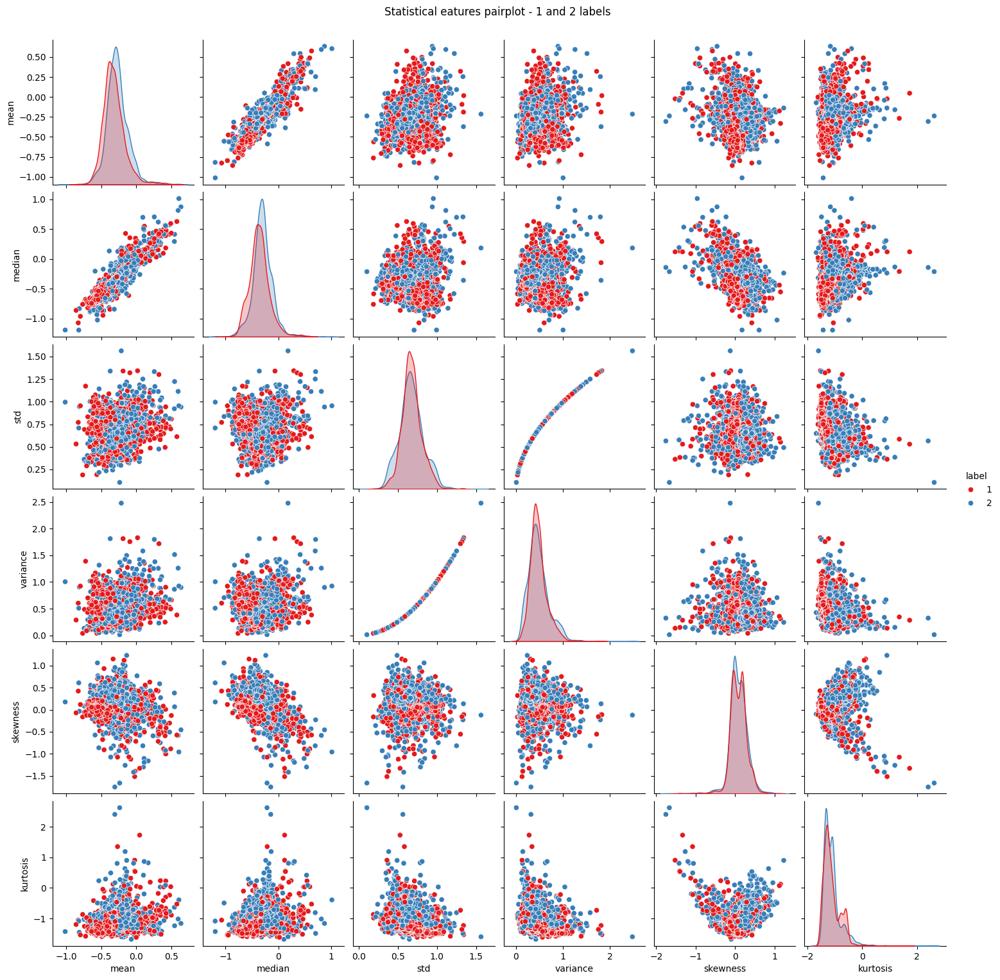

In [ ]:
statistical_features_df_label = statistical_features_df.drop(['Segment', 'Patient'],axis=1)
statistical_features_df_onetwo = statistical_features_df_label[(statistical_features_df_label['label']=='1')|(statistical_features_df_label['label']=='2')]

sns.pairplot(statistical_features_df_onetwo, hue='label', palette='Set1')
plt.suptitle('Statistical eatures pairplot - 1 and 2 labels', y=1.02)
plt.show()

### 6.2 Peak features

In [ ]:
def find_peak_minima(minima_indexes, segment, peak_index):
  if len(minima_indexes)>=2:
    for i in range(len(minima_indexes)-1):
      if peak_index-segment[0] > minima_indexes[i] and peak_index-segment[0] < minima_indexes[i+1]:
        return [minima_indexes[i], minima_indexes[i+1]]
  return segment[0], segment[-1]


In [ ]:
# Create a dataframe whose rows are the segments and whose columns are the extracted features
# plus the label of the segment and the patient to which a segment belongs
peak_features_df = pd.DataFrame({})

#column_peak_distance = []
#column_peak_amplitude = []
#column_peak_width = []
column_peak_area = []
column_peak_max_first_derivative = []
column_peak_min_first_derivative = []
column_peak_max_second_derivative = []
column_peak_min_second_derivative = []

for pat in range(len(total_segments_nomessy)):
  for i in range(len(total_segments_nomessy[pat])):
    #column_peak_distance.append(int(total_peaks_nomessy[pat][i])-total_segments_nomessy[pat][i][0])
    #column_peak_amplitude.append(total_segments_nomessy_ampl[pat][i][int(total_peaks_nomessy[pat][i])-total_segments_nomessy[pat][i][0]])
    #min = find_peak_minima(sig.argrelmin(total_segments_nomessy_ampl[pat][i])[0], total_segments_nomessy[pat][i], total_peaks_nomessy[pat][i])
    #column_peak_width.append(min[1]-min[0])
    column_peak_area.append(trapz(total_segments_nomessy_ampl[pat][i] - total_segments_nomessy_ampl[pat][i][0]))
    column_peak_max_first_derivative.append(np.max(np.diff(total_segments_nomessy_ampl[pat][i], n=1)))
    column_peak_min_first_derivative.append(np.min(np.diff(total_segments_nomessy_ampl[pat][i], n=1)))
    column_peak_max_second_derivative.append(np.max(np.diff(total_segments_nomessy_ampl[pat][i], n=2)))
    column_peak_min_second_derivative.append(np.min(np.diff(total_segments_nomessy_ampl[pat][i], n=2)))

#column_peak_distance = np.array(column_peak_distance)
#column_peak_amplitude = np.array(column_peak_amplitude)
#column_peak_width = np.array(column_peak_width)
column_peak_area = np.array(column_peak_area)
column_peak_max_first_derivative = np.array(column_peak_max_first_derivative, dtype=float)
column_peak_min_first_derivative = np.array(column_peak_min_first_derivative, dtype=float)
column_peak_max_second_derivative = np.array(column_peak_max_second_derivative, dtype=float)
column_peak_min_second_derivative = np.array(column_peak_min_second_derivative, dtype=float)


peak_features_df['Patient'] = column_pat
peak_features_df['Segment'] = range(tot_segments)
#peak_features_df['peak_distance'] = column_peak_distance
#peak_features_df['peak_amplitude'] = column_peak_amplitude
#peak_features_df['peak_width'] = column_peak_width
peak_features_df['peak_area'] = column_peak_area
peak_features_df['max_first_derivative'] = column_peak_max_first_derivative
peak_features_df['min_first_derivative'] = column_peak_min_first_derivative
peak_features_df['max_second_derivative'] = column_peak_max_second_derivative
peak_features_df['min_second_derivative'] = column_peak_min_second_derivative
peak_features_df['label'] = total_labels_nomessy_flat

In [ ]:
peak_features_df

,Patient,Segment,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,min_second_derivative,label
0,0,0,109.568580,0.165947,-0.080634,0.015670,-0.013952,0
1,0,1,92.119661,0.155501,-0.069609,0.016972,-0.013095,0
2,0,2,105.688871,0.162023,-0.067769,0.016842,-0.013259,0
3,0,3,113.143197,0.164151,-0.062984,0.016968,-0.013180,0
4,0,4,23.728241,0.099846,-0.044639,0.011646,-0.010789,1
...,...,...,...,...,...,...,...,...
91777,90,91777,109.448030,0.208898,-0.137148,0.021210,-0.026240,0
91778,90,91778,102.206045,0.210251,-0.128506,0.022246,-0.026861,0
91779,90,91779,130.998780,0.212065,-0.129745,0.020313,-0.024679,0
91780,90,91780,110.120790,0.210798,-0.134598,0.022101,-0.025456,0


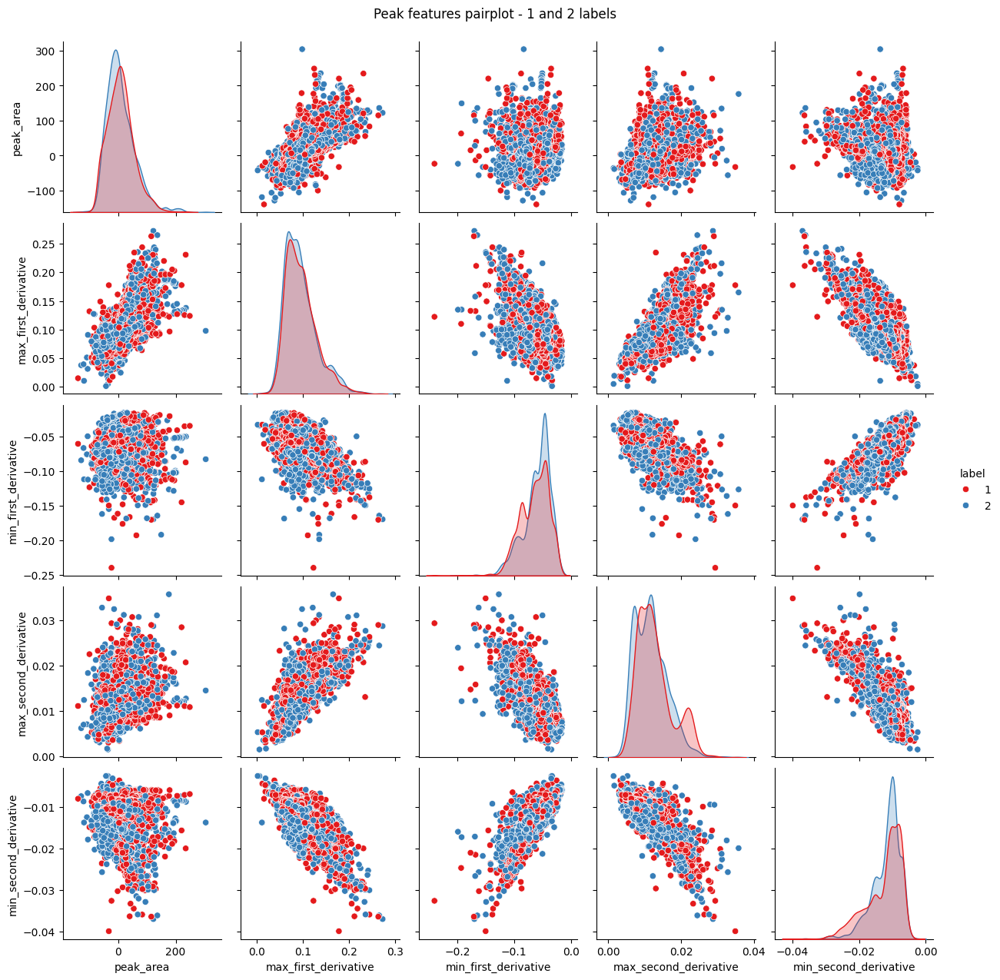

In [ ]:
peak_features_df_label = peak_features_df.drop(['Segment', 'Patient'],axis=1)
peak_features_df_onetwo = peak_features_df_label[(peak_features_df_label['label']=='1')|(peak_features_df_label['label']=='2')]

sns.pairplot(peak_features_df_onetwo, hue='label', palette='Set1')
plt.suptitle('Peak features pairplot - 1 and 2 labels', y=1.02)
plt.show()

### 6.3 Peak-to-peak features

In [ ]:
# with new features
# returns true if the previous segment is adjacent, false otherwise
def before_is_previous(previous_pulse):
  return not np.isnan(previous_pulse.peak_value)

# returns true if the following segment is adjacent, false otherwise
def after_is_following(following_pulse):
  return not np.isnan(following_pulse.peak_value)

def get_PP_features_frompulse(patient, idx_segment):
    current_pulse, previous_pulse, following_pulse = create_currentprevfoll_pulses(patient, idx_segment)
    label = current_pulse.label

    previous = -1
    current = 0
    following = 1

    # local variables (needed to normalize features; local_RR is also used itself as a feature)
    # This configuration of np.where returns an array with elements from x where condition is True and elements from y where condition is False.
    local_win_seconds = 5
    local_win_samples = local_win_seconds*new_fs
    local_win = []
    local_ampl = []
    local_negtoneg = []
    local_negtonegact = []
    local_postopos = []
    local_postopospost = []
    i = 0
    while(before_is_previous(previous_pulse) and len(local_win) <= local_win_samples):
      pre_RR = current_pulse.peak_idx-previous_pulse.peak_idx
      upslope_ampl = current_pulse.peak_value-current_pulse.onset_value
      neg_to_neg = current_pulse.onset_value-previous_pulse.onset_value
      neg_to_neg_actual = current_pulse.end_value-current_pulse.onset_value
      pos_to_pos = current_pulse.peak_value-previous_pulse.peak_value
      pos_to_pos_post = following_pulse.peak_value-current_pulse.peak_value
      local_win.append(pre_RR)
      local_ampl.append(upslope_ampl)
      local_negtoneg.append(neg_to_neg)
      local_negtonegact.append(neg_to_neg_actual)
      local_postopos.append(pos_to_pos)
      local_postopospost.append(pos_to_pos_post)
      i+=1
      current_pulse, previous_pulse, following_pulse = create_currentprevfoll_pulses(patient, idx_segment-i)
    # the previous pulses weren't enough to compute a window -> set the average of the RR intervals as nan
    #print(f"local_win: {local_win}, local_win_samples, {local_win_samples}")
    local_win = sum(local_win)
    local_ampl = sum(local_ampl)
    local_negtoneg = sum(local_negtoneg)
    local_negtonegact = sum(local_negtonegact)
    local_postopos = sum(local_postopos)
    local_postopospost = sum(local_postopospost)
    if(local_win > local_win_samples):
      local_RR = local_win/i #np.round(np.mean(local_win),2)
      local_ampl = local_ampl/i #np.round(np.mean(local_ampl),2)
      local_negtoneg = local_negtoneg/i #np.round(np.mean(local_negtoneg),2)
      local_negtonegact = local_negtonegact/i
      local_postopos = local_postopos/i #np.round(np.mean(local_postopos),2)
      local_postopospost = local_postopospost/i
    else:
      local_RR = np.nan
      local_ampl = np.nan
      local_negtoneg = np.nan
      local_negtonegact = np.nan
      local_postopos = np.nan
      local_postopospost = np.nan

    current_pulse, previous_pulse, following_pulse = create_currentprevfoll_pulses(patient, idx_segment)

     #DIK and DIS (from "Effortless detection of premature ventricular contraction using
    #computerized analysis of photoplethysmography signal")
     #Difference in beat-to-beat skewness and kurtosis
    if(before_is_previous(previous_pulse)):
      dis = stats.skew(current_pulse.values) - stats.skew(previous_pulse.values)
      dik = stats.kurtosis(current_pulse.values) - stats.kurtosis(previous_pulse.values)
    else:
      dis = np.nan
      dik = np.nan

    # Upslope and downslope pulse amplitudes of the current and previous pulse
    # from "Heart Rate Turbulence Analysis Based on Photoplethysmography"
    # Upslope pulse amplitude
    upslope_ampl = current_pulse.peak_value-current_pulse.onset_value #
    # Downslope pulse amplitude
    downslope_ampl = current_pulse.end_value-current_pulse.peak_value
    # Upslope and downslope pulse amplitude of previous pulse (if not nan)
    if(before_is_previous(previous_pulse)):
      upslope_ampl_prev = previous_pulse.peak_value-previous_pulse.onset_value
      downslope_ampl_prev = previous_pulse.end_value-previous_pulse.peak_value
    else:
      upslope_ampl_prev = np.nan
      downslope_ampl_prev = np.nan

    # From "Signal quality measure for pulsatile physiological signals using
    #morphological features: Applications in reliability measure for pulse oximetry"
    # Negative-to-negative peak jump.
    # pos_duration is not calculated, as it's equivalent to the pre_RR calculated soon after
    if(before_is_previous(previous_pulse)):
      neg_to_neg = current_pulse.onset_value-previous_pulse.onset_value
      neg_to_neg_actual = current_pulse.end_value-current_pulse.onset_value
      pos_to_pos = current_pulse.peak_value-previous_pulse.peak_value
      neg_duration = current_pulse.end_idx-current_pulse.onset_idx#current_pulse.onset_idx-previous_pulse.onset_idx
      neg_duration_prev = current_pulse.onset_idx-previous_pulse.onset_idx
      #pos_duration = current_pulse.peak_idx-previous_pulse.peak_idx
    else:
      neg_to_neg = np.nan
      neg_to_neg_actual = np.nan
      pos_to_pos = np.nan
      neg_duration = np.nan
      neg_duration_prev = np.nan
      pos_duration = np.nan

    # Pre and post RR (from "A Deep Learning Approach for ECG-based Heartbeat classification for Arrhythmia Detection")
    # pre_RR and post_RR
    if(before_is_previous(previous_pulse)):
      pre_RR = current_pulse.peak_idx-previous_pulse.peak_idx
    else:
      pre_RR = np.nan
    if(after_is_following(following_pulse)):
      post_RR = following_pulse.peak_idx-current_pulse.peak_idx
    else:
      post_RR = np.nan

    # Other hand-crafted features
    pos_to_pos_post = following_pulse.peak_value-current_pulse.peak_value
    onset_to_peak_idx = current_pulse.peak_idx-current_pulse.onset_idx
    initial_ang_coefficient = upslope_ampl/onset_to_peak_idx

    # Normalize
    if(not np.isnan(local_RR)): # the condition would be the same on all "local" variables np.isnan(local_RR)
      upslope_ampl_norm = (upslope_ampl-local_ampl)/local_ampl
      downslope_ampl_norm = (downslope_ampl-local_ampl)/local_ampl
      upslope_ampl_prev_norm = (upslope_ampl_prev-local_ampl)/local_ampl
      downslope_ampl_prev_norm = (downslope_ampl_prev-local_ampl)/local_ampl
      neg_to_neg_norm = (neg_to_neg-local_negtoneg)/local_negtoneg
      neg_to_neg_actual_norm = (neg_to_neg_actual-local_negtonegact)/local_negtonegact
      pos_to_pos_norm = (pos_to_pos-local_postopos)/local_postopos
      neg_duration_norm = (neg_duration-local_RR)/local_RR
      neg_duration_prev_norm = (neg_duration_prev-local_RR)/local_RR
      pos_to_pos_post_norm = (pos_to_pos_post-local_postopospost)/local_postopospost
      onset_to_peak_idx_norm = (onset_to_peak_idx-local_RR)/local_RR
      initial_ang_coefficient_norm = upslope_ampl_norm/onset_to_peak_idx_norm
    else: # if the local_ampl is not available yet, assign nan
      upslope_ampl_norm = np.nan
      downslope_ampl_norm = np.nan
      upslope_ampl_prev_norm = np.nan
      downslope_ampl_prev_norm = np.nan
      neg_to_neg_norm = np.nan
      neg_to_neg_actual_norm = np.nan
      pos_to_pos_norm = np.nan
      neg_duration_norm = np.nan
      neg_duration_prev_norm = np.nan
      pos_to_pos_post_norm = np.nan
      onset_to_peak_idx_norm = np.nan
      initial_ang_coefficient_norm = np.nan

    label = current_pulse.label

    PP_features = np.hstack([dis, dik,
                             upslope_ampl, downslope_ampl, upslope_ampl_norm, downslope_ampl_norm,
                             upslope_ampl_prev, downslope_ampl_prev, upslope_ampl_prev_norm, downslope_ampl_prev_norm,
                              neg_to_neg, neg_to_neg_actual, pos_to_pos, neg_duration,
                             neg_to_neg_norm, neg_to_neg_actual_norm, pos_to_pos_norm, neg_duration_norm,
                             pre_RR, post_RR, local_RR,
                             pos_to_pos_post, onset_to_peak_idx, pos_to_pos_post_norm, onset_to_peak_idx_norm, initial_ang_coefficient,
                             initial_ang_coefficient_norm, neg_duration_prev, neg_duration_prev_norm,
                             ])
    return PP_features

In [ ]:
# Create a dataframe whose rows are the segments and whose columns are the extracted features
# plus the label of the segment and the patient to which a segment belongs

peak_to_peak_features_df = pd.DataFrame({})

column_dis = []
column_dik = []
column_upslope_ampl = []
column_downslope_ampl = []
column_upslope_ampl_norm = []
column_downslope_ampl_norm = []
column_upslope_ampl_prev = []
column_downslope_ampl_prev = []
column_upslope_ampl_prev_norm = []
column_downslope_ampl_prev_norm = []
column_neg_to_neg = []
column_neg_to_neg_actual = []
column_pos_to_pos = []
column_neg_duration = []
column_neg_to_neg_norm = []
column_neg_to_neg_actual_norm = []
column_pos_to_pos_norm = []
column_neg_duration_norm = []
column_pre_RR = []
column_post_RR = []
column_local_RR = []
column_pos_to_pos_post = []
column_onset_to_peak_idx = []
column_pos_to_pos_post_norm = []
column_onset_to_peak_idx_norm = []
column_initial_ang_coefficient = []
column_initial_ang_coefficient_norm = []
column_neg_duration_prev = []
column_neg_duration_prev_norm = []


# Loop through segments and calculate features
for patient in range(len(total_segments_nomessy)):
  for idx_segment in range(len(total_segments_nomessy[patient])):
    PP_features = get_PP_features_frompulse(patient, idx_segment)
    column_dis.append(PP_features[0])
    column_dik.append(PP_features[1])
    column_upslope_ampl.append(PP_features[2])
    column_downslope_ampl.append(PP_features[3])
    column_upslope_ampl_norm.append(PP_features[4])
    column_downslope_ampl_norm.append(PP_features[5])
    column_upslope_ampl_prev.append(PP_features[6])
    column_downslope_ampl_prev.append(PP_features[7])
    column_upslope_ampl_prev_norm.append(PP_features[8])
    column_downslope_ampl_prev_norm.append(PP_features[9])
    column_neg_to_neg.append(PP_features[10])
    column_neg_to_neg_actual.append(PP_features[11])
    column_pos_to_pos.append(PP_features[12])
    column_neg_duration.append(PP_features[13])
    column_neg_to_neg_norm.append(PP_features[14])
    column_neg_to_neg_actual_norm.append(PP_features[15])
    column_pos_to_pos_norm.append(PP_features[16])
    column_neg_duration_norm.append(PP_features[17])
    column_pre_RR.append(PP_features[18])
    column_post_RR.append(PP_features[19])
    column_local_RR.append(PP_features[20])
    column_pos_to_pos_post.append(PP_features[21])
    column_onset_to_peak_idx.append(PP_features[22])
    column_pos_to_pos_post_norm.append(PP_features[23])
    column_onset_to_peak_idx_norm.append(PP_features[24])
    column_initial_ang_coefficient.append(PP_features[25])
    column_initial_ang_coefficient_norm.append(PP_features[26])
    column_neg_duration_prev.append(PP_features[27])
    column_neg_duration_prev_norm.append(PP_features[28])

column_dis = np.array(column_dis, dtype=float)
column_dik = np.array(column_dik, dtype=float)
column_upslope_ampl = np.array(column_upslope_ampl, dtype=float)
column_downslope_ampl = np.array(column_downslope_ampl, dtype=float)
column_upslope_ampl_norm = np.array(column_upslope_ampl_norm, dtype=float)
column_downslope_ampl_norm = np.array(column_downslope_ampl_norm, dtype=float)
column_upslope_ampl_prev = np.array(column_upslope_ampl_prev, dtype=float)
column_downslope_ampl_prev = np.array(column_downslope_ampl_prev, dtype=float)
column_upslope_ampl_prev_norm = np.array(column_upslope_ampl_prev_norm, dtype=float)
column_downslope_ampl_prev_norm = np.array(column_downslope_ampl_prev_norm, dtype=float)
column_neg_to_neg = np.array(column_neg_to_neg, dtype=float)
column_neg_to_neg_actual = np.array(column_neg_to_neg_actual, dtype=float)
column_pos_to_pos = np.array(column_pos_to_pos, dtype=float)
column_neg_duration = np.array(column_neg_duration, dtype=float)
column_neg_to_neg_norm = np.array(column_neg_to_neg_norm, dtype=float)
column_neg_to_neg_actual_norm = np.array(column_neg_to_neg_actual_norm, dtype=float)
column_pos_to_pos_norm = np.array(column_pos_to_pos_norm, dtype=float)
column_neg_duration_norm = np.array(column_neg_duration_norm, dtype=float)
column_pre_RR = np.array(column_pre_RR, dtype=float)
column_post_RR = np.array(column_post_RR, dtype=float)
column_local_RR = np.array(column_local_RR, dtype=float)
column_pos_to_pos_post = np.array(column_pos_to_pos_post, dtype=float)
column_onset_to_peak_idx = np.array(column_onset_to_peak_idx, dtype=float)
column_pos_to_pos_post_norm = np.array(column_pos_to_pos_post_norm, dtype=float)
column_onset_to_peak_idx_norm = np.array(column_onset_to_peak_idx_norm, dtype=float)
column_initial_ang_coefficient = np.array(column_initial_ang_coefficient, dtype=float)
column_initial_ang_coefficient_norm = np.array(column_initial_ang_coefficient_norm, dtype=float)
column_neg_duration_prev = np.array(column_neg_duration_prev, dtype=float)
column_neg_duration_prev_norm = np.array(column_neg_duration_prev_norm, dtype=float)


peak_to_peak_features_df['Patient'] = column_pat
peak_to_peak_features_df['Segment'] = range(tot_segments)
peak_to_peak_features_df['dis'] = column_dis
peak_to_peak_features_df['dik'] = column_dik
peak_to_peak_features_df['upslope_ampl'] = column_upslope_ampl
peak_to_peak_features_df['downslope_ampl'] = column_downslope_ampl
peak_to_peak_features_df['upslope_ampl_norm'] = column_upslope_ampl_norm
peak_to_peak_features_df['downslope_ampl_norm'] = column_downslope_ampl_norm
peak_to_peak_features_df['upslope_ampl_prev'] = column_upslope_ampl_prev
peak_to_peak_features_df['downslope_ampl_prev'] = column_downslope_ampl_prev
peak_to_peak_features_df['upslope_ampl_prev_norm'] = column_upslope_ampl_prev_norm
peak_to_peak_features_df['downslope_ampl_prev_norm'] = column_downslope_ampl_prev_norm
peak_to_peak_features_df['neg_to_neg'] = column_neg_to_neg
peak_to_peak_features_df['neg_to_neg_actual'] = column_neg_to_neg_actual
peak_to_peak_features_df['pos_to_pos'] = column_pos_to_pos
peak_to_peak_features_df['neg_duration'] = column_neg_duration
peak_to_peak_features_df['neg_to_neg_norm'] = column_neg_to_neg_norm
peak_to_peak_features_df['neg_to_neg_actual_norm'] = column_neg_to_neg_actual_norm
peak_to_peak_features_df['pos_to_pos_norm'] = column_pos_to_pos_norm
peak_to_peak_features_df['neg_duration_norm'] = column_neg_duration_norm
peak_to_peak_features_df['pre_RR'] = column_pre_RR
peak_to_peak_features_df['post_RR'] = column_post_RR
peak_to_peak_features_df['local_RR'] = column_local_RR
peak_to_peak_features_df['pos_to_pos_post'] = column_pos_to_pos_post
peak_to_peak_features_df['onset_to_peak_idx'] = column_onset_to_peak_idx
peak_to_peak_features_df['pos_to_pos_post_norm'] = column_pos_to_pos_post_norm
peak_to_peak_features_df['onset_to_peak_idx_norm'] = column_onset_to_peak_idx_norm
peak_to_peak_features_df['initial_ang_coefficient'] = column_initial_ang_coefficient
peak_to_peak_features_df['initial_ang_coefficient_norm'] = column_initial_ang_coefficient_norm
peak_to_peak_features_df['neg_duration_prev'] = column_neg_duration_prev
peak_to_peak_features_df['neg_duration_prev_norm'] = column_neg_duration_prev_norm
peak_to_peak_features_df['label'] = total_labels_nomessy_flat

In [ ]:
peak_to_peak_features_df

,Patient,Segment,dis,dik,upslope_ampl,downslope_ampl,upslope_ampl_norm,downslope_ampl_norm,upslope_ampl_prev,downslope_ampl_prev,...,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm,label
0,0,0,NaN,NaN,2.799059,-3.111203,NaN,NaN,NaN,NaN,...,NaN,-0.646453,34.0,NaN,NaN,0.082325,NaN,NaN,NaN,0
1,0,1,-0.065683,0.009360,2.418711,-2.572577,NaN,NaN,2.799059,-3.111203,...,NaN,0.058173,27.0,NaN,NaN,0.089582,NaN,89.0,NaN,0
2,0,2,-0.003028,-0.009744,2.576778,-2.537725,NaN,NaN,2.418711,-2.572577,...,NaN,0.169881,27.0,NaN,NaN,0.095436,NaN,82.0,NaN,0
3,0,3,-0.159631,0.119617,2.660952,-2.038478,NaN,NaN,2.576778,-2.537725,...,NaN,-0.714766,28.0,NaN,NaN,0.095034,NaN,82.0,NaN,0
4,0,4,0.054657,0.031195,1.279595,-2.141336,NaN,NaN,2.660952,-2.038478,...,NaN,NaN,19.0,NaN,NaN,0.067347,NaN,73.0,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91777,90,91777,0.273574,0.084178,2.993893,-2.918789,0.043803,-2.017618,2.622077,-2.831411,...,90.461538,0.015768,24.0,1.339815,-0.734694,0.124746,-0.059621,84.0,-0.071429,0
91778,90,91778,-0.214171,-0.133275,2.878826,-3.085234,0.003421,-2.075365,2.993893,-2.918789,...,90.071429,0.167819,21.0,8.198275,-0.766852,0.137087,-0.004462,88.0,-0.022998,0
91779,90,91779,0.070327,0.089435,3.228186,-3.230335,0.115878,-2.116621,2.878826,-3.085234,...,90.333333,-0.175930,25.0,-34.196581,-0.723247,0.129127,-0.160220,90.0,-0.003690,0
91780,90,91780,-0.088588,0.018785,3.010171,-3.343452,0.037889,-2.152803,3.228186,-3.230335,...,90.500000,-0.504606,23.0,17.991962,-0.745856,0.130877,-0.050800,95.0,0.049724,0


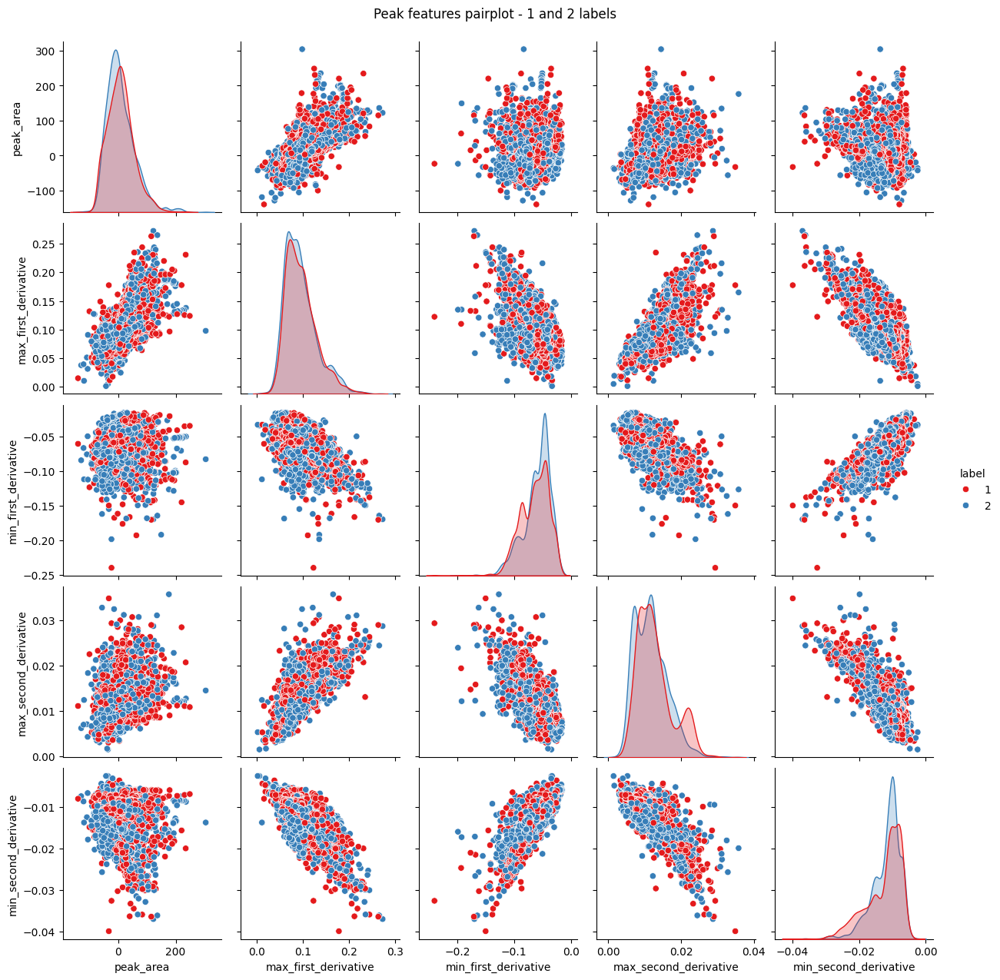

In [ ]:
peak_to_peak_features_df_label = peak_features_df.drop(['Segment', 'Patient'],axis=1)
peak_to_peak_features_df_onetwo = peak_to_peak_features_df_label[(statistical_features_df['label']=='1')|(statistical_features_df['label']=='2')]

sns.pairplot(peak_to_peak_features_df_onetwo, hue='label', palette='Set1')
plt.suptitle('Peak features pairplot - 1 and 2 labels', y=1.02)
plt.show()

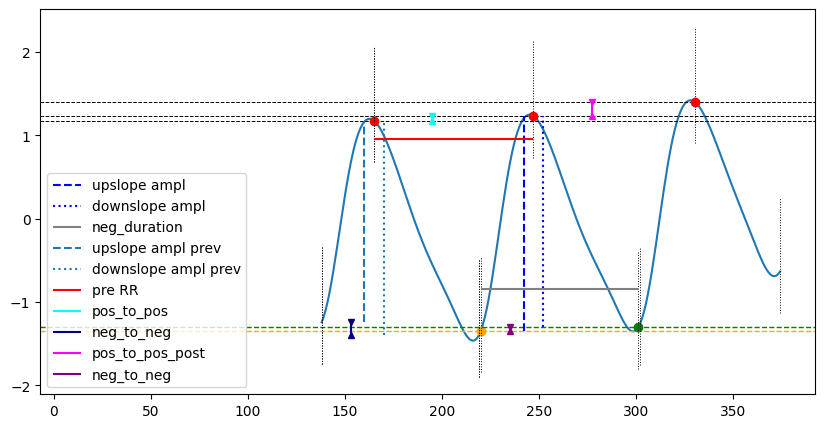

In [ ]:
plt.figure(figsize=(10,5))

current_pulse, previous_pulse, following_pulse = create_currentprevfoll_pulses(0, 2)

plt.plot(np.concatenate([previous_pulse.indexes, current_pulse.indexes, following_pulse.indexes], axis=0),
         np.concatenate([previous_pulse.values, current_pulse.values, following_pulse.values], axis=0)) #current_pulse.indexes,  #current_pulse.values,

plt.axhline(y=current_pulse.peak_value, color='k', linestyle='--', linewidth = 0.7) #label='peak'
plt.plot(current_pulse.peak_idx, current_pulse.peak_value, color='r', marker='o')
plt.axhline(y=current_pulse.onset_value, color='orange', linestyle='--', linewidth = 1) #label='start'
plt.plot(current_pulse.onset_idx, current_pulse.onset_value, color='orange', marker='o')
plt.axhline(y=current_pulse.end_value, color='g', linestyle='--', linewidth = 1) #, peak='end'
plt.plot(current_pulse.end_idx, current_pulse.end_value, color='g', marker='o')
plt.vlines(x=current_pulse.peak_idx-5, ymin = current_pulse.onset_value, ymax = current_pulse.peak_value, color='b', linestyle='--', label='upslope ampl') #y = [],
plt.vlines(x=current_pulse.peak_idx+5, ymin = current_pulse.end_value, ymax = current_pulse.peak_value, color='b', linestyle=':', label='downslope ampl')
plt.vlines(x=current_pulse.end_idx, ymin = current_pulse.end_value-0.5, ymax = current_pulse.end_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=current_pulse.onset_idx, ymin = current_pulse.onset_value-0.5, ymax = current_pulse.onset_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=current_pulse.peak_idx, ymin = current_pulse.peak_value-0.5, ymax = current_pulse.peak_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.hlines(y=current_pulse.onset_value+0.5, xmin = current_pulse.onset_idx, xmax = current_pulse.end_idx, color='grey', linestyle='-', label='neg_duration')
#plt.hlines(y=current_pulse.onset_value+2.5, xmin = current_pulse.onset_idx, xmax = current_pulse.end_idx, color='', linestyle='-', label='pos_to_pos')

#previous
plt.axhline(y=previous_pulse.peak_value, color='k', linestyle='--', linewidth = 0.7) #, label='peak'
plt.plot(previous_pulse.peak_idx, previous_pulse.peak_value, color='r', marker='o')
plt.vlines(x=previous_pulse.end_idx, ymin = previous_pulse.end_value-0.5, ymax = previous_pulse.end_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=previous_pulse.onset_idx, ymin = previous_pulse.onset_value-0.5, ymax = previous_pulse.onset_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=previous_pulse.peak_idx, ymin = previous_pulse.peak_value-0.5, ymax = previous_pulse.peak_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=previous_pulse.peak_idx-5, ymin = previous_pulse.onset_value, ymax = previous_pulse.peak_value, color='C0', linestyle='--', label='upslope ampl prev') #y = [],
plt.vlines(x=previous_pulse.peak_idx+5, ymin = previous_pulse.end_value, ymax = previous_pulse.peak_value, color='C0', linestyle=':', label='downslope ampl prev')
plt.vlines(x=previous_pulse.end_idx, ymin = previous_pulse.end_value-0.5, ymax = previous_pulse.end_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=previous_pulse.onset_idx, ymin = previous_pulse.onset_value-0.5, ymax = previous_pulse.onset_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=previous_pulse.peak_idx, ymin = previous_pulse.peak_value-0.5, ymax = previous_pulse.peak_value+0.9, color='black', linestyle=':',linewidth=0.7)

# following
plt.axhline(y=following_pulse.peak_value, color='k', linestyle='--', linewidth = 0.7) #, label='peak'
plt.plot(following_pulse.peak_idx, following_pulse.peak_value, color='r', marker='o')
plt.vlines(x=following_pulse.end_idx, ymin = following_pulse.end_value-0.5, ymax = following_pulse.end_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=following_pulse.onset_idx, ymin = following_pulse.onset_value-0.5, ymax = following_pulse.onset_value+0.9, color='black', linestyle=':',linewidth=0.7)
plt.vlines(x=following_pulse.peak_idx, ymin = following_pulse.peak_value-0.5, ymax = following_pulse.peak_value+0.9, color='black', linestyle=':',linewidth=0.7)

# peak-to-peak
plt.hlines(y=current_pulse.onset_value+2.3, xmin = previous_pulse.peak_idx, xmax = current_pulse.peak_idx, color='red', linestyle='-', label='pre RR')
plt.plot(previous_pulse.peak_idx+30, current_pulse.peak_value, marker='v', markersize=5, color='cyan')
plt.plot(previous_pulse.peak_idx+30, previous_pulse.peak_value, marker='^', markersize=5, color='cyan')
plt.vlines(x=previous_pulse.peak_idx+30, ymin = previous_pulse.peak_value, ymax = current_pulse.peak_value, color='cyan', linestyle='-', label='pos_to_pos')

plt.plot(previous_pulse.onset_idx+15, previous_pulse.onset_value, marker='v', markersize=5, color='navy')
plt.plot(previous_pulse.onset_idx+15, previous_pulse.end_value, marker='^', markersize=5, color='navy')
plt.vlines(x=previous_pulse.onset_idx+15, ymin = previous_pulse.end_value, ymax = previous_pulse.onset_value, color='navy', linestyle='-', label='neg_to_neg')

plt.plot(current_pulse.peak_idx+30, following_pulse.peak_value, marker='v', markersize=5, color='magenta')
plt.plot(current_pulse.peak_idx+30, current_pulse.peak_value, marker='^', markersize=5, color='magenta')
plt.vlines(x=current_pulse.peak_idx+30, ymin = current_pulse.peak_value, ymax = following_pulse.peak_value, color='magenta', linestyle='-', label='pos_to_pos_post')

plt.plot(current_pulse.onset_idx+15, current_pulse.end_value, marker='v', markersize=5, color='purple')
plt.plot(current_pulse.onset_idx+15, current_pulse.onset_value, marker='^', markersize=5, color='purple')
plt.vlines(x=current_pulse.onset_idx+15, ymin = current_pulse.onset_value, ymax = current_pulse.end_value, color='purple', linestyle='-', label='neg_to_neg')

plt.plot(current_pulse.peak_value+10, current_pulse.peak_value)
plt.legend()

plt.show()

### 6.4 Total feature extraction

In [ ]:
# store separately the statistical features, the peak_to_peak features and all the features in different dataframes
statistical_features = statistical_features_df.drop(['Patient', 'Segment', 'label'], axis=1)
peak_features = peak_features_df.drop(['Patient', 'Segment', 'label'], axis=1)
peak_to_peak_features = peak_to_peak_features_df.drop(['Patient', 'Segment', 'label'], axis=1)
statistical_peak_features = pd.concat([statistical_features, peak_features], axis=1)
total_features = pd.concat([statistical_features, peak_features, peak_to_peak_features], axis=1) #.drop(['Patient', 'Segment'], axis=1

In [ ]:
statistical_peak_features

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,min_second_derivative
0,0.252763,0.173995,1.073207,1.164862,0.097711,-1.415185,109.568580,0.165947,-0.080634,0.015670,-0.013952
1,-0.120224,-0.169474,0.896295,0.813263,0.032027,-1.405824,92.119661,0.155501,-0.069609,0.016972,-0.013095
2,-0.053463,-0.080691,0.887138,0.796730,0.028999,-1.415568,105.688871,0.162023,-0.067769,0.016842,-0.013259
3,0.297287,0.320566,0.806903,0.660135,-0.130631,-1.295951,113.143197,0.164151,-0.062984,0.016968,-0.013180
4,-0.309600,-0.299551,0.673445,0.459059,-0.075974,-1.264756,23.728241,0.099846,-0.044639,0.011646,-0.010789
...,...,...,...,...,...,...,...,...,...,...,...
91777,-0.030194,-0.172093,0.897527,0.814814,0.567743,-0.711594,109.448030,0.208898,-0.137148,0.021210,-0.026240
91778,-0.009038,0.059613,0.914726,0.846125,0.353572,-0.844868,102.206045,0.210251,-0.128506,0.022246,-0.026861
91779,0.053868,0.019838,0.960215,0.931821,0.423898,-0.755433,130.998780,0.212065,-0.129745,0.020313,-0.024679
91780,-0.113244,-0.126949,0.972083,0.955106,0.335310,-0.736648,110.120790,0.210798,-0.134598,0.022101,-0.025456


In [ ]:
total_features

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
0,0.252763,0.173995,1.073207,1.164862,0.097711,-1.415185,109.568580,0.165947,-0.080634,0.015670,...,82.0,NaN,-0.646453,34.0,NaN,NaN,0.082325,NaN,NaN,NaN
1,-0.120224,-0.169474,0.896295,0.813263,0.032027,-1.405824,92.119661,0.155501,-0.069609,0.016972,...,82.0,NaN,0.058173,27.0,NaN,NaN,0.089582,NaN,89.0,NaN
2,-0.053463,-0.080691,0.887138,0.796730,0.028999,-1.415568,105.688871,0.162023,-0.067769,0.016842,...,83.0,NaN,0.169881,27.0,NaN,NaN,0.095436,NaN,82.0,NaN
3,0.297287,0.320566,0.806903,0.660135,-0.130631,-1.295951,113.143197,0.164151,-0.062984,0.016968,...,64.0,NaN,-0.714766,28.0,NaN,NaN,0.095034,NaN,82.0,NaN
4,-0.309600,-0.299551,0.673445,0.459059,-0.075974,-1.264756,23.728241,0.099846,-0.044639,0.011646,...,NaN,NaN,NaN,19.0,NaN,NaN,0.067347,NaN,73.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91777,-0.030194,-0.172093,0.897527,0.814814,0.567743,-0.711594,109.448030,0.208898,-0.137148,0.021210,...,85.0,90.461538,0.015768,24.0,1.339815,-0.734694,0.124746,-0.059621,84.0,-0.071429
91778,-0.009038,0.059613,0.914726,0.846125,0.353572,-0.844868,102.206045,0.210251,-0.128506,0.022246,...,94.0,90.071429,0.167819,21.0,8.198275,-0.766852,0.137087,-0.004462,88.0,-0.022998
91779,0.053868,0.019838,0.960215,0.931821,0.423898,-0.755433,130.998780,0.212065,-0.129745,0.020313,...,93.0,90.333333,-0.175930,25.0,-34.196581,-0.723247,0.129127,-0.160220,90.0,-0.003690
91780,-0.113244,-0.126949,0.972083,0.955106,0.335310,-0.736648,110.120790,0.210798,-0.134598,0.022101,...,93.0,90.500000,-0.504606,23.0,17.991962,-0.745856,0.130877,-0.050800,95.0,0.049724


# 7 Stratified split

In [ ]:
# useful functions

def stratified_group_split(X, y, groups, test_size):

  composite_labels = []
  groups_array = np.array(groups)
  y_array = np.array(y)
  unique, counts = np.unique(y_array, return_counts=True)

  for i in range(len(np.array(y))):
    label_patient = (groups_array[i], y_array[i])
    composite_labels.append(label_patient)

  # Create a dictionary to hold indices for each composite label
  label_indices = {}
  for idx, label in enumerate(composite_labels):
    if label not in label_indices:
        label_indices[label] = []
    label_indices[label].append(idx)

  indexes = X.index
  patients = np.unique(groups_array)

  I = range(len(indexes))
  J = range(len(patients))

  I_0 = np.where(y_array=='0')
  I_1 = np.where(y_array=='1')
  I_2 = np.where(y_array=='2')

  m = mipmod()

  x = [m.add_var(var_type=BINARY) for i in I]
  z = [m.add_var(var_type=BINARY) for j in J]


  for j in J:
    if (patients[j], '0') in list(label_indices.keys()):
      x_sum_0 = xsum(x[i] for i in label_indices[patients[j], '0'])
      len_0 = len(label_indices[patients[j], '0'])
    else:
      x_sum_0 = 0
      len_0 = 0
    if (patients[j], '1') in list(label_indices.keys()):
      x_sum_1 = xsum(x[i] for i in label_indices[patients[j], '1'])
      len_1 = len(label_indices[patients[j], '1'])
    else:
      x_sum_1 = 0
      len_1 = 0
    if (patients[j], '2') in list(label_indices.keys()):
      x_sum_2 = xsum(x[i] for i in label_indices[patients[j], '2'])
      len_2 = len(label_indices[patients[j], '2'])
    else:
      x_sum_2 = 0
      len_2 = 0

    m += (x_sum_0 + x_sum_1 + x_sum_2) == (len_0 + len_1 + len_2) * z[j]


  N_0 = xsum(x[i] for i in I_0[0])
  N_1 = xsum(x[i] for i in I_1[0])
  N_2 = xsum(x[i]  for i in I_2[0])

  m += (test_size-(N_0/counts[0])) >= -0.001
  m += (test_size-(N_1/counts[1])) >= -0.001
  m += (test_size-(N_2/counts[2])) >= -0.001
  m += (test_size-(N_0/counts[0])) + (test_size-(N_1/counts[1])) + (test_size-(N_2/counts[2])) >= 0

  m.objective = minimize((test_size-(N_0/counts[0])) + (test_size-(N_1/counts[1])) + (test_size-(N_2/counts[2])))

  m.optimize()

  print(m.objective.x)

  train_indices = []
  test_indices = []

  for i in I:
    segment = int(x[i].name[4:-1])
    if x[i].x==0:
      train_indices.append(segment)
    if x[i].x==1:
      test_indices.append(segment)

  train_indices = np.array(train_indices)
  test_indices = np.array(test_indices)


  # Shuffle the indices to randomize the order
  np.random.shuffle(train_indices)
  np.random.shuffle(test_indices)

  # Split the dataset based on the indices
  X_train = X.iloc[train_indices]
  X_test = X.iloc[test_indices]
  y_train = y.iloc[train_indices]
  y_test = y.iloc[test_indices]
  groups_train = groups.iloc[train_indices]
  groups_test = groups.iloc[test_indices]

  return X_train, X_test, y_train, y_test, groups_train, groups_test, train_indices, test_indices



## 7.1 Stratify features

In [ ]:
# 'X' is the feature matrix, 'y' is the label vector for peak types,
# and 'groups' is the group label vector for patients

# Create composite labels
X = total_features
y = statistical_features_df['label']
groups = statistical_features_df['Patient']
test_size = 0.1

# Perform the stratified group split
features_train_full, features_test, labels_features_train_full, labels_features_test, patients_groups_train_full, patients_groups_test, train_val_indeces, test_indeces = stratified_group_split(X, y, groups, test_size)

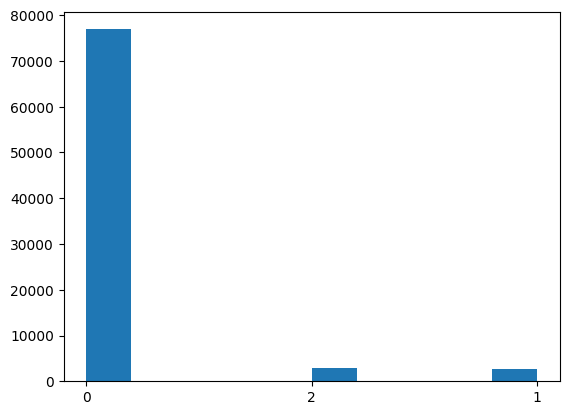

[76899  2784  2994]


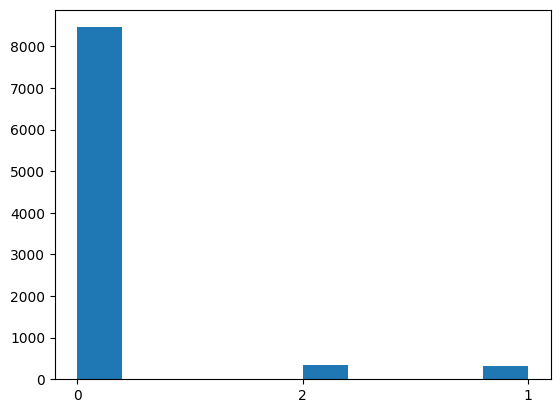

[8460  312  333]


In [ ]:
# Plot the number of each label in the train_full and the test sets
train_full_labels_features = np.array(labels_features_train_full)
unique, label_counts_train_full = np.unique(train_full_labels_features, return_counts=True)
plt.hist(train_full_labels_features)
plt.show()
print(label_counts_train_full)

test_labels_features = np.array(labels_features_test)
unique, label_counts_test = np.unique(test_labels_features, return_counts=True)
plt.hist(test_labels_features)
plt.show()
print(label_counts_test)

In [ ]:
# 'X' is your feature matrix, 'y' is the label vector for peak types,
# and 'groups' is the group label vector for patients

# Create composite labels
X = features_train_full
y = labels_features_train_full
groups = patients_groups_train_full
validation_size = 0.1

# Perform the stratified group split
features_train, features_validation, labels_features_train, labels_features_validation, patients_groups_train, patients_groups_validation, train_indeces, val_indeces = stratified_group_split(X, y, groups, validation_size)

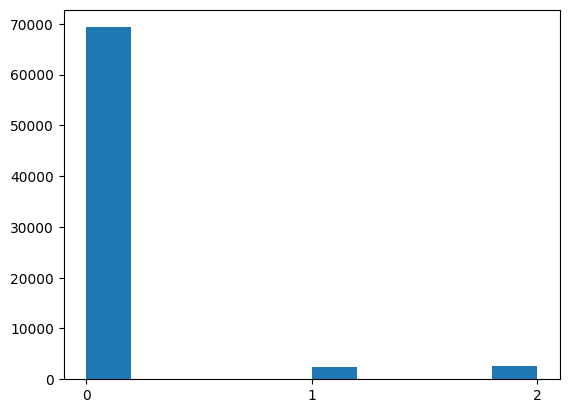

[69297  2504  2693]


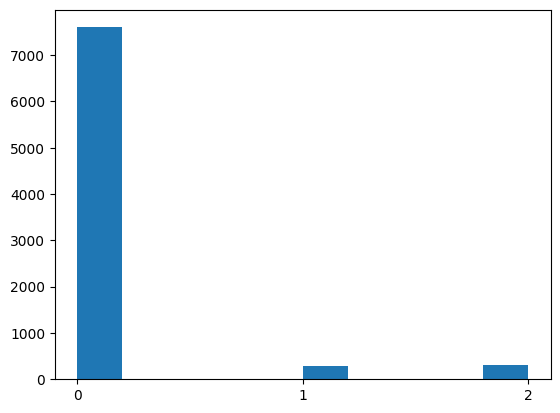

[7602  280  301]


In [ ]:
# Plot the number of each label in the train and the validation sets
train_labels_features = np.array(labels_features_train)
unique, label_counts_train = np.unique(train_labels_features, return_counts=True)
plt.hist(train_labels_features)
plt.show()
print(label_counts_train)

validation_labels_features = np.array(labels_features_validation)
unique, label_counts_validation = np.unique(validation_labels_features, return_counts=True)
plt.hist(validation_labels_features)
plt.show()
print(label_counts_validation)

In [ ]:
#X_features_train_val = np.array(features_train_full)
X_features_train_val = np.array(features_train_full)
y_labels_train_val = np.array(labels_features_train_full)

#X_features_train = np.array(features_train)
X_features_train = np.array(features_train)
y_labels_train = np.array(labels_features_train)

#X_features_test = np.array(features_test)
X_features_test = np.array(features_test)
y_labels_test = np.array(labels_features_test)

#X_features_val = np.array(features_validation)
X_features_val = np.array(features_validation)
y_labels_val = np.array(labels_features_validation)

print(X_features_train_val.shape, X_features_test.shape, X_features_train.shape, X_features_val.shape)
print(y_labels_train_val.shape, y_labels_test.shape, y_labels_train.shape, y_labels_val.shape)

## 7.2 Stratify segments

In [ ]:
segments_list = [sublist2 for sublist1 in total_segments_nomessy_ampl for sublist2 in sublist1]
labels_list = [sublist2 for sublist1 in total_labels_nomessy for sublist2 in sublist1]
segments_arr = np.array(segments_list)
labels_arr = np.array(labels_list)

In [ ]:
# Finding the minimum length of the segments, to be set as the resampling length
lengths = []
for i in segments_arr:
  lengths.append(len(i))

min_length = np.min(np.array(lengths))

In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)
num_samples = min_length

segments_arr_res = []
label_arr_res = []
for i in range(len(segments_arr)):
  segments_arr_res.append(resample(segments_arr[i], num_samples))
segments_arr_res = np.array(segments_arr_res)
print(len(segments_arr_res), len(segments_arr_res[0]))

In [ ]:
segments_list_removed = [sublist2 for sublist1 in total_segments_ampl_removed for sublist2 in sublist1]
labels_list_removed = [sublist2 for sublist1 in total_labels_removed for sublist2 in sublist1]
segments_arr_removed = np.array(segments_list_removed)
labels_arr_removed = np.array(labels_list_removed)

In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)

segments_arr_res_removed = []
label_arr_res_removed = []
for i in range(len(segments_arr_removed)):
  segments_arr_res_removed.append(resample(segments_arr_removed[i], num_samples))
segments_arr_res_removed = np.array(segments_arr_res_removed)
print(len(segments_arr_res_removed), len(segments_arr_res_removed[0]))

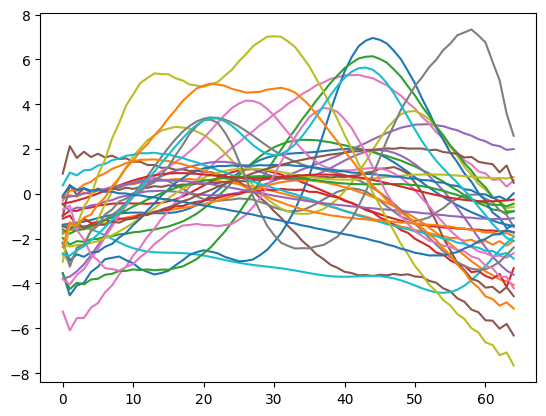

In [ ]:
for i in range(1000,len(segments_arr_res_removed)):
  plt.plot(segments_arr_res_removed[i])
  if(i>1030): break

In [ ]:
X = segments_arr_res
X = pd.DataFrame(X)

X_train_val_segments = X.iloc[train_val_indeces]
X_test_segments = X.iloc[test_indeces]

In [ ]:
X = X_train_val_segments
X_train_segments = X.iloc[train_indeces]
X_val_segments = X.iloc[val_indeces]

In [ ]:
X_train_val_segments = np.array(X_train_val_segments)

X_train_segments = np.array(X_train_segments)

X_test_segments = np.array(X_test_segments)

X_val_segments = np.array(X_val_segments)

In [ ]:
print(X_train_val_segments.shape, X_test_segments.shape, X_train_segments.shape, X_val_segments.shape)
print(X_features_train_val.shape, X_features_test.shape, X_features_train.shape, X_features_val.shape)
print(y_labels_train_val.shape, y_labels_test.shape, y_labels_train.shape, y_labels_val.shape)

# 8 Preparation to Classification

In [ ]:
# useful classifiers

clf_svm = svm.SVC(C=1.0,
                  kernel='rbf', # ‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’
                  degree=6,
                  gamma='scale',
                  coef0=0.0,
                  shrinking=True,
                  probability=True,
                  tol=0.001,
                  cache_size=200,
                  class_weight='balanced',
                  verbose=False,
                  max_iter=- 1,
                  decision_function_shape='ovr',
                  break_ties=False)

clf_rf = RandomForestClassifier(n_estimators=100,
                                criterion='gini',
                                max_depth=None,
                                min_samples_split=2,
                                min_samples_leaf=1,
                                min_weight_fraction_leaf=0.0,
                                max_features='sqrt',
                                max_leaf_nodes=None,
                                min_impurity_decrease=0.0,
                                bootstrap=True,
                                oob_score=False,
                                n_jobs=None,
                                random_state=None,
                                verbose=0,
                                warm_start=False,
                                class_weight='balanced',
                                ccp_alpha=0.0,
                                max_samples=None)

clf_lda = LinearDiscriminantAnalysis(solver='svd', # ‘svd’, ‘lsqr’, ‘eigen’
                                     shrinkage=None,
                                     priors=None,
                                     n_components=None,
                                     store_covariance=False,
                                     tol=0.0001,
                                     covariance_estimator=None)

clf_knn = KNeighborsClassifier(n_neighbors=5,
                              weights='uniform', # ‘uniform’, ‘distance’
                              algorithm='auto', # ‘auto’, ‘ball_tree’, ‘kd_tree’, ‘brute’
                              leaf_size=30,
                              p=2,
                              metric='minkowski',
                              metric_params=None,
                              n_jobs=None)

clf_ada = AdaBoostClassifier(base_estimator=clf_rf,
                                          n_estimators=100,
                                          algorithm='SAMME.R',
                                          random_state=42)

clf_grad = GradientBoostingClassifier(n_estimators=100,
                                      random_state=42)

In [ ]:
# useful functions

# plots the confusion matrix of the model
def plot_confusionMatrix(test_labels, test_predicted, clf, labels):
  cm = confusion_matrix(test_labels, test_predicted, labels=clf.classes_)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                display_labels=labels)
  disp.plot()
  plt.show()
  return

def plot_feature_importance(clf, features, labels, feature_names):

  #result = permutation_importance(
  #    clf, test_features, test_labels, n_repeats=10, random_state=42, n_jobs=2)

  #model_importances = pd.Series(result.importances_mean, index=feature_names)

  #fig, ax = plt.subplots()
  #model_importances.plot.bar(yerr=result.importances_std, ax=ax)
  #ax.set_title("Feature importances using permutation on full model")
  #ax.set_ylabel("Mean accuracy decrease")
  #fig.tight_layout()
  #plt.show()

  result = permutation_importance(clf, features, labels, n_repeats=10, random_state=42)
  perm_sorted_idx = result.importances_mean.argsort()

  plt.boxplot(result.importances[perm_sorted_idx].T, vert=False,
              labels=features.columns[perm_sorted_idx])
  plt.show()

def Shap(clf, train_features, row_to_show, test_features):

  data_for_prediction = train_features.iloc[row_to_show]
  data_for_prediction_array = data_for_prediction.values.reshape(1, -1)

  clf.predict_proba(data_for_prediction_array)

  # Create object that can calculate shap values
  explainer = shap.TreeExplainer(clf)

  # Calculate Shap values
  shap_values_single = explainer.shap_values(data_for_prediction)

  # visualize impact of each feature for single predicted subject
  shap.initjs()
  shap.force_plot(explainer.expected_value[1], shap_values_single[1], data_for_prediction)

  # Fit the explainer for all the validation predictions
  explainer = shap.Explainer(clf.predict, test_features)
  # Calculate the SHAP values
  shap_values = explainer(test_features)

  shap.plots.waterfall(shap_values[row_to_show])
  shap.plots.beeswarm(shap_values)

def plot_ROC_AUC(clf, test_features, test_labels):

  # Obtain predicted probabilities
  labels_pred_prob = clf.predict_proba(test_features)[:, 1]

  # Calculate ROC curve
  fpr, tpr, thresholds = roc_curve(test_labels, labels_pred_prob)

  # Calculate AUC (Area Under the Curve)
  roc_auc = auc(fpr, tpr)

  # Plot ROC curve
  plt.figure()
  plt.plot(fpr, tpr, color='red', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
  plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.0])
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('Receiver Operating Characteristic (ROC)')
  plt.legend(loc='lower right')
  plt.show()

# tests the model with the given train and test features

def testModel(train_features, train_labels, test_features, test_labels, clf, labels):
  clf.fit(train_features, train_labels)

  # d. Predit test labels
  test_predicted = clf.predict(test_features)

  # e. plot confusion matrix
  plot_confusionMatrix(test_labels, test_predicted, clf, labels)

  report = classification_report(test_labels, test_predicted, target_names=labels)

  # f. display classification results
  print(report)

  # g. display the ROC curve and AUC
  if len(labels)==2:
    plot_ROC_AUC(clf, test_features, test_labels)

  return report

def explainModel(train_features, train_labels, test_features, test_labels, clf):
  # a. display the feature importance
  plot_feature_importance(clf, test_features, test_labels, train_features.columns)
  plot_feature_importance(clf, train_features, train_labels, train_features.columns)

  # b. plot partial dependence
  #PartialDependenceDisplay.from_estimator(clf, features = [0], X=train_features, feature_names=train_features.columns)

  # c. run SHAP
  row_to_show = [0]
  #Shap(clf, train_features, row_to_show, test_features)

def print_custom_metric(report, y_test):

  word_array = report.split()
  word_array

  if len(np.unique(labels_test_binary)) == 2:

    proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test))]
    weights = [(1-proportions[0]), (1-proportions[1])]
    f1score = [word_array[7], word_array[12]]


  elif len(np.unique(labels_test_binary)) == 3:

    proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test)), len(np.array(np.where(y_test==2))[0])/(len(y_test))]
    weights = [(1-proportions[0]), (1-proportions[1]), (1-proportions[2])]
    f1score = [word_array[7], word_array[12], word_array[17]]

  f1score_num = []

  for i in range(len(f1score)):
    f1score_num.append(float(f1score[i]))

  f1score_num


  weights = np.array(weights)
  weights = weights/sum(weights)
  weights

  metric = np.dot(f1score_num, weights)

  print('custom f1 score = ' + str(metric))

  return metric

In [ ]:
# Transform the labels "2" into "1" for the binary classification
labels_train_validation_binary = []
labels_train_binary = []
labels_validation_binary = []
labels_test_binary = []


for i in range(len(train_full_labels_features)):
  if train_full_labels_features[i]=='2':
    labels_train_validation_binary.append('1')
  else:
    labels_train_validation_binary.append(train_full_labels_features[i])

for i in range(len(train_labels_features)):
  if train_labels_features[i]=='2':
    labels_train_binary.append('1')
  else:
    labels_train_binary.append(train_labels_features[i])

for i in range(len(validation_labels_features)):
  if validation_labels_features[i]=='2':
    labels_validation_binary.append('1')
  else:
    labels_validation_binary.append(validation_labels_features[i])

for i in range(len(test_labels_features)):
  if test_labels_features[i]=='2':
    labels_test_binary.append('1')
  else:
    labels_test_binary.append(test_labels_features[i])


labels_train_validation_binary = np.array(labels_train_validation_binary, dtype=int)
labels_train_binary = np.array(labels_train_binary, dtype=int)
labels_validation_binary = np.array(labels_validation_binary, dtype=int)
labels_test_binary = np.array(labels_test_binary, dtype=int)

# 9 Downsampling

## 9.1 Features

In [ ]:
# Separation of labels
# create two vectors of booleans, one that is True in correspondance of labels 1, one that is True in correspondance of labels 0:
y_labels_train_bool_0 = y_labels_train=='0'
y_labels_train_bool_1 = y_labels_train=='1'
y_labels_train_bool_2 = y_labels_train=='2'

X_features_train_0 = features_train[y_labels_train_bool_0]
X_features_train_1 = features_train[y_labels_train_bool_1]
X_features_train_2 = features_train[y_labels_train_bool_2]

print(X_features_train_0.shape[0])
print(X_features_train_1.shape[0])
print(X_features_train_2.shape[0])

In [ ]:
# I randomly choose the number of segments to keep in the over-represented dataset X_train_0

# must be a dataframe
np.random.seed(42)
random_indexes_features = np.random.randint(0, X_features_train_0.shape[0]-1, 3*X_features_train_1.shape[0])
X_features_train_0_under = X_features_train_0.iloc[random_indexes_features]
print(X_features_train_0_under.shape)

# Concatenate the undersampled set of 0-labelled segments and the untouched set of 1-labelled and 2-labelled segments
X_features_train_under = pd.concat((X_features_train_0_under, X_features_train_1, X_features_train_2), axis=0)

In [ ]:
X_features_train_under

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
54224,-0.011048,-0.006956,0.991822,0.990839,0.285593,-0.947187,202.851210,0.180227,-0.075302,0.016505,...,139.0,137.857143,0.037582,33.0,21.728302,-0.760622,0.098105,0.006255,136.0,-0.013472
74226,-0.132523,-0.103462,1.073004,1.160127,0.427796,-0.738773,177.912366,0.199057,-0.115001,0.023016,...,NaN,121.500000,NaN,30.0,NaN,-0.753086,0.114022,-0.036867,125.0,0.028807
47251,-0.008201,-0.023866,0.874648,0.774339,0.003099,-1.407477,110.715172,0.162429,-0.064672,0.016155,...,86.0,86.830189,0.114147,27.0,13.748594,-0.689048,0.096052,-0.173642,84.0,-0.032595
86564,-0.012118,-0.084433,0.927509,0.868963,0.245056,-1.196098,123.754859,0.171330,-0.074179,0.016403,...,100.0,104.520000,0.038939,26.0,125.306518,-0.751244,0.108779,0.047949,99.0,-0.052813
85147,-0.058727,0.072762,0.957927,0.923996,0.235693,-0.905757,191.213280,0.157212,-0.085444,0.011980,...,135.0,NaN,0.209310,50.0,NaN,NaN,0.060318,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12913,-0.295571,-0.327946,0.700762,0.496984,0.000211,-1.282799,32.803817,0.113197,-0.047713,0.012924,...,NaN,86.227273,NaN,19.0,NaN,-0.779652,0.076646,0.590457,73.0,-0.153400
29738,-0.353309,-0.368160,0.683723,0.472398,0.188260,-1.084636,1.316252,0.104957,-0.063209,0.012380,...,114.0,86.555556,1.191226,16.0,7.890925,-0.815148,0.075246,0.640874,71.0,-0.179718
11456,-0.006869,-0.031194,0.934411,0.880400,0.424023,-0.703532,164.988974,0.186909,-0.107845,0.017490,...,121.0,NaN,-0.009758,30.0,NaN,NaN,0.105050,NaN,119.0,NaN
60862,-0.603929,-0.857589,0.648837,0.426918,0.531680,-0.897055,-25.666564,0.099709,-0.118610,0.022777,...,82.0,NaN,1.329229,11.0,NaN,NaN,0.076744,NaN,NaN,NaN


In [ ]:
y_labels_train_under = np.concatenate((np.zeros(len(X_features_train_0_under)), np.ones(len(X_features_train_1)), 2*np.ones(len(X_features_train_2))), axis=0)
# with this definition, the elements of y_labels_train_under become integers
y_labels_train_under = [int(x) for x in y_labels_train_under]
print(len(y_labels_train_under))

# Shuffle indexes in order not to have ordered segments in the training set (before all the 0-labelled segments, and after
# all the 1- and 2-labelled)

np.random.seed(42)
idx_features = np.random.permutation(int(len(X_features_train_under)))

X_train_under = pd.DataFrame([X_features_train_under.iloc[i] for i in idx_features])
X_train_under = X_train_under.reset_index(drop=True)
y_train_under = np.array([y_labels_train_under[i] for i in idx_features])

In [ ]:
X_train_under

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
0,-0.029821,-0.225564,1.016532,1.042095,0.197501,-1.531515,165.795129,0.146888,-0.077457,0.014199,...,123.0,124.178571,0.123478,41.0,19.218569,-0.669830,0.069772,-0.013397,121.0,-0.025597
1,-0.376279,-0.432698,0.608814,0.374253,0.375085,-0.577245,-29.354058,0.090546,-0.087032,0.012076,...,121.0,NaN,1.511660,13.0,NaN,NaN,0.069704,NaN,74.0,NaN
2,0.042164,0.008419,0.985448,0.980722,-0.012794,-1.441776,151.505623,0.156672,-0.060827,0.014956,...,102.0,102.809524,-0.072096,34.0,68.739447,-0.669291,0.084335,-0.090400,100.0,-0.027327
3,-0.265509,-0.320909,0.619966,0.387730,0.233321,-1.038033,-21.353255,0.081256,-0.049734,0.009469,...,147.0,101.947368,1.131036,15.0,21.010630,-0.852865,0.061273,0.785558,75.0,-0.264326
4,0.161858,0.075998,1.089148,1.201452,0.357548,-0.780153,139.783584,0.273412,-0.174230,0.029647,...,74.0,NaN,-0.565419,23.0,NaN,NaN,0.165744,NaN,75.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12704,-0.022296,-0.119108,0.817870,0.677713,0.132546,-1.436648,74.413281,0.140238,-0.074103,0.015006,...,70.0,NaN,-0.219660,31.0,NaN,NaN,0.070304,NaN,71.0,NaN
12705,-0.001613,-0.019883,1.041292,1.091616,0.404653,-0.750640,231.670213,0.184378,-0.102219,0.016038,...,150.0,NaN,0.010483,36.0,NaN,NaN,0.097695,NaN,148.0,NaN
12706,-0.153169,-0.308879,1.110291,1.241366,0.104286,-1.608059,203.281006,0.132934,-0.079615,0.010778,...,NaN,134.692308,NaN,57.0,NaN,-0.576813,0.052723,-0.538995,157.0,0.165620
12707,-0.013013,-0.053630,0.901809,0.823685,0.270786,-0.915462,95.591066,0.227581,-0.120810,0.024779,...,NaN,83.555556,NaN,19.0,NaN,-0.772606,0.149763,0.069551,80.0,-0.042553


## 9.2 Segments

In [ ]:
# Separation of labels
# create two vectors of booleans, one that is True in correspondance of labels 1, one that is True in correspondance of labels 0:
y_train_bool_0 = y_labels_train=='0'
y_train_bool_1 = y_labels_train=='1'
y_train_bool_2 = y_labels_train=='2'

X_train_0 = X_train_segments[y_train_bool_0]
X_train_1 = X_train_segments[y_train_bool_1]
X_train_2 = X_train_segments[y_train_bool_2]

print(X_train_0.shape[0])
print(X_train_1.shape[0])
print(X_train_2.shape[0])

In [ ]:
# I randomly choose the number of segments to keep in the over-represented dataset X_train_0

# must be a dataframe
np.random.seed(42)
random_indexes = np.random.randint(0, X_train_0.shape[0]-1, zero_one_proportion*X_train_1.shape[0])
X_train_0_under = X_train_0[random_indexes]
print(X_train_0_under.shape)

In [ ]:
# Concatenate the undersampled set of 0-labelled segments and the untouched set of 1-labelled and 2-labelled segments
X_train_under = np.concatenate((X_train_0_under, X_train_1, X_train_2), axis=0)
X_train_under.shape[0]

In [ ]:
y_train_under = np.concatenate((np.zeros(len(X_train_0_under)), np.ones(len(X_train_1)), 2*np.ones(len(X_train_2))), axis=0)
y_train_under = [int(x) for x in y_train_under]
print(len(y_train_under))

In [ ]:
# Shuffle indexes in order not to have ordered segments in the training set (before all the 0-labelled segments, and after
# all the 1- and 2-labelled)
np.random.seed(42)
idx = np.random.permutation(int(len(X_train_under)))
X_train_under, y_train_under = np.array([X_train_under[i] for i in idx]), np.array([y_train_under[i] for i in idx])
print(X_train_under.shape, y_train_under.shape)

In [ ]:
y_train_under_binary = []

for i in range(len(y_train_under)):
  if y_train_under[i]==0:
    y_train_under_binary.append('0')
  if y_train_under[i]==1:
    y_train_under_binary.append('1')
  if y_train_under[i]==2:
    y_train_under_binary.append('1')

y_train_under_binary = np.array(y_train_under_binary, dtype=int)

# 10 Feature preprocessing

## 10.1 Outliers

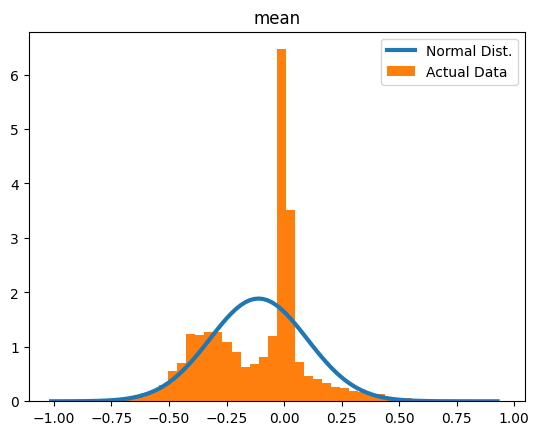

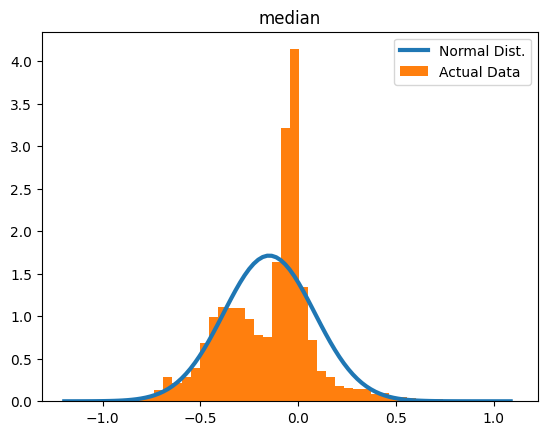

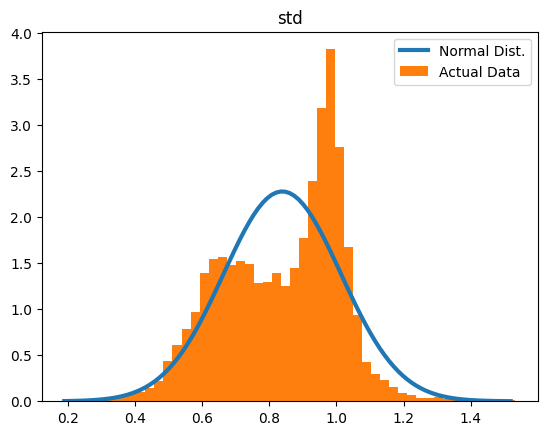

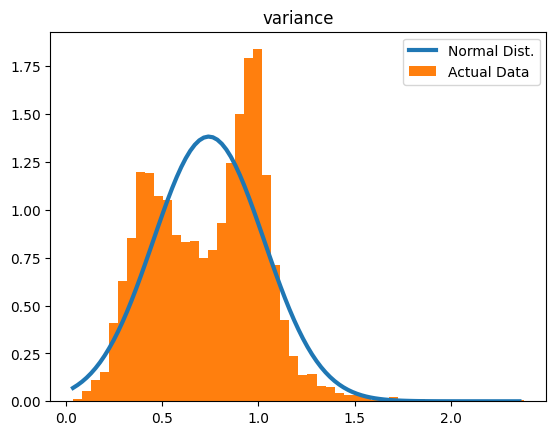

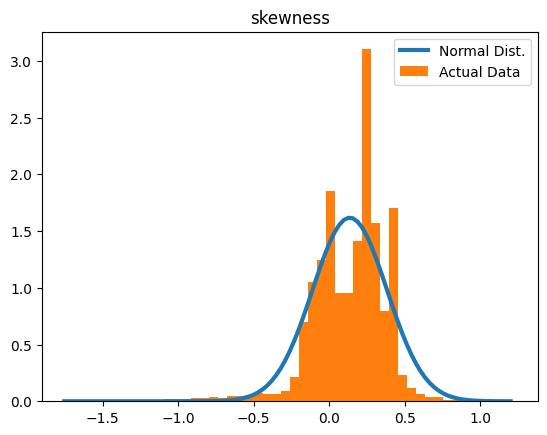

...

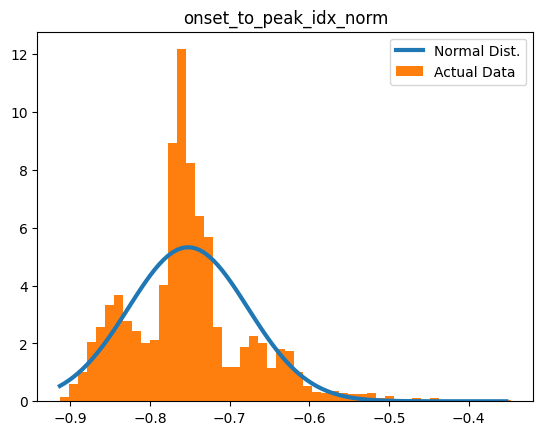

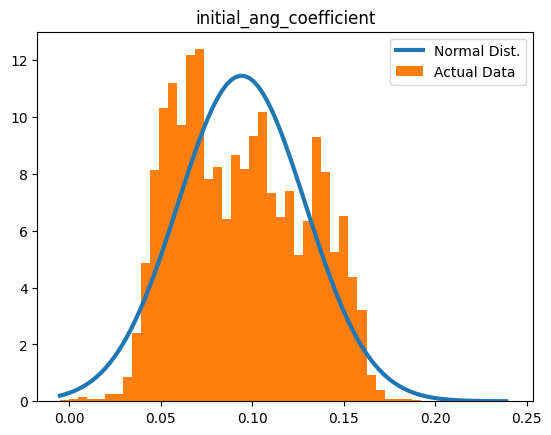

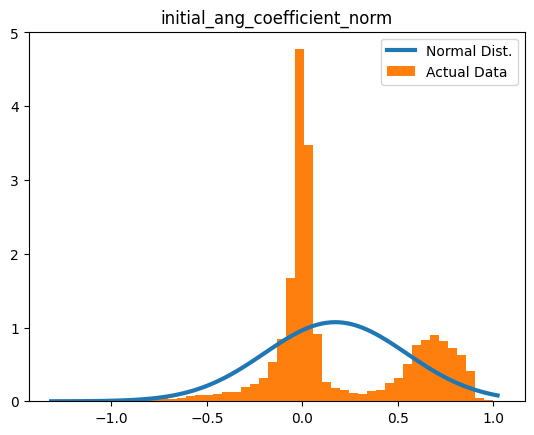

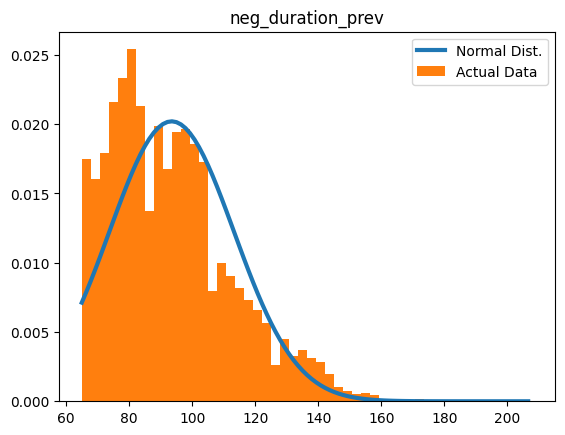

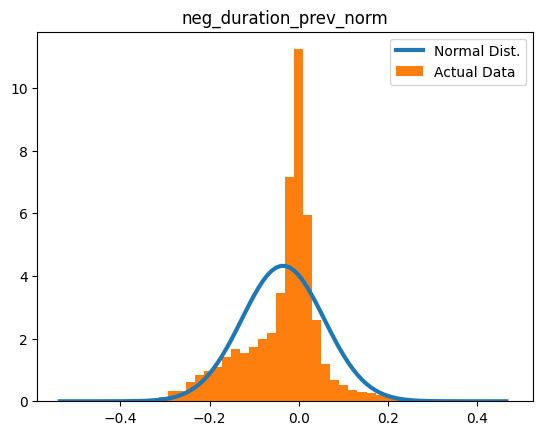

In [ ]:
# Visualize data distribution for each feature
for col in X_train_under.columns:
  step = (X_train_under[col].max() - X_train_under[col].min())/100
  xs = np.arange(X_train_under[col].min(), X_train_under[col].max(), step)
  fit = stats.norm.pdf(xs, np.mean(X_train_under[col]), np.std(X_train_under[col]))
  plt.plot(xs, fit, label='Normal Dist.', lw=3)
  # plt: PlotDataItem
  plt.hist(X_train_under[col], 50, density=True, label='Actual Data');
  plt.title(col)
  plt.legend()
  plt.show()

In [ ]:
# useful functions

# plots the number of segments for each number of outliers
# and the number of outliers per feature
def plot_outliersAnalysis(abs_zscores):
  # number of outliers per subject
  bool_zscores = (abs_zscores > 3).sum(axis=1)
  bool_zscores.hist()
  plt.xlabel("Number of outliers")
  plt.ylabel("Number of segments")
  plt.show()

  # number of outliers per feature
  bool_zscores = (abs_zscores > 3).sum(axis=0)
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])

  ax.bar(feature_list,bool_zscores)
  plt.title("Number of outliers per feature")
  plt.xticks(np.arange(len(feature_list)), feature_list,rotation=90)
  plt.show()
  return

In [ ]:
# Perform z-scoring for outlier removal
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler


feature_list = X_train_under.columns
print('Missing values before outlier removal: ' + str(X_train_under.isnull().sum().sum()))
# il primo .sum() conta i valori per ogni colonna, il secondo .sum() i valori su tutte le colonne

# apply zscore
scaler = StandardScaler().fit(X_train_under)
zscore_X = scaler.transform(X_train_under)

# select all those values with zscore > -+ 3  as outliers
abs_zscores = np.abs(zscore_X)

outliers_detected = abs_zscores > 3
# we select all the features with value higher than 3
print('Outliers detected (train): ' + str(np.sum(np.sum(outliers_detected))))

# set outliers as missing values
X_train_under[outliers_detected] = np.nan
X_train_under =  pd.DataFrame(data=X_train_under, columns=feature_list)

print('Missing values after outlier removal (train): ' + str(X_train_under.isnull().sum().sum()))

abs_zscores =  pd.DataFrame(data=abs_zscores, columns=feature_list)
plot_outliersAnalysis(abs_zscores)
display(X_train_under)

In [ ]:
# Apply to validation set

zscore_features = scaler.transform(features_validation)
abs_zscores = np.abs(zscore_features)
outliers_detected = abs_zscores > 3
print('Outliers detected (validation): ' + str(np.sum(np.sum(outliers_detected))))

features_validation[outliers_detected] = np.nan
features_validation =  pd.DataFrame(data=features_validation, columns=feature_list)

print('Missing values after outlier removal (validation): ' + str(features_validation.isnull().sum().sum()))

In [ ]:
# Apply to test set

zscore_features = scaler.transform(features_test)
abs_zscores = np.abs(zscore_features)
outliers_detected = abs_zscores > 3
print('Outliers detected (test): ' + str(np.sum(np.sum(outliers_detected))))

features_test[outliers_detected] = np.nan
features_test =  pd.DataFrame(data=features_test, columns=feature_list)

print('Missing values after outlier removal (test): ' + str(features_test.isnull().sum().sum()))

## 10.2 Handling missing data

In [ ]:
# Regression: KNN imputation
# it takes into account all the features of each sample
# and creates some groups according to the characteristics of each patient
from sklearn.impute import KNNImputer
# define imputer
imputer = KNNImputer(n_neighbors=5 , weights='uniform', metric='nan_euclidean')
# fit on the dataset
imputer.fit(X_train_under)

feature_list = X_train_under.columns

features_train_KNN = imputer.transform(X_train_under)
features_train_KNN =  pd.DataFrame(data=features_train_KNN, columns=feature_list)

features_validation_KNN = imputer.transform(features_validation)
features_validation_KNN =  pd.DataFrame(data=features_validation_KNN, columns=feature_list)

features_test_KNN = imputer.transform(features_test)
features_test_KNN =  pd.DataFrame(data=features_test_KNN, columns=feature_list)

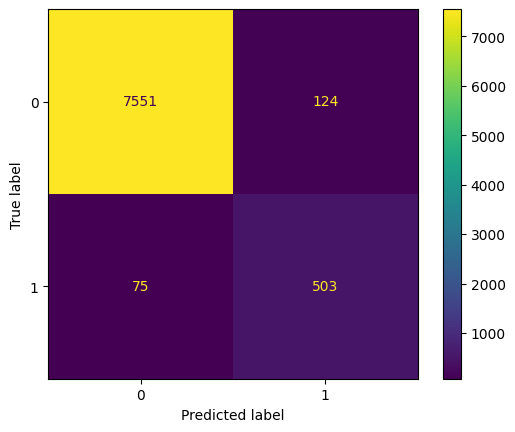

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      7675
           1       0.80      0.87      0.83       578

    accuracy                           0.98      8253
   macro avg       0.90      0.93      0.91      8253
weighted avg       0.98      0.98      0.98      8253



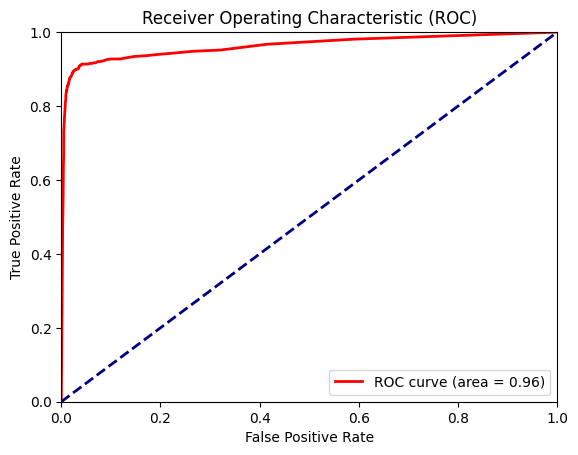

'              precision    recall  f1-score   support\n\n           0       0.99      0.98      0.99      7675\n           1       0.80      0.87      0.83       578\n\n    accuracy                           0.98      8253\n   macro avg       0.90      0.93      0.91      8253\nweighted avg       0.98      0.98      0.98      8253\n'

In [ ]:
#del clf
clf = clf_rf
testModel(features_train_KNN, y_train_under_binary, features_validation_KNN, labels_validation_binary, clf, ['0', '1'])

## 10.3 Data normalization

In [ ]:
# Standarize data with z-score transformation
from sklearn.preprocessing import StandardScaler

train_features_zscore = features_train_KNN
validation_features_zscore = features_validation_KNN
test_features_zscore = features_test_KNN

transformer = StandardScaler().fit(train_features_zscore)
train_features_zscore = transformer.transform(train_features_zscore)
train_features_zscore = pd.DataFrame(data=train_features_zscore, columns=feature_list)

# adapt validation set
validation_features_zscore = transformer.transform(validation_features_zscore)
validation_features_zscore = pd.DataFrame(data=validation_features_zscore, columns=feature_list)

# adapt test set
test_features_zscore = transformer.transform(test_features_zscore)
test_features_zscore = pd.DataFrame(data=test_features_zscore, columns=feature_list)

display(train_features_zscore)

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
0,0.387734,-0.349833,1.032635,1.098509,0.233839,-1.632651,1.059467,-0.060620,0.163610,-0.408338,...,0.870993,1.469582,-0.363238,1.992567,-0.081635,1.223233,-0.697654,-0.625944,1.403100,0.259096
1,-1.288618,-1.282659,-1.320862,-1.306681,1.065325,1.664909,-1.474886,-1.069895,-0.141028,-0.804212,...,0.783000,-0.183691,1.996649,-1.210016,0.151988,-1.604881,-0.699638,1.573227,-0.992345,-1.925731
2,0.736034,0.703907,0.853203,0.877478,-0.750803,-1.322549,0.873893,0.114656,0.692677,-0.267284,...,-0.052936,0.235981,-0.695711,1.191921,0.164764,1.230920,-0.270799,-0.835306,0.332795,0.238427
3,-0.752651,-0.779218,-1.256485,-1.258144,0.401554,0.072620,-1.370981,-1.236297,1.045585,-1.290186,...,1.926912,0.186210,1.349595,-0.981260,-0.072719,-1.387329,-0.946768,1.546312,-0.941378,-2.591952
4,1.315181,1.008248,1.451798,1.672421,0.983211,0.963743,0.721662,2.205863,-2.915206,2.471790,...,-1.284841,-1.187806,-1.534353,-0.066236,-0.075045,1.293073,2.115351,-1.675818,-0.941378,0.777250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12704,0.424144,0.129589,-0.114116,-0.213791,-0.070294,-1.304828,-0.127286,-0.179730,0.270304,-0.257992,...,-1.460828,-1.387812,-0.946568,0.848787,-0.136444,1.137650,-0.682067,-0.235183,-1.145246,-0.053813
12705,0.524217,0.576448,1.175558,1.276855,1.203767,1.065731,1.914970,0.610960,-0.624190,-0.065561,...,2.058902,2.497685,-0.555328,1.420677,0.088805,0.106039,0.120776,-0.624029,2.779206,1.127267
12706,-0.209090,-0.725043,1.573840,1.816169,-0.202614,-1.897155,1.546286,-0.310583,0.094939,-1.046215,...,1.143772,2.076524,-0.823282,1.557931,-0.144790,2.549902,-1.197386,-2.054977,1.260393,2.542714
12707,0.469058,0.424470,0.370408,0.311919,0.576976,0.496173,0.147745,1.384869,-1.215660,1.564143,...,-0.501701,-0.875521,-0.643061,-0.523748,-0.074526,-0.242625,1.646943,-0.400421,-0.686543,0.056592


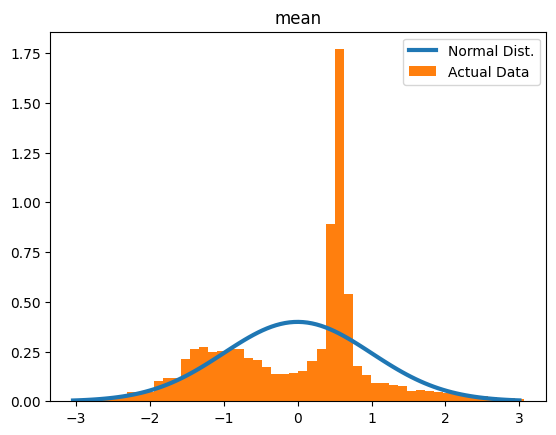

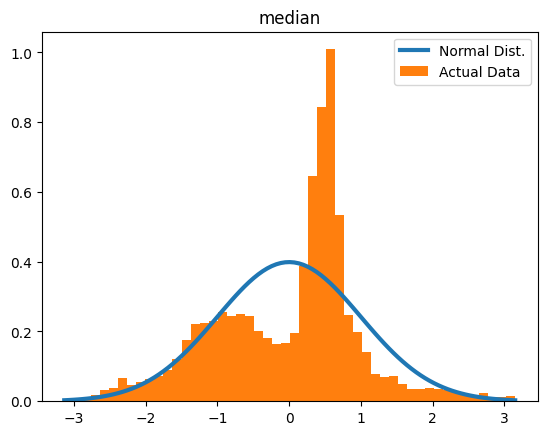

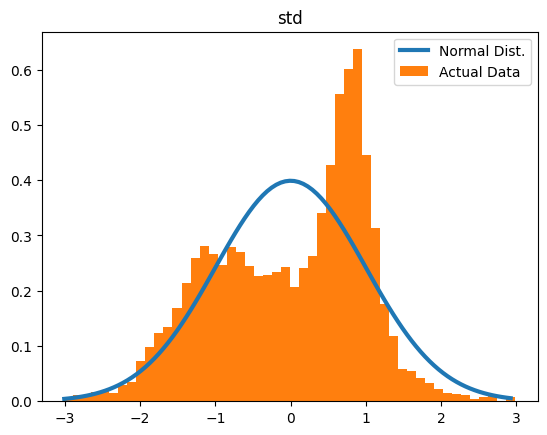

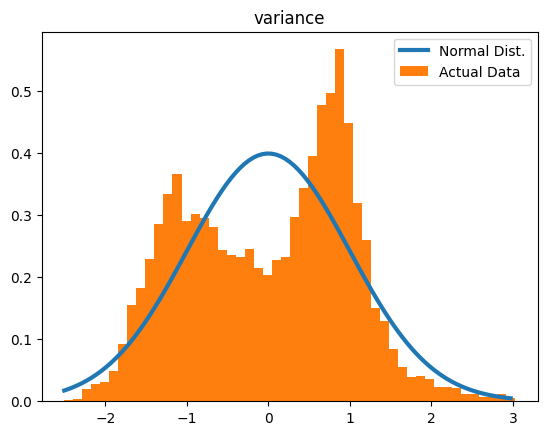

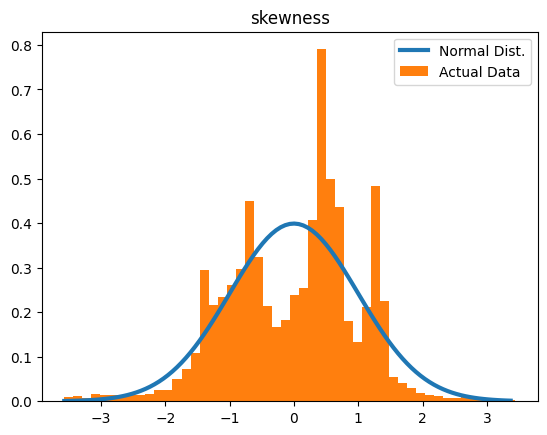

...

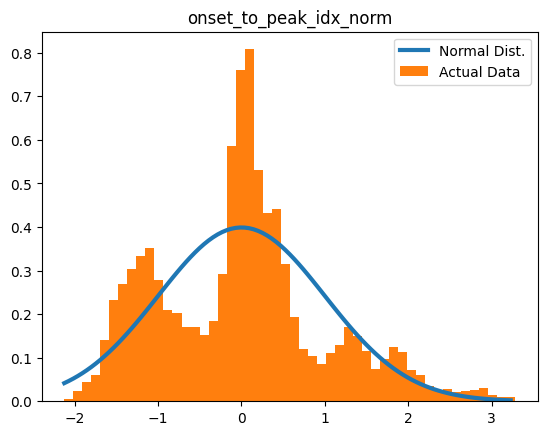

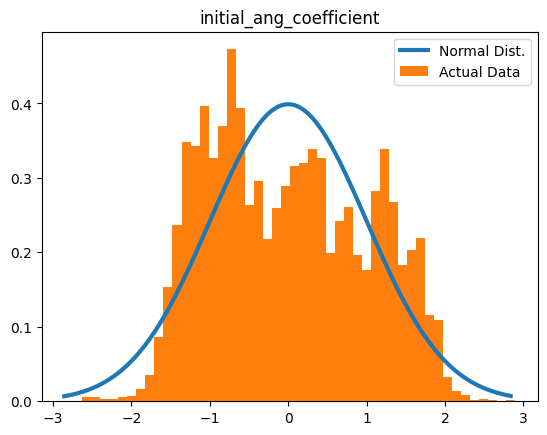

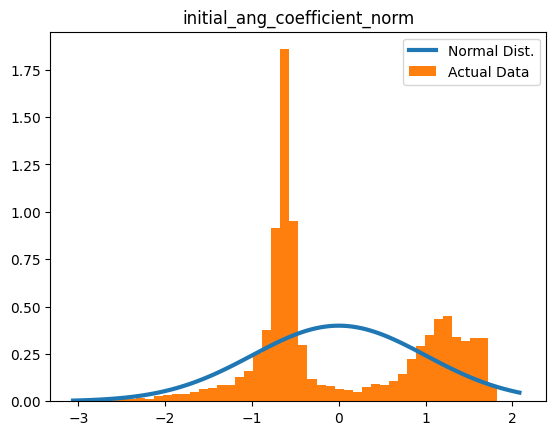

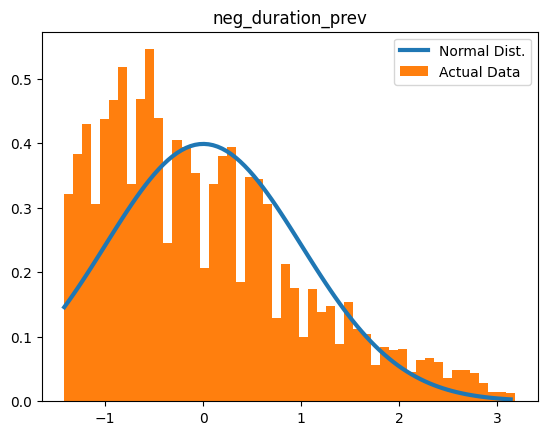

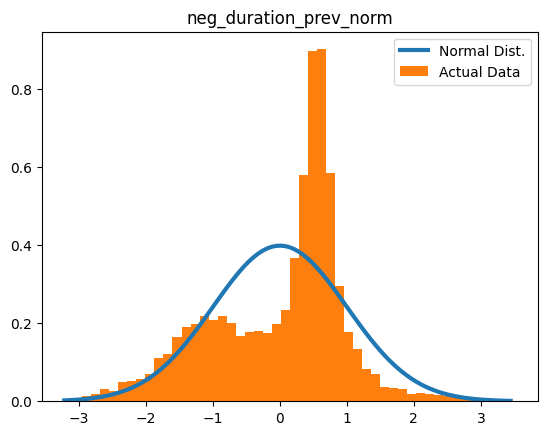

In [ ]:
# Visualize data distribution for each feature
for col in train_features_zscore.columns:
  step = (train_features_zscore[col].max() - train_features_zscore[col].min())/100
  xs = np.arange(train_features_zscore[col].min(), train_features_zscore[col].max(), step)
  fit = stats.norm.pdf(xs, np.mean(train_features_zscore[col]), np.std(train_features_zscore[col]))
  plt.plot(xs, fit, label='Normal Dist.', lw=3)
  plt.hist(train_features_zscore[col], 50, density=True, label='Actual Data');
  plt.title(col)
  plt.legend()
  plt.show()

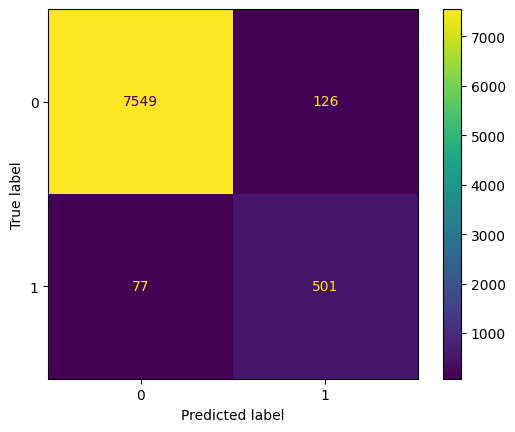

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      7675
           1       0.80      0.87      0.83       578

    accuracy                           0.98      8253
   macro avg       0.89      0.93      0.91      8253
weighted avg       0.98      0.98      0.98      8253



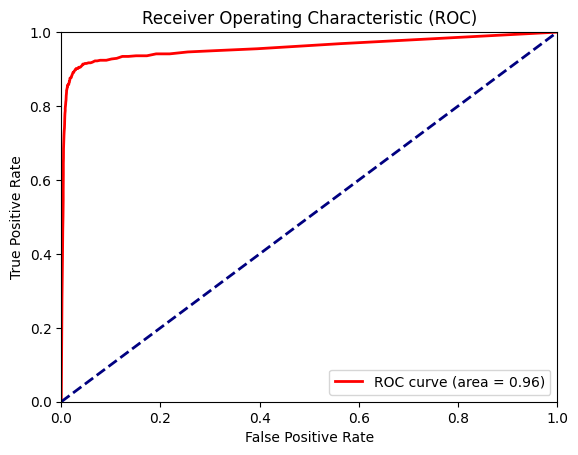

'              precision    recall  f1-score   support\n\n           0       0.99      0.98      0.99      7675\n           1       0.80      0.87      0.83       578\n\n    accuracy                           0.98      8253\n   macro avg       0.89      0.93      0.91      8253\nweighted avg       0.98      0.98      0.98      8253\n'

In [ ]:
"Evaluate model"
del clf
clf = clf_rf
testModel(train_features_zscore, y_train_under_binary, validation_features_zscore, labels_validation_binary, clf, ['0', '1'])

In [ ]:
# Apply robust scaling to features
from sklearn.preprocessing import RobustScaler

train_features_rs = features_train_KNN
validation_features_rs = features_validation_KNN
test_features_rs = features_test_KNN

feature_list = train_features_rs.columns

transformer = RobustScaler().fit(train_features_rs)
train_features_rs = transformer.transform(train_features_rs)

train_features_rs = pd.DataFrame(data=train_features_rs, columns=feature_list)
display(train_features_rs)

# adapt validation set
validation_features_rs = transformer.transform(validation_features_rs)
validation_features_rs = pd.DataFrame(data=validation_features_rs, columns=feature_list)

# adapt test set
test_features_rs = transformer.transform(test_features_rs)
test_features_rs = pd.DataFrame(data=test_features_rs, columns=feature_list)

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
0,-0.018614,-0.501946,0.484292,0.544815,0.009647,-0.772671,0.532465,-0.085210,-0.030364,-0.235711,...,0.718954,1.119211,0.085088,1.500000,0.193297,1.056806,-0.387167,-0.060928,1.148148,-0.068099
1,-1.209904,-1.217251,-0.970503,-0.867558,0.598088,1.097557,-0.988737,-0.665427,-0.226012,-0.491491,...,0.653595,-0.023129,1.660096,-0.833333,1.239973,-1.337609,-0.388370,1.225758,-0.592593,-1.709525
2,0.228903,0.306079,0.373377,0.415021,-0.687183,-0.596795,0.421078,0.015554,0.309419,-0.144574,...,0.032680,0.266846,-0.136807,0.916667,1.297213,1.063315,-0.128498,-0.183421,0.370370,-0.083627
3,-0.829023,-0.831205,-0.930709,-0.839056,0.128339,0.194482,-0.926370,-0.761089,0.536067,-0.805487,...,1.503268,0.232457,1.228247,-0.666667,0.233246,-1.153419,-0.538127,1.210011,-0.555556,-2.210046
4,0.640471,0.539453,0.743394,0.881827,0.539976,0.699887,0.329704,1.217760,-2.007675,1.625186,...,-0.882353,-0.716928,-0.696523,0.000000,0.222823,1.115936,1.317482,-0.675186,-0.555556,0.321182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12704,0.007260,-0.134318,-0.224563,-0.225792,-0.205588,-0.586745,-0.179863,-0.153684,0.038158,-0.138570,...,-1.013072,-0.855124,-0.304231,0.666667,-0.052257,0.984348,-0.377721,0.167698,-0.703704,-0.303182
12705,0.078377,0.208341,0.572638,0.649543,0.696064,0.757730,1.045967,0.300873,-0.536314,-0.014237,...,1.601307,1.829585,-0.043114,1.083333,0.956905,0.110937,0.108792,-0.059807,2.148148,0.584145
12706,-0.442743,-0.789662,0.818833,0.966238,-0.299230,-0.922686,0.824671,-0.228910,-0.074467,-0.647853,...,0.921569,1.538581,-0.221949,1.183333,-0.089648,2.180027,-0.689999,-0.897023,1.044444,1.647548
12707,0.039178,0.091802,0.074941,0.082915,0.252485,0.434702,-0.014780,0.745782,-0.916174,1.038741,...,-0.300654,-0.501153,-0.101667,-0.333333,0.225147,-0.184259,1.033632,0.071021,-0.370370,-0.220236


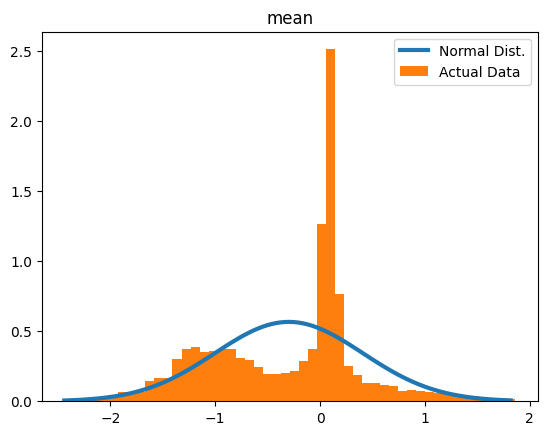

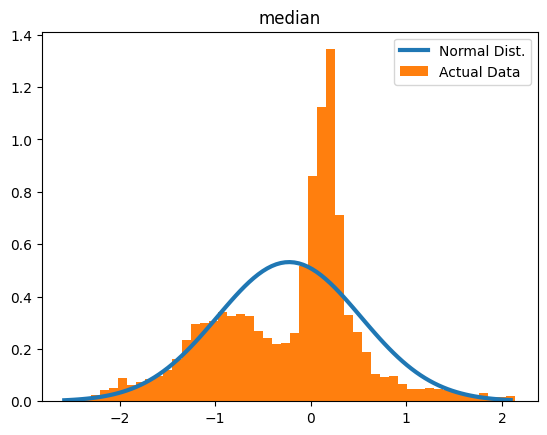

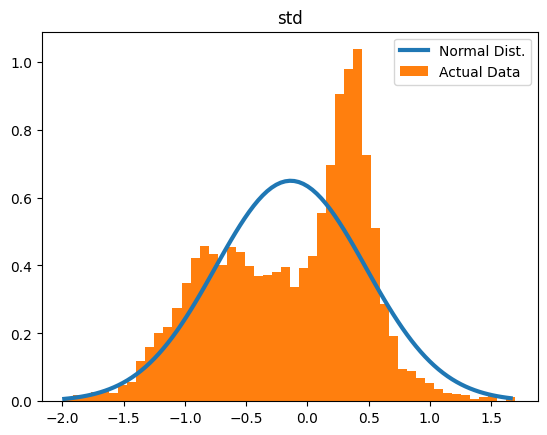

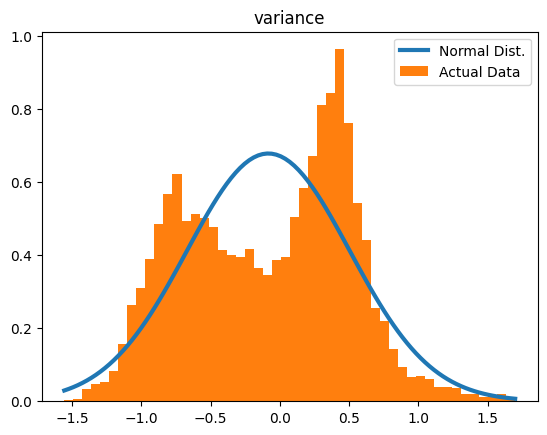

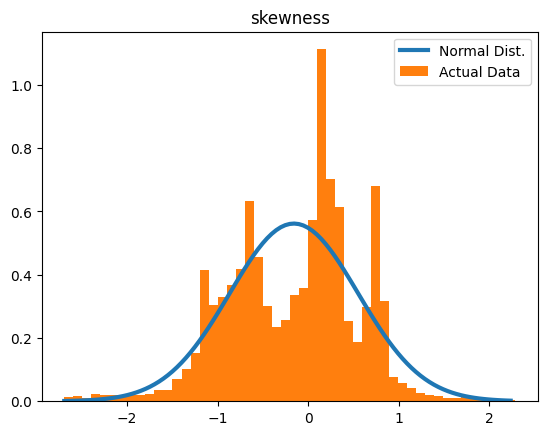

...

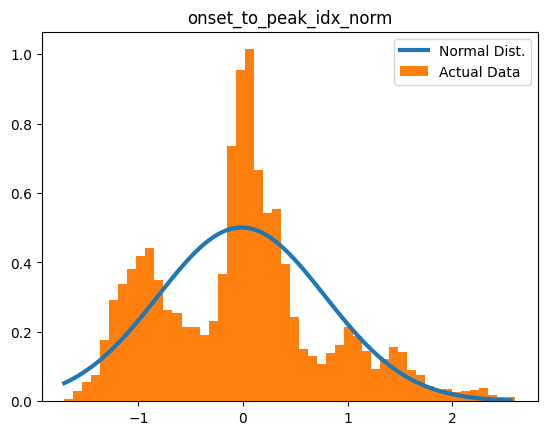

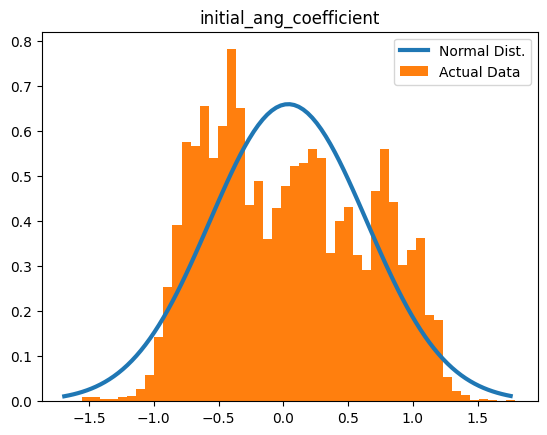

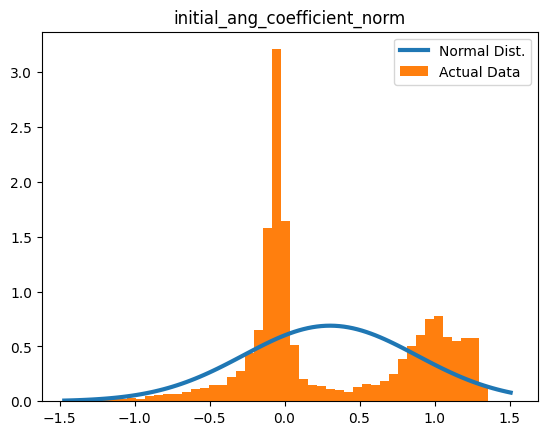

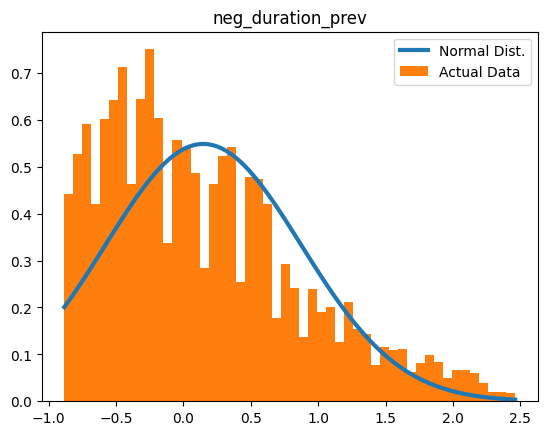

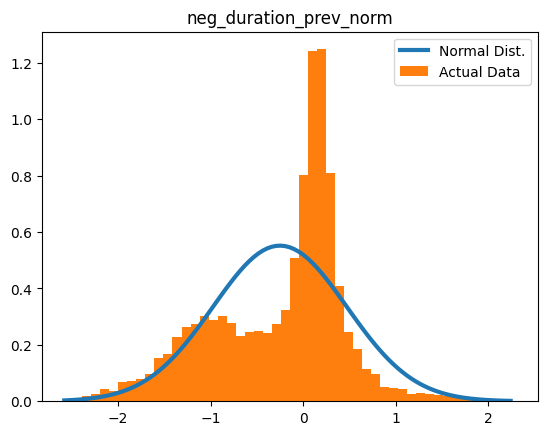

In [ ]:
# Visualize data distribution for each feature
for col in train_features_rs.columns:
  step = (train_features_rs[col].max() - train_features_rs[col].min())/100
  xs = np.arange(train_features_rs[col].min(), train_features_rs[col].max(), step)
  fit = stats.norm.pdf(xs, np.mean(train_features_rs[col]), np.std(train_features_rs[col]))
  plt.plot(xs, fit, label='Normal Dist.', lw=3)
  plt.hist(train_features_rs[col], 50, density=True, label='Actual Data');
  plt.title(col)
  plt.legend()
  plt.show()

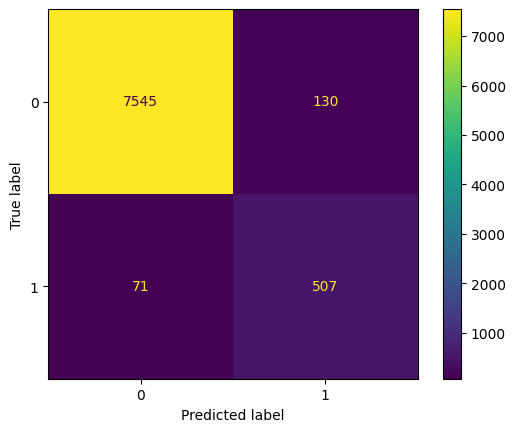

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      7675
           1       0.80      0.88      0.83       578

    accuracy                           0.98      8253
   macro avg       0.89      0.93      0.91      8253
weighted avg       0.98      0.98      0.98      8253



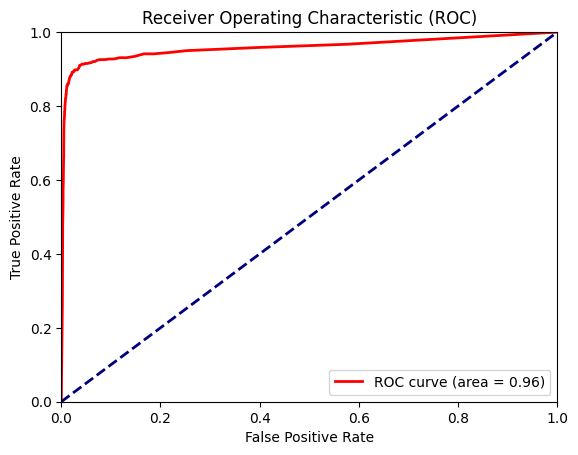

'              precision    recall  f1-score   support\n\n           0       0.99      0.98      0.99      7675\n           1       0.80      0.88      0.83       578\n\n    accuracy                           0.98      8253\n   macro avg       0.89      0.93      0.91      8253\nweighted avg       0.98      0.98      0.98      8253\n'

In [ ]:
"Evaluate model"
del clf
clf = clf_rf
testModel(train_features_rs, y_train_under_binary, validation_features_rs, labels_validation_binary, clf, ['0', '1'])

In [ ]:
from sklearn.preprocessing import MinMaxScaler

train_features_minmax = features_train_KNN # nan_median
validation_features_minmax = features_validation_KNN # nan_median
test_features_minmax = features_test_KNN # nan_median

# Min-max scaling
scaler = MinMaxScaler(feature_range=(0, 1))

# Fit on training data
scaler.fit(train_features_minmax)

# Transform training data
train_features_minmax = scaler.transform(train_features_minmax)
train_features_minmax = pd.DataFrame(data=train_features_minmax, columns=feature_list)

# Transform validation data
validation_features_minmax = scaler.transform(validation_features_minmax)
validation_features_minmax = pd.DataFrame(data=validation_features_minmax, columns=feature_list)

# Transform test data
test_features_minmax = scaler.transform(test_features_minmax)
test_features_minmax = pd.DataFrame(data=test_features_minmax, columns=feature_list)

# Display the scaled data
display(train_features_minmax)

,mean,median,std,variance,skewness,kurtosis,peak_area,max_first_derivative,min_first_derivative,max_second_derivative,...,post_RR,local_RR,pos_to_pos_post,onset_to_peak_idx,pos_to_pos_post_norm,onset_to_peak_idx_norm,initial_ang_coefficient,initial_ang_coefficient_norm,neg_duration_prev,neg_duration_prev_norm
0,0.560422,0.442027,0.670498,0.644852,0.543375,0.093194,0.687713,0.490761,0.618312,0.408051,...,0.595588,0.676222,0.434515,0.760870,0.494573,0.638700,0.398782,0.471877,0.629213,0.523108
1,0.285065,0.294246,0.280890,0.216615,0.663371,0.691757,0.247970,0.300697,0.559214,0.339881,...,0.580882,0.345479,0.838632,0.152174,0.501875,0.119007,0.398421,0.892550,0.101124,0.196944
2,0.617633,0.608964,0.640794,0.605498,0.401275,0.149483,0.655514,0.523769,0.720946,0.432341,...,0.441176,0.429436,0.377580,0.608696,0.502275,0.640113,0.476329,0.431828,0.393258,0.520022
3,0.373103,0.374003,0.291547,0.225256,0.567579,0.402730,0.265998,0.269360,0.789408,0.256196,...,0.772059,0.419479,0.727828,0.195652,0.494852,0.158984,0.353525,0.887402,0.112360,0.097486
4,0.712763,0.657179,0.739888,0.747036,0.651521,0.564484,0.629100,0.917581,0.021046,0.904012,...,0.235294,0.144602,0.233968,0.369565,0.494779,0.651534,0.909821,0.271049,0.112360,0.600461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12704,0.566402,0.517979,0.480660,0.411201,0.499483,0.152700,0.481796,0.468331,0.639009,0.433941,...,0.205882,0.104590,0.334623,0.543478,0.492860,0.622973,0.401614,0.546624,0.067416,0.476395
12705,0.582840,0.588771,0.694158,0.676606,0.683351,0.582996,0.836155,0.617232,0.465485,0.467078,...,0.794118,0.881897,0.401620,0.652174,0.499901,0.433405,0.547466,0.472243,0.932584,0.652713
12706,0.462388,0.382585,0.760091,0.772629,0.480388,0.045182,0.772183,0.443689,0.604990,0.298208,...,0.641176,0.797643,0.355735,0.678261,0.492599,0.882488,0.307996,0.198521,0.597753,0.864020
12707,0.573780,0.564695,0.560870,0.504802,0.592895,0.479612,0.529518,0.762973,0.350744,0.747714,...,0.366176,0.207076,0.386596,0.282609,0.494795,0.369334,0.824725,0.515016,0.168539,0.492877


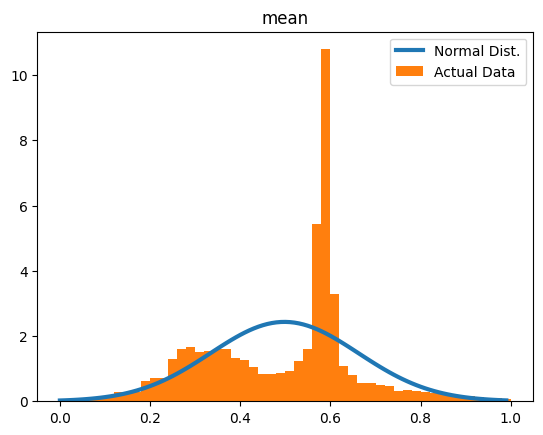

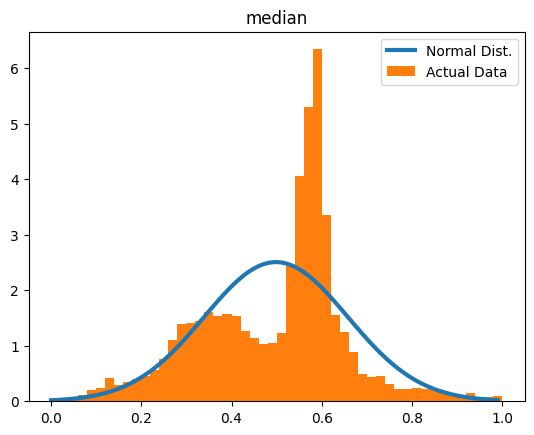

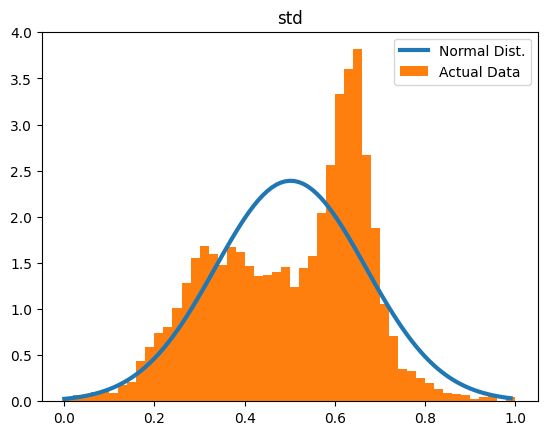

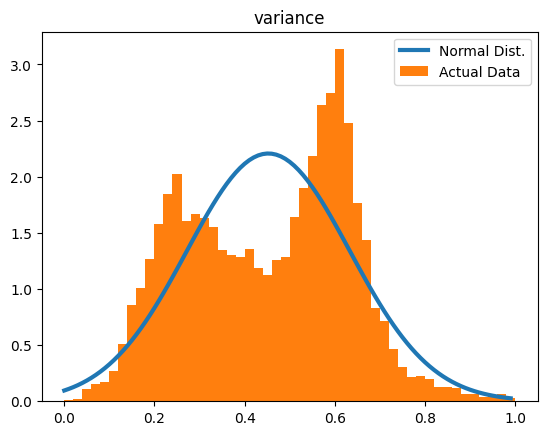

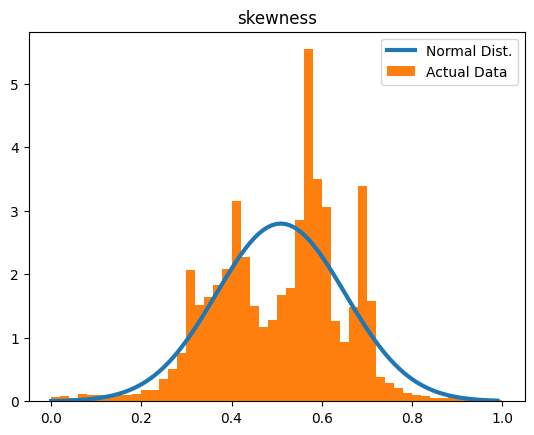

...

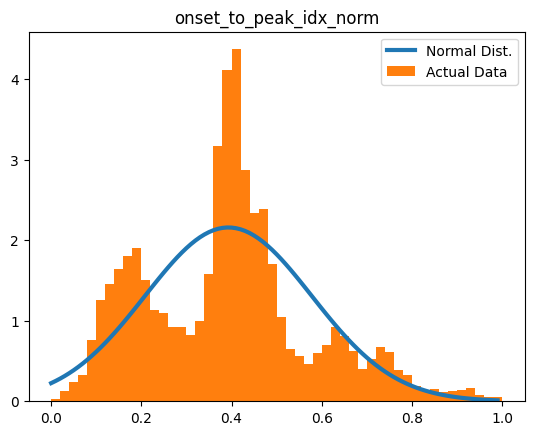

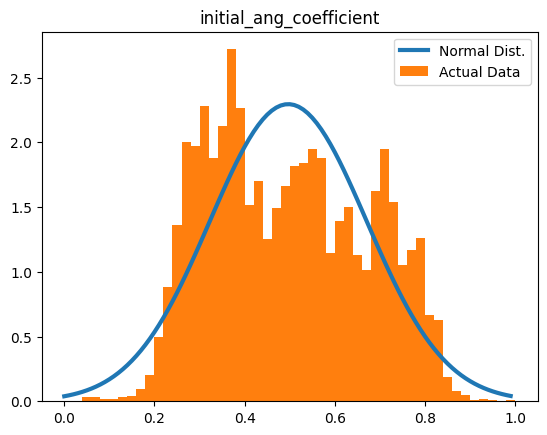

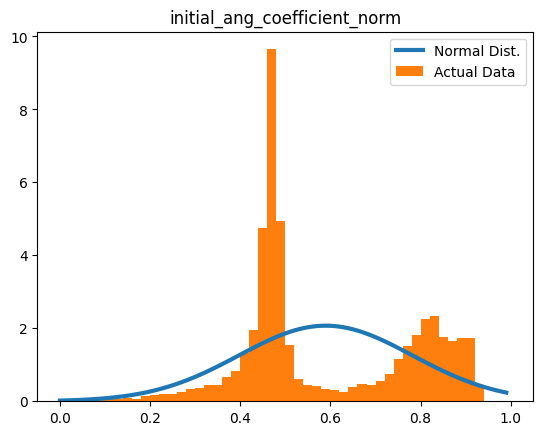

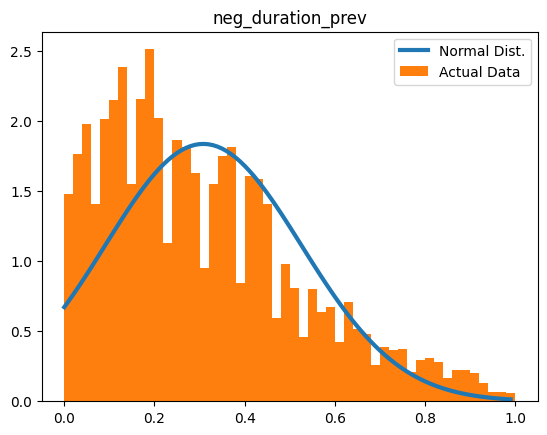

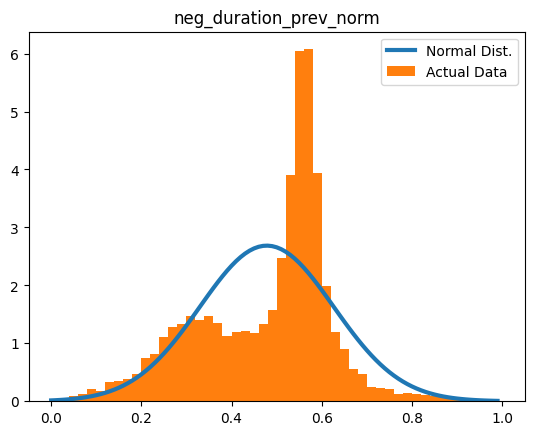

In [ ]:
# Visualize data distribution for each feature
for col in train_features_minmax.columns:
  step = (train_features_minmax[col].max() - train_features_minmax[col].min())/100
  xs = np.arange(train_features_minmax[col].min(), train_features_minmax[col].max(), step)
  fit = stats.norm.pdf(xs, np.mean(train_features_minmax[col]), np.std(train_features_minmax[col]))
  plt.plot(xs, fit, label='Normal Dist.', lw=3)
  plt.hist(train_features_minmax[col], 50, density=True, label='Actual Data');
  plt.title(col)
  plt.legend()
  plt.show()

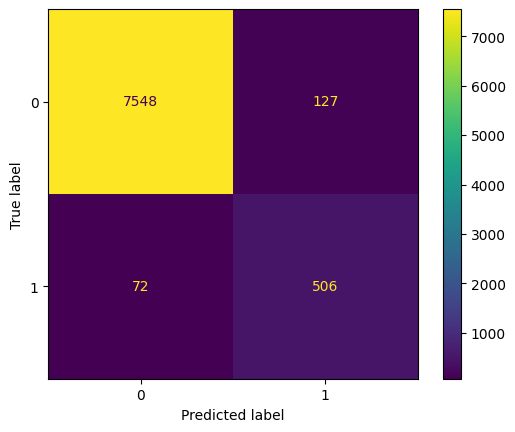

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      7675
           1       0.80      0.88      0.84       578

    accuracy                           0.98      8253
   macro avg       0.89      0.93      0.91      8253
weighted avg       0.98      0.98      0.98      8253



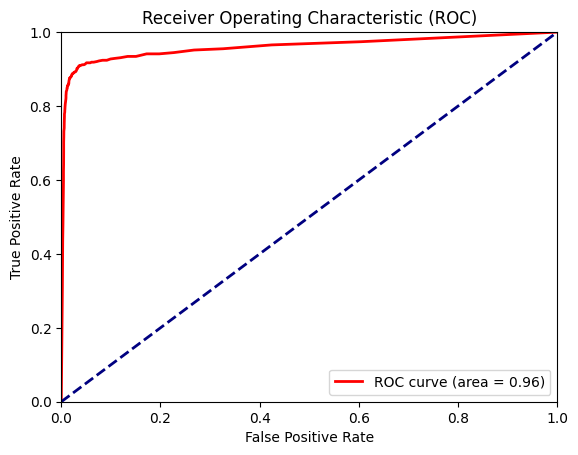

'              precision    recall  f1-score   support\n\n           0       0.99      0.98      0.99      7675\n           1       0.80      0.88      0.84       578\n\n    accuracy                           0.98      8253\n   macro avg       0.89      0.93      0.91      8253\nweighted avg       0.98      0.98      0.98      8253\n'

In [ ]:
"Evaluate model"
del clf
clf = clf_rf
testModel(train_features_minmax, y_train_under_binary, validation_features_minmax, labels_validation_binary, clf, ['0', '1'])

# 11 Feature selection

## 11.1 Drop low variance and correlated features

In [ ]:
# useful functions

# plots the correlation matrix of the given correlation matrix and features
def plot_correlationMatrix(correlation_matrix, features):
    f = plt.figure(figsize=(10, 8))
    plt.matshow(correlation_matrix, fignum=f.number)
    plt.xticks(range(len(features)), features, fontsize=10, rotation=90)
    plt.yticks(range(len(features)), features, fontsize=10)
    cb = plt.colorbar()
    cb.ax.tick_params(labelsize=14)
    #plt.title('Correlation Matrix', fontsize=16)
    # plt.tight_layout()
    return

# plots the recurrent FE
def plot_recurrentFE(min_features_to_select, rfecv):
  plt.figure()
  plt.xlabel("Number of features selected")
  plt.ylabel("Cross validation score (accuracy)")
  n_features = len(rfecv.cv_results_['mean_test_score'])
  plt.plot(range(min_features_to_select, min_features_to_select + n_features), rfecv.cv_results_['mean_test_score'])
  plt.show()

# selects the features of the given train and validation features with their labels
def feature_selection(train_features, validation_features, train_labels):
 # 4.1. Eliminate low variance features
  vt = VarianceThreshold(threshold=(0.01)) # eliminate constant features
  train_features_var = vt.fit_transform(train_features)
  mask = vt.get_support()
  train_features = train_features.loc[:, mask]
  feature_list = train_features.columns

  # plot deleted features
  print('Deleted features: ' + str(list(compress(feature_list, ~mask))))

  # 4.2. Eliminate correlated features
  # a. visualize correlation matrix
  cor_matrix = train_features.corr().abs()
  plot_correlationMatrix(cor_matrix, feature_list)

  # b. drop correlated features
  correlated_features = set()
  correlation_matrix = train_features.corr()
  mean_corr = (correlation_matrix.abs()).mean(axis=0)

  for i in range(len(correlation_matrix.columns)):
      for j in range(i):
          if abs(correlation_matrix.iloc[i, j]) > 0.7:
              if mean_corr[i] > mean_corr[j]:
                  colname = correlation_matrix.columns[i]
              else:
                  colname = correlation_matrix.columns[j]
              correlated_features.add(colname)
  train_features.drop(labels=correlated_features, axis=1, inplace=True)
  # see how it drops correlated / drop the one that had a lower correlation w.r to the other feat
  print('Deleted features: ' + str(correlated_features))

  # c. plot correlation matrix with remaining features
  cor_matrix = train_features.corr().abs()
  feature_list = list(train_features.columns)
  f2 = plot_correlationMatrix(cor_matrix, feature_list)

  # adapt test set: pick only selected features
  validation_features = validation_features[feature_list]

  # by removing more and more features, i increase the accuracy

  # final selected features
  features_selected = train_features.columns

  return features_selected



Deleted features: ['neg_duration_norm', 'pre_RR', 'post_RR', 'neg_duration_prev']


<ipython-input-78-5ccd19c53da4>:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_features.drop(labels=correlated_features, axis=1, inplace=True)


Deleted features: {'upslope_ampl', 'neg_duration', 'initial_ang_coefficient_norm', 'neg_to_neg_actual', 'downslope_ampl_prev_norm', 'std', 'peak_area', 'max_second_derivative', 'mean', 'pos_to_pos', 'pre_RR', 'neg_duration_prev', 'median', 'downslope_ampl_prev', 'neg_to_neg', 'upslope_ampl_norm', 'post_RR', 'min_first_derivative', 'dis', 'pos_to_pos_post', 'max_first_derivative', 'initial_ang_coefficient', 'onset_to_peak_idx', 'variance', 'onset_to_peak_idx_norm'}


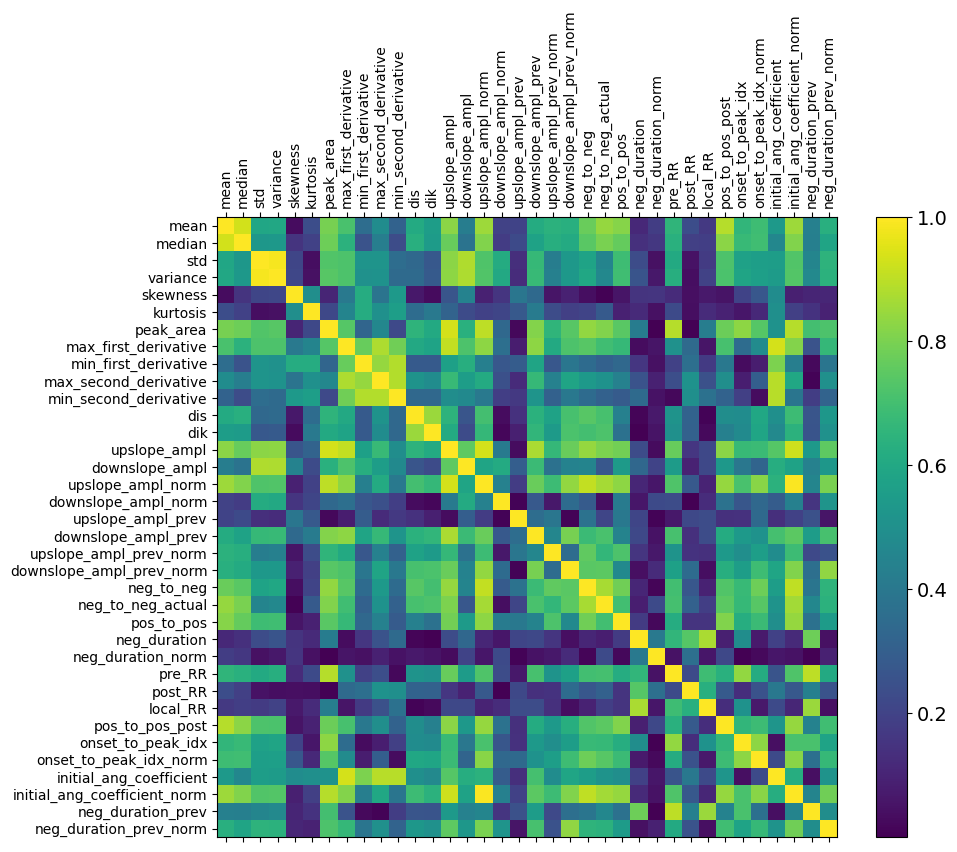

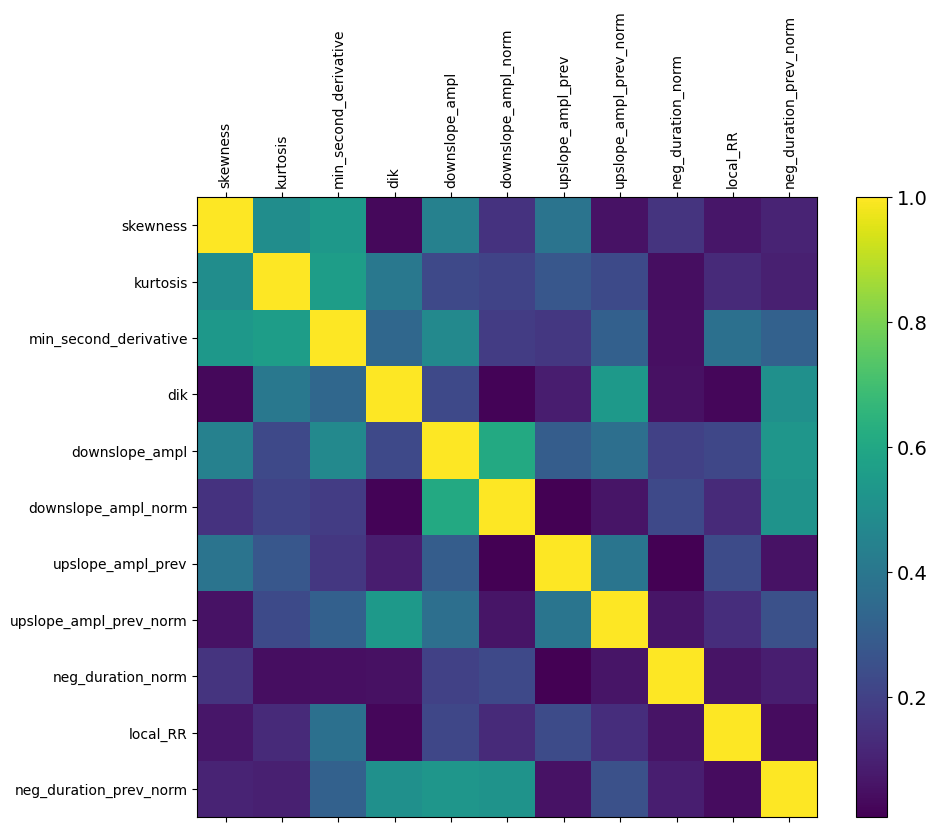

In [ ]:
features_selected = feature_selection(train_features_minmax, validation_features_minmax, y_train_under_binary)

In [ ]:
features_selected = ['skewness', 'kurtosis', 'min_second_derivative', 'dik', 'downslope_ampl', 'downslope_ampl_norm',
                             'upslope_ampl_prev', 'upslope_ampl_prev_norm',
                             'neg_duration_norm', 'local_RR',
                        'onset_to_peak_idx', 'neg_duration_prev_norm']

In [ ]:
train_features_selection = train_features_rs[features_selected]
validation_features_selection = validation_features_rs[features_selected]
test_features_selection = test_features_rs[features_selected]

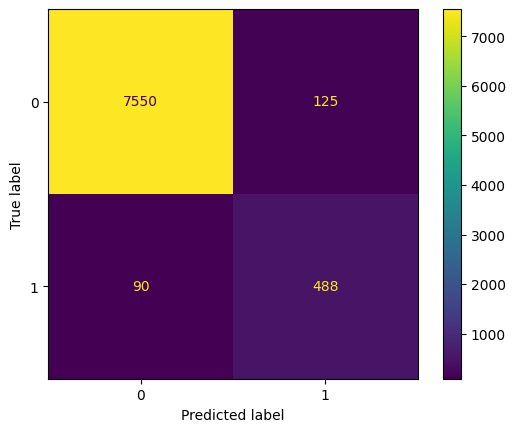

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      7675
           1       0.80      0.84      0.82       578

    accuracy                           0.97      8253
   macro avg       0.89      0.91      0.90      8253
weighted avg       0.97      0.97      0.97      8253



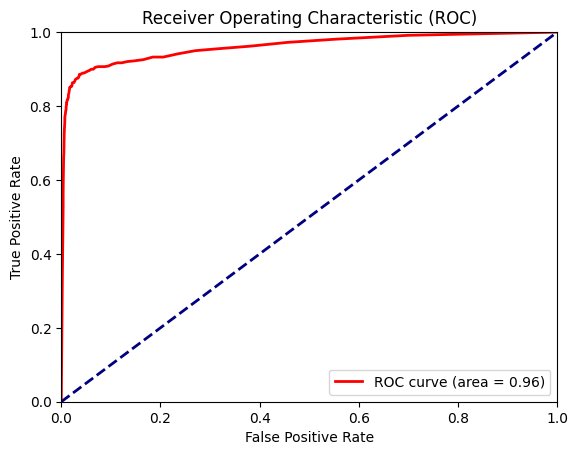

'              precision    recall  f1-score   support\n\n           0       0.99      0.98      0.99      7675\n           1       0.80      0.84      0.82       578\n\n    accuracy                           0.97      8253\n   macro avg       0.89      0.91      0.90      8253\nweighted avg       0.97      0.97      0.97      8253\n'

In [ ]:
"Evaluate model"
del clf
clf = clf_rf
testModel(train_features_selection, y_train_under_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

# 12 Oversampling

## 12.1 Features

In [ ]:

sampling_strategy = {
    0: X_features_train_0_under.shape[0],
    1: int(X_features_train_0_under.shape[0]*(1/2)),
    2: int(X_features_train_0_under.shape[0]*(1/2))
}

# Random Oversampling
ros = RandomOverSampler(random_state=42)

# SMOTE (Synthetic Minority Over-sampling Technique)
sm = SMOTE(sampling_strategy = sampling_strategy, random_state=42)

X_features_train_res, y_features_train_res = sm.fit_resample(train_features_selection, y_train_under)
X_features_train_res = np.array(X_features_train_res)
y_features_train_res = np.array(y_features_train_res)
print(X_features_train_res.shape, y_features_train_res.shape)

(15017, 12) (15017,)


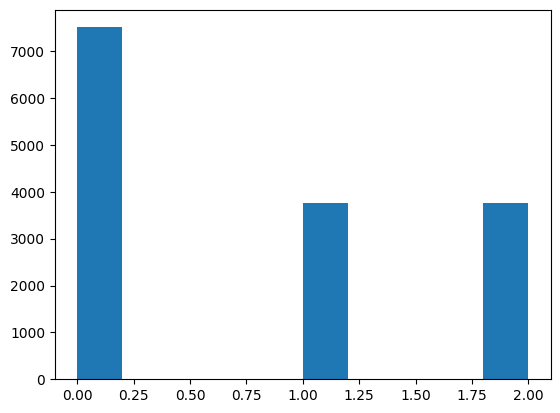

[7509 3754 3754]


In [ ]:
unique, counts = np.unique(y_features_train_res, return_counts=True)
plt.hist(y_features_train_res)
plt.show()
print(counts)

In [ ]:
X_features_train = X_features_train_res
y_features_train = y_features_train_res

X_features_train = pd.DataFrame(X_features_train, columns=train_features_selection.columns)

In [ ]:
X_features_train

,skewness,kurtosis,min_second_derivative,dik,downslope_ampl,downslope_ampl_norm,upslope_ampl_prev,upslope_ampl_prev_norm,neg_duration_norm,local_RR,onset_to_peak_idx,neg_duration_prev_norm
0,-0.880874,-0.644191,0.324345,-0.653609,-0.075887,-0.432462,-3.117659,-2.917492,1.164251,0.058636,1.818182,-0.307438
1,-0.706467,-0.383334,0.311336,0.593711,0.747637,0.009421,-1.826271,-0.357068,-0.472310,-0.745036,0.000000,-0.673006
2,1.237092,2.026209,-1.861061,3.866689,0.501654,0.067278,-0.488084,-0.811840,-0.475121,-0.606870,-0.181818,-0.109163
3,-0.507982,-0.169292,0.048043,-4.310462,-0.494496,0.272516,0.106514,0.798804,0.544217,0.213022,-0.454545,-1.306970
4,0.758803,0.980318,-1.076322,0.102492,-0.942164,-0.192714,1.172939,0.001659,0.305948,0.092230,0.181818,0.374019
...,...,...,...,...,...,...,...,...,...,...,...,...
15012,-1.970301,0.199107,0.606093,-0.048629,1.496656,0.252701,-0.560119,0.731675,0.378343,-0.126241,-0.312348,-0.693736
15013,-0.234880,-0.086169,0.016797,-0.980012,0.624459,1.529538,0.223857,0.624027,0.986388,-0.079612,-0.863741,-1.394667
15014,-0.492362,-0.558425,0.671528,-4.767043,0.272930,-2.422903,-0.180348,3.245041,1.920998,0.309310,-0.509347,0.826126
15015,0.752212,0.139002,-0.618757,-1.930115,0.212083,1.201214,1.771715,1.953366,-1.515545,-0.560195,-1.000000,-1.149659


In [ ]:
y_features_train_binary = []

for i in range(len(y_features_train)):
  if y_features_train[i]==0:
    y_features_train_binary.append('0')
  if y_features_train[i]==1:
    y_features_train_binary.append('1')
  if y_features_train[i]==2:
    y_features_train_binary.append('1')

y_features_train_binary = np.array(y_features_train_binary, dtype=int)

## 12.2 Segments

In [ ]:
sampling_strategy = {
    0: X_train_0_under.shape[0],
    1: int(X_train_0_under.shape[0]*(2/3)),
    2: int(X_train_0_under.shape[0]*(2/3))
}

sm = SMOTE(sampling_strategy = sampling_strategy, random_state=42)
X_train_res, y_train_res = sm.fit_resample(X_train_under, y_train_under)
X_train_res = np.array(X_train_res)
y_train_res = np.array(y_train_res)
print(X_train_res.shape, y_train_res.shape)

'\nsampling_strategy = {\n    0: X_train_0_under.shape[0],\n    1: int(X_train_0_under.shape[0]*(2/3)),\n    2: int(X_train_0_under.shape[0]*(2/3))\n}\n\nsm = SMOTE(sampling_strategy = sampling_strategy, random_state=42)\nX_train_res, y_train_res = sm.fit_resample(X_train_under, y_train_under)\nX_train_res = np.array(X_train_res)\ny_train_res = np.array(y_train_res)\nprint(X_train_res.shape, y_train_res.shape)\n'

In [ ]:
unique, counts = np.unique(y_train_res, return_counts=True)
plt.hist(y_train_res)
plt.show()
print(counts)

'def fromNANto9(input_array):\n  new_array = []\n  for i in range(len(input_array)):\n    input_array[i][input_array[i] == 999] = np.nan\n    new_array.append(input_array[i])\n\n  new_array = np.array(new_array)\n  return new_array'

In [ ]:
X_train = X_train_res
y_train = y_train_res

In [ ]:
y_val = y_labels_val
y_test = y_labels_test

# 13 Models

## 13.1 Machine learning

### 13.1.1 Train

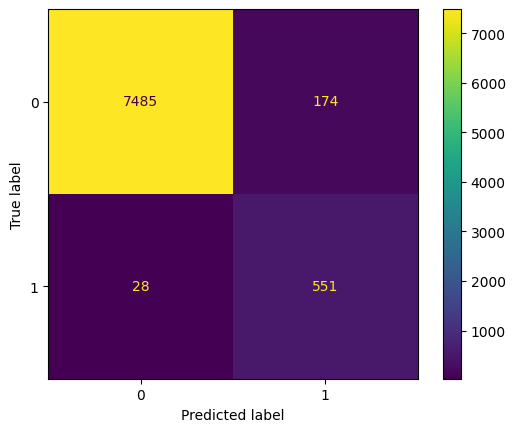

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      7659
           1       0.76      0.95      0.85       579

    accuracy                           0.98      8238
   macro avg       0.88      0.96      0.92      8238
weighted avg       0.98      0.98      0.98      8238



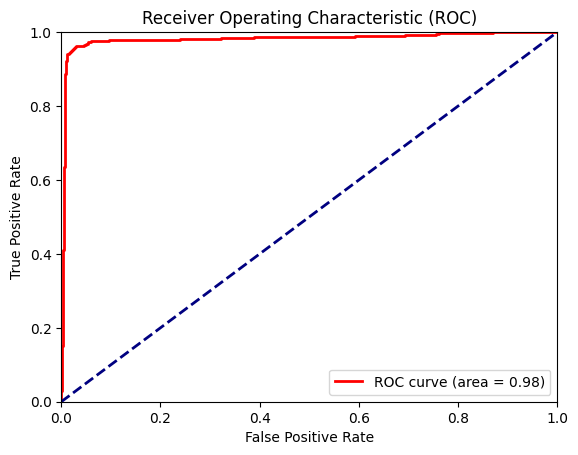

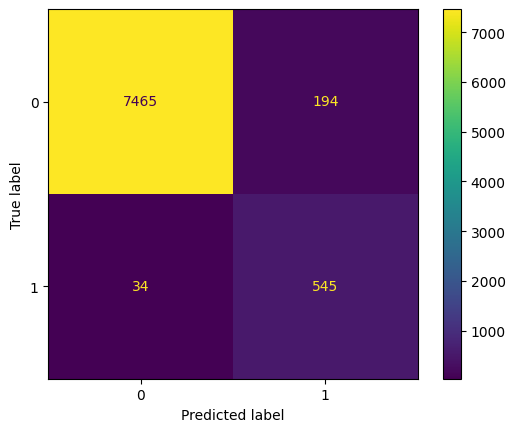

              precision    recall  f1-score   support

           0       1.00      0.97      0.98      7659
           1       0.74      0.94      0.83       579

    accuracy                           0.97      8238
   macro avg       0.87      0.96      0.91      8238
weighted avg       0.98      0.97      0.97      8238



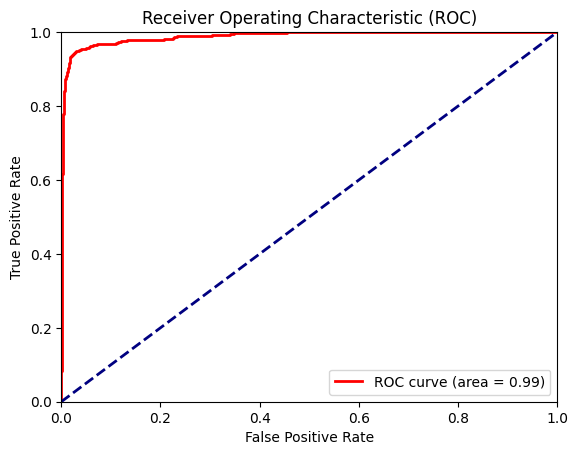

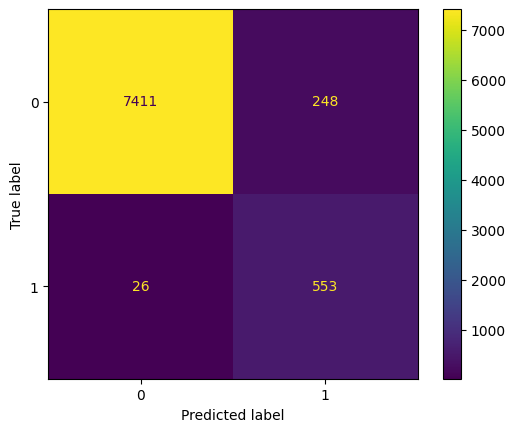

              precision    recall  f1-score   support

           0       1.00      0.97      0.98      7659
           1       0.69      0.96      0.80       579

    accuracy                           0.97      8238
   macro avg       0.84      0.96      0.89      8238
weighted avg       0.97      0.97      0.97      8238



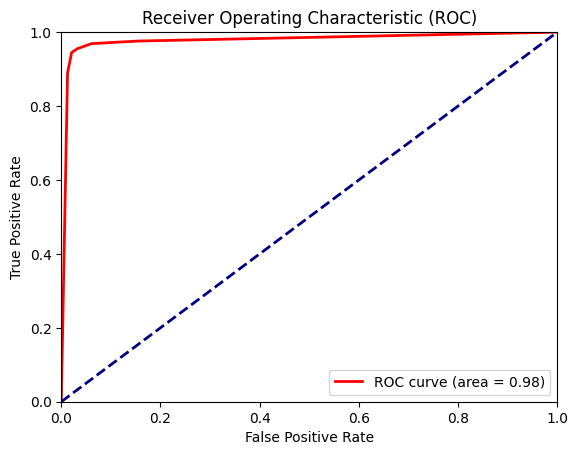

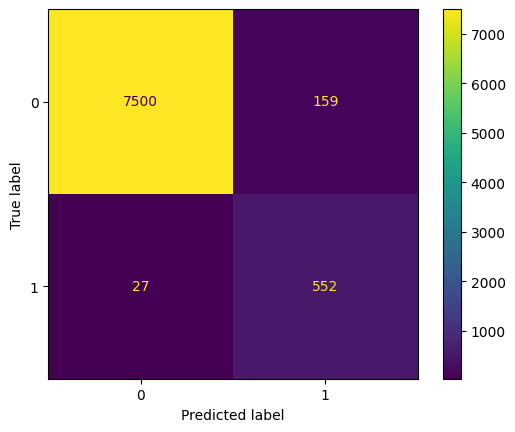

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      7659
           1       0.78      0.95      0.86       579

    accuracy                           0.98      8238
   macro avg       0.89      0.97      0.92      8238
weighted avg       0.98      0.98      0.98      8238



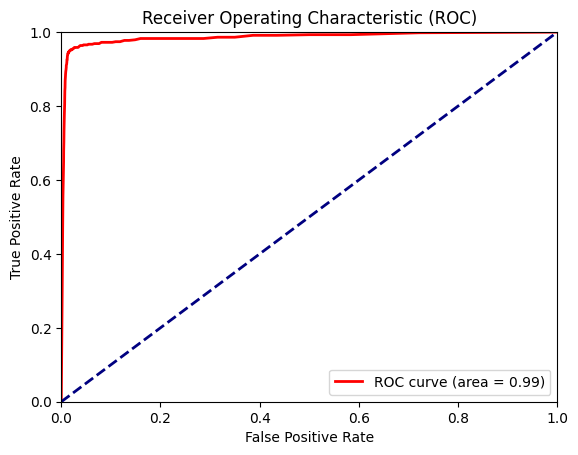

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


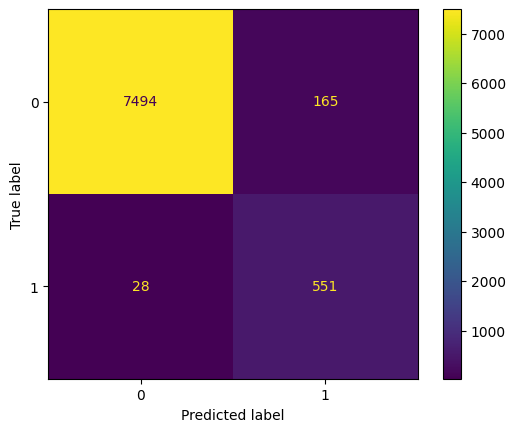

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      7659
           1       0.77      0.95      0.85       579

    accuracy                           0.98      8238
   macro avg       0.88      0.97      0.92      8238
weighted avg       0.98      0.98      0.98      8238



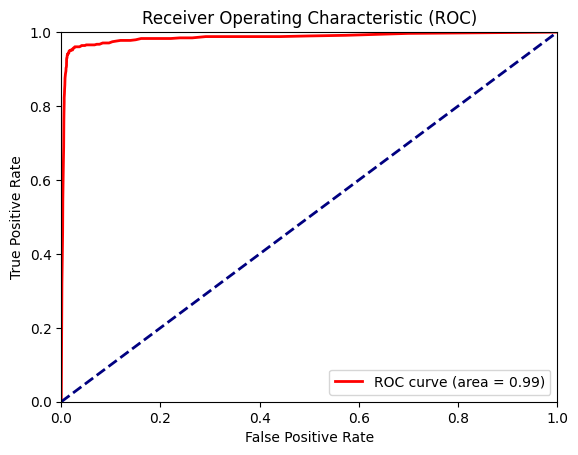

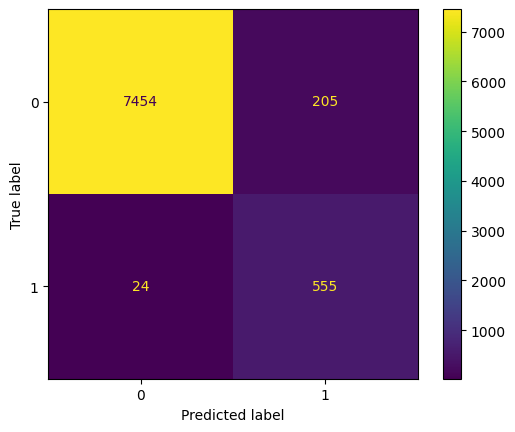

              precision    recall  f1-score   support

           0       1.00      0.97      0.98      7659
           1       0.73      0.96      0.83       579

    accuracy                           0.97      8238
   macro avg       0.86      0.97      0.91      8238
weighted avg       0.98      0.97      0.97      8238



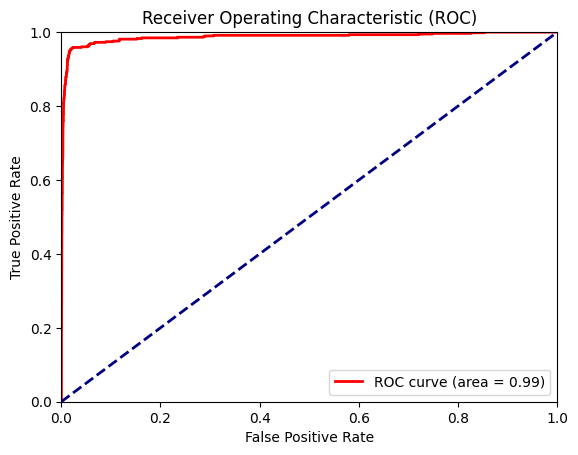

'              precision    recall  f1-score   support\n\n           0       1.00      0.97      0.98      7659\n           1       0.73      0.96      0.83       579\n\n    accuracy                           0.97      8238\n   macro avg       0.86      0.97      0.91      8238\nweighted avg       0.98      0.97      0.97      8238\n'

In [ ]:
# train the binary model with the train and validation set


# Binary SVM

clf = clf_svm

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

del clf

# Binary Linear Discriminant Analysis

clf = clf_lda

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

del clf

# Binary KNN

clf = clf_knn

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

del clf

# Binary Random Forest

clf = clf_rf

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

del clf

# Binary Ada Boost Classifier

clf = clf_ada

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

del clf

# Binary Gradient Boosting Classifier

clf = clf_grad

testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

In [ ]:
validation_labels_features = np.array(validation_labels_features, dtype=int)

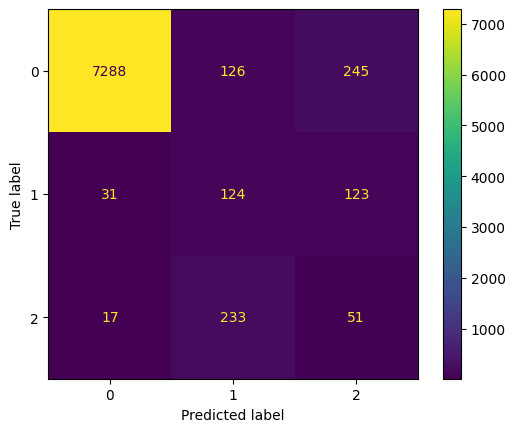

              precision    recall  f1-score   support

           0       0.99      0.95      0.97      7659
           1       0.26      0.45      0.33       278
           2       0.12      0.17      0.14       301

    accuracy                           0.91      8238
   macro avg       0.46      0.52      0.48      8238
weighted avg       0.94      0.91      0.92      8238



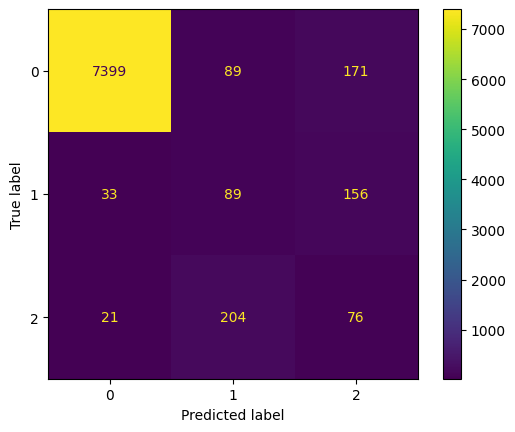

              precision    recall  f1-score   support

           0       0.99      0.97      0.98      7659
           1       0.23      0.32      0.27       278
           2       0.19      0.25      0.22       301

    accuracy                           0.92      8238
   macro avg       0.47      0.51      0.49      8238
weighted avg       0.94      0.92      0.93      8238



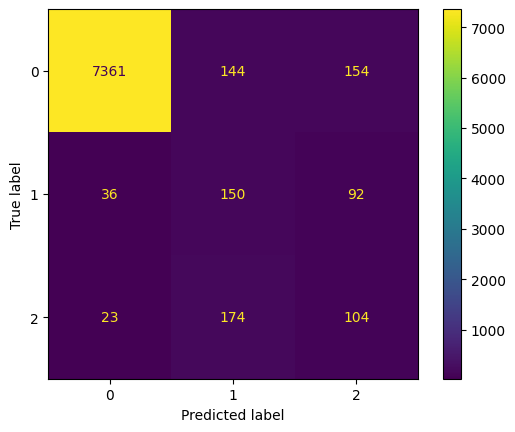

              precision    recall  f1-score   support

           0       0.99      0.96      0.98      7659
           1       0.32      0.54      0.40       278
           2       0.30      0.35      0.32       301

    accuracy                           0.92      8238
   macro avg       0.54      0.62      0.57      8238
weighted avg       0.94      0.92      0.93      8238



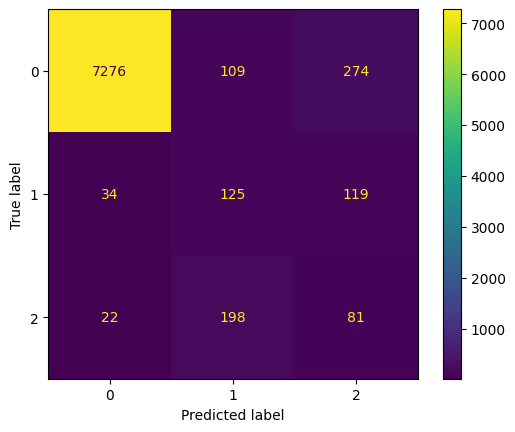

              precision    recall  f1-score   support

           0       0.99      0.95      0.97      7659
           1       0.29      0.45      0.35       278
           2       0.17      0.27      0.21       301

    accuracy                           0.91      8238
   macro avg       0.48      0.56      0.51      8238
weighted avg       0.94      0.91      0.92      8238



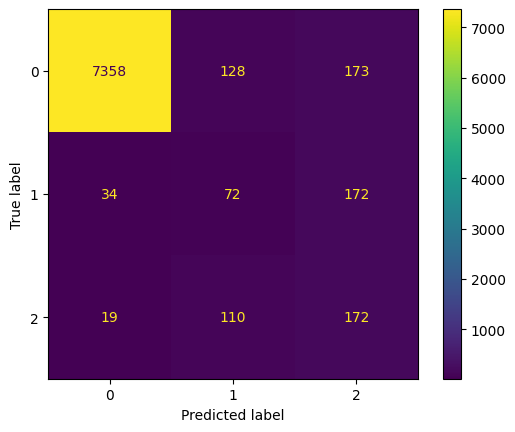

              precision    recall  f1-score   support

           0       0.99      0.96      0.98      7659
           1       0.23      0.26      0.24       278
           2       0.33      0.57      0.42       301

    accuracy                           0.92      8238
   macro avg       0.52      0.60      0.55      8238
weighted avg       0.94      0.92      0.93      8238



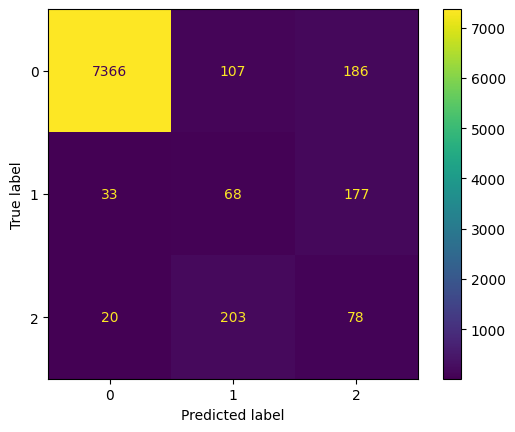

              precision    recall  f1-score   support

           0       0.99      0.96      0.98      7659
           1       0.18      0.24      0.21       278
           2       0.18      0.26      0.21       301

    accuracy                           0.91      8238
   macro avg       0.45      0.49      0.46      8238
weighted avg       0.94      0.91      0.92      8238



'              precision    recall  f1-score   support\n\n           0       0.99      0.96      0.98      7659\n           1       0.18      0.24      0.21       278\n           2       0.18      0.26      0.21       301\n\n    accuracy                           0.91      8238\n   macro avg       0.45      0.49      0.46      8238\nweighted avg       0.94      0.91      0.92      8238\n'

In [ ]:
# train the ternary model with the train and validation set

del clf

# Ternary SVM

clf = clf_svm

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

del clf

# Ternary Random Forest

clf = clf_rf

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

del clf

# Ternary Linear Discriminant Analysis

clf = clf_lda

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

del clf

# Ternary KNN

clf = clf_knn

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

# Ternary Ada Boost Classifier

clf = clf_ada

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

del clf

# Ternary Gradient Boosting Classifier

clf = clf_grad

testModel(X_features_train, y_features_train, validation_features_selection, validation_labels_features, clf, ['0', '1', '2'])

In [ ]:
X_train_full = X_features_train
X_train_full = X_train_full.append(validation_features_selection, ignore_index=True)
y_train_full_binary = np.concatenate((y_features_train_binary, labels_validation_binary))

In [ ]:
# Stratified K-fold cross-validation for svm

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
C_values = [0.1, 1.0, 10.0, 100.0]
gamma_values = [0.1, 1.0, 10.0]
degree_values = [2, 3, 4, 5]
kernels = ['linear', 'poly', 'rbf', 'sigmoid']
coef0_values =  [0.01, 0.1, 0.0, 1.0, 10.0]

best = 0


# Perform cross-validation to select the best parameters
for kernel in kernels:
  for C in C_values:
    for gamma in gamma_values:
      for coef0 in coef0_values:
        for degree in degree_values:
          model = SVC(
                kernel=kernel, # ‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’
                C=C,
                gamma=gamma,
                coef0=coef0,
                shrinking=True,
                probability=True,
                tol=0.001,
                cache_size=200,
                class_weight='balanced',
                verbose=False,
                max_iter=-1,
                decision_function_shape='ovr',
                break_ties=False)

          scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
          mean = np.mean(scores)
          std = np.std(scores)

          # Print the cross-validation scores
          print("Cross-Validation Scores:", scores)

          # Calculate and print the mean and standard deviation of the scores
          print("Mean f1_macro:", mean)
          print("Standard Deviation of f1_macro:", std)

          if (mean-0.5*std) > best:
                best = mean-0.5*std
                best_model = model


In [ ]:
# Stratified K-fold cross-validation for lda

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
solvers = ['svd', 'lsqr', 'eigen']

best = 0


# Perform cross-validation to select the best parameters

for solver in solvers:
  model = LinearDiscriminantAnalysis(solver=solver, # ‘svd’, ‘lsqr’, ‘eigen’
                                     shrinkage=None,
                                     priors=None,
                                     n_components=None,
                                     store_covariance=False,
                                     tol=0.0001,
                                     covariance_estimator=None)

  scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
  mean = np.mean(scores)
  std = np.std(scores)

  # Print the cross-validation scores
  print("Cross-Validation Scores:", scores)

  # Calculate and print the mean and standard deviation of the scores
  print("Mean f1_macro:", mean)
  print("Standard Deviation of f1_macro:", std)

  if (mean-0.5*std) > best:
        best = mean-0.5*std
        best_model = model

In [ ]:
# Stratified K-fold cross-validation for knn

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
n_neighbors = [3, 5, 10]
weights = ['uniform', 'distance']
algorithm = ['auto', 'ball_tree', 'kd_tree', 'brute']

best = 0


# Perform cross-validation to select the best parameters
for neighbors in n_neighbors:
  for weight in weights:
    for algorithm in algorithms:
      model = KNeighborsClassifier(n_neighbors=neighbors,
                          weights=weight, # ‘uniform’, ‘distance’
                          algorithm=algorithm, # ‘auto’, ‘ball_tree’, ‘kd_tree’, ‘brute’
                          leaf_size=30,
                          p=2,
                          metric='minkowski',
                          metric_params=None,
                          n_jobs=None)

      scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
      mean = np.mean(scores)
      std = np.std(scores)

      # Print the cross-validation scores
      print("Cross-Validation Scores:", scores)

      # Calculate and print the mean and standard deviation of the scores
      print("Mean f1_macro:", mean)
      print("Standard Deviation of f1_macro:", std)

      if (mean-0.5*std) > best:
            best = mean-0.5*std
            best_model = model

In [ ]:
# Stratified K-fold cross-validation for Random Forest

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
n_estimators = [10, 50, 100]
criterions = ['gini', 'entropy', 'log_loss']

best = 0


# Perform cross-validation to select the best parameters
for estimators in n_estimators:
  for criterion in criterions:
    model = RandomForestClassifier(n_estimators=estimators,
                          criterion=criterion,
                          max_depth=None,
                          min_samples_split=2,
                          min_samples_leaf=1,
                          min_weight_fraction_leaf=0.0,
                          max_features='sqrt',
                          max_leaf_nodes=None,
                          min_impurity_decrease=0.0,
                          bootstrap=True,
                          oob_score=False,
                          n_jobs=None,
                          random_state=None,
                          verbose=0,
                          warm_start=False,
                          class_weight='balanced',
                          ccp_alpha=0.0,
                          max_samples=None)

    scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
    mean = np.mean(scores)
    std = np.std(scores)

    # Print the cross-validation scores
    print("Cross-Validation Scores:", scores)

    # Calculate and print the mean and standard deviation of the scores
    print("Mean f1_macro:", mean)
    print("Standard Deviation of f1_macro:", std)

    if (mean-0.5*std) > best:
          best = mean-0.5*std
          best_model = model

In [ ]:
# Stratified K-fold cross-validation for Ada Boost

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
n_estimators = [10, 50, 100]
algorithms = ['SAMME', 'SAMME.R']

best = 0


# Perform cross-validation to select the best parameters
for estimators in n_estimators:
  for algorithm in algorithms:
    model = AdaBoostClassifier(base_estimator=clf_rf,
                                    n_estimators=estimators,
                                    algorithm=algorithm,
                                    random_state=42)

    scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
    mean = np.mean(scores)
    std = np.std(scores)

    # Print the cross-validation scores
    print("Cross-Validation Scores:", scores)

    # Calculate and print the mean and standard deviation of the scores
    print("Mean f1_macro:", mean)
    print("Standard Deviation of f1_macro:", std)

    if (mean-0.5*std) > best:
          best = mean-0.5*std
          best_model = model

In [ ]:
# Stratified K-fold cross-validation for Gradient Boost

k = 10
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
n_estimators = [10, 50, 100]

best = 0


# Perform cross-validation to select the best parameters
for estimators in n_estimators:
  model = GradientBoostingClassifier(n_estimators=estimators,
                              random_state=42)

  scores = cross_val_score(model, X_train_full, y_train_full, cv=kf, scoring='f1_macro')
  mean = np.mean(scores)
  std = np.std(scores)

  # Print the cross-validation scores
  print("Cross-Validation Scores:", scores)

  # Calculate and print the mean and standard deviation of the scores
  print("Mean f1_macro:", mean)
  print("Standard Deviation of f1_macro:", std)

  if (mean-0.5*std) > best:
        best = mean-0.5*std
        best_model = model

### 13.1.2 Hyperparameters search

In [ ]:
"Grid hyperparameter search"
# Define the values for each hyperparameter
param_grid_svm = [
              {'kernel': ['rbf'],
               'gamma': [1e-3, 1e-4],
               'C': [1, 10, 100, 1000],
               'class_weight': ['balanced']},
              {'kernel': ['linear'],
               'C': [1, 10, 100, 1000],
               'class_weight': ['balanced']},
              {'kernel': ['poly'],
               'C': [1, 10, 100, 1000],
               'degree': [2, 3, 4, 5, 6],
               'coef0': [0.0, 0.1, 0.5, 1],
               'class_weight': ['balanced']}
              ]

In [ ]:
# Crossvalidate model to obtain the best fit

# create classifier grid: define classieifer, hyperparam values and scoring metric
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=1)
model = SVC()
clf = GridSearchCV(estimator=model, param_grid=param_grid_svm, cv=cv, scoring='f1_macro')
clf.fit(X_features_train, y_features_train_binary)

# print results for each combination of parameters
for param, score in zip(clf.cv_results_['params'], clf.cv_results_['mean_test_score']):
    print(param, score)

# display best combination of parameters
print('Best combination of hyperparameters: ' + str(clf.best_params_))


# evaluate results on the validation dataset
clf_best = svm.SVC(**clf.best_params_)
testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf, ['0', '1'])

# evaluate results on the test dataset
testModel(X_features_train, y_features_train_binary, features_test, labels_test_binary, clf, ['0', '1'])

In [ ]:
"Random hyperparameter search"
# Define the values for each hyperparameter

params_svm = dict()
params_svm['C'] = stats.uniform(1e-6, 100)
params_svm['gamma'] = stats.uniform(1e-6, 100)
params_svm['degree'] = (1,5)
params_svm['kernel'] = ['linear', 'poly', 'rbf', 'sigmoid']
params_svm['coef0'] = stats.uniform(0, 10)

In [ ]:
# Crossvalidate model to obtain the best fit


# create classifier grid: define classieifer, hyperparam values and scoring metric
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
model = SVC(class_weight='balanced', probability=True)
clf = RandomizedSearchCV(estimator=model, param_distributions=params_svm, n_iter=10,  cv=cv, scoring='f1_macro')
clf.fit(X_features_train, y_features_train_binary)

# print results for each combination of parameters
for param, score in zip(clf.cv_results_['params'], clf.cv_results_['mean_test_score']):
    print(param, score)

# display best combination of parameters
print('Best combination of hyperparameters: ' + str(clf.best_params_))


# evaluate results on the validation dataset
clf_best = svm.SVC(**clf.best_params_, class_weight='balanced', probability=True)
testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf_best, ['0', '1'])

# evaluate results on the test dataset
testModel(X_features_train, y_features_train_binary, features_test, labels_test_binary, clf, ['0', '1'])


In [ ]:
"Bayesian search"
# Define the values for each hyperparameter
svm_params = {
    'C': (1, 1e+4, 'log-uniform'),        # Penalty parameter of the error term
    'kernel': ['linear', 'poly', 'rbf'],     # Kernel type
    'gamma': (1e-4, 1, 'log-uniform'),    # Kernel coefficient
    'degree': (1, 6),                        # Degree of the polynomial kernel function (if 'poly' kernel is used)
    'coef0': (-6.0, 6.0),                  # Independent term in kernel function (if 'poly' or 'sigmoid' kernel is used)
    'shrinking': [True, False]              # Whether to use the shrinking heuristic
}


In [ ]:
# Crossvalidate model to obtain the best fit

# create classifier grid: define classifier, hyperparam values and scoring metric
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
model = SVC(probability=True, class_weight='balanced')
clf = skopt.BayesSearchCV(estimator=model, search_spaces=svm_params, cv=cv, scoring='f1_macro')
clf.fit(X_features_train, y_features_train_binary)

# print results for each combination of parameters
for param, score in zip(clf.cv_results_['params'], clf.cv_results_['mean_test_score']):
    print(param, score)

# display best combination of parameters
print('Best combination of hyperparameters: ' + str(clf.best_params_))

# evaluate results on the validation dataset
clf_best = svm.SVC(**clf.best_params_, probability=True, class_weight='balanced')
testModel(X_features_train, y_features_train_binary, validation_features_selection, labels_validation_binary, clf_best, ['0', '1'])

# evaluate results on the test dataset
testModel(X_features_train, y_features_train_binary, features_test, labels_test_binary, clf, ['0', '1'])

### 13.1.3 Test

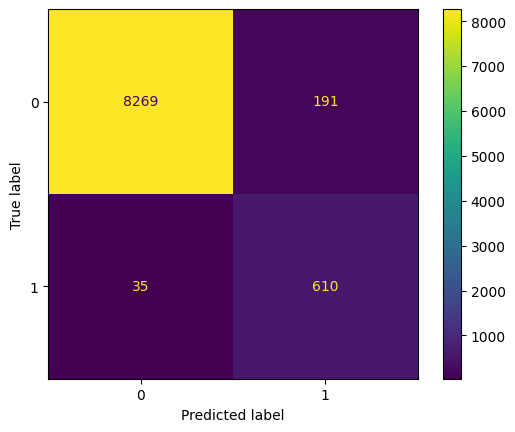

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      8460
           1       0.76      0.95      0.84       645

    accuracy                           0.98      9105
   macro avg       0.88      0.96      0.92      9105
weighted avg       0.98      0.98      0.98      9105



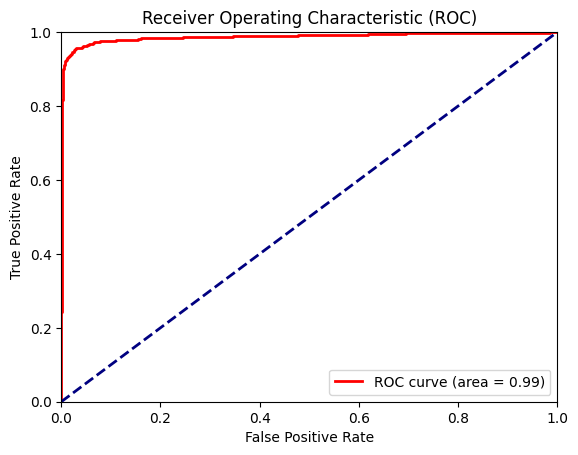

custom f1 score = 0.8506260296540362


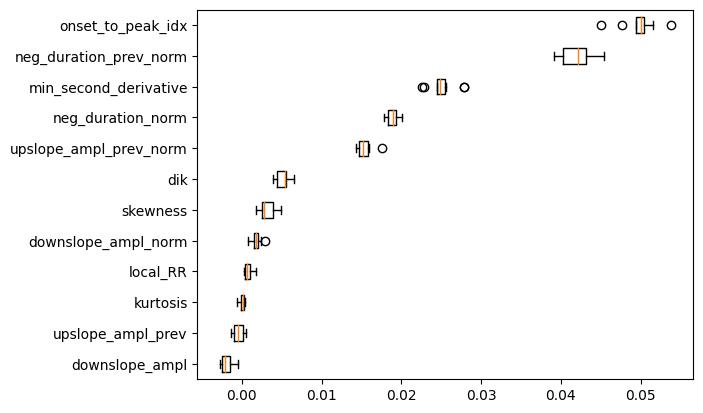

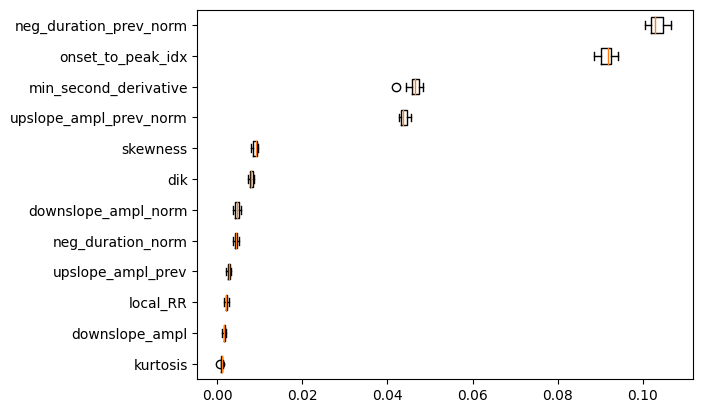

['SVM_binary.pkl']

In [ ]:
# Binary SVM

del clf

clf = clf_svm

report_svm = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_svm = print_custom_metric(report_svm, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)

# Save the model to disk
#joblib.dump(clf, 'SVM_binary.pkl')

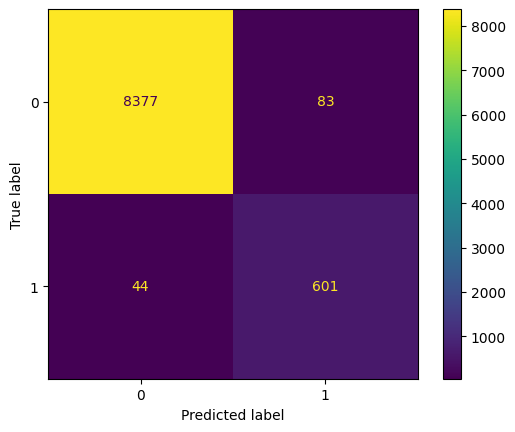

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.88      0.93      0.90       645

    accuracy                           0.99      9105
   macro avg       0.94      0.96      0.95      9105
weighted avg       0.99      0.99      0.99      9105



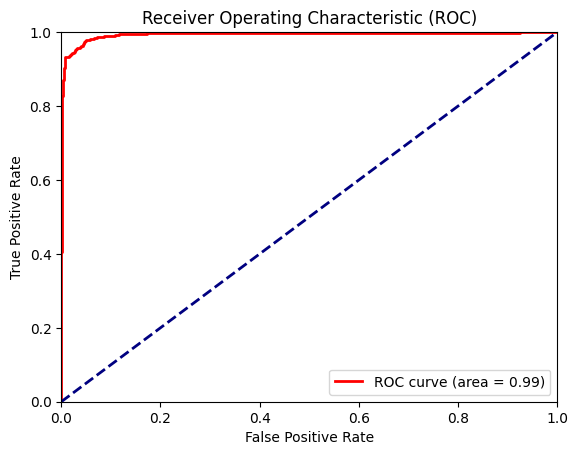

custom f1 score = 0.9063756177924217


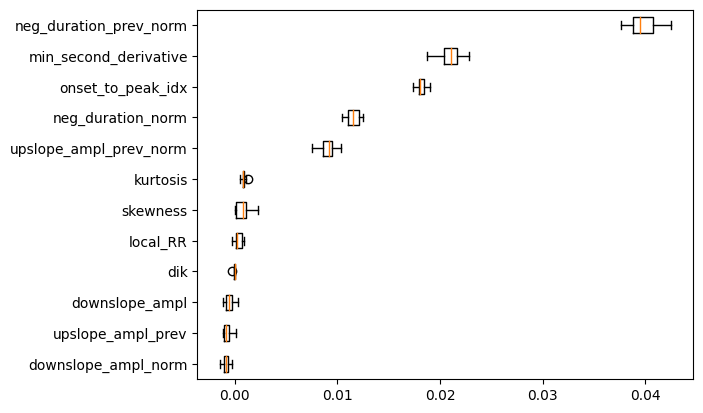

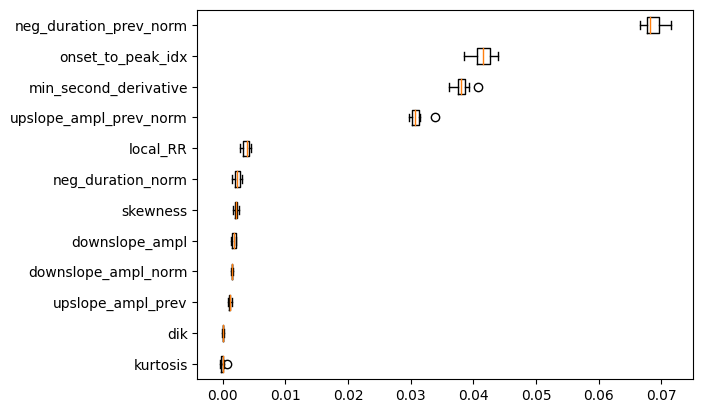

['LDA_binary.pkl']

In [ ]:
# Binary Linear Discriminant Analysis

del clf

clf = clf_lda

report_lda = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_lda = print_custom_metric(report_lda, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)


# Save the model to disk
#joblib.dump(clf, 'LDA_binary.pkl')

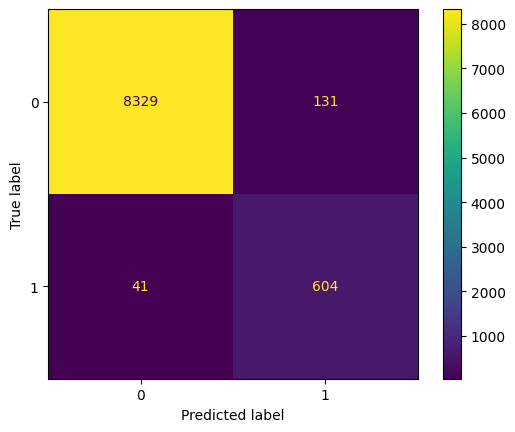

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      8460
           1       0.82      0.94      0.88       645

    accuracy                           0.98      9105
   macro avg       0.91      0.96      0.93      9105
weighted avg       0.98      0.98      0.98      9105



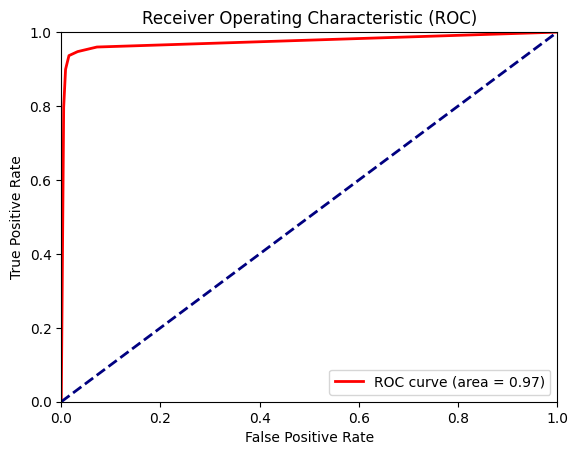

custom f1 score = 0.8877924217462932


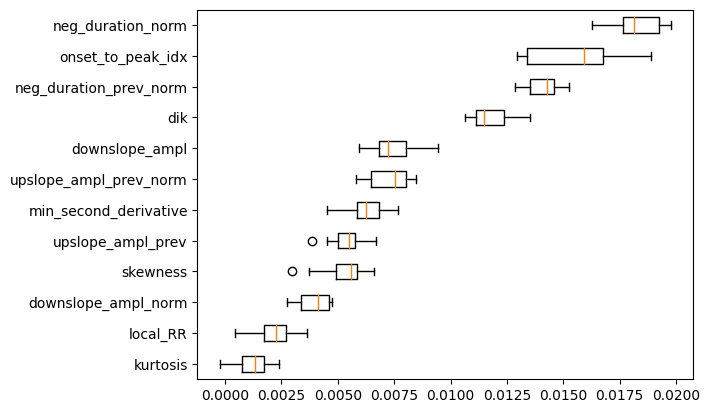

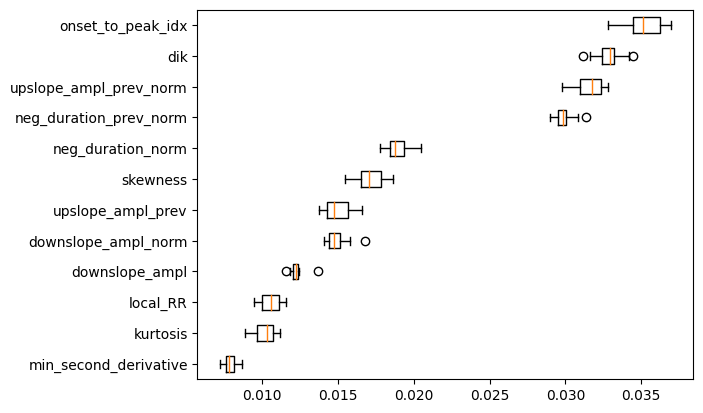

['KNN_binary.pkl']

In [ ]:
# Binary KNN

del clf

clf = clf_knn

report_knn = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_knn = print_custom_metric(report_knn, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)

# Save the model to disk
#joblib.dump(clf, 'KNN_binary.pkl')

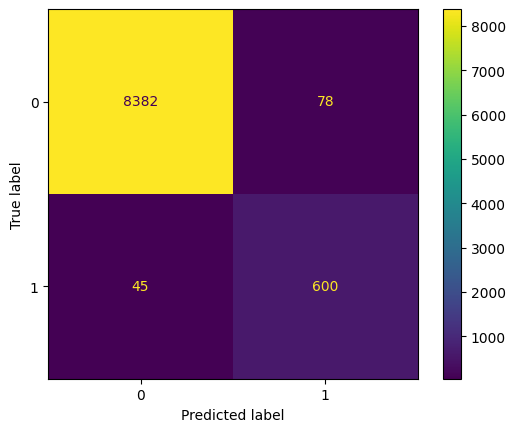

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.88      0.93      0.91       645

    accuracy                           0.99      9105
   macro avg       0.94      0.96      0.95      9105
weighted avg       0.99      0.99      0.99      9105



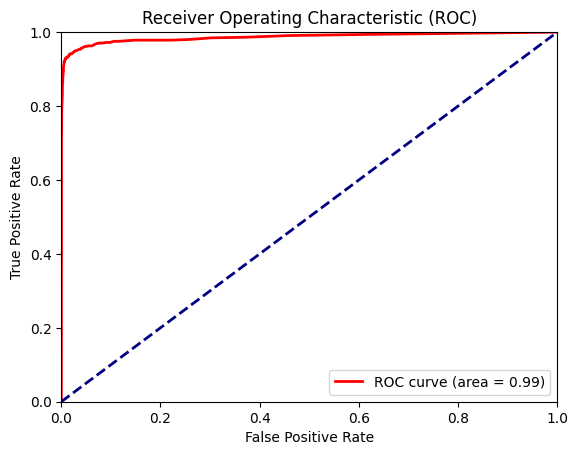

custom f1 score = 0.915667215815486


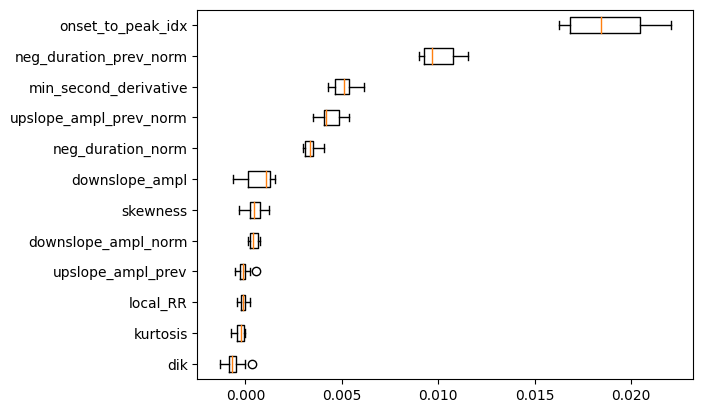

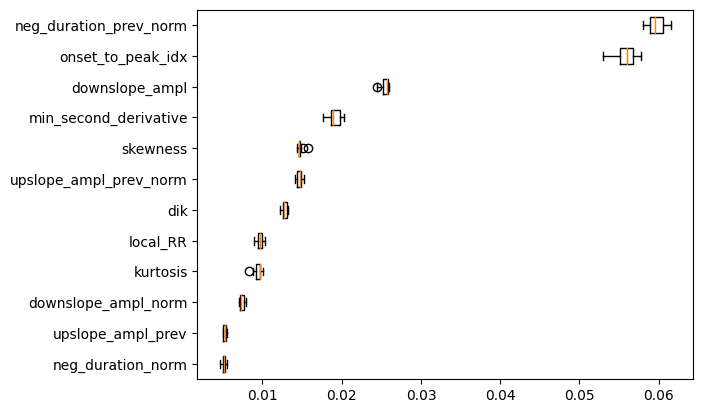

['RF_binary.pkl']

In [ ]:
# Binary Random Forest

del clf

clf = clf_rf

report_rf = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_rf = print_custom_metric(report_rf, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)


# Save the model to disk
#joblib.dump(clf, 'RF_binary.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


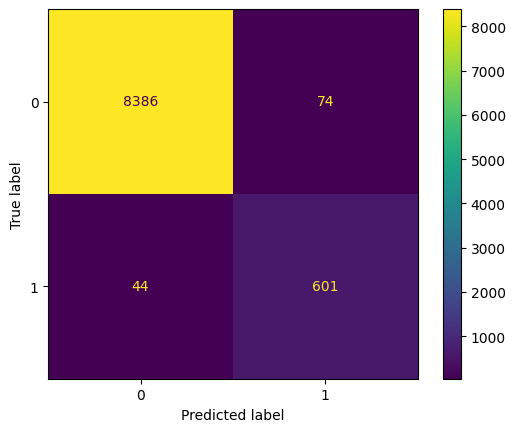

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.89      0.93      0.91       645

    accuracy                           0.99      9105
   macro avg       0.94      0.96      0.95      9105
weighted avg       0.99      0.99      0.99      9105



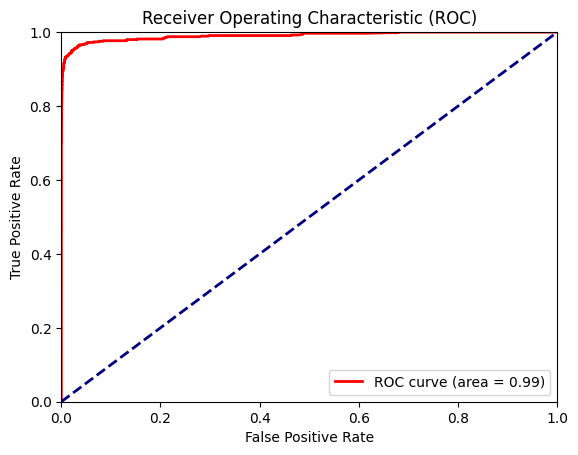

custom f1 score = 0.915667215815486


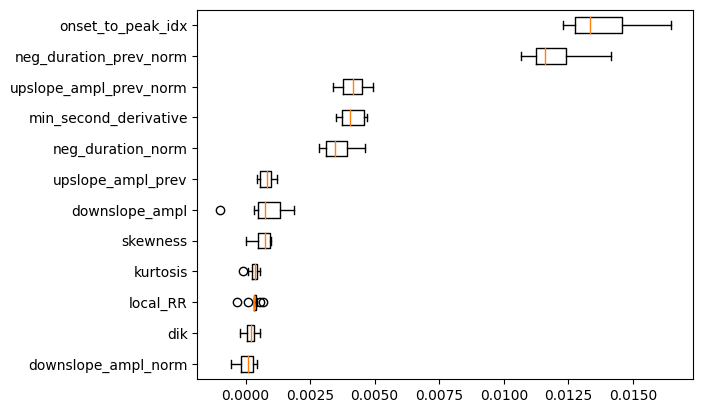

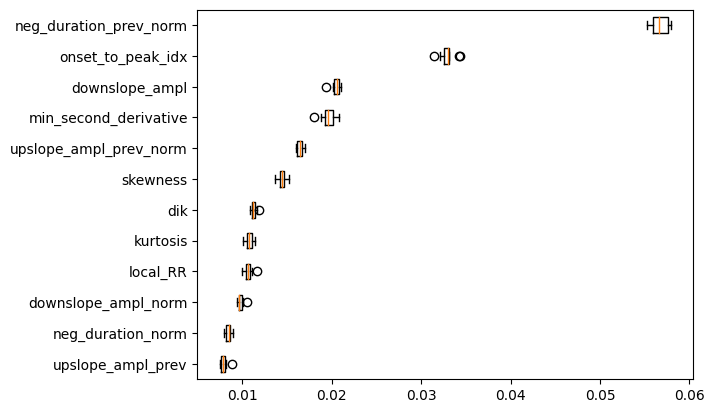

['ADA_binary.pkl']

In [ ]:
# Binary Ada Boost

del clf

clf = clf_ada

report_ada = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_ada = print_custom_metric(report_ada, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)


# Save the model to disk
#joblib.dump(clf, 'ADA_binary.pkl')

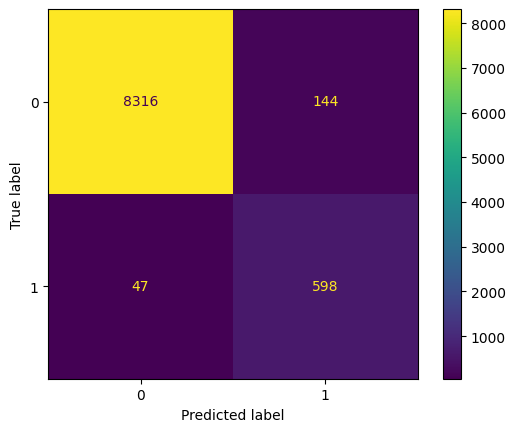

              precision    recall  f1-score   support

           0       0.99      0.98      0.99      8460
           1       0.81      0.93      0.86       645

    accuracy                           0.98      9105
   macro avg       0.90      0.96      0.93      9105
weighted avg       0.98      0.98      0.98      9105



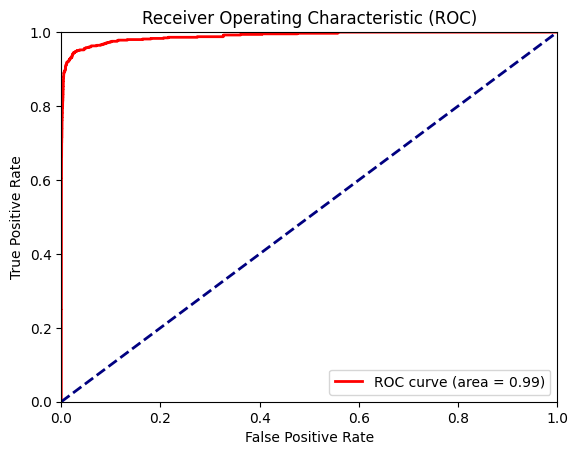

custom f1 score = 0.8692092257001647


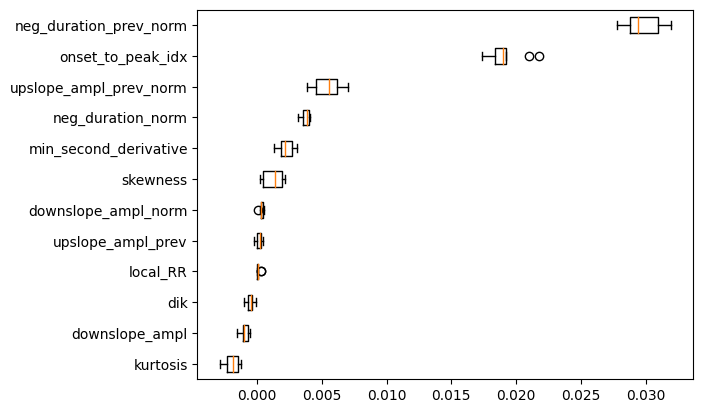

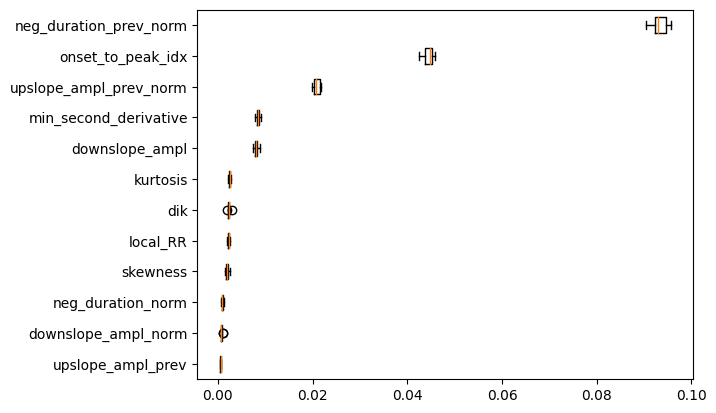

['GRAD_binary.pkl']

In [ ]:
# Binary Gradient Boost

del clf

clf = clf_grad

report_grad = testModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf, ['0', '1'])
metric_grad = print_custom_metric(report_grad, labels_test_binary)
explainModel(X_train_full, y_train_full_binary, test_features_selection, labels_test_binary, clf)


# Save the model to disk
#joblib.dump(clf, 'GRAD_binary.pkl')

In [ ]:
test_labels_features = np.array(test_labels_features, dtype=int)

In [ ]:
y_train_full_ternary = np.concatenate((y_features_train, validation_labels_features))

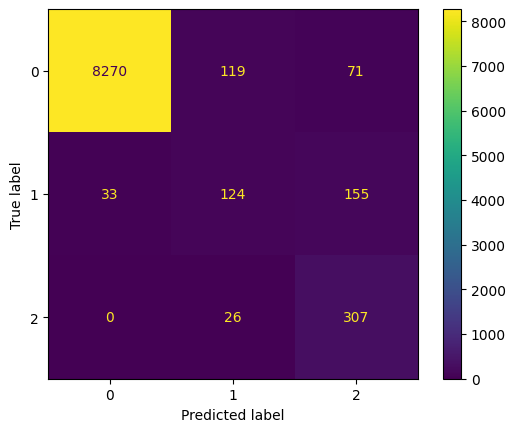

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      8460
           1       0.46      0.40      0.43       312
           2       0.58      0.92      0.71       333

    accuracy                           0.96      9105
   macro avg       0.68      0.77      0.71      9105
weighted avg       0.96      0.96      0.96      9105

custom f1 score = 0.4682708200890019


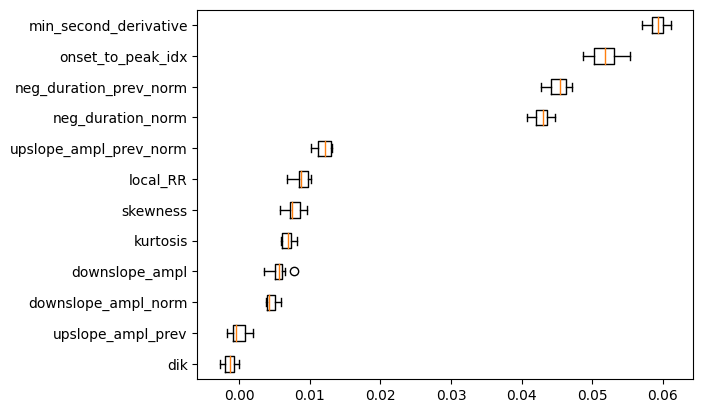

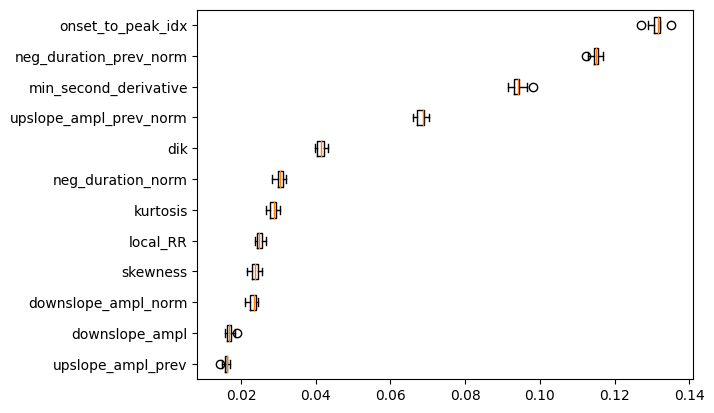

['SVM_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary SVM

clf = clf_svm

report_svm_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_svm_ternary = print_custom_metric(report_svm_ternary, test_labels_features)
explainModel(X_train_full,y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'SVM_ternary.pkl')

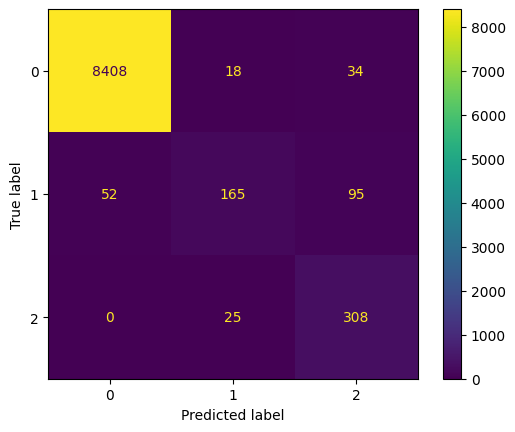

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.79      0.53      0.63       312
           2       0.70      0.92      0.80       333

    accuracy                           0.98      9105
   macro avg       0.83      0.82      0.81      9105
weighted avg       0.98      0.98      0.97      9105

custom f1 score = 0.6546026700572156


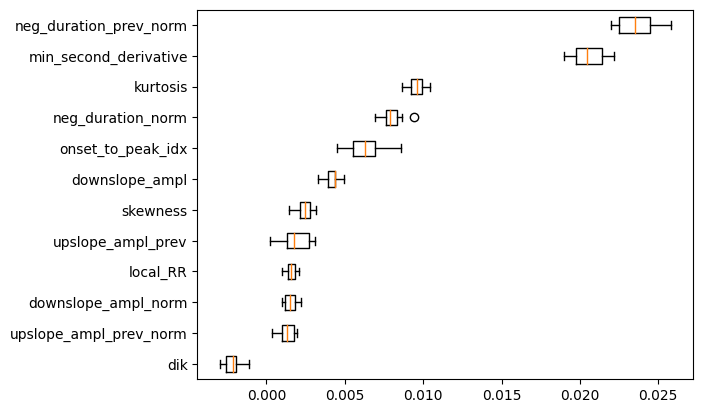

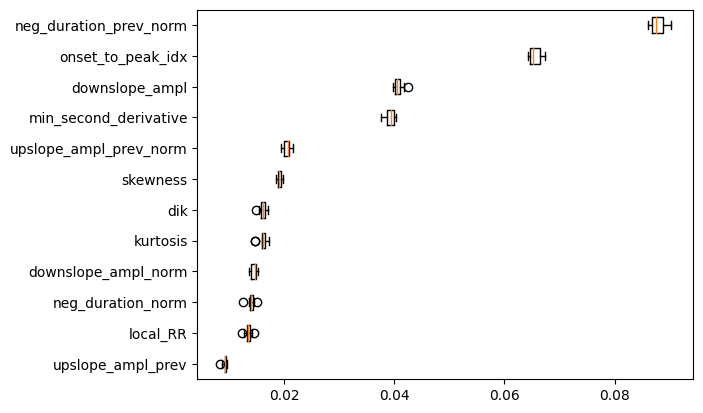

['RF_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary Random Forest

clf = clf_rf

report_rf_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_rf_ternary = print_custom_metric(report_rf_ternary, test_labels_features)
explainModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'RF_ternary.pkl')

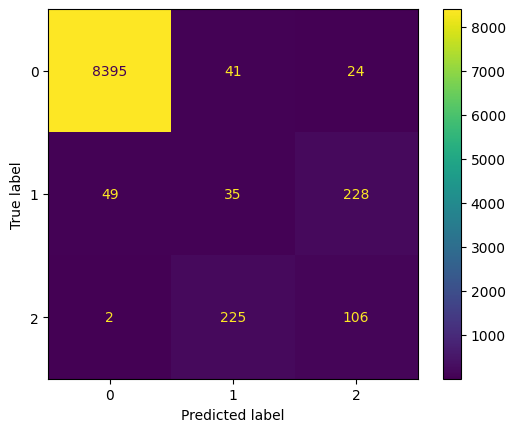

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.12      0.11      0.11       312
           2       0.30      0.32      0.31       333

    accuracy                           0.94      9105
   macro avg       0.47      0.47      0.47      9105
weighted avg       0.94      0.94      0.94      9105

custom f1 score = 0.17013986013986016


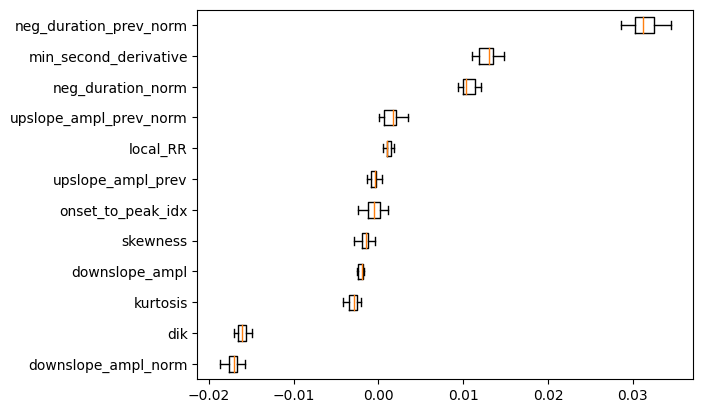

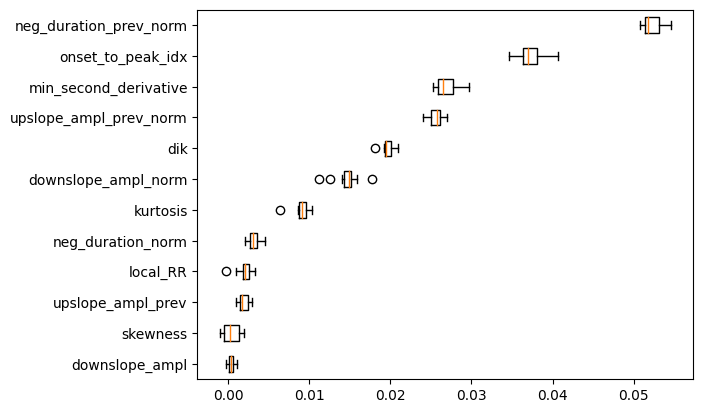

['LDA_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary LDA

clf = clf_lda

report_lda_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_lda_ternary = print_custom_metric(report_lda_ternary, test_labels_features)
explainModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'LDA_ternary.pkl')

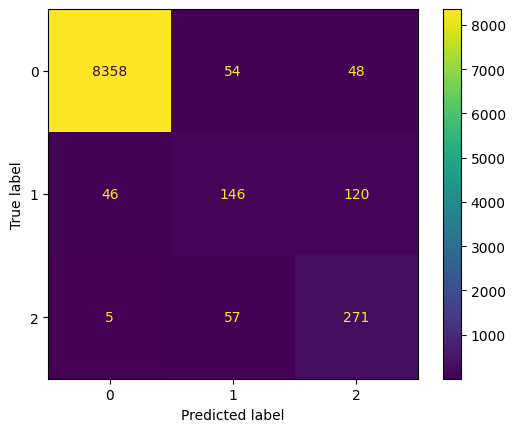

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.57      0.47      0.51       312
           2       0.62      0.81      0.70       333

    accuracy                           0.96      9105
   macro avg       0.73      0.76      0.74      9105
weighted avg       0.97      0.96      0.96      9105

custom f1 score = 0.5428035600762874


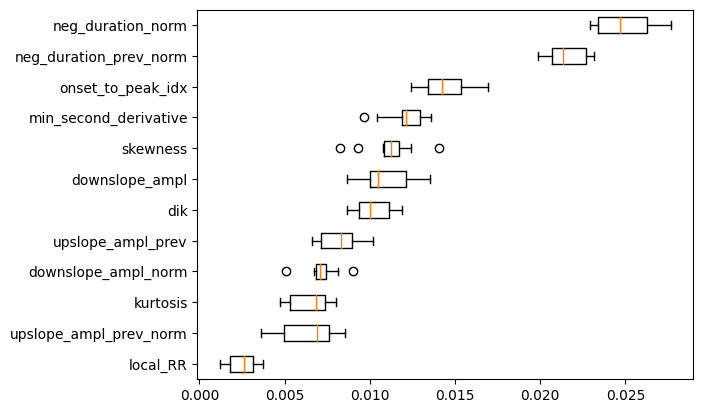

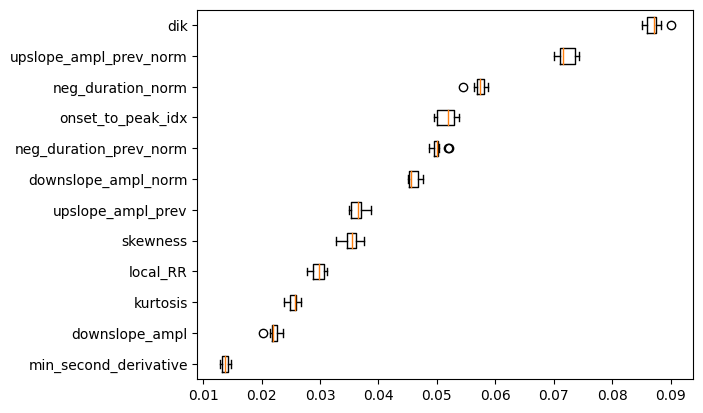

['KNN_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary KNN

clf = clf_knn

report_knn_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_knn_ternary = print_custom_metric(report_knn_ternary, test_labels_features)
explainModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'KNN_ternary.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


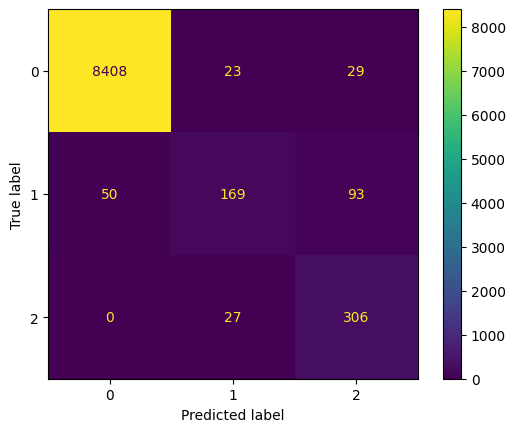

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.77      0.54      0.64       312
           2       0.71      0.92      0.80       333

    accuracy                           0.98      9105
   macro avg       0.83      0.82      0.81      9105
weighted avg       0.98      0.98      0.97      9105

custom f1 score = 0.6639192625556263


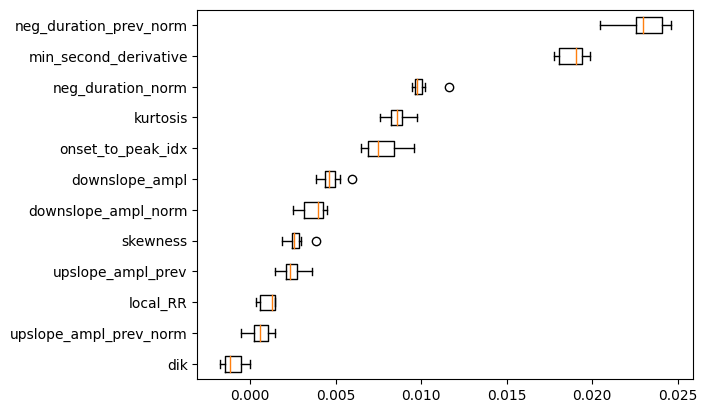

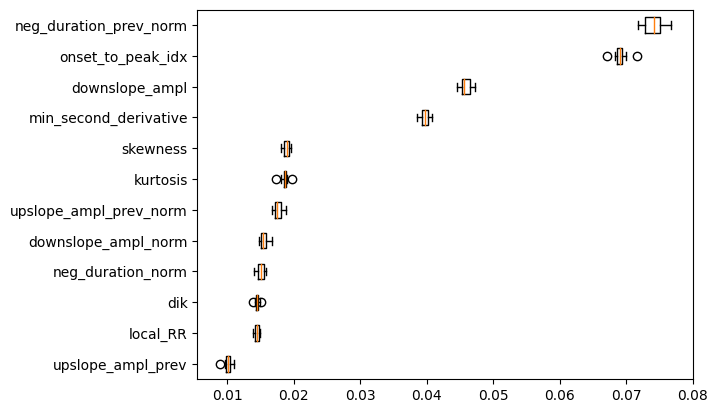

['ADA_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary Ada Boost

clf = clf_ada

report_ada_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_ada_ternary = print_custom_metric(report_ada_ternary, test_labels_features)
explainModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'ADA_ternary.pkl')

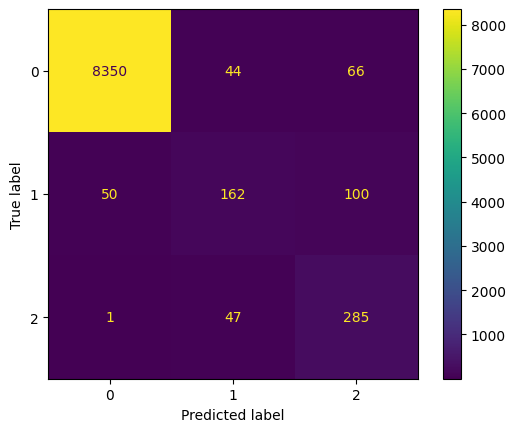

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8460
           1       0.64      0.52      0.57       312
           2       0.63      0.86      0.73       333

    accuracy                           0.97      9105
   macro avg       0.76      0.79      0.76      9105
weighted avg       0.97      0.97      0.97      9105

custom f1 score = 0.5987031150667514


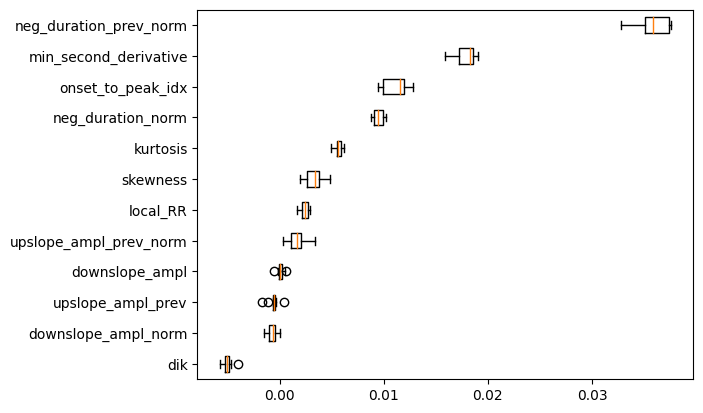

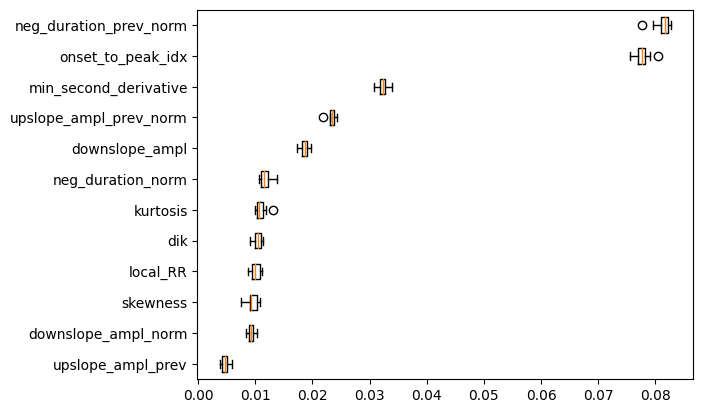

['GRAD_ternary.pkl']

In [ ]:
# test the ternary models

del clf

# Ternary Gradient Boost

clf = clf_grad

report_grad_ternary = testModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf, ['0', '1', '2'])
metric_grad_ternary = print_custom_metric(report_grad_ternary, test_labels_features)
explainModel(X_train_full, y_train_full_ternary, test_features_selection, test_labels_features, clf)

# Save the model to disk
#joblib.dump(clf, 'GRAD_ternary.pkl')

In [ ]:
# load the models
svm_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/SVM_binary.pkl')
lda_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/LDA_binary.pkl')
knn_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/KNN_binary.pkl')
rf_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/RF_binary.pkl')
ada_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/ADA_binary.pkl')
grad_model_binary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/GRAD_binary.pkl')

svm_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/SVM_ternary.pkl')
lda_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/LDA_ternary.pkl')
knn_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/KNN_ternary.pkl')
rf_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/RF_ternary.pkl')
ada_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/ADA_ternary.pkl')
grad_model_ternary = joblib.load('/content/drive/MyDrive/Project - Applied AI in biomedicine/GRAD_ternary.pkl')





In [ ]:
# print the confidence of each binary model and the ROC curves

def printConfidenceBinary(clf, test_features, test_labels):

  test_labels_bool_0 = test_labels==0
  test_labels_bool_1 = test_labels==1

  test_features_0 = test_features[test_labels_bool_0]
  test_features_1 = test_features[test_labels_bool_1]

  # Obtain predicted probabilities
  labels_pred_prob_0 = clf.predict_proba(test_features_0)[:, 0]
  print(np.mean(labels_pred_prob_0))
  labels_pred_prob_1 = clf.predict_proba(test_features_1)[:, 1]
  print(np.mean(labels_pred_prob_1))


  labels_pred_prob = clf.predict_proba(test_features)[:, 1]

  # Calculate ROC curve
  fpr, tpr, thresholds = roc_curve(test_labels, labels_pred_prob)

  # Calculate AUC (Area Under the Curve)
  roc_auc = auc(fpr, tpr)

  return labels_pred_prob_0, labels_pred_prob_1, fpr, tpr, roc_auc


In [ ]:
# print the confidence of each ternary model and the ROC curves

def printConfidenceTernary(clf, test_features, test_labels):

  test_labels_bool_0 = test_labels==0
  test_labels_bool_1 = test_labels==1
  test_labels_bool_2 = test_labels==2

  test_features_0 = test_features[test_labels_bool_0]
  test_features_1 = test_features[test_labels_bool_1]
  test_features_2 = test_features[test_labels_bool_2]

  # Obtain predicted probabilities
  labels_pred_prob_0 = clf.predict_proba(test_features_0)[:, 0]
  print(np.mean(labels_pred_prob_0))
  labels_pred_prob_1 = clf.predict_proba(test_features_1)[:, 1]
  print(np.mean(labels_pred_prob_1))
  labels_pred_prob_2 = clf.predict_proba(test_features_2)[:, 2]
  print(np.mean(labels_pred_prob_2))

In [ ]:
# print the mean confidence for each model, for each class
svm_binary_prob_0, svm_binary_prob_1, svm_binary_fpr, svm_binary_tpr, svm_binary_roc_auc = printConfidenceBinary(svm_model_binary, test_features_selection, labels_test_binary)
lda_binary_prob_0, lda_binary_prob_1, lda_binary_fpr, lda_binary_tpr, lda_binary_roc_auc = printConfidenceBinary(lda_model_binary,  test_features_selection, labels_test_binary)
knn_binary_prob_0, knn_binary_prob_1, knn_binary_fpr, knn_binary_tpr, knn_binary_roc_auc = printConfidenceBinary(knn_model_binary,  test_features_selection, labels_test_binary)
rf_binary_prob_0, rf_binary_prob_1, rf_binary_fpr, rf_binary_tpr, rf_binary_roc_auc = printConfidenceBinary(rf_model_binary,  test_features_selection, labels_test_binary)
ada_binary_prob_0, ada_binary_prob_1, ada_binary_fpr, ada_binary_tpr, ada_binary_roc_auc = printConfidenceBinary(ada_model_binary,  test_features_selection, labels_test_binary)
grad_binary_prob_0, grad_binary_prob_1, grad_binary_fpr, grad_binary_tpr, grad_binary_roc_auc = printConfidenceBinary(grad_model_binary,  test_features_selection, labels_test_binary)

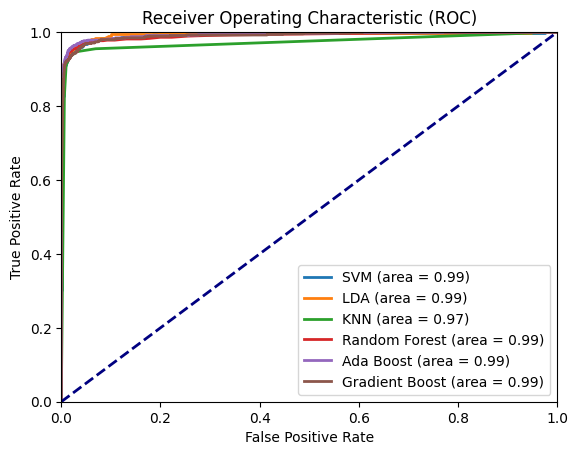

In [ ]:
# Plot ROC curves
plt.figure()

# Loop through your models and plot their ROC curves
plt.plot(svm_binary_fpr, svm_binary_tpr, lw=2, label='SVM (area = %0.2f)' % svm_binary_roc_auc)
plt.plot(lda_binary_fpr, lda_binary_tpr, lw=2, label='LDA (area = %0.2f)' % lda_binary_roc_auc)
plt.plot(knn_binary_fpr, knn_binary_tpr, lw=2, label='KNN (area = %0.2f)' % knn_binary_roc_auc)
plt.plot(rf_binary_fpr, rf_binary_tpr, lw=2, label='Random Forest (area = %0.2f)' % rf_binary_roc_auc)
plt.plot(ada_binary_fpr, ada_binary_tpr, lw=2, label='Ada Boost (area = %0.2f)' % ada_binary_roc_auc)
plt.plot(grad_binary_fpr, grad_binary_tpr, lw=2, label='Gradient Boost (area = %0.2f)' % grad_binary_roc_auc)

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# print the mean confidence for each model, for each class
printConfidenceTernary(svm_model_ternary, test_features_selection, test_labels_features)
printConfidenceTernary(lda_model_ternary, test_features_selection, test_labels_features)
printConfidenceTernary(knn_model_ternary, test_features_selection, test_labels_features)
printConfidenceTernary(rf_model_ternary, test_features_selection, test_labels_features)
printConfidenceTernary(ada_model_ternary, test_features_selection, test_labels_features)
printConfidenceTernary(grad_model_ternary, test_features_selection, test_labels_features)

## 13.2 Deep learning

### 13.2.1 Data preparation for model and metadata

In [ ]:
# check data
print(len(y_features_train_res_str) == len(X_features_train_res))
print(len(y_labels_test) == len(test_features_selection))
print(len(y_labels_val) == len(validation_features_selection))

In [ ]:
y_val_int = []
for i in range(len(y_val)):
  y_val_int.append(int(y_val[i]))
y_val_int = np.array(y_val_int)

y_test_int = []
for i in range(len(y_test)):
  y_test_int.append(int(y_test[i]))
y_test_int = np.array(y_test_int)

y_val = y_val_int
y_test = y_test_int

In [ ]:
# Convert labels to one hot

y_train_one_hot = to_categorical(y_train, num_classes=3)
y_test_one_hot = to_categorical(y_test, num_classes=3)
y_val_one_hot = to_categorical(y_val, num_classes=3)

In [ ]:
# add the feature dimension to labels

y_train_reshaped = np.expand_dims(y_train_one_hot, axis = -1)
y_test_reshaped = np.expand_dims(y_test_one_hot, axis = -1)
y_val_reshaped = np.expand_dims(y_val_one_hot, axis = -1)

print(y_test_reshaped.shape, y_train_reshaped.shape, y_val_reshaped.shape)

(6429, 3, 1) (51286, 3, 1) (5791, 3, 1)


### 13.2.2 Auxiliary functions

In [ ]:
class_weights = dict(zip(np.unique(y_train), compute_class_weight(class_weight='balanced', classes=np.unique(y_train),y=y_train)))
class_weights

In [ ]:
# Computation of the weights to be used for computing the new metric
# Computation of the weights to be used for computing the new metric
def compute_proportions(y):

  weights = []

  if len(np.unique(y)) == 3:
    proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test)), len(np.array(np.where(y_test==2))[0])/(len(y_test))]
    weights = [(1-proportions[0]), (1-proportions[1]), (1-proportions[2])]
  elif len(np.unique(y)) == 2:
    proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test))]
    weights = [(1-proportions[0]), (1-proportions[1])]

  weights = np.array(weights)
  proportion_weights = weights/sum(weights)

  return proportion_weights

In [ ]:
# The weights are used for the callbacks, thus we need the ones from the train and on the validation sets
proportion_weights = compute_proportions(y_val)

In [ ]:
weights_train = np.zeros(len(class_weights.keys()))

weights_train[0] = class_weights[0]
weights_train[1] = class_weights[1]
weights_train[2] = class_weights[2]

np.array(weights_train)

weights_train = weights_train/sum(weights_train)
weights_train

In [ ]:
# Set the number of classes
classes = 3

In [ ]:
# The following function are three callbacks designed for the computation of the new metric and
# for its monitoring during the training of Deep Learning Models.
# These functions work either with binary or ternary classification, it's only necessary to specify the number of classes before calling them


# Step 1: Define custom F1 score metric function for specific class
def f1_metric_class(y_true, y_pred, class_label):
    y_true = tf.keras.backend.eval(y_true)
    y_pred = np.argmax(tf.keras.backend.eval(y_pred), axis=1)
    return f1_score(y_true == class_label, y_pred == class_label)

validation_metric = []
training_metric = []

# Step 2: Define custom callback for F1 score of each class
class F1ScoreClassCallback(Callback):
    def __init__(self, validation_data=(), train_data=(), num_classes=classes, weights=proportion_weights, weights_tr = weights_train):
        super(Callback, self).__init__()
        self.validation_data = validation_data
        self.train_data = train_data
        self.num_classes = num_classes
        self.weights = weights
        self.weights_tr = weights_tr
        self.train_dot_product = []
        self.val_dot_product = []

    def on_epoch_end(self, epoch, logs={}):
        if self.validation_data:
            # Evaluate F1 scores on validation data
            val_predict = np.argmax(self.model.predict(self.validation_data[0]), axis=1)
            val_true = self.validation_data[1]
            val_f1_scores = [f1_score(val_true == class_label, val_predict == class_label) for class_label in range(self.num_classes)]
            val_dot_product = np.dot(val_f1_scores, self.weights)
            #print(f'val_custom_f1_score {val_dot_product}')
            self.val_dot_product.append(val_dot_product)
            logs['val_custom_f1_score'] = val_dot_product
            global validation_metric
            validation_metric.append(val_dot_product)

        if self.train_data:
            # Evaluate F1 scores on training data
            train_predict = np.argmax(self.model.predict(self.train_data[0]), axis=1)
            train_true = self.train_data[1]
            train_f1_scores = [f1_score(train_true == class_label, train_predict == class_label) for class_label in range(self.num_classes)]
            train_dot_product = np.dot(train_f1_scores, self.weights_tr)
            #print(f'train_custom_f1_score {val_dot_product}')
            self.train_dot_product.append(train_dot_product)
            logs['train_custom_f1_score'] = train_dot_product
            global training_metric
            training_metric.append(train_dot_product)

class CustomEarlyStopping(Callback):
    def __init__(self, monitor_vector, min_delta=0, patience=0, verbose=0):
        super(CustomEarlyStopping, self).__init__()
        self.monitor_vector = monitor_vector
        self.min_delta = min_delta
        self.patience = patience
        self.verbose = verbose
        self.wait = 0
        self.stopped_epoch = 0
        self.best = float('inf')
        self.best_weights = None  # Variable to store the best weights
        self.monitor_op = lambda a, b: a < b

    def on_epoch_end(self, epoch, logs=None):
        if logs is None:
            logs = {}

        current = self.monitor_vector[-1] if self.monitor_vector else None

        if current is None:
            print("CustomEarlyStopping: Validation metric vector is empty. Cannot perform early stopping.")
            return

        current = 1 - current # Adjusting for maximum instead of minimum

        if self.monitor_op(current, self.best - self.min_delta):
            self.best = current
            self.wait = 0
            self.best_weights = self.model.get_weights()  # Save the current best weights
        else:
            self.wait += 1
            if self.wait >= self.patience:
                self.stopped_epoch = epoch
                self.model.stop_training = True

    def on_train_end(self, logs=None):
        if self.stopped_epoch > 0 and self.verbose > 0:
            print("Epoch %05d: early stopping" % (self.stopped_epoch + 1))
            if self.best_weights is not None:
                self.model.set_weights(self.best_weights)  # Restore the best weights at the end of training


class CustomReduceLROnPlateau(Callback):
    def __init__(self, monitor_vector, factor=0.1, patience=10, verbose=0, min_delta=0, cooldown=0, min_lr=0):
        super(CustomReduceLROnPlateau, self).__init__()
        self.monitor_vector = monitor_vector
        self.factor = tf.constant(factor, dtype=tf.float32)
        self.patience = patience
        self.verbose = verbose
        self.min_delta = tf.constant(min_delta, dtype=tf.float32)
        self.cooldown = cooldown
        self.min_lr = tf.constant(min_lr, dtype=tf.float32)
        self.wait = tf.constant(0, dtype=tf.int32)
        self.best = tf.constant(float('inf'), dtype=tf.float32)
        self.monitor_op = lambda a, b: a < b
        self.reduce_lr = tf.constant(True, dtype=tf.bool)

    def on_epoch_end(self, epoch, logs=None):
        if logs is None:
            logs = {}

        current = self.monitor_vector[-1] if self.monitor_vector else None

        if current is None:
            print("CustomReduceLROnPlateau: Validation metric vector is empty. Cannot perform learning rate reduction.")
            return

        current = 1 - current  # Invert the values

        if self.monitor_op(current, self.best - self.min_delta):
            self.best = current
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                #if self.verbose > 0:
                    #print("Epoch %05d: ReduceLROnPlateau reducing learning rate" % (epoch + 1))
                old_lr = tf.keras.backend.get_value(self.model.optimizer.lr)
                if old_lr > self.min_lr:
                    new_lr = tf.math.maximum(old_lr * self.factor, self.min_lr)
                    if old_lr - new_lr > self.min_delta:
                        tf.keras.backend.set_value(self.model.optimizer.lr, new_lr)
                        self.wait = tf.constant(0, dtype=tf.int32)
                        self.reduce_lr = tf.constant(True, dtype=tf.bool)
                        #print(tf.keras.backend.get_value(self.model.optimizer.lr))
                        #if self.verbose > 0:
                            #print("Epoch %05d: Learning rate reduced to %s." % (epoch + 1, new_lr))
                    #else:
                        #if self.verbose > 0:
                            #print("Epoch %05d: Learning rate was not reduced because the change is less than min_delta." % (epoch + 1))
                #else:
                    #if self.verbose > 0:
                        #print("Epoch %05d: Learning rate was not reduced because it already reached the minimum value." % (epoch + 1))
        print('lr:', tf.keras.backend.get_value(self.model.optimizer.lr))

# Usage example remains the same



In [ ]:
input_shape = (None,1)
input_shape_features = train_features_zscore.shape[-1]
output_shape = y_train_reshaped.shape[1:]
batch_size = 256

print(input_shape)
print(input_shape_features)

In [ ]:
def plot_custom_metric(history):
  plt.figure(figsize=(15,5))
  plt.plot(np.arange(len(history['train_custom_f1_score'])), history['train_custom_f1_score'], label='Train')
  plt.plot(np.arange(len(history['train_custom_f1_score'])), history['val_custom_f1_score'], label='Validation')
  plt.xlabel('Epoch')
  plt.ylabel('Weighted F1 Dot Product')
  plt.title('Training and Validation Weighted F1 Dot Product')
  plt.xticks(np.arange(len(history['train_custom_f1_score'])))
  plt.legend()
  plt.grid(True)
  plt.show()

In [ ]:
def predict_and_report(model, X_test, y_test):
  y_pred_one_hot = model.predict(X_test) # one_hot_predictions

  # Print the shape of the predictions
  print(f"Predictions shape: {y_pred_one_hot.shape}")
  y_pred = np.argmax(y_pred_one_hot,axis=-1)
  print(y_pred.shape)
  print(y_test.shape)
  print(type(y_pred))
  print(type(y_test))

  class_report = classification_report(y_test, y_pred)

  cm = confusion_matrix(y_test, y_pred, labels=[0, 1, 2])

  # Normalize confusion matrix to show percentages
  cm_normalized = cm / cm.astype(np.float).sum(axis=1, keepdims=True)

  # Plot confusion matrix with seaborn heatmap
  plt.figure(figsize=(10, 8))
  sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap="Blues", cbar=True,
              xticklabels=['0', '1', '2'], yticklabels=['0', '1', '2'])
  plt.xlabel('Predicted label')
  plt.ylabel('True label')
  plt.title('Confusion Matrix (Percentage)')
  plt.show()

  # Print classification report
  print(class_report)

  word_array = class_report.split()
  word_array
  f1score = [word_array[7], word_array[12], word_array[17]]

  f1score_num = []
  for i in range(len(f1score)):
    f1score_num.append(float(f1score[i]))

  f1score_num

  proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test)), len(np.array(np.where(y_test==2))[0])/(len(y_test))]

  weights = [(1-proportions[0]), (1-proportions[1]), (1-proportions[2])]
  weights = np.array(weights)
  weights = weights/sum(weights)
  weights

  metric = np.dot(f1score_num, weights)

  return metric

In [ ]:
def predict_and_report_Wide(model, X_test, X_features_test, y_test):
  y_pred_one_hot = model.predict([X_test, X_features_test]) # one_hot_predictions

  # Print the shape of the predictions
  print(f"Predictions shape: {y_pred_one_hot.shape}")
  y_pred = np.argmax(y_pred_one_hot,axis=-1)

  class_report = classification_report(y_test, y_pred)

  cm = confusion_matrix(y_test, y_pred, labels=[0, 1, 2])

  # Normalize confusion matrix to show percentages
  cm_normalized = cm / cm.astype(np.float).sum(axis=1, keepdims=True)

  # Plot confusion matrix with seaborn heatmap
  plt.figure(figsize=(10, 8))
  sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap="Blues", cbar=True,
              xticklabels=['0', '1', '2'], yticklabels=['0', '1', '2'])
  plt.xlabel('Predicted label')
  plt.ylabel('True label')
  plt.title('Confusion Matrix (Percentage)')
  plt.show()

  # Print classification report
  print(class_report)


  word_array = class_report.split()
  word_array
  f1score = [word_array[7], word_array[12], word_array[17]]

  f1score_num = []
  for i in range(len(f1score)):
    f1score_num.append(float(f1score[i]))

  f1score_num

  proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test)), len(np.array(np.where(y_test==2))[0])/(len(y_test))]

  weights = [(1-proportions[0]), (1-proportions[1]), (1-proportions[2])]
  weights = np.array(weights)
  weights = weights/sum(weights)
  weights

  metric = np.dot(f1score_num, weights)

  return metric

In [ ]:
def plot_loss_and_metric(history_model):

  value1 = history_model['val_custom_f1_score']
  value2 = training_metric
  val_loss = history_model['val_loss']
  train_loss = history_model['loss']

  best_epoch = np.where(value1 == np.max(value1))
  best_epoch_loss = np.where(val_loss == np.min(val_loss))


  fig, ax1 = plt.subplots(figsize=(15, 6))

  ax1.set_xlabel('Number of Epochs')
  ax1.set_ylabel('Custom Metric')
  ax1.tick_params(axis='y')
  ax1.plot(value2, color='red', linestyle='--', label='Train_Custom_F1_score')
  ax1.plot(value1, color='red', label='Validation_Custom_F1_score')
  ax1.axvline(x=best_epoch[0][0], color='g', linestyle='--', label='F1_Best epoch')
  ax1.legend(loc='center')

  ax2 = ax1.twinx()
  ax2.set_ylabel('Loss')
  ax2.tick_params(axis='y')
  ax2.plot(val_loss, color='b', label='Val_Loss')
  ax2.plot(train_loss, color='b', linestyle='--', label='Train_Loss')
  ax2.axvline(x=best_epoch_loss, color='darkgrey', linestyle='--', label='Loss_Best epoch')
  ax2.legend(loc='center right')

  plt.title('Custom Metrics and Loss Over Epochs')
  plt.xlabel('Number of Epochs')

  plt.grid(True)
  plt.show()

In [ ]:
# Train the model
def fit_model(model, X_train, y_train, batch_size, epochs, X_val, y_val, callbacks_list):
  validation_metric = []
  training_metric = []
  learning_rate = 1e-4
  history = model.fit(
      x = X_train,
      y = y_train,
      batch_size = batch_size,
      epochs = epochs,
      validation_data=[X_val, y_val],
      callbacks = callbacks_list,
      class_weight = class_weights
  ).history
  return history

In [ ]:
def fit_model_Wide(model, train, train_feat, y_train, batch_size, epochs, val, val_feat, y_val, callbacks_list):
  validation_metric = []
  training_metric = []
  history = model.fit(
      x = [train, train_feat],
      y = y_train,
      batch_size = batch_size,
      epochs = 100,
      validation_data=[[val, val_feat], y_val],
      callbacks = callbacks_list,
      class_weight = class_weights
  ).history
  return history

### 13.2.3 Train model and predict

#### 12.2.3.1 VGG

In [ ]:
del(vgg)

In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

In [ ]:
vgg = Sequential()

vgg.add(Conv1D(input_shape=input_shape,filters=64,kernel_size=3,padding="same", activation="relu"))
vgg.add(Conv1D(filters=64,kernel_size=3,padding="same", activation="relu"))
vgg.add(MaxPooling1D(pool_size=2,strides=2))
vgg.add(Conv1D(filters=128, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=128, kernel_size=3, padding="same", activation="relu"))
vgg.add(MaxPooling1D(pool_size=2,strides=2))
vgg.add(Conv1D(filters=256, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=256, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=256, kernel_size=3, padding="same", activation="relu"))
vgg.add(MaxPooling1D(pool_size=2,strides=2))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(MaxPooling1D(pool_size=2,strides=2))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(Conv1D(filters=512, kernel_size=3, padding="same", activation="relu"))
vgg.add(MaxPooling1D(pool_size=2,strides=2))
vgg.add(GlobalMaxPooling1D())
vgg.add (Dense(512, activation='relu'))
vgg.add (Dropout(0.3))
vgg.add (Dense(3,activation='softmax'))

vgg.compile(
    optimizer = optimizer,
    loss = loss
    # set IDs for precision and recall
   # metrics = metrics
)

vgg.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, None, 64)          256       
                                                                 
 conv1d_1 (Conv1D)           (None, None, 64)          12352     
                                                                 
 max_pooling1d (MaxPooling1  (None, None, 64)          0         
 D)                                                              
                                                                 
 conv1d_2 (Conv1D)           (None, None, 128)         24704     
                                                                 
 conv1d_3 (Conv1D)           (None, None, 128)         49280     
                                                                 
 max_pooling1d_1 (MaxPoolin  (None, None, 128)         0         
 g1D)                                                   

In [ ]:
# Train the model
def fit_model(model, X_train, y_train, batch_size, epochs, X_val, y_val, callbacks_list):
  validation_metric = []
  training_metric = []
  learning_rate = 1e-4
  history = model.fit(
      x = X_train,
      y = y_train,
      batch_size = batch_size,
      epochs = epochs,
      validation_data=[X_val, y_val],
      callbacks = callbacks_list,
      class_weight = class_weights
  ).history
  return history

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=(X_val_segments, y_val), train_data=(X_train, y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=15, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=10, verbose=1)
      ]

In [ ]:
history_vgg = fit_model(vgg, X_train, y_train_one_hot, batch_size, epochs, X_val_segments, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_vgg)

In [ ]:
metric_vgg = predict_and_report(vgg, X_test_segments, y_test)

In [ ]:
metric_vgg

#### 13.2.3.2 LSTM

In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=(X_val_segments, y_val), train_data=(X_train, y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=15, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=10, verbose=1)
      ]

In [ ]:
del(LSTM_model)

In [ ]:
import tensorflow as tf
from tensorflow import keras

def build_LSTM_classifier(input_shape, classes):
    input_layer = keras.layers.Input(shape=(66,1), name='Input')

    # Feature extractor
    lstm = keras.layers.LSTM(128, return_sequences=True)(input_layer)
    lstm = keras.layers.LSTM(128, return_sequences=True)(lstm)


    attention = keras.layers.MultiHeadAttention(num_heads=2, key_dim=16)(lstm, lstm)

    # Convolutional Layers
    conv1 = keras.layers.Conv1D(32, kernel_size=3, activation='relu')(attention)
    conv2 = keras.layers.Conv1D(64, kernel_size=3, activation='relu')(conv1)

    # Classifier
    flatten = keras.layers.Flatten()(conv2)
    classifier = keras.layers.Dense(128, activation='relu')(flatten)
    output_layer = keras.layers.Dense(classes, activation='softmax')(classifier)

    # Connect input and output through the Model class
    model = keras.Model(inputs=input_layer, outputs=output_layer, name='LSTM_model')



    # Return the model
    return model


LSTM_model = build_LSTM_classifier(input_shape, 3)

In [ ]:
# Compile the model
LSTM_model.compile(loss=loss, optimizer=optimizer)

In [ ]:
LSTM_model.summary()

Model: "LSTM_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input (InputLayer)          [(None, 66, 1)]              0         []                            
                                                                                                  
 lstm (LSTM)                 (None, 66, 128)              66560     ['Input[0][0]']               
                                                                                                  
 lstm_1 (LSTM)               (None, 66, 128)              131584    ['lstm[0][0]']                
                                                                                                  
 multi_head_attention (Mult  (None, 66, 128)              16608     ['lstm_1[0][0]',              
 iHeadAttention)                                                     'lstm_1[0][0]']     

In [ ]:
history_LSTM = fit_model(LSTM_model, X_train, y_train_one_hot, batch_size, epochs, X_val_segments, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_LSTM)

In [ ]:
metric_LSTM = predict_and_report(LSTM_model, X_test_segments, y_TEST)
print(metric_LSTM)

#### 13.2.3.3 Resnet

In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=(X_val_segments, y_val), train_data=(X_train, y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=15, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=10, verbose=1)
      ]

In [ ]:
del(resnet)

In [ ]:
def ResBs_Identity(block_input, num_filters):
  # 1st conv layer
  conv1 = Conv1D(filters=num_filters, kernel_size=3, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)
  sum = Add()([block_input, norm1])
  relu1 = Activation('relu')(sum)

  return relu1

def ResBs_Conv(block_input, num_filters):

  block_shortcut = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  block_shortcut = BatchNormalization()(block_shortcut)

  conv1 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)

  dropout = Dropout(0.2)(norm1)

  conv2 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(dropout)
  norm2 = BatchNormalization()(conv2)


  sum = Add()([block_shortcut, norm2])
  relu2 = Activation('relu')(sum)

  return relu2

# ResNet model definition
def resnet(classes=classes):

  input = Input(shape=input_shape, name = 'signal') # we can't use Sequential because otherwise we can't use the skip connections

  ResNet = Conv1D(filters=64, kernel_size=3, padding='same')(input) # the dimension of the kernel is not preset, it depends on the input data
  ResNet = BatchNormalization()(ResNet)
  ResNet = Activation('relu')(ResNet)
  #ResNet = MaxPooling1D(pool_size=2, strides=2)(ResNet)

  ResNet = ResBs_Identity(ResNet, 64)
  ResNet = ResBs_Identity(ResNet, 64)
  dropout = Dropout(0.2)(ResNet)

  ResNet = ResBs_Conv(ResNet, 64)
  ResNet = ResBs_Identity(ResNet, 64)
  dropout = Dropout(0.2)(ResNet)


  ResNet = ResBs_Conv(ResNet, 128)
  ResNet = ResBs_Identity(ResNet, 128)
  dropout = Dropout(0.2)(ResNet)

  ResNet = ResBs_Conv(ResNet, 256)
  ResNet = ResBs_Identity(ResNet, 256)
  dropout = Dropout(0.2)(ResNet)


  ResNet = GlobalMaxPooling1D(name='gmp_layer')(ResNet) # gmp: global max pooling

  shared_path = Dense(classes, activation='softmax', name='softmax_classifier')(ResNet)

  model = Model(inputs = input, outputs = shared_path)
  return model

In [ ]:
ResNet = resnet()

ResNet.compile(
    optimizer = optimizer,
    loss = loss
    #metrics = metrics
)

In [ ]:
ResNet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 signal (InputLayer)         [(None, None, 1)]            0         []                            
                                                                                                  
 conv1d_15 (Conv1D)          (None, None, 64)             256       ['signal[0][0]']              
                                                                                                  
 batch_normalization (Batch  (None, None, 64)             256       ['conv1d_15[0][0]']           
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, None, 64)             0         ['batch_normalization[0][0

In [ ]:
history_resnet = fit_model(ResNet, X_train, y_train_one_hot, batch_size, epochs, X_val_segments, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_resnet)

In [ ]:
metric_resnet = predict_and_report(ResNet, X_test_segments, y_test)

In [ ]:
metric_resnet

#### 13.2.3.4 Wide resnet


In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

In [ ]:
del(WIDE)

In [ ]:
def ResBs_Identity(block_input, num_filters):
  # 1st conv layer
  conv1 = Conv1D(filters=num_filters, kernel_size=3, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)
  sum = Add()([block_input, norm1])
  relu1 = Activation('relu')(sum)

  return relu1

def ResBs_Conv(block_input, num_filters):

  block_shortcut = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  block_shortcut = BatchNormalization()(block_shortcut)

  conv1 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)

  dropout = Dropout(0.2)(norm1)

  conv2 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(dropout)
  norm2 = BatchNormalization()(conv2)


  sum = Add()([block_shortcut, norm2])
  relu2 = Activation('relu')(sum)

  return relu2

# ResNet model definition
def WIDEresnet(classes=classes):

  input = Input(shape=input_shape, name = 'signal') # we can't use Sequential because otherwise we can't use the skip connections

  # A. Wide features
  wide_input = Input(shape= input_shape_features , name = 'wide_features')
  wide_branch = Dense(8, activation='relu')(wide_input)


  ResNet = Conv1D(filters=64, kernel_size=3, padding='same')(input) # the dimension of the kernel is not preset, it depends on the input data
  ResNet = BatchNormalization()(ResNet)
  ResNet = Activation('relu')(ResNet)
  #ResNet = MaxPooling1D(pool_size=2, strides=2)(ResNet)

  ResNet = ResBs_Identity(ResNet, 64)
  ResNet = ResBs_Identity(ResNet, 64)
  dropout = Dropout(0.2)(ResNet)

  ResNet = ResBs_Conv(ResNet, 64)
  ResNet = ResBs_Identity(ResNet, 64)
  dropout = Dropout(0.2)(ResNet)


  ResNet = ResBs_Conv(ResNet, 128)
  ResNet = ResBs_Identity(ResNet, 128)
  dropout = Dropout(0.2)(ResNet)

  ResNet = ResBs_Conv(ResNet, 256)
  ResNet = ResBs_Identity(ResNet, 256)
  dropout = Dropout(0.2)(ResNet)

  ResNet = GlobalMaxPooling1D(name='gmp_layer')(ResNet) # gmp: global max pooling

  shared_path = concatenate([ResNet, wide_branch], name='concat_layer')
  shared_path = Dropout(0.2)(shared_path)
  #shared_path = Dense(32, activation='tanh', name='hidden_1')(shared_path)
  #shared_path = Dropout(0.2)(shared_path)
  shared_path = Dense(classes, activation='softmax', name='softmax_classifier')(shared_path)

  model = Model(inputs = [input, wide_input], outputs = shared_path)
  return model

In [ ]:
WIDE = WIDEresnet()
WIDE.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 signal (InputLayer)         [(None, None, 1)]            0         []                            
                                                                                                  
 conv1d_63 (Conv1D)          (None, None, 64)             256       ['signal[0][0]']              
                                                                                                  
 batch_normalization_43 (Ba  (None, None, 64)             256       ['conv1d_63[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_27 (Activation)  (None, None, 64)             0         ['batch_normalization_43

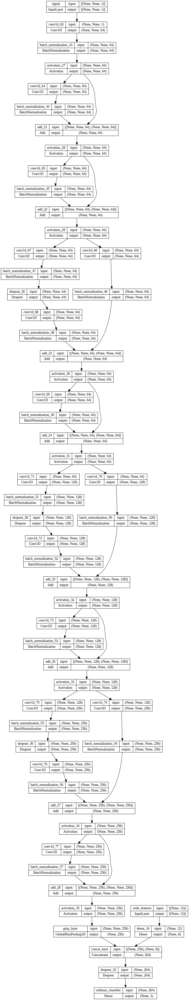

In [ ]:
from tensorflow import keras as tfk
tfk.utils.plot_model(WIDE, expand_nested=True, show_shapes=True)

In [ ]:
WIDE.compile(
    optimizer = optimizer,
    loss = loss,
    #metrics = metrics
)

In [ ]:
# check
print(X_train.shape, X_features_train.shape, y_train_one_hot.shape)
print(X_val_segments.shape, X_features_val.shape, y_val_one_hot.shape)

In [ ]:
def fit_model_Wide(model, train, train_feat, y_train, batch_size, epochs, val, val_feat, y_val, callbacks_list):
  validation_metric = []
  training_metric = []
  history = model.fit(
      x = [train, train_feat],
      y = y_train,
      batch_size = batch_size,
      epochs = 100,
      validation_data=[[val, val_feat], y_val],
      callbacks = callbacks_list,
      class_weight = class_weights
  ).history
  return history

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=([X_val_segments, X_features_val], y_val), train_data=([X_train, X_features_train], y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=10, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=5, verbose=1)
      ]

In [ ]:
len(y_val_one_hot)

7886

In [ ]:
history_WIDE = fit_model_Wide(WIDE, X_train, X_features_train, y_train_one_hot, batch_size, epochs, X_val_segments, X_features_val, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_WIDE)

In [ ]:
metric_WIDE = predict_and_report_Wide(WIDE, X_test_segments, X_features_test, y_test)

In [ ]:
metric_WIDE

#### 13.2.3.5 DenseNet

In [ ]:
del(DenseNet)

In [ ]:
from keras.models import Model
from keras.layers import Input, Dense, Concatenate, Activation, BatchNormalization
#from keras.layers.convolutional import Conv1D
from keras.layers import MaxPooling1D, AveragePooling1D, GlobalAveragePooling1D
from keras.regularizers import l2

def dense_block(x, filters, blocks, name):
    """
    Creates a dense block in the DenseNet architecture.
    """
    for i in range(blocks):
        x = conv_block(x, filters, name=name + '_block' + str(i + 1))
    return x

def conv_block(x, filters, name):
    """
    Creates a convolutional block in the DenseNet architecture.
    """
    x = BatchNormalization(axis=-1, epsilon=1.001e-5, name=name + '_bn')(x)
    x = Activation('relu', name=name + '_relu')(x)
    x = Conv1D(filters, kernel_size=5, padding='same', kernel_initializer='he_normal', name=name + '_conv')(x)
    return x

def transition_block(x, reduction, name):
    """
    Creates a transition block in the DenseNet architecture.
    """
    bn_axis = -1
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name=name + '_bn')(x)
    x = Activation('relu', name=name + '_relu')(x)
    x = Conv1D(int(filters * reduction), kernel_size=1, padding='same', kernel_initializer='he_normal', name=name + '_conv')(x)
    x = MaxPooling1D(2, strides=2, name=name + '_pool')(x)
    return x

def create_dense_net( num_classes=3, dense_blocks=5, dense_layers=-1, growth_rate=12, compression=0.5, activation='softmax', dropout_rate=None, l2_regularizer=None):
    """
    Creates a DenseNet model.
    """
    second_input = Input(shape = input_shape_features, name = 'second_input')
    #wide_branch = Dense(8, activation='tanh', name='wide_dense')(second_input)

    bn_axis = -1
    input = Input(shape=input_shape, name='input')
    x = Conv1D(2 * growth_rate, kernel_size=5, strides=2, padding='same', kernel_initializer='he_normal', name='initial_conv')(input)
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name='initial_bn')(x)
    x = Activation('relu', name='initial_relu')(x)
    x = MaxPooling1D(3, strides=2, padding='same', name='initial_pool')(x)

    for i in range(dense_blocks - 1):
        x = dense_block(x, growth_rate, dense_layers, name='dense_block_' + str(i + 1))
        x = transition_block(x, compression, name='transition_block_' + str(i + 1))

    x = dense_block(x, growth_rate, dense_layers, name='dense_block_' + str(dense_blocks))
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name='final_bn')(x)
    x = Activation('relu', name='final_relu')(x)
    x = GlobalAveragePooling1D(name='final_pool')(x)

    if dropout_rate is not None:
        x = Dropout(dropout_rate, name='final_dropout')(x)

    shared_path = concatenate([x, second_input], name='concat_layer')
    shared_path = Dropout(0.2)(shared_path)

    shared_path = Dense(classes, activation='softmax', name='softmax_classifier')(shared_path)


    model = Model(inputs =  [input, second_input], outputs = shared_path)

    return model

# Example usage:
filters = 100
DenseNet = create_dense_net()
DenseNet.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input (InputLayer)          [(None, None, 1)]            0         []                            
                                                                                                  
 initial_conv (Conv1D)       (None, None, 24)             144       ['input[0][0]']               
                                                                                                  
 initial_bn (BatchNormaliza  (None, None, 24)             96        ['initial_conv[0][0]']        
 tion)                                                                                            
                                                                                                  
 initial_relu (Activation)   (None, None, 24)             0         ['initial_bn[0][0]']    

In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

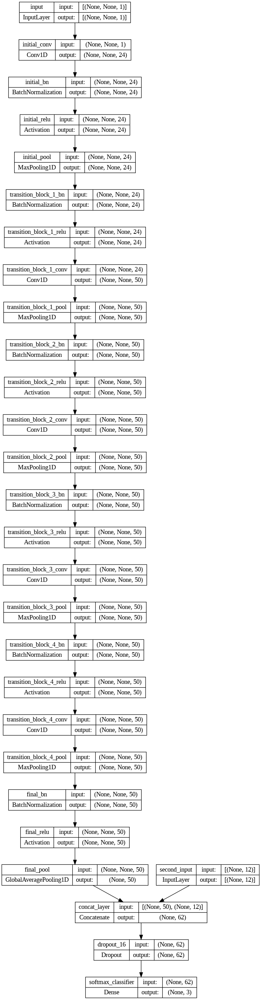

In [ ]:
from tensorflow import keras as tfk
tfk.utils.plot_model(DenseNet, expand_nested=True, show_shapes=True)

In [ ]:
DenseNet.compile(
    optimizer = optimizer,
    loss = loss,
    #metrics = metrics
)

In [ ]:
# check
print(X_train.shape, X_features_train.shape, y_train_one_hot.shape)
print(X_val_segments.shape, X_features_val.shape, y_val_one_hot.shape)

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=([X_val_segments, X_features_val], y_val), train_data=([X_train, X_features_train], y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=10, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=8, verbose=1)
      ]

In [ ]:
history_Wide_DenseNet = fit_model_Wide(DenseNet, X_train, X_features_train, y_train_one_hot, batch_size, epochs, X_val_segments, X_features_val, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_Wide_DenseNet)

In [ ]:
metric_Wide_DenseNet = predict_and_report_Wide(DenseNet, X_test_segments, X_features_test, y_test)

In [ ]:
metric_Wide_DenseNet

#### 13.2.3.6 CBAM

In [ ]:
del(WideCBAM)

In [ ]:
#hint: use tf.reduce_mean(in_block, axis=()) for avg pooling
# and tf.reduce_max(in_block, axis=()) for max pooling

def CBAM_block(in_block, ch, ratio=16):

    """
    @Convolutional Block Attention Module
    """

    _, length, channel = in_block.get_shape()  # (B, L, C)

    # channel attention
    avg_pool = tf.reduce_mean(in_block, axis=(1), keepdims=True)   # (B, 1, C)
    max_pool = tf.reduce_max(in_block, axis=(1), keepdims=True)  # (B, 1, C)

    dense1 = Dense(ch//ratio, activation='relu')
    avg_reduced = dense1(avg_pool) # (B, 1, C // r)
    max_reduced = dense1(max_pool) # (B, 1, C // r)

    dense2 = Dense(ch)
    avg_attention = dense2(avg_reduced) # (B, 1, C)
    max_attention = dense2(max_reduced) # (B, 1, C)

    x = tf.add(avg_attention, max_attention)   # (B, 1, C)
    x = tf.nn.sigmoid(x)        # (B, 1, C) to normalize attention scores between 0-1
    x = tf.multiply(in_block, x)   # (B, L, C)

    # spatial attention
    y_mean = tf.reduce_mean(x, axis=-1, keepdims=True)  # (B, L, 1)
    y_max = tf.reduce_max(x, axis=-1, keepdims=True)  # (B, L, 1)
    y = tf.concat([y_mean, y_max], axis=-1)     # (B, L, 2)
    y = tf.keras.layers.Conv1D(filters=1, kernel_size=7, padding='same', activation=tf.nn.sigmoid)(y)    # (B, L, 1)

    y = tf.multiply(x, y)  # (B, L, C)

    return y

In [ ]:
# Per chiamare più blocchi ho rimosso il secondo layer convoluzionale in ciascun blocco, perchè così c'erano troppi conv

def ResBs_Identity(block_input, num_filters):
  # 1st conv layer
  conv1 = Conv1D(filters=num_filters, kernel_size=3, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)
  relu1 = Activation('relu')(norm1)
  dropout = Dropout(0.2)(relu1)

  conv2 = Conv1D(num_filters, kernel_size=3, padding= 'same')(dropout) #per avere concordanza
  norm2 = BatchNormalization()(conv2)

  # 3. CBAM block (fucntion defined above)
  CBAM = CBAM_block(norm2, ch=num_filters)

  # 4. Summing Layer (adding a residual connection)
  sum = Add()([block_input, CBAM])
  relu2 = Activation('relu')(sum)

  return relu2

def ResBs_Conv(block_input, num_filters):

  block_shortcut = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  block_shortcut = BatchNormalization()(block_shortcut)

  conv1 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(block_input)
  norm1 = BatchNormalization()(conv1)
  dropout = Dropout(0.2)(norm1)

  conv2 = Conv1D(filters=num_filters, kernel_size=3, strides=1, padding='same')(dropout)
  norm2 = BatchNormalization()(conv2)

  CBAM = CBAM_block(norm2, ch=num_filters)

  sum = Add()([block_shortcut, CBAM])
  relu2 = Activation('relu')(sum)

  return relu2

# ResNet model definition
def WIDEresnetCBAM(classes=3):

  input = Input(shape=input_shape, name = 'signal') # we can't use Sequential because otherwise we can't use the skip connections

  # A. Wide features
  wide_input = Input(shape= input_shape_features , name = 'wide_features')
  wide_branch = Dense(8, activation='relu')(wide_input)


  ResNet = Conv1D(filters=64, kernel_size=3, padding='same')(input) # the dimension of the kernel is not preset, it depends on the input data
  ResNet = BatchNormalization()(ResNet)
  ResNet = Activation('relu')(ResNet)
  ResNet = MaxPooling1D(pool_size=2, strides=2)(ResNet)

  ResNet = ResBs_Identity(ResNet, 64)
  dropout = Dropout(0.2)(ResNet)
  ResNet = ResBs_Conv(ResNet, 128)
  ResNet = MaxPooling1D(pool_size=2, strides = 2)(ResNet)

  ResNet = ResBs_Identity(ResNet, 128)
  dropout = Dropout(0.2)(ResNet)
  ResNet = ResBs_Conv(ResNet, 256)
  ResNet = ResBs_Identity(ResNet, 256)


  ResNet = GlobalMaxPooling1D(name='gmp_layer')(ResNet) # gmp: global max pooling

  shared_path = concatenate([ResNet, wide_branch], name='concat_layer')
  shared_path = Dropout(0.2)(shared_path)
  #shared_path = Dense(32, activation='tanh', name='hidden_1')(shared_path)
  #shared_path = Dropout(0.2)(shared_path)
  shared_path = Dense(classes, activation='softmax', name='softmax_classifier')(shared_path)

  model = Model(inputs = [input, wide_input], outputs = shared_path)
  return model

In [ ]:
loss = "categorical_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 signal (InputLayer)         [(None, None, 1)]            0         []                            
                                                                                                  
 conv1d_45 (Conv1D)          (None, None, 64)             256       ['signal[0][0]']              
                                                                                                  
 batch_normalization_30 (Ba  (None, None, 64)             256       ['conv1d_45[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_18 (Activation)  (None, None, 64)             0         ['batch_normalization_30

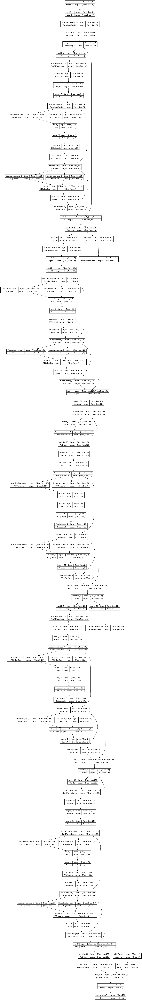

In [ ]:
WideCBAM = WIDEresnetCBAM()
WideCBAM.summary()
from tensorflow import keras as tfk
tfk.utils.plot_model(WideCBAM, expand_nested=True, show_shapes=True)

In [ ]:
WideCBAM.compile(
    optimizer = optimizer,
    loss = loss,
    #metrics = metrics
    )

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=([X_val_segments,X_features_val], y_val), train_data=([X_train, X_features_train], y_train)),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=15, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=10, verbose=1)
      ]

In [ ]:
print(X_train.shape, X_features_train.shape, y_train_one_hot.shape)
print(X_val_segments.shape, X_features_val.shape, y_val_one_hot.shape)

In [ ]:
history_CBAM = fit_model_Wide(WideCBAM, X_train, X_features_train, y_train_one_hot, batch_size, epochs, X_val_segments, X_features_val, y_val_one_hot, callbacks_list)

In [ ]:
plot_custom_metric(history_CBAM)

In [ ]:
metric_CBAM = predict_and_report_Wide(WideCBAM, X_test_segments, X_features_test, y_test)

In [ ]:
metric_CBAM

### 13.2.4 Comparison

In [ ]:
metrics = [metric_vgg, metric_LSTM, metric_resnet, metric_WIDE, metric_CBAM, metric_Wide_DenseNet]
metrics = np.array(metrics)

names = ['VGG', 'LSTM', 'ResNet', 'Wide_ResNet', 'Wide_ResNet_CBAM', 'Wide_DenseNet']


# Define a colormap
cmap = plt.cm.Greens

# Normalize the data to [0, 1] range to match the colormap
norm = plt.Normalize(0.4, np.max(metrics))

plt.figure(figsize=(15, 7))

# Plotting the bar chart with gradient colors
bars = plt.bar(range(len(metrics)), metrics, color=cmap(norm(metrics)))

# Plotting the value on top of each bar
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.01, f'{metrics[i]:.2f}', ha='center', va='bottom')

plt.xticks(range(len(metrics)), names)
plt.grid(True, linestyle='--', alpha=0.5, zorder=0)
# Adding labels
plt.xlabel('Model')
plt.ylabel('Custom_f1_score')
plt.title('Custom metric for different models')
plt.ylim(0,0.8)
# Adding color bar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Custom_f1_score')

plt.show()



In [ ]:
histories = [history_vgg, history_LSTM, history_resnet, history_WIDE, history_CBAM, history_Wide_DenseNet]
names = ['VGG', 'LSTM', 'ResNet', 'Wide_ResNet', 'Wide_ResNet_CBAM', 'Wide_DenseNet']

def plot_custom_metric(history, names):
  plt.figure(figsize=(15,5))
  for i in range(len(history)):
    plt.plot(np.arange(len(history[i]['train_custom_f1_score'])), history[i]['val_custom_f1_score'], linewidth=1.5,  label=names[i])


  plt.title('Validation Weighted F1 Dot Product for each trained model')
  plt.xlabel('Epoch')
  plt.ylabel('Weighted F1 Dot Product')
  plt.legend()
  plt.grid(True)
  plt.show()

plot_custom_metric(histories, names)

In [ ]:
def compute_confidence_WIDE(model, X_test, X_test_features, y_test):

  predictions = model.predict([X_test, X_test_features])
  argmax_pred = np.argmax(predictions, axis=-1)

  confidence0 = []
  confidence1 = []
  confidence2 = []

  for i in range(len(predictions)):
    sorted_predictions = sorted(predictions[i])
    if argmax_pred[i]==0:
      confidence0.append(sorted_predictions[-1]-sorted_predictions[-2])
    if argmax_pred[i]==1:
      confidence1.append(sorted_predictions[-1]-sorted_predictions[-2])
    if argmax_pred[i]==2:
      confidence2.append(sorted_predictions[-1]-sorted_predictions[-2])

  confidence0 = np.array(confidence0)
  confidence1 = np.array(confidence1)
  confidence2 = np.array(confidence2)

  plt.figure(figsize=(20, 6))
  plt.scatter(range(len(confidence0)), confidence0, label='Confidence')
  plt.plot(np.arange(len(confidence0)), np.mean(confidence0) * np.ones(len(confidence0)), color='red', label='Mean Confidence = '+ str(np.mean(confidence0)))
  plt.xlabel('Index')
  plt.ylabel('Confidence')
  plt.title('Confidence Levels with Mean Line')
  plt.legend(loc='lower center')
  plt.grid(True)
  plt.title('Normal classification confidence')
  plt.show()

  if len(np.unique(y_test))==2:

    plt.figure(figsize=(20, 6))
    plt.scatter(range(len(confidence1)), confidence1, color = 'green', label='Confidence')
    plt.plot(np.arange(len(confidence1)), np.mean(confidence1) * np.ones(len(confidence1)), color='red', label='Mean Confidence = ' + str(np.mean(confidence1)))
    plt.xlabel('Index')
    plt.ylabel('Confidence')
    plt.title('Confidence Levels with Mean Line')
    plt.legend(loc='lower center')
    plt.grid(True)
    plt.title('Atrial and ventricular classification confidence')
    plt.show()
    return confidence0, confidence1

  elif len(np.unique(y_test))==3:

    plt.figure(figsize=(20, 6))
    plt.scatter(range(len(confidence1)), confidence1, color = 'green', label='Confidence')
    plt.plot(np.arange(len(confidence1)), np.mean(confidence1) * np.ones(len(confidence1)), color='red', label='Mean Confidence = ' + str(np.mean(confidence1)))
    plt.xlabel('Index')
    plt.ylabel('Confidence')
    plt.title('Confidence Levels with Mean Line')
    plt.legend(loc='lower center')
    plt.grid(True)
    plt.title('Atrial classification confidence')
    plt.show()

    plt.figure(figsize=(20, 6))
    plt.scatter(range(len(confidence2)), confidence2, color = 'orange', label='Confidence')
    plt.plot(np.arange(len(confidence2)), np.mean(confidence2) * np.ones(len(confidence2)), color='red', label='Mean Confidence = ' + str(np.mean(confidence2)))
    plt.xlabel('Index')
    plt.ylabel('Confidence')
    plt.title('Confidence Levels with Mean Line')
    plt.legend(loc='lower center')
    plt.grid(True)
    plt.title('Vantricular classification confidence')
    plt.show()

    return confidence0, confidence1, confidence2


    return confidence0, confidence1, confidence2


283/283 [==============================] - 6s 23ms/step


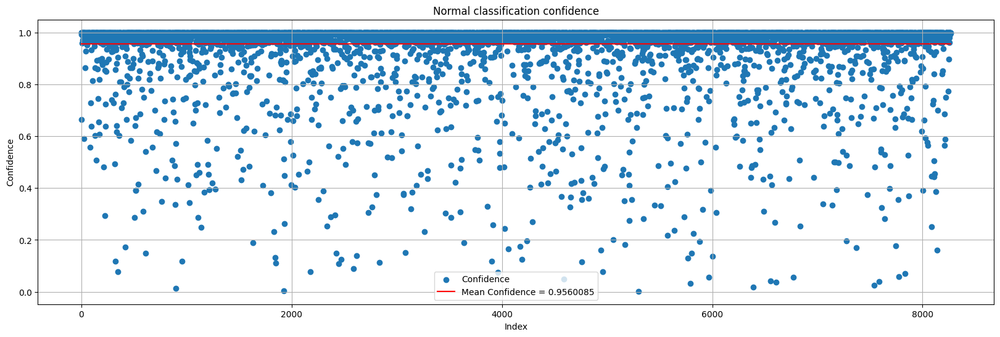

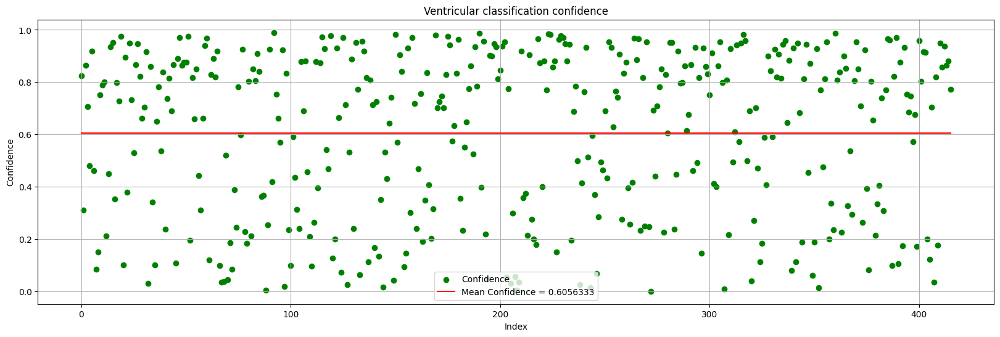

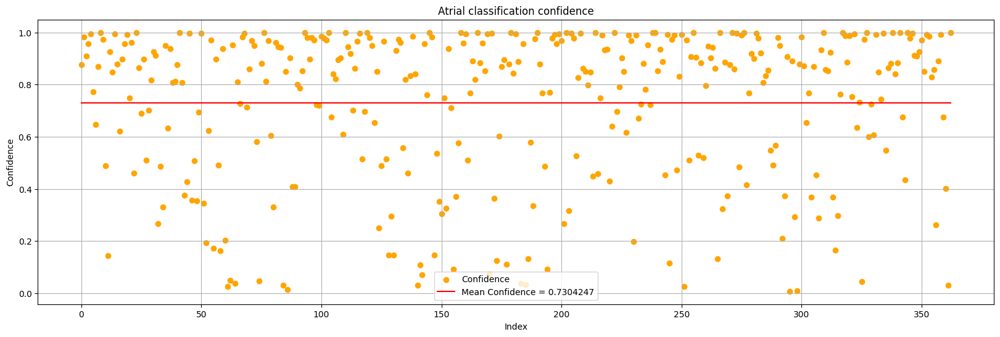

In [ ]:
confidence0, confidence1, confidence2 = compute_confidence_WIDE(WideCBAM, X_test_segments, X_features_test, y_test)

In [ ]:
metric_CBAM

### 13.2.5 DenseNet Binary

In [ ]:
y_train_binary = []
for i in range(len(y_train)):
  if y_train[i]==2:
    y_train_binary.append(1)
  else:
    y_train_binary.append(y_train[i])
y_train_binary = np.array(y_train_binary)

y_val_binary = []
for i in range(len(y_val)):
  if y_val[i]==2:
    y_val_binary.append(1)
  else:
    y_val_binary.append(y_val[i])
y_val_binary = np.array(y_val_binary)

y_test_binary = []
for i in range(len(y_test)):
  if y_test[i]==2:
    y_test_binary.append(1)
  else:
    y_test_binary.append(y_test[i])
y_test_binary = np.array(y_test_binary)

In [ ]:
proportion_weights = compute_proportions(y_val_binary)
proportion_weights

In [ ]:
class_weights_binary = dict(zip(np.unique(y_train_binary), compute_class_weight(class_weight='balanced', classes=np.unique(y_train_binary),y=y_train_binary)))
class_weights_binary

In [ ]:
weights_train_binary = np.zeros(len(class_weights_binary.keys()))
print(weights_train_binary)

weights_train_binary[0] = class_weights[0]
weights_train_binary[1] = class_weights[1]

np.array(weights_train_binary)

weights_train_binary = weights_train_binary/sum(weights_train_binary)
weights_train_binary

In [ ]:
classes = 2

In [ ]:
y_train_one_hot_binary = to_categorical(y_train_binary)
y_val_one_hot_binary = to_categorical(y_val_binary)
y_test_one_hot_binary = to_categorical(y_test_binary)

In [ ]:
del(DenseNet)

In [ ]:
from keras.models import Model
from keras.layers import Input, Dense, Concatenate, Activation, BatchNormalization
#from keras.layers.convolutional import Conv1D
from keras.layers import MaxPooling1D, AveragePooling1D, GlobalAveragePooling1D
from keras.regularizers import l2

def dense_block(x, filters, blocks, name):
    """
    Creates a dense block in the DenseNet architecture.
    """
    for i in range(blocks):
        x = conv_block(x, filters, name=name + '_block' + str(i + 1))
    return x

def conv_block(x, filters, name):
    """
    Creates a convolutional block in the DenseNet architecture.
    """
    x = BatchNormalization(axis=-1, epsilon=1.001e-5, name=name + '_bn')(x)
    x = Activation('relu', name=name + '_relu')(x)
    x = Conv1D(filters, kernel_size=5, padding='same', kernel_initializer='he_normal', name=name + '_conv')(x)
    return x

def transition_block(x, reduction, name):
    """
    Creates a transition block in the DenseNet architecture.
    """
    bn_axis = -1
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name=name + '_bn')(x)
    x = Activation('relu', name=name + '_relu')(x)
    x = Conv1D(int(filters * reduction), kernel_size=1, padding='same', kernel_initializer='he_normal', name=name + '_conv')(x)
    x = MaxPooling1D(2, strides=2, name=name + '_pool')(x)
    return x

def create_dense_net( num_classes=3, dense_blocks=3, dense_layers=-1, growth_rate=12, compression=0.5, activation='softmax', dropout_rate=None, l2_regularizer=None):
    """
    Creates a DenseNet model.
    """
    second_input = Input(shape = input_shape_features, name = 'second_input')
    #wide_branch = Dense(8, activation='tanh', name='wide_dense')(second_input)

    bn_axis = -1
    input = Input(shape=input_shape, name='input')
    x = Conv1D(2 * growth_rate, kernel_size=5, strides=2, padding='same', kernel_initializer='he_normal', name='initial_conv')(input)
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name='initial_bn')(x)
    x = Activation('relu', name='initial_relu')(x)
    x = MaxPooling1D(3, strides=2, padding='same', name='initial_pool')(x)

    for i in range(dense_blocks - 1):
        x = dense_block(x, growth_rate, dense_layers, name='dense_block_' + str(i + 1))
        x = transition_block(x, compression, name='transition_block_' + str(i + 1))

    x = dense_block(x, growth_rate, dense_layers, name='dense_block_' + str(dense_blocks))
    x = BatchNormalization(axis=bn_axis, epsilon=1.001e-5, name='final_bn')(x)
    x = Activation('relu', name='final_relu')(x)
    x = GlobalAveragePooling1D(name='final_pool')(x)

    if dropout_rate is not None:
        x = Dropout(dropout_rate, name='final_dropout')(x)

    shared_path = concatenate([x, second_input], name='concat_layer')
    shared_path = Dropout(0.2)(shared_path)

    shared_path = Dense(2, activation='softmax', name='softmax_classifier')(shared_path)


    model = Model(inputs =  [input, second_input], outputs = shared_path)

    return model

# Example usage:
filters = 100
DenseNet = create_dense_net()
DenseNet.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input (InputLayer)          [(None, None, 1)]            0         []                            
                                                                                                  
 initial_conv (Conv1D)       (None, None, 24)             144       ['input[0][0]']               
                                                                                                  
 initial_bn (BatchNormaliza  (None, None, 24)             96        ['initial_conv[0][0]']        
 tion)                                                                                            
                                                                                                  
 initial_relu (Activation)   (None, None, 24)             0         ['initial_bn[0][0]']    

In [ ]:
loss = "binary_crossentropy"
optimizer = keras.optimizers.Adam(learning_rate = 1e-4)
classes = 3

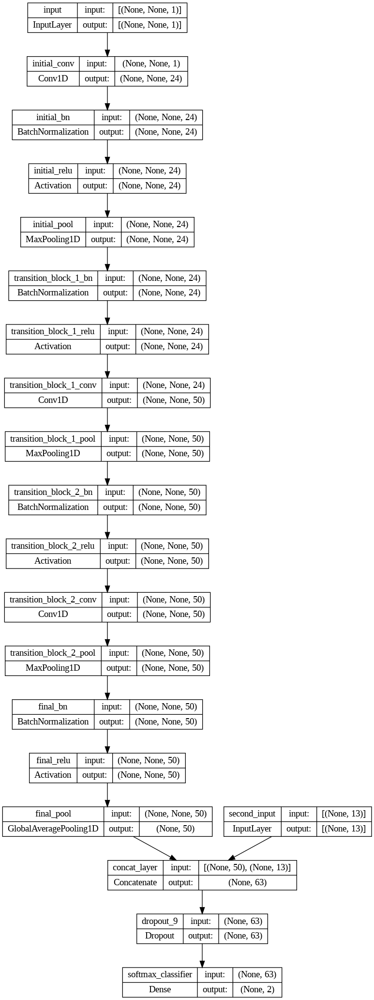

In [ ]:
from tensorflow import keras as tfk
tfk.utils.plot_model(DenseNet, expand_nested=True, show_shapes=True)

In [ ]:
DenseNet.compile(
    optimizer = optimizer,
    loss = loss,
    #metrics = metrics
)

In [ ]:
# check
print(X_train.shape, X_features_train.shape, y_train_one_hot_binary.shape)
print(X_val_segments.shape, X_features_val.shape, y_val_one_hot_binary.shape)

In [ ]:
callbacks_list = [
          F1ScoreClassCallback(validation_data=([X_val_segments, X_features_val], y_val_binary), train_data=([X_train, X_features_train], y_train_binary), num_classes = 2, weights=proportion_weights_binary, weights_tr = weights_train_binary),
          CustomEarlyStopping(monitor_vector=validation_metric, patience=10, verbose=1),
          CustomReduceLROnPlateau(monitor_vector=validation_metric, factor=0.7, patience=8, verbose=1)
      ]

In [ ]:
y_train_one_hot_binary

In [ ]:
history_Wide_DenseNet = fit_model_Wide(DenseNet, X_train, X_features_train, y_train_one_hot_binary, batch_size, epochs, X_val_segments, X_features_val, y_val_one_hot_binary, callbacks_list)

In [ ]:
plot_custom_metric(history_Wide_DenseNet)

In [ ]:
def predict_and_report_Wide_Binary(model, X_test, X_features_test, y_test, proportions):
  y_pred_one_hot = model.predict([X_test, X_features_test]) # one_hot_predictions

  # Print the shape of the predictions
  print(f"Predictions shape: {y_pred_one_hot.shape}")
  y_pred = np.argmax(y_pred_one_hot,axis=-1)

  class_report = classification_report(y_test, y_pred)

  cm = confusion_matrix(y_test, y_pred, labels=[0, 1])

  # Normalize confusion matrix to show percentages
  cm_normalized = cm / cm.astype(np.float).sum(axis=1, keepdims=True)

  # Plot confusion matrix with seaborn heatmap
  plt.figure(figsize=(10, 8))
  sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap="Blues", cbar=True,
              xticklabels=['0', '1'], yticklabels=['0', '1'])
  plt.xlabel('Predicted label')
  plt.ylabel('True label')
  plt.title('Confusion Matrix (Percentage)')
  plt.show()

  # Print classification report
  print(class_report)


  word_array = class_report.split()
  word_array
  f1score = [word_array[7], word_array[12]]

  f1score_num = []
  for i in range(len(f1score)):
    f1score_num.append(float(f1score[i]))

  f1score_num

  proportions = [len(np.array(np.where(y_test==0))[0])/(len(y_test)), len(np.array(np.where(y_test==1))[0])/(len(y_test))]

  weights = [(1-proportions[0]), (1-proportions[1])]
  weights = np.array(weights)
  weights = weights/sum(weights)
  weights

  metric = np.dot(f1score_num, weights)


  return metric

In [ ]:
metric_Wide_Dense_Binary = predict_and_report_Wide_Binary(DenseNet, X_test_segments, X_features_test, y_test_binary, proportions_binary)

In [ ]:
metric_Wide_Dense_Binary


In [ ]:
confidence0, confidence1 = compute_confidence_WIDE(DenseNet, X_test_segments, X_features_test, y_test_binary)

In [ ]:
DenseNet.save('/content/drive/MyDrive/Project - Applied AI in biomedicine / Binary_Wide_DenseNet_8_febbraio')

# PROCESSING OF UNSEEN TEST SET

## Segmentation with artifacts

In [ ]:
pbar = ProgressBar()
new_fs = 128

# Resample recordings to match the sampling frequency of 128Hz
recordings_resampled = list()
for i, rec in pbar(enumerate(recordings)):
  fs = LIST[i][0][3]
  # if the sampling frequency of the patient is different from 128 Hz
  if fs != new_fs:
    recording_resampled = resample(rec, int(rec.shape[0]*new_fs/fs))
  # if the sampling frequency of the patient is already 128 Hz i do not have to resample his signal
  else:
    recording_resampled = rec
  recording_resampled = np.squeeze(recording_resampled)
  recordings_resampled.append(recording_resampled)
len(recordings_resampled)

In [ ]:
# Convert labels and peaks to match the new samples after the resampling

peaks_resampled = []
for i in range(len(peaks)): # peaks is a list
  fs = LIST[i][0][3]
  peaks_res_signal = peaks[i]*new_fs/fs
  peaks_resampled.append(peaks_res_signal)
  peaks_resampled[i].sort()

peaks_resampled_array = np.array(peaks_resampled, dtype=object)
len(peaks_resampled)

In [ ]:
# useful functions

# takes as input a signal and applies the Butterworth filter,
# outputs the filtered signal
def bw_filter(resampled_signal):
  cutoff_lowf = 0.5
  cutoff_highf = 2.5
  b, a = sig.butter(5, [cutoff_lowf, cutoff_highf], btype='bandpass', analog=False, output='ba', fs=new_fs)
  y_bwfilt = sig.filtfilt(b, a, resampled_signal)
  return y_bwfilt

In [ ]:
# filter the clean signal for all the patients

filtered_recordings = [] #_holdout
for i in range(len(recordings_resampled)):#_holdout
  filtered_recordings.append(bw_filter(recordings_resampled[i]))#_holdout#_holdout

In [ ]:
# filter the clean signal for all the patients

filtered_recordings = [] #_holdout
for i in range(len(recordings_resampled)):#_holdout
  filtered_recordings.append(bw_filter(recordings_resampled[i]))#_holdout#_holdout

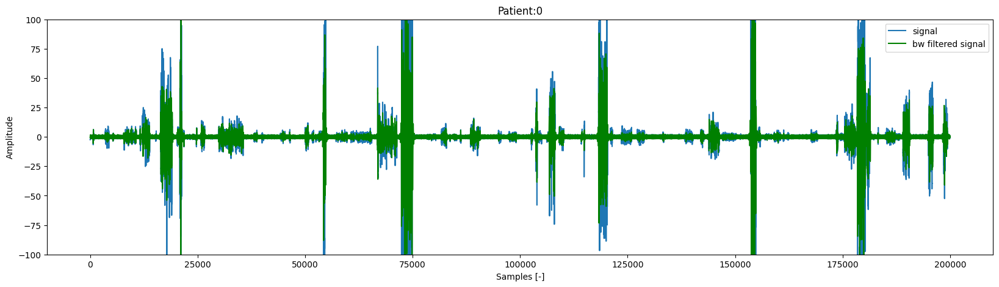

In [ ]:
# Plot
patient = 0
min_n_samples = 0
max_n_samples = 200000
t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; ppg_signal.shape[0]/fs; 0,10,1/fs
fig, axs = plt.subplots(figsize=(20,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, recordings_resampled[patient][min_n_samples:max_n_samples], color='C0', label='signal')
axs.plot(t, filtered_recordings[patient][min_n_samples:max_n_samples], color='g', label='bw filtered signal')
#axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
#addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-100,100)
plt.legend()
plt.show()

In [ ]:
# filter the clean signal for all the patients

filtered_recordings = [] #_holdout
for i in range(len(recordings_resampled)):#_holdout
  filtered_recordings.append(bw_filter(recordings_resampled[i]))#_holdout#_holdout

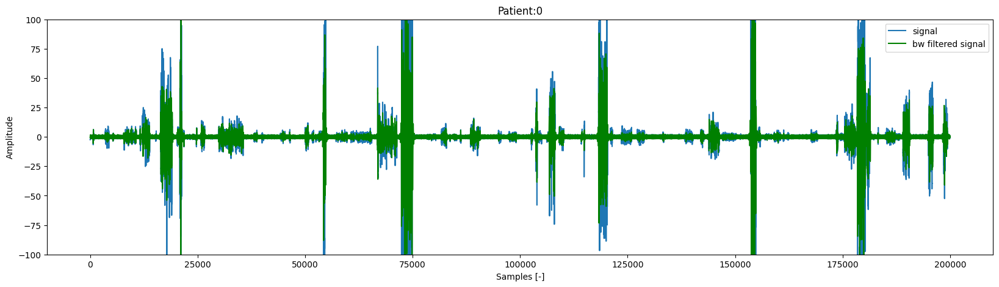

In [ ]:
# Plot
patient = 0
min_n_samples = 0
max_n_samples = 200000
t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; ppg_signal.shape[0]/fs; 0,10,1/fs
fig, axs = plt.subplots(figsize=(20,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, recordings_resampled[patient][min_n_samples:max_n_samples], color='C0', label='signal')
axs.plot(t, filtered_recordings[patient][min_n_samples:max_n_samples], color='g', label='bw filtered signal')
#axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
#addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-100,100)
plt.legend()
plt.show()

In [ ]:
#compute the distances in number of samples between each pair of consecutive peaks
peak_to_peak_distances = []

for patient in range(len(peaks_resampled)):
  distances = []
  for peak in range(len(peaks_resampled[patient])-1):
    distances.append(peaks_resampled[patient][peak+1][0] - peaks_resampled[patient][peak][0])
  peak_to_peak_distances.append(distances)

In [ ]:
# compute the median of the peak-to-peak distances for each patient
# it will be the basis to establish the segments' length
peak_to_peak_distances_median = []

for patient in range(len(peak_to_peak_distances)):
  peak_to_peak_distances_median.append(np.median(peak_to_peak_distances[patient]))

In [ ]:
# compute the median of the peak-to-peak distances for each patient
# it will be the basis to establish the segments' length
peak_to_peak_distances_median = []

for patient in range(len(peak_to_peak_distances)):
  peak_to_peak_distances_median.append(np.median(peak_to_peak_distances[patient]))

In [ ]:
# the segments span from 1/3 of the computed median for each patient before the related peak
# to 2/3 of the same value after the peak
total_segments_nomessy = []
total_segments_nomessy_ampl = []
total_peaks_nomessy = []
total_labels_nomessy = []

for patient in range(len(peaks_resampled)):
  segments_nomessy = []
  segments_nomessy_ampl = []
  peaks_nomessy = []
  labels_nomessy = []
  for peak in range(len(peaks_resampled[patient])):
    onset = int(peaks_resampled[patient][peak][0]) - int(peak_to_peak_distances_median[patient]/3)
    offset = int(peaks_resampled[patient][peak][0]) + int(peak_to_peak_distances_median[patient]*(2/3))
    segments_nomessy.append(np.arange(onset, offset))
    if(offset>len(filtered_recordings[patient])):
      segments_nomessy_ampl.append(np.concatenate([filtered_recordings[patient][onset:offset], filtered_recordings[patient][-1]*np.ones(offset-len(filtered_recordings[patient]))]))
    else:
      segments_nomessy_ampl.append(filtered_recordings[patient][onset:offset])
    peaks_nomessy.append(peaks_resampled[patient][peak][0])
    labels_nomessy.append(LABELS[patient][peak])
  total_segments_nomessy.append(segments_nomessy)
  total_segments_nomessy_ampl.append(segments_nomessy_ampl)
  total_peaks_nomessy.append(peaks_nomessy)
  total_labels_nomessy.append(labels_nomessy)

print(len(total_segments_nomessy), len(total_segments_nomessy_ampl), len(total_peaks_nomessy), len(total_labels_nomessy))

In [ ]:
total_labels_withart_flat = [sublist1 for sublist2 in total_labels_nomessy for sublist1 in sublist2] # needed for the features dataframe
total_labels_withart_flat = np.array(total_labels_withart_flat)
len(total_labels_withart_flat)

In [ ]:
segments_list = [sublist2 for sublist1 in total_segments_nomessy_ampl for sublist2 in sublist1]
labels_list = [sublist2 for sublist1 in total_labels_nomessy for sublist2 in sublist1]
segments_arr = np.array(segments_list)
labels_arr = np.array(labels_list)
#print(len(segments_arr), len(features_df['label']))

In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)
num_samples = 66

segments_arr_res = []
label_arr_res = []
for i in range(len(segments_arr)):
  segments_arr_res.append(resample(segments_arr[i], num_samples))
segments_arr_res = np.array(segments_arr_res)
print(len(segments_arr_res), len(segments_arr_res[0]))

In [ ]:
a = [[[1,2], [1,2,3]],[[1,2,3,4,5],[1,2,3,4]]]
b = [sublist2 for sublist1 in a for sublist2 in sublist1]
b1 = np.array(b)
b1

In [ ]:
segments_arr.shape


## Artifact removal - anomaly detection

### Vanilla autoencoder

In [ ]:
# Vanilla autoencoder
input_shape = 100

bottleneck_size = 8

# This is our input image
input_encoder = Input(shape=(input_shape,))

# "encoded" is the encoded representation of the input
encoded = Dense(128, activation='relu')(input_encoder)
encoded = Dense(64, activation='relu')(encoded)
encoded = Dense(32, activation='relu')(encoded)
encoded = Dense(16, activation='relu')(encoded)
encoded = Dense(bottleneck_size, activation='relu')(encoded)
encoder = Model(input_encoder, encoded)

# "decoded" is the lossy reconstruction of the input
input_decoder = Input(shape=(bottleneck_size,))

decoded = Dense(16, activation='relu')(input_decoder)
decoded = Dense(32, activation='relu')(decoded)
decoded = Dense(64, activation='relu')(decoded)
decoded = Dense(128, activation='relu')(decoded)
decoded = Dense(input_shape, activation='linear')(decoded)
decoder = Model(input_decoder, decoded)

full = decoder(encoder(input_encoder))

autoencoder = Model(input_encoder, full) # input and output
# This model maps an input to its reconstruction

In [ ]:
autoencoder.compile(optimizer='adam', loss='mae')

#autoencoder.fit(X_train, X_train, epochs=100, batch_size=512, validation_data=(X_val, X_val))

In [ ]:
# check the behaviour on the removed segments (should be all False)
reconstructed_noisy = autoencoder(segments_arr_res_removed)
noisy_loss = losses.mae(reconstructed_noisy, segments_arr_res_removed) # this is the reconstruction loss

pred = prediction(autoencoder, segments_arr_res_removed, t)
print(pred)

unique, counts = np.unique(pred, return_counts=True)
print(unique, counts)

In [ ]:
train_loss_sel = train_loss[0:4000]
noisy_loss_sel = noisy_loss[0:4000]

plt.figure(figsize=(17,7))
plt.hist(noisy_loss_sel, color='r', alpha = 0.7)
plt.hist(train_loss_sel, color='g', alpha = 0.7)
plt.axvline(x=t, linewidth='2', color='k')
plt.xlim([-0.05,2])

All dataset

In [ ]:
save_dir = '/content/drive/MyDrive/Project - Applied AI in biomedicine/autoencoder'

autoencoder = tf.keras.models.load_model(save_dir)

In [ ]:
def prediction(model, data, threshold):
  rec = model(data)
  loss = losses.mae(rec, data)
  return tf.math.less(loss, threshold) # compare the loss function to a threshold

In [ ]:
# We need to flatten the segments array before

t = 0.11983306878684369 # np.percentile(train_loss, 99) for autoencoder trained with
# X_train with segments 100 samples long
t = 0.3392959079784496 #np.percentile(train_loss, 99.99) for autoencoder trained with
# X_train with segments 66 samples long

X_reshaped = np.expand_dims(segments_arr_res, axis=-1)

reconstructed = autoencoder(X_reshaped)
loss = losses.mae(reconstructed, segments_arr_res) # this is the reconstruction loss

pred = prediction(autoencoder, segments_arr_res, t)
print(pred)

unique, counts = np.unique(pred, return_counts=True)
print(unique, counts)
# 100 samples -> [False  True] [145161 101453]

In [ ]:
predicted_true = segments_arr_res[pred]
predicted_false = segments_arr_res[~pred]

In [ ]:
pred_reshaped = []
j = 0
total_length = 0 # needed to iterate with j on the rows
for pat in range(len(total_segments_nomessy)):
  if pat>= 1: total_length += len(total_segments_nomessy[pat-1])
  pred_reshaped_pat = []
  for i in range(len(total_segments_nomessy[pat])):
    if pat>=1:
      j = total_length + i
      if(j == len(segments_arr_res)): break
    else: j = i
    pred_reshaped_pat.append(pred[j])
  pred_reshaped_pat = np.array(pred_reshaped_pat)
  pred_reshaped.append(pred_reshaped_pat)
pred_reshaped = np.array(pred_reshaped)

# sanity check
for pat in range(len(total_segments_nomessy)):
  if(len(total_segments_nomessy[pat]) != len(pred_reshaped[pat])): print(pat)

In [ ]:
original_pred_reshaped = pred_reshaped

In [ ]:
segments_list = [sublist2 for sublist1 in total_segments_nomessy_ampl for sublist2 in sublist1]
labels_list = [sublist2 for sublist1 in total_labels_nomessy for sublist2 in sublist1]
segments_arr = np.array(segments_list)
labels_arr = np.array(labels_list)


In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)
num_samples = 66

segments_arr_res = [{}]
label_arr_res = []
for i in range(len(segments_arr)):
  segments_arr_res.append(resample(segments_arr[i], num_samples))
segments_arr_res = np.array(segments_arr_res)
print(len(segments_arr_res), len(segments_arr_res[0]))

## Extraction of selected features for segments with artifacts

For noisy segments found by the autoencoder, features were automatically assigned as nan and therefore successively imputed, as any calculation from the signals themselves would have been misleading.

In [ ]:
total_segments_withart = total_segments_nomessy
total_segments_withart_ampl = total_segments_nomessy_ampl
total_peaks_withart = total_peaks_nomessy
total_labels_withart = total_labels_nomessy

### Statistical features

In [ ]:
def return_minima_indexes(A, B):
  mapping = [(A[i], B[i]) for i in range(len(A))]
  mapping.sort(key=lambda x: x[1]) # sort according to the amplitude

  A = [pair[0] for pair in mapping]
  B = [pair[1] for pair in mapping]

  if A[0]<A[1]: return A[0], A[1]
  return A[1], A[0]

In [ ]:
def find_peak_minima_2(minima_indexes, segment, segment_ampl, peak_index):
    if len(minima_indexes) == 0:
      return int(segment[0]), int(segment[-1]), int(0), int(len(segment)-1)
    elif len(minima_indexes) == 1:
      if(peak_index-segment[0] > minima_indexes[0]): # the only minimum found is before the peak
        return int(segment[0]+minima_indexes[0]), int(segment[-1]), int(minima_indexes[0]), int(len(segment)-1) #segment[-1]-segment[0]
        # e.g. segment[0] = 400, segment[-1] = 480, minima_indexes[0] = 20 -> the relative second minimum is 80
      elif(peak_index-segment[0] < minima_indexes[0]): # the only minimum found is after the peak
        return int(segment[0]), int(segment[0]+minima_indexes[0]), int(0), int(minima_indexes[0])
        # e.g. segment[0] = 400, minima_indexes[0] = 60, segment[-1] = 480 -> the relative second minimum is 60
    elif len(minima_indexes)>=2:
      max = np.max(segment_ampl)
      first_minima_index, second_minima_index = return_minima_indexes(minima_indexes, segment_ampl[minima_indexes])
      peak_between = np.max(segment_ampl[first_minima_index:second_minima_index])
      #print(f"len >=2 {first_minima_index}, {second_minima_index}, {peak_index-segment[0]}")
      #for i in range(len(minima_indexes)-1):
      if(peak_between == max):
        return int(segment[0]+first_minima_index), int(segment[0]+second_minima_index), int(first_minima_index), int(second_minima_index)
      elif(peak_index-segment[0] < segment[0]+first_minima_index): # the real maximum could be somewhere else (e.g. see segment[0][2243])
        return int(segment[0]), int(segment[0]+second_minima_index), int(0), int(second_minima_index)
      elif(peak_index-segment[0] > segment[0]+second_minima_index):
        return int(segment[0]+second_minima_index), int(segment[-1]), int(second_minima_index), int(len(segment)-1)


In [ ]:
def bw_filter_lowpass(resampled_signal):
  b, a = sig.butter(1, 15, btype='lowpass', analog=False, output='ba', fs=new_fs)
  y_bwfilt = sig.filtfilt(b, a, resampled_signal)
  return y_bwfilt

In [ ]:
pred_reshaped = original_pred_reshaped

In [ ]:
# mean, median standard deviation, variance, skewness, kurtosis of the segments
# Statistical feature
total_segments_withart_skew = []
total_segments_withart_kurtosis = []

for pat in range(len(total_segments_withart)):
  pat_segments_skew = []
  pat_segments_kurtosis = []
  for i in range(len(total_segments_withart[pat])):
    segment_ampl = total_segments_withart_ampl[pat][i]
    segment_ampl_filt = bw_filter_lowpass(segment_ampl)
    minima_indexes = sig.argrelmin(segment_ampl_filt)[0]
    segment = total_segments_withart[pat][i]
    peak_index = total_peaks_withart[pat][i]
    result = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
    if pred_reshaped[pat][i] == True and result is not None:
      first_abs, second_abs, first_rel, second_rel = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
      pat_segments_skew.append(stats.skew(segment_ampl[first_rel:second_rel]))
      pat_segments_kurtosis.append(stats.kurtosis(segment_ampl[first_rel:second_rel]))
    else:
      if(result is None and pred_reshaped[pat][i] == True): pred_reshaped[pat][i] == False
      pat_segments_skew.append(np.nan)
      pat_segments_kurtosis.append(np.nan)
  total_segments_withart_skew.append(pat_segments_skew)
  total_segments_withart_kurtosis.append(pat_segments_kurtosis)

print(len(total_segments_withart_skew))

In [ ]:
# Create a dataframe whose rows are the segments and whose columns are the extracted features
# plus the label of the segment and the patient to which a segment belongs
statistical_features_df_withart = pd.DataFrame({})
tot_segments = 0
column_skew = []
column_kurt = []
column_pat = []

for pat in range(len(total_segments_withart)):
  for i in range(len(total_segments_withart[pat])):
    column_skew.append(total_segments_withart_skew[pat][i])
    column_kurt.append(total_segments_withart_kurtosis[pat][i])
    column_pat.append(pat)
  tot_segments += len(total_segments_withart[pat])

column_kurt = np.array(column_kurt)
column_pat = np.array(column_pat)

statistical_features_df_withart['Patient'] = column_pat
statistical_features_df_withart['Segment'] = range(tot_segments)
statistical_features_df_withart['skewness'] = column_skew
statistical_features_df_withart['kurtosis'] = column_kurt
statistical_features_df_withart['label'] = total_labels_withart_flat

In [ ]:
statistical_features_df_withart

,Patient,Segment,skewness,kurtosis,label
0,0,0,NaN,NaN,1
1,0,1,-0.492335,-1.003344,0
2,0,2,NaN,NaN,0
3,0,3,NaN,NaN,0
4,0,4,NaN,NaN,0
...,...,...,...,...,...
44456,19,44456,NaN,NaN,0
44457,19,44457,NaN,NaN,0
44458,19,44458,NaN,NaN,0
44459,19,44459,NaN,NaN,0


### Peak features

In [ ]:
pred_old = [sublist1 for sublist2 in pred_reshaped for sublist1 in sublist2]
pred_old = np.array(pred_old)
unique, counts = np.unique(pred_old, return_counts = True)
unique, counts

In [ ]:
# Create a dataframe whose rows are the segments and whose columns are the extracted features
# plus the label of the segment and the patient to which a segment belongs
peak_features_df_withart = pd.DataFrame({})

column_peak_min_second_derivative = []

for pat in range(len(total_segments_withart)):
  for i in range(len(total_segments_withart[pat])):
    segment_ampl = total_segments_withart_ampl[pat][i]
    segment_ampl_filt = bw_filter_lowpass(segment_ampl)
    minima_indexes = sig.argrelmin(segment_ampl_filt)[0]
    segment = total_segments_withart[pat][i]
    peak_index = total_peaks_withart[pat][i]
    result = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
    if pred_reshaped[pat][i] == True and result is not None:
      first_minima_index_abs, second_minima_index_abs, first_minima_index_rel, second_minima_index_rel = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
      segment_ampl_actual = segment_ampl[first_minima_index_rel:second_minima_index_rel]
      if(len(np.diff(segment_ampl_actual, n=2))==0):
        column_peak_min_second_derivative.append(np.nan)
      else:
        column_peak_min_second_derivative.append(np.min(np.diff(segment_ampl_actual, n=2)))
    else:
      if result is None and pred_reshaped[pat][i] == True:
        print(pat, i)
        pred_reshaped[pat][i] = False # the segment has some strange behaviour
      column_peak_min_second_derivative.append(np.nan)
column_peak_min_second_derivative = np.array(column_peak_min_second_derivative)

peak_features_df_withart['Patient'] = column_pat
peak_features_df_withart['Segment'] = range(tot_segments)
peak_features_df_withart['min_second_derivative'] = column_peak_min_second_derivative
peak_features_df_withart['label'] = total_labels_withart_flat

pred_new = [sublist1 for sublist2 in pred_reshaped for sublist1 in sublist2]
pred_new = np.array(pred_new)
unique, counts = np.unique(pred_new, return_counts = True)
unique, counts

In [ ]:
peak_features_df_withart

,Patient,Segment,min_second_derivative,label
0,0,0,NaN,1
1,0,1,-0.027079,0
2,0,2,NaN,0
3,0,3,NaN,0
4,0,4,NaN,0
...,...,...,...,...
44456,19,44456,NaN,0
44457,19,44457,NaN,0
44458,19,44458,NaN,0
44459,19,44459,NaN,0


### Peak-to-peak features

In [ ]:
def get_PP_features_withartseg(pat, idx_segment):
    start = False
    end = False
    if(idx_segment == 0): start = True
    elif(idx_segment == len(total_segments_withart[pat])-2):
      end = True
    segment_ampl = total_segments_withart_ampl[pat][idx_segment]
    segment_ampl_filt = bw_filter_lowpass(segment_ampl)
    minima_indexes = sig.argrelmin(segment_ampl_filt)[0]
    segment = total_segments_withart[pat][idx_segment]
    peak_index = int(total_peaks_withart[pat][idx_segment])
    result = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)

    if(start == False and end == False and pred_reshaped[pat][idx_segment] == True and result != None):
        local_win_seconds = 5
        local_win_samples = local_win_seconds*new_fs
        local_win = []
        local_ampl = []
        i = 1
        while(len(local_win) <= local_win_samples):
          #if(pat==0): print(f"while {i}")
          if(idx_segment-i == 0 or idx_segment-i+2 == len(total_segments_withart)-2): break
          #print(sum(local_win), local_win_samples)
          first_abs, second_abs, first_rel, second_rel = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
          segment_ampl_prev = total_segments_withart_ampl[pat][idx_segment-i]
          segment_ampl_prev_filt = bw_filter_lowpass(segment_ampl_prev)
          minima_indexes_prev = sig.argrelmin(segment_ampl_prev_filt)[0]
          segment_prev = total_segments_withart[pat][idx_segment-i]
          peak_index_prev = int(total_peaks_withart[pat][idx_segment-i])
          result_prev = find_peak_minima_2(minima_indexes_prev, segment_prev, segment_ampl_prev_filt, peak_index_prev)

          if(pred_reshaped[pat][idx_segment-i] == True and result_prev != None): #
          #######################
            first_abs_prev, second_abs_prev, first_rel_prev, second_rel_prev = find_peak_minima_2(minima_indexes_prev, segment_prev, segment_ampl_prev_filt, peak_index_prev)
            pre_RR =  peak_index - peak_index_prev
            #if(pat==0): print(idx_segment, peak_index, peak_index_prev)
            upslope_ampl = segment_ampl_filt[peak_index-first_abs] - segment_ampl_filt[first_rel]
            local_win.append(pre_RR)
            local_ampl.append(upslope_ampl)
            minima_indexes = minima_indexes_prev
            segment = segment_prev
            segment_ampl = segment_ampl_prev
            peak_index = peak_index_prev
            result = result_prev
            if(result == None): break
          else: break
          i+=1
        local_win = sum(local_win)
        #if(pat==0): print(local_win)
        local_ampl = sum(local_ampl)
        if(local_win < local_win_samples):
          local_RR = np.nan
          local_ampl = np.nan
        else:
          local_RR = local_win/i #np.round(np.mean(local_win),2)
          #if(pat==0): print(f"local_RR = {local_RR}")
          local_ampl = local_ampl/i

        dik = total_segments_withart_kurtosis[pat][idx_segment]-total_segments_withart_kurtosis[pat][idx_segment-1]

        segment_ampl = total_segments_withart_ampl[pat][idx_segment]
        segment_ampl_filt = bw_filter_lowpass(segment_ampl)
        minima_indexes = sig.argrelmin(segment_ampl_filt)[0]
        segment = total_segments_withart[pat][idx_segment]
        peak_index = int(total_peaks_withart[pat][idx_segment])
        first_abs, second_abs, first_rel, second_rel = find_peak_minima_2(minima_indexes, segment, segment_ampl_filt, peak_index)
        #print(first_abs, second_abs, first_rel, second_rel)

        upslope_ampl = segment_ampl[peak_index-first_abs] - segment_ampl[first_rel]
        downslope_ampl = segment_ampl[second_rel]-segment_ampl[peak_index-first_abs]

        segment_ampl_prev = total_segments_withart_ampl[pat][idx_segment-1]
        segment_ampl_prev_filt = bw_filter_lowpass(segment_ampl_prev)
        minima_indexes_prev = sig.argrelmin(segment_ampl_prev_filt)[0]
        segment_prev = total_segments_withart[pat][idx_segment-1]
        peak_index_prev = int(total_peaks_withart[pat][idx_segment-1])
        result_prev = find_peak_minima_2(minima_indexes_prev, segment_prev, segment_ampl_prev_filt, peak_index_prev)

        if(not start and pred_reshaped[pat][idx_segment-1] == True and result_prev != None):
          first_abs_prev, second_abs_prev, first_rel_prev, second_rel_prev = find_peak_minima_2(minima_indexes_prev, segment_prev, segment_ampl_prev_filt, peak_index_prev)
          upslope_ampl_prev = segment_ampl_prev[peak_index_prev-first_abs_prev]-segment_ampl_prev[first_rel]
        else:
          upslope_ampl_prev = np.nan

        if(not start and pred_reshaped[pat][idx_segment-1] == True and result_prev != None):
          pre_RR = peak_index - peak_index_prev
          neg_duration = segment[second_rel]-segment[first_rel] # current_pulse.end_idx-current_pulse.onset_idx#current_pulse.onset_idx-previous_pulse.onset_idx
          neg_duration_prev = segment[first_rel]-segment_prev[first_rel_prev] # current_pulse.onset_idx-previous_pulse.onset_idx
        else:
          pre_RR = np.nan
          neg_duration = np.nan
          neg_duration_prev = np.nan

        # Other hand-crafted features
        onset_to_peak_idx = peak_index-first_abs
        if(onset_to_peak_idx == 0):
          initial_ang_coefficient = np.nan
          #print(f"onset_to_peak 0 {pat}, {idx_segment}, peak = {peak_index}, minima = {first_abs}, {second_abs}, {first_rel}, {second_rel}")
        else:
          initial_ang_coefficient = upslope_ampl/onset_to_peak_idx

        # Normalize
        if(not np.isnan(local_RR)): # the condition would be the same on all "local" variables
          downslope_ampl_norm = (downslope_ampl-local_ampl)/local_ampl
          upslope_ampl_prev_norm = (upslope_ampl_prev-local_ampl)/local_ampl
          neg_duration_norm = (neg_duration-local_RR)/local_RR
          neg_duration_prev_norm = (neg_duration_prev-local_RR)/local_RR
        else: # if the local_ampl is not available yet, assign nan
          downslope_ampl_norm = np.nan
          upslope_ampl_prev_norm = np.nan
          neg_duration_norm = np.nan
          neg_duration_prev_norm = np.nan
    else: # (start == True and end == False and result != None):
        dik = np.nan
        downslope_ampl = np.nan #segment_ampl[second_rel]-segment_ampl[peak_index-first_abs]
        downslope_ampl_norm = np.nan
        upslope_ampl_prev= np.nan
        upslope_ampl_prev_norm = np.nan
        neg_duration = np.nan
        neg_duration_prev = np.nan
        neg_duration_norm = np.nan
        neg_duration_prev_norm = np.nan
        pre_RR= np.nan
        post_RR= np.nan
        local_RR = np.nan
        onset_to_peak_idx = np.nan

    PP_features = np.hstack([dik, downslope_ampl, downslope_ampl_norm,
                             upslope_ampl_prev, upslope_ampl_prev_norm,
                             neg_duration_norm, local_RR,
                             onset_to_peak_idx, neg_duration_prev_norm,])
    return PP_features

In [ ]:
# Create an empty DataFrame to store the features
columns = ['dik', 'downslope_ampl', 'downslope_ampl_norm',
            'upslope_ampl_prev', 'upslope_ampl_prev_norm',
             'neg_duration_norm', 'local_RR',
              'onset_to_peak_idx', 'neg_duration_prev_norm']
rows = []

for patient in range(len(total_segments_nomessy)):
    print(patient)
    for segment in range(len(total_segments_nomessy[patient])):
        PP_features = get_PP_features_withartseg(patient, segment)
        rows.append(PP_features)

# Concatenate the list of rows into a DataFrame
PP_df_withart = pd.DataFrame(rows, columns=columns)

PP_df_withart

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19


,dik,downslope_ampl,downslope_ampl_norm,upslope_ampl_prev,upslope_ampl_prev_norm,neg_duration_norm,local_RR,onset_to_peak_idx,neg_duration_prev_norm
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,-2.167990,NaN,NaN,NaN,NaN,NaN,32.0,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
44456,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44457,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44458,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44459,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Total feature extraction

In [ ]:
statistical_features_withart = statistical_features_df_withart.drop(['Patient', 'Segment', 'label'], axis=1)
peak_features_withart = peak_features_df_withart.drop(['Patient', 'Segment', 'label'], axis=1)
total_features_withart = pd.concat([statistical_features_withart, peak_features_withart, PP_df_withart], axis=1) #.drop(['Patient', 'Segment'], axis=1
total_features_withart

,skewness,kurtosis,min_second_derivative,dik,downslope_ampl,downslope_ampl_norm,upslope_ampl_prev,upslope_ampl_prev_norm,neg_duration_norm,local_RR,onset_to_peak_idx,neg_duration_prev_norm
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.492335,-1.003344,-0.027079,NaN,-2.167990,NaN,NaN,NaN,NaN,NaN,32.0,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
44456,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44457,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44458,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44459,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
labels = statistical_features_df_withart['label']
labels

## Stratify segments with artifacts

In [ ]:
segments_list = [sublist2 for sublist1 in total_segments_nomessy_ampl for sublist2 in sublist1]
labels_list = [sublist2 for sublist1 in total_labels_nomessy for sublist2 in sublist1]
segments_arr = np.array(segments_list)
labels_arr = np.array(labels_list)
#print(len(segments_arr), len(features_df['label']))

In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)
num_samples = 100

segments_arr_res = []
label_arr_res = []
for i in range(len(segments_arr)):
  segments_arr_res.append(resample(segments_arr[i], num_samples))
segments_arr_res = np.array(segments_arr_res)
print(len(segments_arr_res), len(segments_arr_res[0]))

## Feature preprocessing

In [ ]:
# Apply to new test set
# obtained after fitting the imputer on the training set just on the selected features

selected_features = ['skewness', 'kurtosis', 'min_second_derivative', 'dik', 'downslope_ampl', 'downslope_ampl_norm',
                             'upslope_ampl_prev', 'upslope_ampl_prev_norm',
                             'neg_duration_norm', 'local_RR',
                        'onset_to_peak_idx', 'neg_duration_prev_norm']


zscore_features = scaler.transform(total_features_withart)
abs_zscores = np.abs(zscore_features)
outliers_detected = abs_zscores > 3
print('Outliers detected (holdout_test): ' + str(np.sum(np.sum(outliers_detected))))

total_features_withart[outliers_detected] = np.nan
total_features_withart =  pd.DataFrame(data=total_features_withart, columns=selected_features)

print('Missing values after outlier removal (holdout_test): ' + str(total_features_withart.isnull().sum().sum()))

In [ ]:
#imputer.fit(total_features_withart)
total_features_withart_KNN = imputer.transform(X=total_features_withart)
total_features_withart_KNN =  pd.DataFrame(data=total_features_withart_KNN, columns=selected_features)

In [ ]:
total_features_withart_minmax = scaler.transform(total_features_withart_KNN)
total_features_withart_minmax = pd.DataFrame(data=total_features_withart_minmax, columns=selected_features)

total_features_withart_minmax

,skewness,kurtosis,min_second_derivative,dik,downslope_ampl,downslope_ampl_norm,upslope_ampl_prev,upslope_ampl_prev_norm,neg_duration_norm,local_RR,onset_to_peak_idx,neg_duration_prev_norm
0,-1.598704,-0.780247,1.214346,1.506858,2.460960,2.880340,-0.442766,0.281730,-2.235181,1.599113,2.016312,0.491289
1,-1.490126,-0.849692,1.337117,0.158667,0.309072,0.100169,-0.829452,-0.389207,0.289297,-0.814518,0.374072,0.030945
2,-1.145978,-1.258755,1.351744,-0.094813,0.627278,-0.609617,-1.310981,-0.777304,0.952061,-0.063773,0.374072,-0.104151
3,-1.310507,-0.800890,1.149624,0.552235,1.295423,1.079396,-0.932018,-0.666175,0.201224,1.245825,0.374072,0.266394
4,-2.722917,0.350765,1.719721,1.070058,1.074589,1.287795,-0.882659,-0.477818,-1.164566,0.114526,0.183114,0.078300
...,...,...,...,...,...,...,...,...,...,...,...,...
48581,-1.762983,-0.083115,1.381355,0.106045,1.115656,2.543555,0.890669,-0.124759,0.701157,1.091782,2.665569,0.338405
48582,-1.670418,-0.148028,1.372803,0.162050,1.037671,2.520740,0.815800,-0.261186,0.701157,1.091782,2.761048,0.255640
48583,-2.416505,0.203989,1.363284,0.473233,1.514490,1.198255,0.902732,-0.310448,0.251756,1.015235,2.665569,0.137333
48584,-2.322893,0.171622,1.408081,0.858356,2.104560,2.880340,-0.211285,0.858733,-1.841481,1.268825,1.252479,1.896337


# UNUSED ATTEMPTS

## Normalization

In [ ]:
# normalize with median and standard deviation
def normalize_signals(signals_list):
  normalized_signals = []
  for signal in signals_list:
    median = np.median(signal)
    #print(median)
    sd = np.std(signal)
    #print(sd)
    normalized_signal = [(value - median)/sd for value in signal]
    normalized_signals.append(normalized_signal)
  return np.array(normalized_signals)

In [ ]:
signals_list = np.copy(filtered_ppg_signals_noart_nomessy)
normalized_signals_list = normalize_signals(signals_list)
b = np.array_equal(filtered_ppg_signals_noart_nomessy[patient], normalized_signals_list[patient])
b #

In [ ]:
# normalize with max min normalization
def min_max_normalization(signals_list):
  normalized_signals = []
  lower_bound = -3
  upper_bound = 3
  min_val = np.min(signal)
  max_val = np.max(signal)
  for signal in signals_list:
    # Perform min-max normalization with custom bounds
    normalized_signal = [
        ((value - min_val) / (max_val - min_val)) * (upper_bound - lower_bound) + lower_bound
        for value in signal
    ]
    normalized_signals.append(normalized_signal)
  return np.array(normalized_signals)

In [ ]:
signals_list = np.copy(filtered_ppg_signals_noart_nomessy)
minmax_normalized_signals_list = min_max_normalization(signals_list)
b = np.array_equal(filtered_ppg_signals_noart_nomessy[patient], minmax_normalized_signals_list[patient])
b

In [ ]:
# check that where the signals_list is maximum...
idx = np.where(signals_list[patient]==np.max(signals_list[patient]))[0][0]
print(idx)

# ... the normalized signal is the upper bound
value = minmax_normalized_signals_list[patient][np.where(signals_list[patient]==np.max(signals_list[patient]))[0][0]]
value

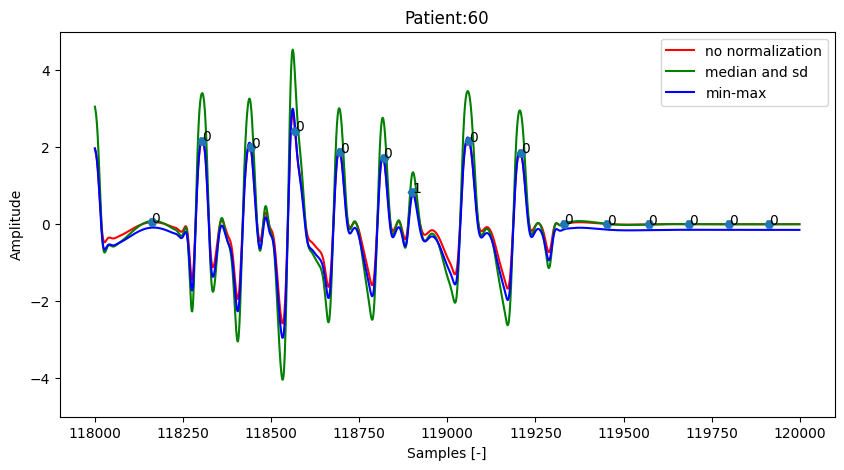

In [ ]:
# Plot before and after normalization
min_n_samples = 118000
max_n_samples = 120000

t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; signal_temp.shape[0]/fs; 0,10,1/fs

idx_peaks = peaks_resampled[patient]
peaks_values = filtered_ppg_signals_noart_nomessy[patient][idx_peaks.astype(int)]
# Extract the labels of the patient
labels_pat = labels[patient]

fig, axs = plt.subplots(figsize=(10,5))
axs.set_title("Patient:" + str(patient))

axs.plot(t, filtered_ppg_signals_noart_nomessy[patient][min_n_samples:max_n_samples], color='r', label="no normalization")
axs.plot(t, normalized_signals_list[patient][min_n_samples:max_n_samples], color='g', label="median and sd")
axs.plot(t, minmax_normalized_signals_list[patient][min_n_samples:max_n_samples], color='b', label="min-max")
i_min = 0
while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
  i_min+=1
i_max = i_min
while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
  i_max+=1
axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.legend()
plt.ylim(-5,5)
plt.show()

## Filtering

FIR filter

In [ ]:
cutoff_lowf = 0.5
cutoff_highf = 4
b = sig.firwin(49, [cutoff_lowf/(fs/2), cutoff_highf/(fs/2)], window='hamming', pass_zero=False)
y_firfilt = sig.filtfilt(b, 1, signal_temp)

def fir_filter(resampled_signal):
  b = sig.firwin(49, [cutoff_lowf/(new_fs/2), cutoff_highf/(new_fs/2)], window='hamming', pass_zero=False)
  y_firfilt = sig.filtfilt(b, 1, resampled_signal)
  return y_firfilt

res_no_artf_fir = []
for i in range(len(res_no_artf)):
  res_no_artf_fir_signal = fir_filter(res_no_artf[i])
  res_no_artf_fir.append(res_no_artf_fir_signal)

In [ ]:
# Plot

t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; signal_temp.shape[0]/fs; 0,10,1/fs
fig, axs = plt.subplots(figsize=(10,5))
axs.set_title("Patient:" + str(patient))
axs.plot(t, signal_temp[min_n_samples:max_n_samples], color='C0', label='signal')
axs.plot(t, y_firfilt[min_n_samples:max_n_samples], color='r', label='fir filtered signal')
axs.plot(t, y_bwfilt[min_n_samples:max_n_samples], color='g', label='bw filtered signal')
i_min = 0
while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
  i_min+=1
i_max = i_min
while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
  i_max+=1
axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
axs.set_xlabel("Samples [-]")
axs.set_ylabel("Amplitude")
plt.ylim(-5,5)
plt.legend()
plt.show()

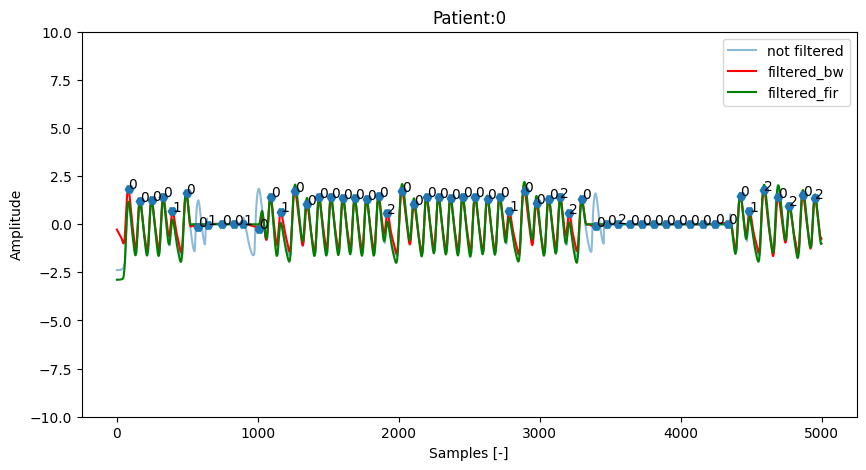

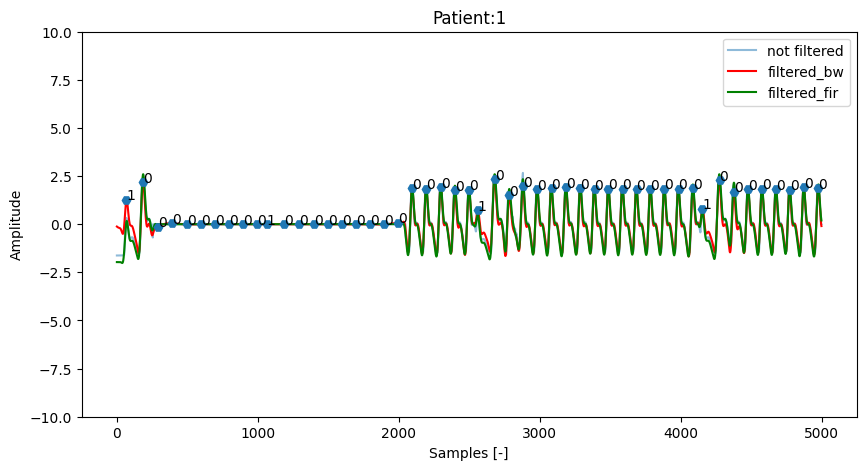

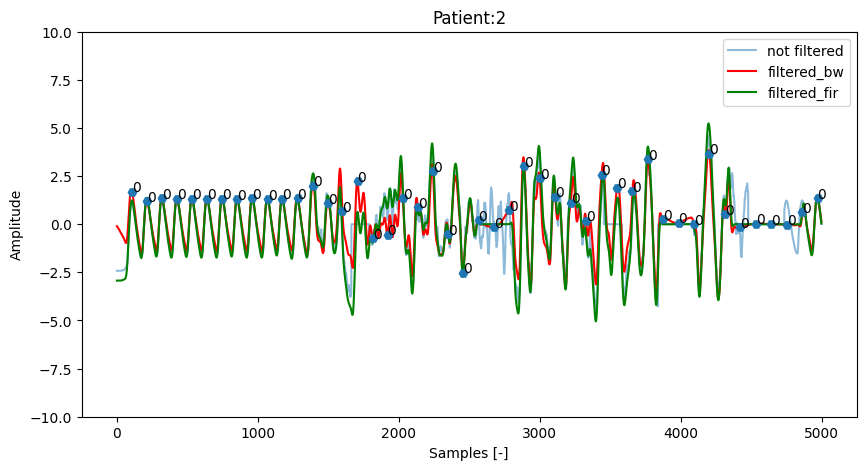

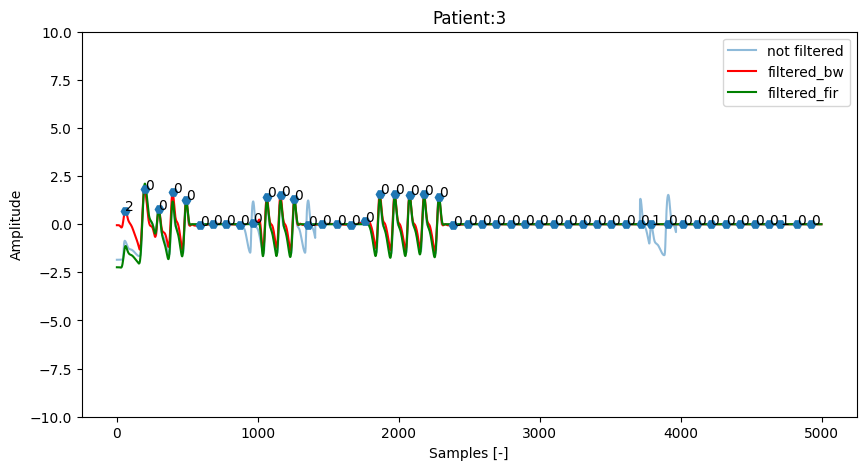

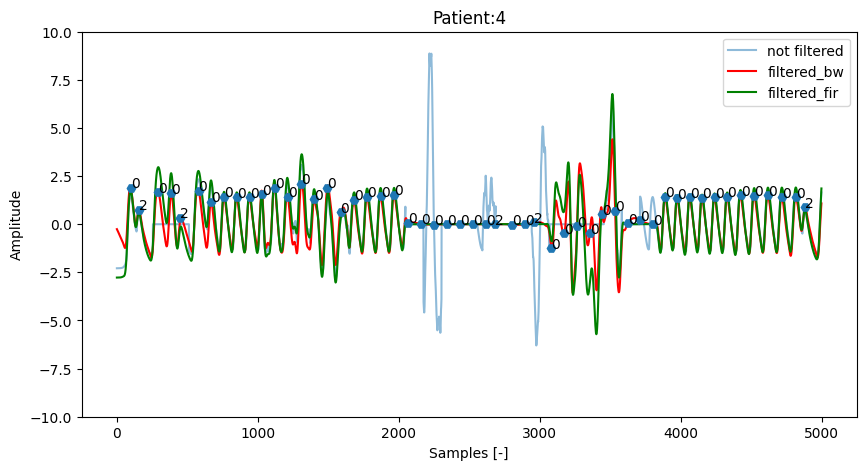

...

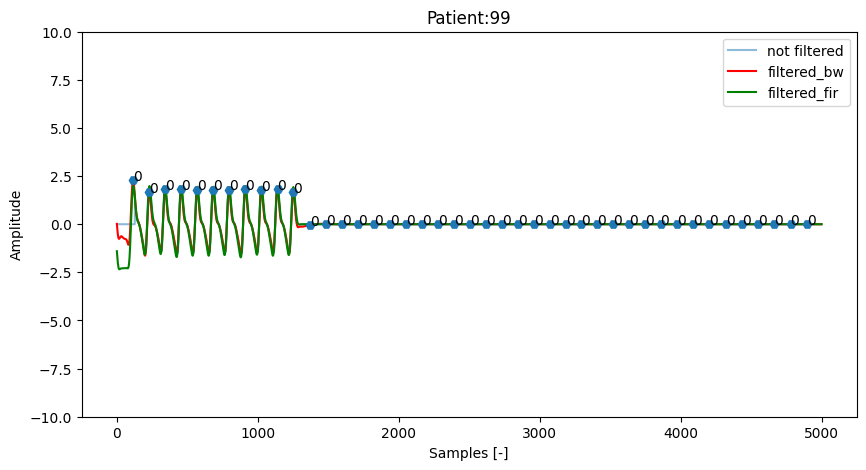

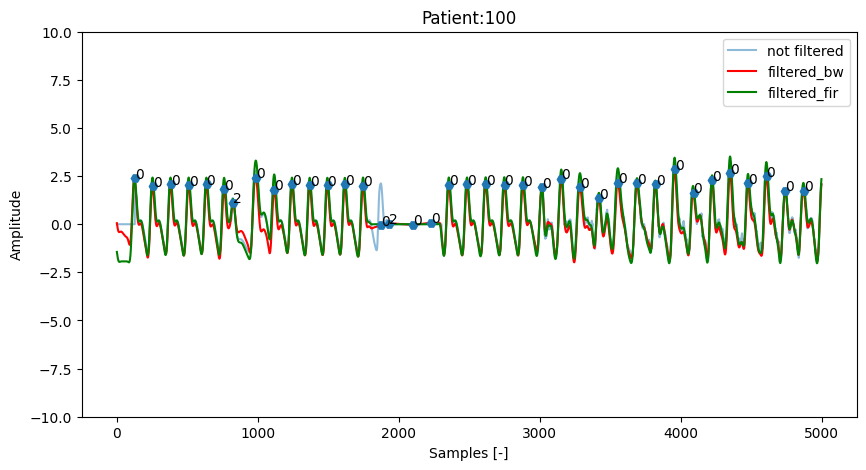

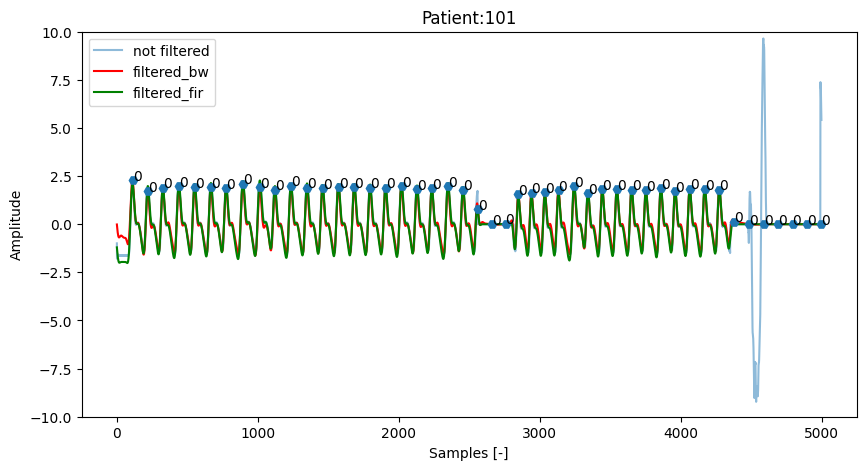

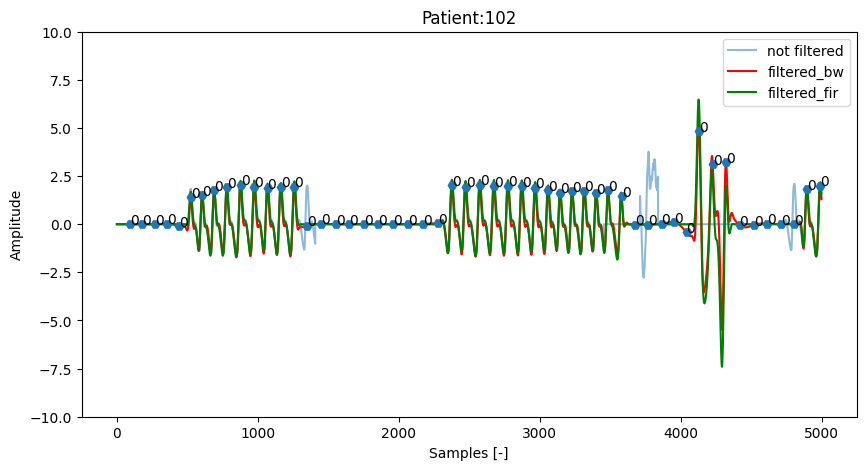

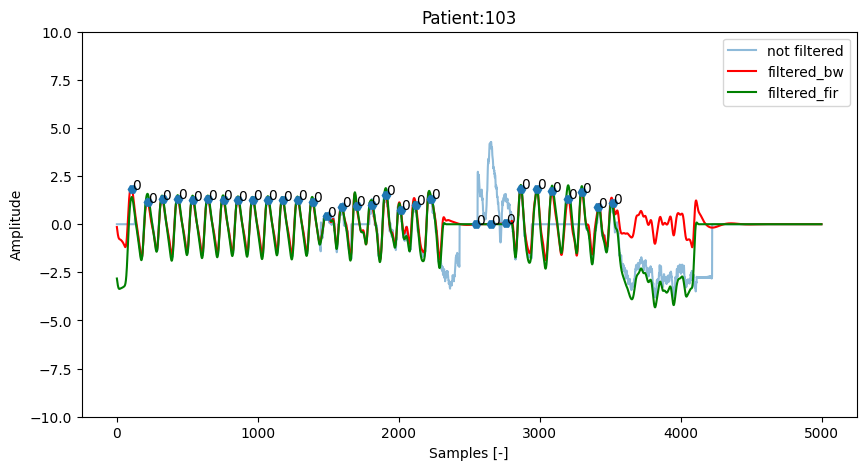

In [ ]:
# Plot signal
min_n_samples = 0
max_n_samples = 5000 #signal_temp_res.shape[0]-1

t = np.arange(min_n_samples,max_n_samples,1) # signal_temp è un vettore colonna; signal_temp.shape[0]/fs; 0,10,1/fs

for patient in range(104):
  idx_peaks = peaks_res[patient]
  peaks_values = res_no_artf_bw_array[patient][idx_peaks.astype(int)]
  # Extract the labels of the patient
  labels_pat = labels[patient]

  fig, axs = plt.subplots(figsize=(10,5))
  axs.set_title("Patient:" + str(patient))
  axs.plot(t, res_no_artf_array[patient][min_n_samples:max_n_samples], c='C0', label="not filtered", alpha = 0.5)
  axs.plot(t, res_no_artf_bw_array[patient][min_n_samples:max_n_samples], color='r', label="filtered_bw")
  axs.plot(t, res_no_artf_fir_array[patient][min_n_samples:max_n_samples], color='g', label="filtered_fir")
  i_min = 0
  while(idx_peaks[i_min]<min_n_samples): # iterate until the minimum index is found
    i_min+=1
  i_max = i_min
  while(idx_peaks[i_max]<max_n_samples): # iterate until the maximum index is found
    i_max+=1
  axs.plot(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], "H")
  addlabels(idx_peaks[i_min:i_max], peaks_values[i_min:i_max], labels_pat[i_min:i_max])
  axs.set_xlabel("Samples [-]")
  axs.set_ylabel("Amplitude")
  plt.legend()
  plt.ylim(-10,10)
  plt.show()

## Segmentation

### Blocks of three consecutive segments

In [ ]:
three_blocks = []
three_blocks_ampl = []
three_blocks_labels = []
three_blocks_peaks = []
three_blocks_central_idx = []
#three_blocks_minima = []

for i in np.arange(0,len(total_segments_nomessy)): #iterate on the number of patients
  three_blocks_patient = []
  three_blocks_patient_ampl = []
  three_blocks_patient_labels = []
  three_blocks_patient_peaks = []
  #three_blocks_patient_minima = []
  three_blocks_patient_central_idx = []
  j = 1
  while(j<(len(total_segments_nomessy[i])-1)): #iterate on the total segments for that patient
    skip = False
    k = j #k = 1
    while(k<(len(total_segments_nomessy[i])-1) and total_segments_nomessy[i][k][0] == (total_segments_nomessy[i][k-1][-1]+1) and total_segments_nomessy[i][k+1][0] == (total_segments_nomessy[i][k][-1]+1)): # while the first index of the current segment is equal to
    # the last index of the previous segment + 1, and while the first index of the following segment is equal to the last index of the current segment, add the three to the three_block
      skip = True # skip the second "k+=1"
      three_blocks_patient.append(np.concatenate([total_segments_nomessy[i][k-1], total_segments_nomessy[i][k], total_segments_nomessy[i][k+1]], axis=-1))
      three_blocks_patient_ampl.append(np.concatenate([total_segments_nomessy_ampl[i][k-1], total_segments_nomessy_ampl[i][k], total_segments_nomessy_ampl[i][k+1]], axis=-1))
      three_blocks_patient_labels.append([total_labels_nomessy[i][k-1], total_labels_nomessy[i][k], total_labels_nomessy[i][k+1]])
      three_blocks_patient_peaks.append([total_peaks_nomessy[i][k-1], total_peaks_nomessy[i][k], total_peaks_nomessy[i][k+1]])
      #three_blocks_patient_minima.append([total_minima_onset_nomessy[i][k-1], total_minima_onset_nomessy[i][k], total_minima_onset_nomessy[i][k+1]])
      three_blocks_patient_central_idx.append(k)
      k+=1 # skip = True
    if(skip == False): k+=1 # prepare j for next iteration
    j = k # j = 2
  three_blocks.append(three_blocks_patient)
  three_blocks_ampl.append(three_blocks_patient_ampl)
  three_blocks_labels.append(three_blocks_patient_labels)
  three_blocks_peaks.append(three_blocks_patient_peaks)
  three_blocks_central_idx.append(three_blocks_patient_central_idx)

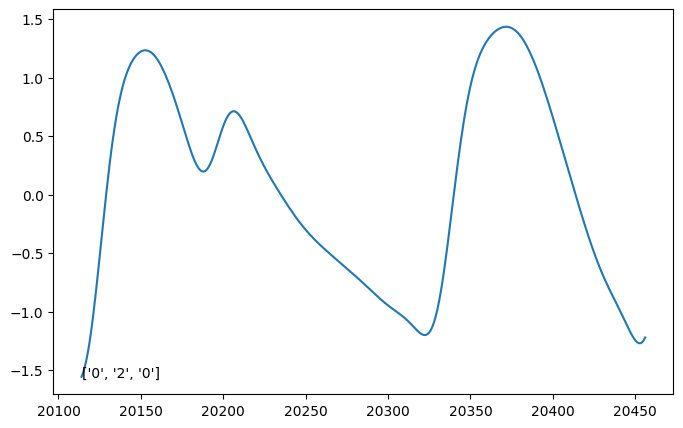

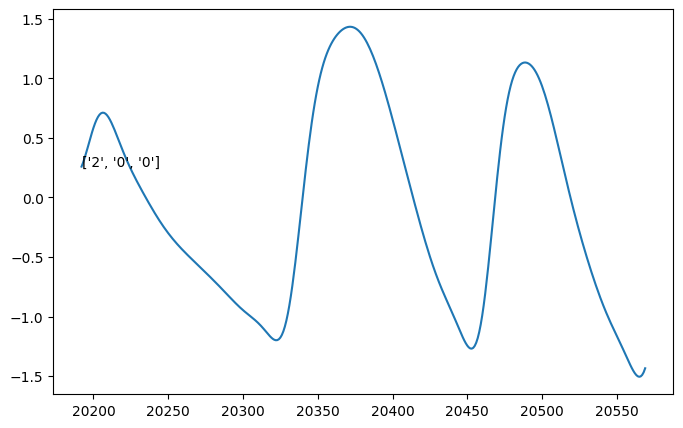

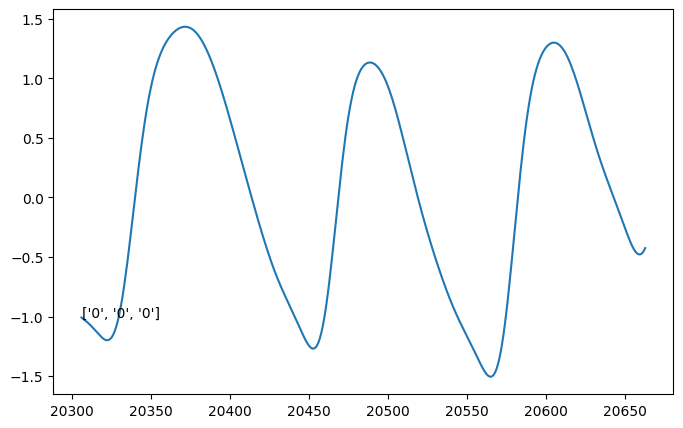

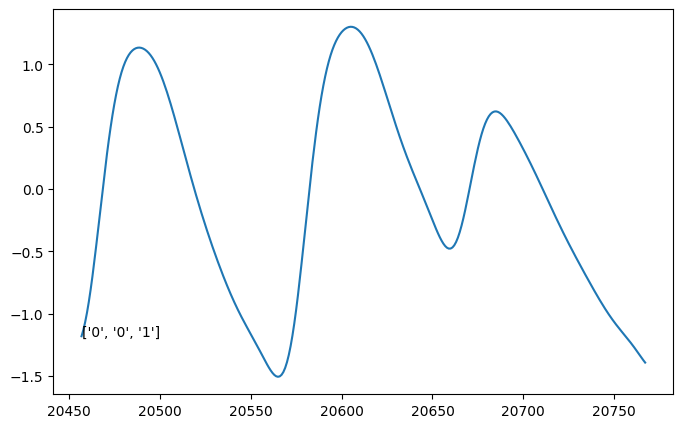

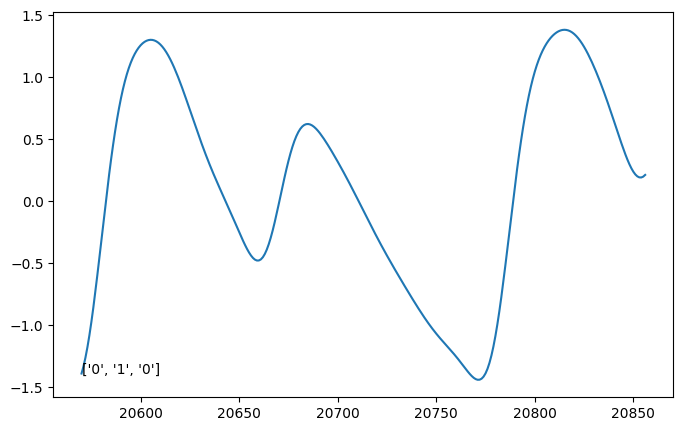

...

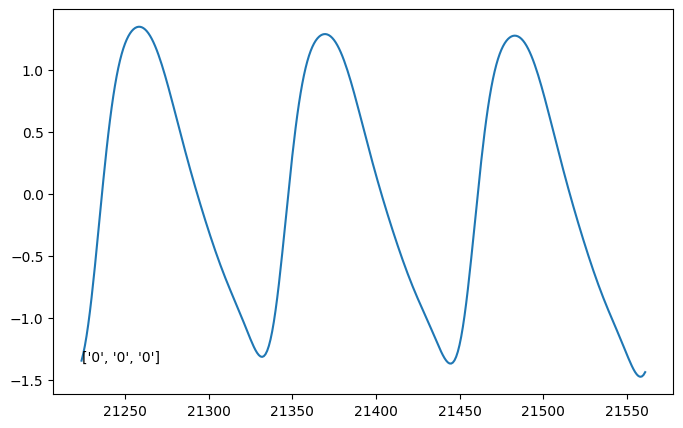

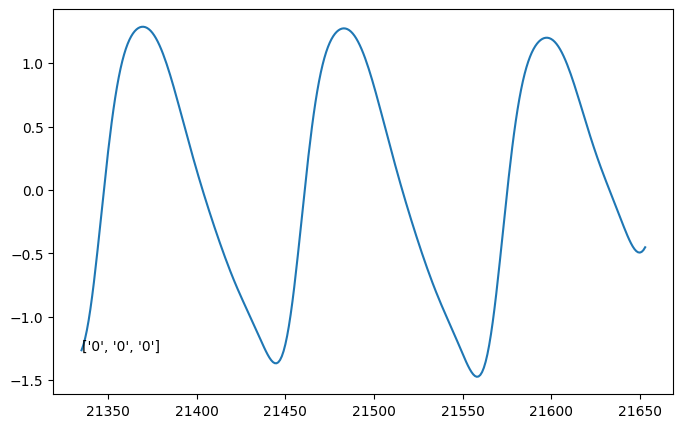

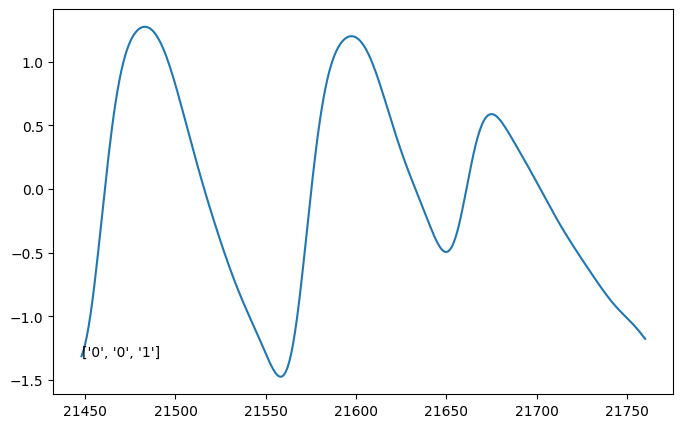

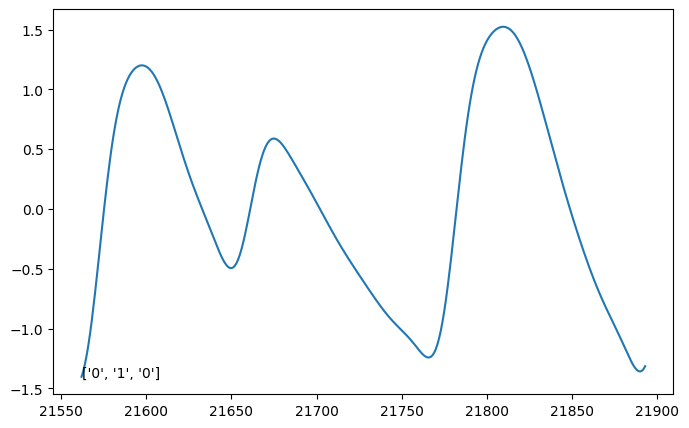

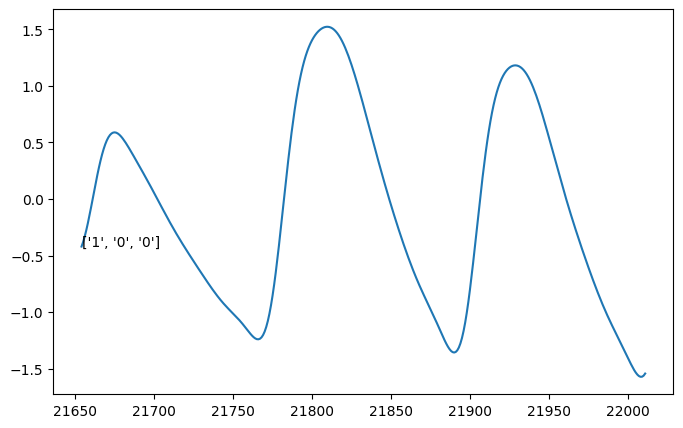

In [ ]:
# check sanity of blocks
patient = 10

block = 0
first = False
while(block<len(three_blocks_ampl[patient])):
  if(three_blocks_labels[patient][block][1] == '2'):
    if(first==False):
      first = True
      start = block
    while(block<start+15):
      plt.figure(figsize=(8,5))
      plt.plot(three_blocks[patient][block], three_blocks_ampl[patient][block])
      plt.text(three_blocks[patient][block][0], three_blocks_ampl[patient][block][0], three_blocks_labels[patient][block])
      block += 1
    break
  block += 1

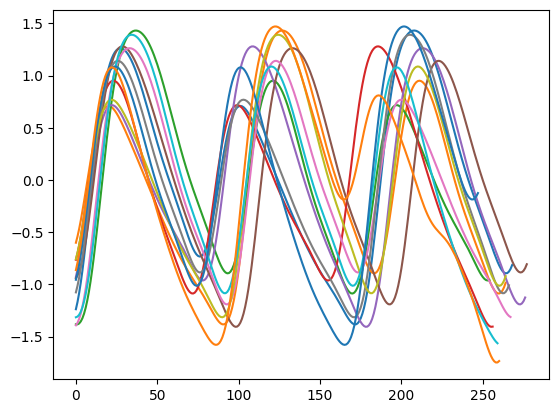

In [ ]:
for block in range(len(three_blocks_ampl[44])):
  plt.plot(three_blocks_ampl[44][block])
  if(block>10): break

## Artifact removal - anomaly detection

### Convolutional autoencoder

In [ ]:
input_shape = 200
bottleneck_size = 20

# Encoder
input_encoder = Input(shape=(input_shape, 1))
encoded = Conv1D(16, 3, activation='relu', padding='same', name='conv1')(input_encoder)
encoded = MaxPooling1D(2, padding='same', name='mp1')(encoded)
encoded = Conv1D(8, 3, activation='relu', padding='same', name='conv2')(encoded)
encoded = MaxPooling1D(2, padding='same', name='mp2')(encoded)
encoded = Conv1D(bottleneck_size, 3, activation='relu', padding='same', name='conv3')(encoded)
encoded = Conv1D(1, 3, activation='relu', padding='same', name='conv4')(encoded)
encoded = Flatten()(encoded)
encoded = Dense(bottleneck_size, activation='relu', name='dense1')(encoded)
encoder = Model(input_encoder, encoded)

# Decoder
input_decoder = Input(shape=(bottleneck_size, 1)) #, 1

decoded = Conv1D(8, 3, activation='relu', padding='same', name='conv5')(input_decoder)
decoded = UpSampling1D(2, name='up1')(decoded)
decoded = Conv1D(16, 3, activation='relu', padding='same', name='conv6')(decoded)
decoded = UpSampling1D(2, name='up2')(decoded)
decoded = Conv1D(32, 3, activation='relu', padding='same', name='conv7')(decoded)
decoded = UpSampling1D(2, name='up3')(decoded)
decoded = Conv1D(32, 3, activation='relu', padding='same', name='conv8')(decoded)
decoded = UpSampling1D(2, name='up4')(decoded)
decoded = Conv1D(1, 3, activation='relu', padding='same', name='conv9')(decoded)
decoded = Flatten()(decoded)
decoded = Dense(input_shape, activation='relu', name='dense1')(decoded)
decoded = Reshape((input_shape,1))(decoded)
decoder = Model(input_decoder, decoded)

# Full Autoencoder
full = decoder(encoder(input_encoder))
autoencoder = Model(input_encoder, full)

autoencoder.compile(optimizer='adam', loss='mse')  # Use mean squared error for reconstruction loss


In [ ]:
encoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 200, 1)]          0         
                                                                 
 conv1 (Conv1D)              (None, 200, 16)           64        
                                                                 
 mp1 (MaxPooling1D)          (None, 100, 16)           0         
                                                                 
 conv2 (Conv1D)              (None, 100, 8)            392       
                                                                 
 mp2 (MaxPooling1D)          (None, 50, 8)             0         
                                                                 
 conv3 (Conv1D)              (None, 50, 20)            500       
                                                                 
 conv4 (Conv1D)              (None, 50, 1)             61    

In [ ]:
decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 20, 1)]           0         
                                                                 
 conv5 (Conv1D)              (None, 20, 8)             32        
                                                                 
 up1 (UpSampling1D)          (None, 40, 8)             0         
                                                                 
 conv6 (Conv1D)              (None, 40, 16)            400       
                                                                 
 up2 (UpSampling1D)          (None, 80, 16)            0         
                                                                 
 conv7 (Conv1D)              (None, 80, 32)            1568      
                                                                 
 up3 (UpSampling1D)          (None, 160, 32)           0   

In [ ]:
X_train_reshaped = np.expand_dims(X_train, axis=-1)
X_val_reshaped = np.expand_dims(X_val, axis=-1)
X_noisy_reshaped = np.expand_dims(segments_arr_res_removed, axis=-1)

print(len(X_noisy_reshaped), len(X_train_reshaped), len(X_val_reshaped))

In [ ]:
autoencoder.compile(optimizer='adam', loss='mae')

autoencoder.fit(X_train_reshaped, X_train_reshaped, epochs=100, batch_size=512, validation_data=(X_val_reshaped, X_val_reshaped))

In [ ]:
X_train_reshaped = np.expand_dims(X_train, axis=-1)
X_val_reshaped = np.expand_dims(X_val, axis=-1)
X_noisy_reshaped = np.expand_dims(segments_arr_res_removed, axis=-1)

print(len(X_noisy_reshaped), len(X_train_reshaped), len(X_val_reshaped))

In [ ]:
autoencoder.compile(optimizer='adam', loss='mae')

autoencoder.fit(X_train_reshaped, X_train_reshaped, epochs=100, batch_size=512, validation_data=(X_val_reshaped, X_val_reshaped))

### Recurrent autoencoder

In [ ]:
input_shape = 100
bottleneck_size = 8

# Encoder
input_encoder = Input(shape=(100, 1))
encoded = Conv1D(32, 3, activation='relu', padding='same')(input_encoder)
encoded = MaxPooling1D(2, padding='same')(encoded)
encoded = LSTM(64, activation='relu', return_sequences=True)(encoded)
encoded = LSTM(32, activation='relu', return_sequences=False)(encoded)
encoded = Dense(16, activation='relu')(encoded)
encoded = Dense(bottleneck_size, activation='relu')(encoded)
encoder = Model(input_encoder, encoded)

# Decoder
input_decoder = Input(shape=(bottleneck_size, 1))
decoded = RepeatVector(100)(input_decoder)
decoded = LSTM(32, activation='relu', return_sequences=True)(decoded)
decoded = LSTM(64, activation='relu', return_sequences=True)(decoded)
decoded = UpSampling1D(2)(decoded)
decoded = Conv1D(1, 3, activation='relu', padding='same')(decoded)
decoded = Dense(input_shape, activation='relu')(decoded)
decoder = Model(input_decoder, decoded)

# Autoencoder
full = decoder(encoder(input_encoder))
autoencoder = Model(input_encoder, full)

# Model summary
autoencoder.summary()


In [ ]:
X_train_reshaped = np.expand_dims(X_train, axis=-1)
X_val_reshaped = np.expand_dims(X_val, axis=-1)
X_noisy_reshaped = np.expand_dims(segments_arr_res_removed, axis=-1)

print(len(X_noisy_reshaped), len(X_train_reshaped), len(X_val_reshaped))

In [ ]:
autoencoder.compile(optimizer='adam', loss='mae')

autoencoder.fit(X_train_reshaped, X_train_reshaped, epochs=100, batch_size=512, validation_data=(X_val_reshaped, X_val_reshaped))

 ## 7. Stratified split

### Stratify blocks and block features

In [ ]:
three_ampl_list = [sublist2 for sublist1 in three_blocks_ampl for sublist2 in sublist1]
three_labels_list = [sublist2 for sublist1 in three_blocks_labels for sublist2 in sublist1]
three_ampl_arr = np.array(three_ampl_list)
three_labels_arr = np.array(three_labels_list)
#print(len(three_ampl_arr), len(features_df['label']))

In [ ]:
central_labels_arr = []
for i in range(len(three_labels_arr)):
  central_labels_arr.append(three_labels_arr[i][1])

central_labels_arr = np.array(central_labels_arr)
central_labels_arr[0]

In [ ]:
# Resample segments (so that they have all the same length, to be passed to the network)
three_ampl_arr_res = []
for i in range(len(three_ampl_arr)):
  three_ampl_arr_res.append(resample(three_ampl_arr[i], 500))
three_ampl_arr_res = np.array(three_ampl_arr_res)
print(len(three_ampl_arr_res), len(three_ampl_arr_res[0])) #

In [ ]:
# 'X' is the feature matrix, 'y' is the label vector for peak types,
# and 'groups' is the group label vector for patients

# Create composite labels
X = three_ampl_arr_res
X = pd.DataFrame(X)
y = central_labels_arr
y = pd.Series(y)
groups = total_features['patient']
test_size = 0.1

# Perform the stratified group split
train_full_indices, test_indices, patients_groups_train_full, patients_groups_test = stratified_group_split(X, y, groups, test_size)
train_full, test, labels_train_full, labels_test = X.iloc[train_full_indices], X.iloc[test_indices], y.iloc[train_full_indices], y.iloc[test_indices]

In [ ]:
len(train_full), len(test)

In [ ]:
X = features
y = labels
groups = total_features['patient']

features_train_full, features_test, labels_features_train_full, labels_features_test = X.iloc[train_full_indices], X.iloc[test_indices], y.iloc[train_full_indices], y.iloc[test_indices]

In [ ]:
len(features_train_full), len(features_test)

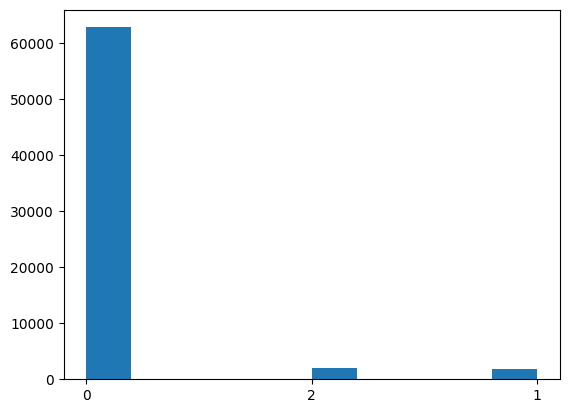

[62854  1808  2034]


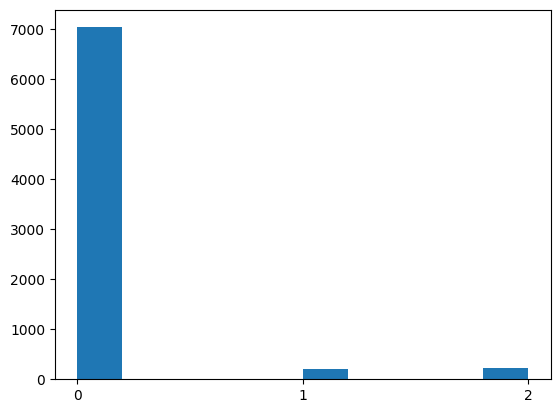

[7034  202  223]


In [ ]:
# Plot the number of each label in the train_full and the test sets
train_full_labels_features = np.array(labels_features_train_full)
unique, label_counts_train_full = np.unique(train_full_labels_features, return_counts=True)
plt.hist(train_full_labels_features)
plt.show()
print(label_counts_train_full)

test_labels_features = np.array(labels_features_test)
unique, label_counts_test = np.unique(test_labels_features, return_counts=True)
plt.hist(test_labels_features)
plt.show()
print(label_counts_test)

In [ ]:
# 'X' is your feature matrix, 'y' is the label vector for peak types,
# and 'groups' is the group label vector for patients

# Create composite labels
X = train_full
y = labels_train_full
groups = patients_groups_train_full
validation_size = 0.1

# Perform the stratified group split
train_indices, val_indices, patients_groups_train, patients_groups_validation = stratified_group_split(X, y, groups, validation_size)
train, validation, labels_train, labels_validation = X.iloc[train_indices], X.iloc[val_indices], y.iloc[train_indices], y.iloc[val_indices]

In [ ]:
len(train), len(validation)

In [ ]:
X = features_train_full
y = labels_features_train_full
groups = patients_groups_train_full
validation_size = 0.1

features_train, features_validation, labels_features_train, labels_features_validation = X.iloc[train_indices], X.iloc[val_indices], y.iloc[train_indices], y.iloc[val_indices]

In [ ]:
len(features_train), len(features_validation)

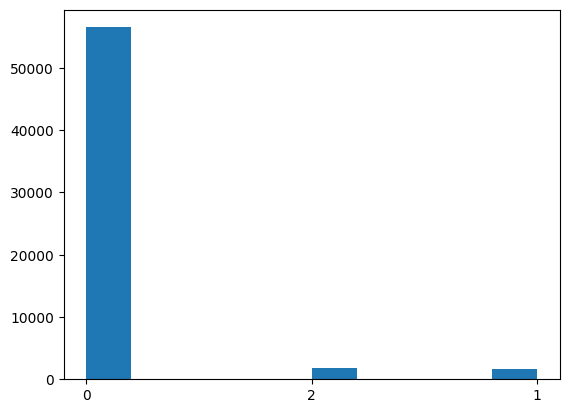

[56528  1629  1830]


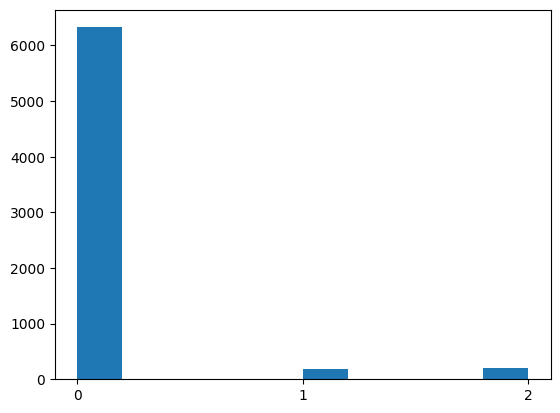

[6326  179  204]


In [ ]:
# Plot the number of each label in the train and the validation sets
train_labels_features = np.array(labels_features_train)
unique, label_counts_train = np.unique(train_labels_features, return_counts=True)
plt.hist(train_labels_features)
plt.show()
print(label_counts_train)

validation_labels_features = np.array(labels_features_validation)
unique, label_counts_validation = np.unique(validation_labels_features, return_counts=True)
plt.hist(validation_labels_features)
plt.show()
print(label_counts_validation)

In [ ]:
#X_train_val = np.array(features_train_full)
X_train_val = np.array(train_full)
y_train_val = np.array(labels_train_full)

#X_train = np.array(train)
X_train = np.array(train)
y_train = np.array(labels_train)

#X_test = np.array(test)
X_test = np.array(test)
y_test = np.array(labels_test)

#X_val = np.array(validation)
X_val = np.array(validation)
y_val = np.array(labels_validation)

print(X_train_val.shape, X_test.shape, X_train.shape, X_val.shape)
print(y_train_val.shape, y_test.shape, y_train.shape, y_val.shape)

In [ ]:
#X_features_train_val = np.array(features_train_full)
X_features_train_val = np.array(features_train_full)
y_labels_train_val = np.array(labels_features_train_full)

#X_features_train = np.array(features_train)
X_features_train = np.array(features_train)
y_labels_train = np.array(labels_features_train)

#X_features_test = np.array(features_test)
X_features_test = np.array(features_test)
y_labels_test = np.array(labels_features_test)

#X_features_val = np.array(features_validation)
X_features_val = np.array(features_validation)
y_labels_val = np.array(labels_features_validation)

print(X_features_train_val.shape, X_features_test.shape, X_features_train.shape, X_features_val.shape)
print(y_labels_train_val.shape, y_labels_test.shape, y_labels_train.shape, y_labels_val.shape)



## Feature preprocessing

### Handling missing data - median

In [ ]:
#features_train_full_nan_median = features_train_full.fillna(features_train_full.median(axis=0))
features_train_nan_median = X_features_train_under.fillna(X_features_train_under.median(axis=0))
features_validation_nan_median = features_validation.fillna(features_validation.median(axis=0))
features_test_nan_median = features_test.fillna(features_test.median(axis=0))

print(features_train_nan_median.shape)

## Feature selection

### PCA

In [ ]:
# useful functions

# plots the PCA analysis of the given features
def plot_PCAanalysis(train_features_pca, pc_plot):
  principalComponents_Df = pd.DataFrame(data = train_features_pca[:,pc_plot],
                                      columns = ['principal component 1', 'principal component 2'])
  plt.figure()
  plt.figure(figsize=(10,10))
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=14)
  plt.xlabel('Principal Component - 1',fontsize=20)
  plt.ylabel('Principal Component - 2',fontsize=20)
  plt.title("Principal Component Analysis",fontsize=20)
  targets = [0, 1]
  colors = ['r', 'g']
  for target, color in zip(targets,colors):
    indicesToKeep = np.array(train_labels) == target
    plt.scatter(principalComponents_Df.loc[indicesToKeep, 'principal component 1']
                , principalComponents_Df.loc[indicesToKeep, 'principal component 2'], c = color, s = 50)

  plt.legend(targets,prop={'size': 15})
  return

In [ ]:
"Evaluate model"
#testModel(train_features_selection_pca, labels_train_binary, validation_features_selection_pca, labels_validation_binary, ['0', '1'])

## Models

### CBAM wide resnet trained on 3-segments blocks

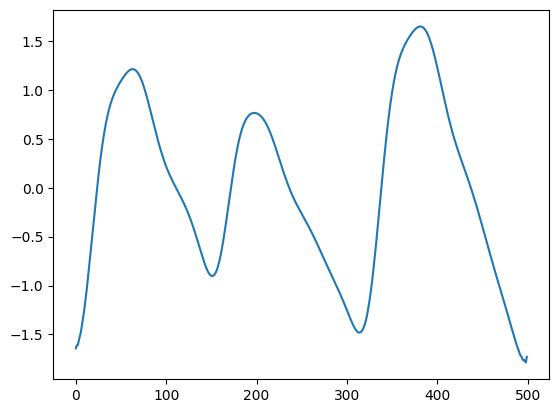

In [ ]:
plt.plot(X_train[1])

In [ ]:
history_CBAM = fit_model_Wide(WideCBAM, X_train, features_train_array, y_train_one_hot, batch_size, epochs, X_val, features_val_array, y_val_one_hot, callbacks_list)


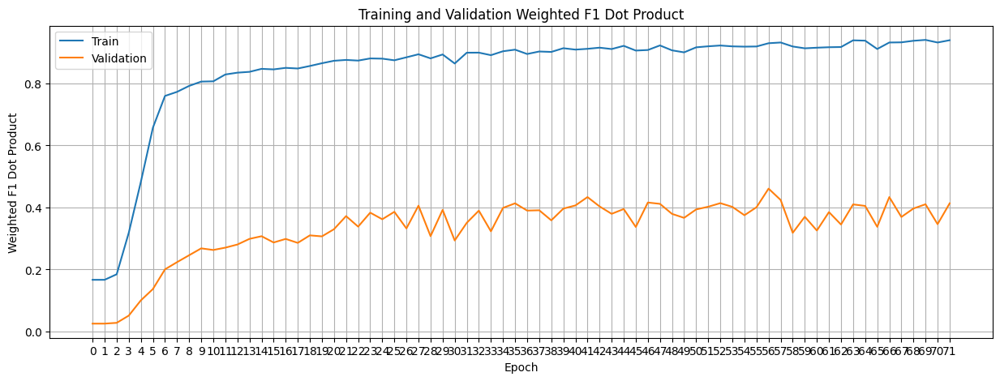

In [ ]:
plot_custom_metric(history_CBAM)

234/234 [==============================] - 3s 15ms/step
Predictions shape: (7459, 3)


<ipython-input-273-bfc0712ab835>:13: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cm_normalized = cm / cm.astype(np.float).sum(axis=1, keepdims=True)


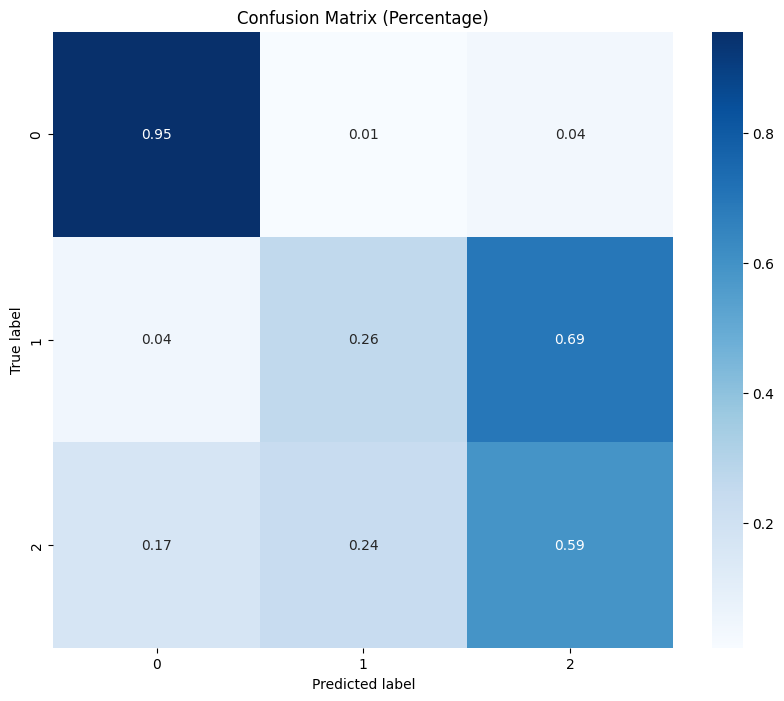

              precision    recall  f1-score   support

           0       0.99      0.95      0.97      7034
           1       0.31      0.26      0.29       202
           2       0.25      0.59      0.35       223

    accuracy                           0.93      7459
   macro avg       0.52      0.60      0.54      7459
weighted avg       0.95      0.93      0.94      7459



In [ ]:
metric_CBAM = predict_and_report_Wide(WideCBAM, X_test, features_test_array, y_test)